In [3]:
import pandas as pd
import numpy as np
import cv2, os, gc

from glob import glob
##from tqdm import tqdm
from tqdm.notebook import tqdm

import torch

import matplotlib
import matplotlib.pyplot as plt

import os
import gc
import tqdm
import copy
from PIL import Image
import torch
from sklearn.cluster import KMeans
import cv2
import numpy as np
import matplotlib.pyplot as plt

In [10]:
df = pd.read_csv('train_withbox_split_clean_encode.csv')
df['img_name'] = df.apply(lambda row: f"archive/{row.patient_id}_{row.image_id}.png", axis=1)

df.info()
df.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 54659 entries, 0 to 54658
Data columns (total 22 columns):
 #   Column                   Non-Null Count  Dtype 
---  ------                   --------------  ----- 
 0   Unnamed: 0.1             54659 non-null  int64 
 1   Unnamed: 0               54659 non-null  int64 
 2   site_id                  54659 non-null  int64 
 3   patient_id               54659 non-null  int64 
 4   image_id                 54659 non-null  int64 
 5   laterality               54659 non-null  object
 6   view                     54659 non-null  int64 
 7   age                      54659 non-null  int64 
 8   cancer                   54659 non-null  int64 
 9   biopsy                   54659 non-null  int64 
 10  invasive                 54659 non-null  int64 
 11  BIRADS                   54659 non-null  int64 
 12  implant                  54659 non-null  int64 
 13  density                  54659 non-null  int64 
 14  machine_id               54659 non-nul

,Unnamed: 0.1,Unnamed: 0,site_id,patient_id,image_id,laterality,view,age,cancer,biopsy,...,implant,density,machine_id,difficult_negative_case,x,y,w,h,split,img_name
0,0,0,2,5,640805896,L,5,68,0,0,...,0,255,21,1,0,357,941,1982,1,archive/5_640805896.png
1,1,1,2,5,940388076,R,1,68,0,0,...,0,255,21,0,1187,50,887,2149,1,archive/5_940388076.png
2,2,2,2,5,1351088028,L,1,68,0,0,...,0,255,21,1,4,334,814,2094,1,archive/5_1351088028.png
3,3,3,2,5,1633417959,R,5,68,0,0,...,0,255,21,0,1097,211,985,2157,1,archive/5_1633417959.png
4,4,4,1,25,1789648218,L,1,62,0,0,...,0,1,49,0,13,563,1655,3080,0,archive/25_1789648218.png


  0%|                                                 | 0/54659 [00:00<?, ?it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  0%|                                       | 1/54659 [00:00<8:14:53,  1.84it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  0%|                                       | 2/54659 [00:00<5:35:08,  2.72it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  0%|                                      | 25/54659 [00:07<4:34:05,  3.32it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  0%|                                      | 26/54659 [00:07<4:30:03,  3.37it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  0%|                                      | 27/54659 [00:08<4:21:40,  3.48it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  0%|                                      | 50/54659 [00:15<4:49:04,  3.15it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  0%|                                      | 51/54659 [00:15<4:54:20,  3.09it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  0%|                                      | 52/54659 [00:15<5:01:53,  3.01it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  0%|                                      | 75/54659 [00:22<3:58:05,  3.82it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  0%|                                      | 76/54659 [00:22<4:04:15,  3.72it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  0%|                                      | 77/54659 [00:22<4:16:01,  3.55it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  0%|                                     | 100/54659 [00:29<4:21:06,  3.48it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  0%|                                     | 101/54659 [00:29<4:08:07,  3.66it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  0%|                                     | 102/54659 [00:30<3:57:53,  3.82it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  0%|                                     | 125/54659 [00:36<4:17:07,  3.53it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  0%|                                     | 126/54659 [00:36<4:20:43,  3.49it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  0%|                                     | 127/54659 [00:36<4:17:01,  3.54it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  0%|                                     | 150/54659 [00:43<4:35:18,  3.30it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  0%|                                     | 151/54659 [00:43<4:32:08,  3.34it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  0%|                                     | 152/54659 [00:44<4:31:20,  3.35it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  0%|                                     | 175/54659 [00:50<4:01:15,  3.76it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  0%|                                     | 176/54659 [00:50<3:55:03,  3.86it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  0%|                                     | 177/54659 [00:51<3:49:44,  3.95it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  0%|▏                                    | 200/54659 [00:57<4:07:28,  3.67it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  0%|▏                                    | 201/54659 [00:58<4:00:11,  3.78it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  0%|▏                                    | 202/54659 [00:58<4:10:23,  3.62it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  0%|▏                                    | 225/54659 [01:05<5:03:35,  2.99it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  0%|▏                                    | 226/54659 [01:05<5:02:14,  3.00it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  0%|▏                                    | 227/54659 [01:06<4:55:24,  3.07it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  0%|▏                                    | 250/54659 [01:13<4:31:43,  3.34it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  0%|▏                                    | 251/54659 [01:13<4:34:13,  3.31it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  0%|▏                                    | 252/54659 [01:13<4:56:36,  3.06it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  1%|▏                                    | 275/54659 [01:20<4:17:07,  3.53it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  1%|▏                                    | 276/54659 [01:21<4:07:24,  3.66it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  1%|▏                                    | 277/54659 [01:21<4:32:26,  3.33it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  1%|▏                                    | 300/54659 [01:28<4:32:59,  3.32it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  1%|▏                                    | 301/54659 [01:28<4:32:58,  3.32it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  1%|▏                                    | 302/54659 [01:29<4:22:41,  3.45it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  1%|▏                                    | 325/54659 [01:35<4:34:12,  3.30it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  1%|▏                                    | 326/54659 [01:36<4:31:20,  3.34it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  1%|▏                                    | 327/54659 [01:36<4:26:08,  3.40it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  1%|▏                                    | 350/54659 [01:43<3:58:58,  3.79it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  1%|▏                                    | 351/54659 [01:43<4:14:50,  3.55it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  1%|▏                                    | 352/54659 [01:43<4:22:04,  3.45it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  1%|▎                                    | 375/54659 [01:50<4:18:44,  3.50it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  1%|▎                                    | 376/54659 [01:51<4:50:40,  3.11it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  1%|▎                                    | 377/54659 [01:51<4:37:26,  3.26it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  1%|▎                                    | 400/54659 [01:58<4:08:41,  3.64it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  1%|▎                                    | 401/54659 [01:58<4:09:28,  3.62it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  1%|▎                                    | 402/54659 [01:58<4:08:47,  3.63it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  1%|▎                                    | 425/54659 [02:05<4:39:09,  3.24it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  1%|▎                                    | 426/54659 [02:05<4:44:49,  3.17it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  1%|▎                                    | 427/54659 [02:06<4:39:05,  3.24it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  1%|▎                                    | 450/54659 [02:13<4:35:01,  3.29it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  1%|▎                                    | 451/54659 [02:13<4:26:35,  3.39it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  1%|▎                                    | 452/54659 [02:13<4:50:45,  3.11it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  1%|▎                                    | 475/54659 [02:20<4:30:04,  3.34it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  1%|▎                                    | 476/54659 [02:21<4:24:51,  3.41it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  1%|▎                                    | 477/54659 [02:21<4:12:32,  3.58it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  1%|▎                                    | 500/54659 [02:28<3:57:24,  3.80it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  1%|▎                                    | 501/54659 [02:28<4:03:29,  3.71it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  1%|▎                                    | 502/54659 [02:28<3:56:39,  3.81it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  1%|▎                                    | 525/54659 [02:35<3:57:35,  3.80it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  1%|▎                                    | 526/54659 [02:35<3:55:26,  3.83it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  1%|▎                                    | 527/54659 [02:35<3:56:07,  3.82it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  1%|▎                                    | 550/54659 [02:42<4:30:57,  3.33it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  1%|▎                                    | 551/54659 [02:43<4:27:19,  3.37it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  1%|▎                                    | 552/54659 [02:43<4:15:31,  3.53it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  1%|▍                                    | 575/54659 [02:50<4:20:09,  3.46it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  1%|▍                                    | 576/54659 [02:50<4:13:13,  3.56it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  1%|▍                                    | 577/54659 [02:50<4:20:13,  3.46it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  1%|▍                                    | 600/54659 [02:57<4:22:59,  3.43it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  1%|▍                                    | 601/54659 [02:57<4:36:07,  3.26it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  1%|▍                                    | 602/54659 [02:58<4:31:28,  3.32it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  1%|▍                                    | 625/54659 [03:05<4:15:14,  3.53it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  1%|▍                                    | 626/54659 [03:05<4:13:40,  3.55it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  1%|▍                                    | 627/54659 [03:05<4:12:25,  3.57it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  1%|▍                                    | 650/54659 [03:12<4:38:32,  3.23it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  1%|▍                                    | 651/54659 [03:13<4:22:19,  3.43it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  1%|▍                                    | 652/54659 [03:13<4:14:19,  3.54it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  1%|▍                                    | 675/54659 [03:20<4:36:16,  3.26it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  1%|▍                                    | 676/54659 [03:20<4:33:37,  3.29it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  1%|▍                                    | 677/54659 [03:21<4:27:10,  3.37it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  1%|▍                                    | 700/54659 [03:27<4:26:49,  3.37it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  1%|▍                                    | 701/54659 [03:28<4:17:43,  3.49it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  1%|▍                                    | 702/54659 [03:28<4:21:41,  3.44it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  1%|▍                                    | 725/54659 [03:34<4:14:06,  3.54it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  1%|▍                                    | 726/54659 [03:35<4:28:33,  3.35it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  1%|▍                                    | 727/54659 [03:35<4:27:47,  3.36it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  1%|▌                                    | 750/54659 [03:42<4:18:48,  3.47it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  1%|▌                                    | 751/54659 [03:42<4:21:17,  3.44it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  1%|▌                                    | 752/54659 [03:42<4:16:34,  3.50it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  1%|▌                                    | 775/54659 [03:49<4:34:59,  3.27it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  1%|▌                                    | 776/54659 [03:50<4:28:39,  3.34it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  1%|▌                                    | 777/54659 [03:50<4:33:18,  3.29it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  1%|▌                                    | 800/54659 [03:57<4:52:08,  3.07it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  1%|▌                                    | 801/54659 [03:57<4:38:42,  3.22it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  1%|▌                                    | 802/54659 [03:58<4:34:56,  3.26it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  2%|▌                                    | 825/54659 [04:05<4:47:47,  3.12it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  2%|▌                                    | 826/54659 [04:05<4:47:17,  3.12it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  2%|▌                                    | 827/54659 [04:05<4:59:05,  3.00it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  2%|▌                                    | 850/54659 [04:12<4:15:55,  3.50it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  2%|▌                                    | 851/54659 [04:12<4:18:21,  3.47it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  2%|▌                                    | 852/54659 [04:13<4:12:10,  3.56it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  2%|▌                                    | 875/54659 [04:20<4:41:12,  3.19it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  2%|▌                                    | 876/54659 [04:20<4:41:47,  3.18it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  2%|▌                                    | 877/54659 [04:20<4:47:15,  3.12it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  2%|▌                                    | 900/54659 [04:27<4:39:01,  3.21it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  2%|▌                                    | 901/54659 [04:28<4:39:00,  3.21it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  2%|▌                                    | 902/54659 [04:28<4:42:42,  3.17it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  2%|▋                                    | 925/54659 [04:35<4:39:58,  3.20it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  2%|▋                                    | 926/54659 [04:36<4:34:02,  3.27it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  2%|▋                                    | 927/54659 [04:36<4:39:59,  3.20it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  2%|▋                                    | 950/54659 [04:43<4:51:40,  3.07it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  2%|▋                                    | 951/54659 [04:44<4:55:49,  3.03it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  2%|▋                                    | 952/54659 [04:44<4:56:30,  3.02it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  2%|▋                                    | 975/54659 [04:52<4:47:08,  3.12it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  2%|▋                                    | 976/54659 [04:52<4:49:12,  3.09it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  2%|▋                                    | 977/54659 [04:52<4:58:43,  3.00it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  2%|▋                                   | 1000/54659 [05:00<5:22:06,  2.78it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  2%|▋                                   | 1001/54659 [05:00<5:24:23,  2.76it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  2%|▋                                   | 1002/54659 [05:01<5:12:35,  2.86it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  2%|▋                                   | 1025/54659 [05:09<5:03:03,  2.95it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  2%|▋                                   | 1026/54659 [05:09<4:59:07,  2.99it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  2%|▋                                   | 1027/54659 [05:09<5:00:11,  2.98it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  2%|▋                                   | 1050/54659 [05:18<5:23:10,  2.76it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  2%|▋                                   | 1051/54659 [05:18<5:21:39,  2.78it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  2%|▋                                   | 1052/54659 [05:18<5:20:14,  2.79it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  2%|▋                                   | 1075/54659 [05:27<5:35:07,  2.66it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  2%|▋                                   | 1076/54659 [05:27<5:17:02,  2.82it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  2%|▋                                   | 1077/54659 [05:27<5:18:38,  2.80it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  2%|▋                                   | 1100/54659 [05:35<5:18:30,  2.80it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  2%|▋                                   | 1101/54659 [05:36<5:13:16,  2.85it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  2%|▋                                   | 1102/54659 [05:36<5:11:09,  2.87it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  2%|▋                                   | 1125/54659 [05:45<5:12:29,  2.86it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  2%|▋                                   | 1126/54659 [05:45<5:08:34,  2.89it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  2%|▋                                   | 1127/54659 [05:45<5:03:45,  2.94it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  2%|▊                                   | 1150/54659 [05:54<5:22:57,  2.76it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  2%|▊                                   | 1151/54659 [05:54<5:29:20,  2.71it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  2%|▊                                   | 1152/54659 [05:55<5:43:24,  2.60it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  2%|▊                                   | 1175/54659 [06:04<5:57:47,  2.49it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  2%|▊                                   | 1176/54659 [06:04<6:11:18,  2.40it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  2%|▊                                   | 1177/54659 [06:05<6:14:28,  2.38it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  2%|▊                                   | 1200/54659 [06:14<5:36:17,  2.65it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  2%|▊                                   | 1201/54659 [06:14<5:28:21,  2.71it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  2%|▊                                   | 1202/54659 [06:15<5:30:26,  2.70it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  2%|▊                                   | 1225/54659 [06:23<5:45:24,  2.58it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  2%|▊                                   | 1226/54659 [06:24<5:48:22,  2.56it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  2%|▊                                   | 1227/54659 [06:24<5:53:22,  2.52it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  2%|▊                                   | 1250/54659 [06:33<5:44:25,  2.58it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  2%|▊                                   | 1251/54659 [06:33<5:53:20,  2.52it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  2%|▊                                   | 1252/54659 [06:34<5:40:55,  2.61it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  2%|▊                                   | 1275/54659 [06:43<5:56:05,  2.50it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  2%|▊                                   | 1276/54659 [06:43<5:47:41,  2.56it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  2%|▊                                   | 1277/54659 [06:43<5:31:56,  2.68it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  2%|▊                                   | 1300/54659 [06:52<5:14:33,  2.83it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  2%|▊                                   | 1301/54659 [06:52<5:04:43,  2.92it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  2%|▊                                   | 1302/54659 [06:52<5:02:30,  2.94it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  2%|▊                                   | 1325/54659 [07:01<5:38:15,  2.63it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  2%|▊                                   | 1326/54659 [07:01<5:39:43,  2.62it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  2%|▊                                   | 1327/54659 [07:02<5:28:10,  2.71it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  2%|▉                                   | 1350/54659 [07:10<5:30:45,  2.69it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  2%|▉                                   | 1351/54659 [07:11<5:29:55,  2.69it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  2%|▉                                   | 1352/54659 [07:11<5:37:39,  2.63it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  3%|▉                                   | 1375/54659 [07:20<5:36:52,  2.64it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  3%|▉                                   | 1376/54659 [07:20<5:57:25,  2.48it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  3%|▉                                   | 1377/54659 [07:21<6:13:09,  2.38it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  3%|▉                                   | 1400/54659 [07:30<5:33:38,  2.66it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  3%|▉                                   | 1401/54659 [07:30<5:25:17,  2.73it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  3%|▉                                   | 1402/54659 [07:30<5:10:22,  2.86it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  3%|▉                                   | 1425/54659 [07:39<5:14:38,  2.82it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  3%|▉                                   | 1426/54659 [07:40<5:12:02,  2.84it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  3%|▉                                   | 1427/54659 [07:40<5:06:43,  2.89it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  3%|▉                                   | 1450/54659 [07:49<5:46:00,  2.56it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  3%|▉                                   | 1451/54659 [07:49<5:40:35,  2.60it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  3%|▉                                   | 1452/54659 [07:50<5:39:35,  2.61it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  3%|▉                                   | 1475/54659 [07:58<5:11:03,  2.85it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  3%|▉                                   | 1476/54659 [07:59<5:05:04,  2.91it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  3%|▉                                   | 1477/54659 [07:59<4:58:16,  2.97it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  3%|▉                                   | 1500/54659 [08:08<5:56:24,  2.49it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  3%|▉                                   | 1501/54659 [08:09<5:44:45,  2.57it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  3%|▉                                   | 1502/54659 [08:09<5:44:37,  2.57it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  3%|█                                   | 1525/54659 [08:18<5:38:56,  2.61it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  3%|█                                   | 1526/54659 [08:18<5:41:47,  2.59it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  3%|█                                   | 1527/54659 [08:18<5:45:03,  2.57it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  3%|█                                   | 1550/54659 [08:27<5:14:09,  2.82it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  3%|█                                   | 1551/54659 [08:27<5:06:45,  2.89it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  3%|█                                   | 1552/54659 [08:28<5:19:55,  2.77it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  3%|█                                   | 1575/54659 [08:36<5:49:47,  2.53it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  3%|█                                   | 1576/54659 [08:36<5:40:46,  2.60it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  3%|█                                   | 1577/54659 [08:37<5:27:08,  2.70it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  3%|█                                   | 1600/54659 [08:45<4:58:32,  2.96it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  3%|█                                   | 1601/54659 [08:45<4:51:16,  3.04it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  3%|█                                   | 1602/54659 [08:45<5:06:06,  2.89it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  3%|█                                   | 1625/54659 [08:54<5:36:17,  2.63it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  3%|█                                   | 1626/54659 [08:54<5:34:41,  2.64it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  3%|█                                   | 1627/54659 [08:55<5:40:05,  2.60it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  3%|█                                   | 1650/54659 [09:04<5:45:34,  2.56it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  3%|█                                   | 1651/54659 [09:04<5:43:50,  2.57it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  3%|█                                   | 1652/54659 [09:05<5:51:01,  2.52it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  3%|█                                   | 1675/54659 [09:14<5:54:31,  2.49it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  3%|█                                   | 1676/54659 [09:14<5:42:02,  2.58it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  3%|█                                   | 1677/54659 [09:14<5:42:16,  2.58it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  3%|█                                   | 1700/54659 [09:23<5:10:35,  2.84it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  3%|█                                   | 1701/54659 [09:23<5:23:42,  2.73it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  3%|█                                   | 1702/54659 [09:24<5:20:09,  2.76it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  3%|█▏                                  | 1725/54659 [09:32<5:33:59,  2.64it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  3%|█▏                                  | 1726/54659 [09:33<5:33:10,  2.65it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  3%|█▏                                  | 1727/54659 [09:33<5:18:01,  2.77it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  3%|█▏                                  | 1750/54659 [09:41<5:05:16,  2.89it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  3%|█▏                                  | 1751/54659 [09:42<4:56:05,  2.98it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  3%|█▏                                  | 1752/54659 [09:42<4:50:02,  3.04it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  3%|█▏                                  | 1775/54659 [09:50<5:22:13,  2.74it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  3%|█▏                                  | 1776/54659 [09:50<5:33:39,  2.64it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  3%|█▏                                  | 1777/54659 [09:51<5:40:29,  2.59it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  3%|█▏                                  | 1800/54659 [10:00<5:41:27,  2.58it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  3%|█▏                                  | 1801/54659 [10:00<5:51:06,  2.51it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  3%|█▏                                  | 1802/54659 [10:00<5:53:15,  2.49it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  3%|█▏                                  | 1825/54659 [10:10<6:01:50,  2.43it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  3%|█▏                                  | 1826/54659 [10:10<5:48:11,  2.53it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  3%|█▏                                  | 1827/54659 [10:10<6:05:15,  2.41it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  3%|█▏                                  | 1850/54659 [10:19<5:02:03,  2.91it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  3%|█▏                                  | 1851/54659 [10:19<5:02:57,  2.91it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  3%|█▏                                  | 1852/54659 [10:20<5:15:22,  2.79it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  3%|█▏                                  | 1875/54659 [10:28<5:57:56,  2.46it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  3%|█▏                                  | 1876/54659 [10:29<5:58:22,  2.45it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  3%|█▏                                  | 1877/54659 [10:29<5:48:19,  2.53it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  3%|█▎                                  | 1900/54659 [10:38<5:26:40,  2.69it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  3%|█▎                                  | 1901/54659 [10:38<5:39:22,  2.59it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  3%|█▎                                  | 1902/54659 [10:39<5:34:27,  2.63it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  4%|█▎                                  | 1925/54659 [10:47<5:42:18,  2.57it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  4%|█▎                                  | 1926/54659 [10:48<5:46:10,  2.54it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  4%|█▎                                  | 1927/54659 [10:48<5:40:58,  2.58it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  4%|█▎                                  | 1950/54659 [10:57<6:01:50,  2.43it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  4%|█▎                                  | 1951/54659 [10:58<6:01:43,  2.43it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  4%|█▎                                  | 1952/54659 [10:58<5:59:16,  2.45it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  4%|█▎                                  | 1975/54659 [11:07<5:19:23,  2.75it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  4%|█▎                                  | 1976/54659 [11:07<5:17:52,  2.76it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  4%|█▎                                  | 1977/54659 [11:07<5:13:55,  2.80it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  4%|█▎                                  | 2000/54659 [11:16<5:44:58,  2.54it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  4%|█▎                                  | 2001/54659 [11:16<5:41:47,  2.57it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  4%|█▎                                  | 2002/54659 [11:17<5:44:04,  2.55it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  4%|█▎                                  | 2025/54659 [11:26<5:20:11,  2.74it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  4%|█▎                                  | 2026/54659 [11:26<5:17:33,  2.76it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  4%|█▎                                  | 2027/54659 [11:27<5:39:23,  2.58it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  4%|█▎                                  | 2050/54659 [11:36<5:54:16,  2.47it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  4%|█▎                                  | 2051/54659 [11:37<5:48:40,  2.51it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  4%|█▎                                  | 2052/54659 [11:37<5:54:18,  2.47it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  4%|█▎                                  | 2075/54659 [11:46<6:14:51,  2.34it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  4%|█▎                                  | 2076/54659 [11:47<6:04:48,  2.40it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  4%|█▎                                  | 2077/54659 [11:47<6:16:36,  2.33it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  4%|█▍                                  | 2100/54659 [11:56<5:50:24,  2.50it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  4%|█▍                                  | 2101/54659 [11:57<5:55:47,  2.46it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  4%|█▍                                  | 2102/54659 [11:57<5:58:44,  2.44it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  4%|█▍                                  | 2125/54659 [12:06<5:38:52,  2.58it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  4%|█▍                                  | 2126/54659 [12:07<5:46:01,  2.53it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  4%|█▍                                  | 2127/54659 [12:07<5:39:11,  2.58it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  4%|█▍                                  | 2150/54659 [12:16<5:51:39,  2.49it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  4%|█▍                                  | 2151/54659 [12:17<5:58:15,  2.44it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  4%|█▍                                  | 2152/54659 [12:17<6:08:09,  2.38it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  4%|█▍                                  | 2175/54659 [12:27<6:08:42,  2.37it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  4%|█▍                                  | 2176/54659 [12:27<5:58:33,  2.44it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  4%|█▍                                  | 2177/54659 [12:27<5:58:13,  2.44it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  4%|█▍                                  | 2200/54659 [12:36<5:52:17,  2.48it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  4%|█▍                                  | 2201/54659 [12:37<5:47:50,  2.51it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  4%|█▍                                  | 2202/54659 [12:37<6:00:30,  2.43it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  4%|█▍                                  | 2225/54659 [12:46<5:47:51,  2.51it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  4%|█▍                                  | 2226/54659 [12:47<6:00:31,  2.42it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  4%|█▍                                  | 2227/54659 [12:47<6:03:24,  2.40it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  4%|█▍                                  | 2250/54659 [12:57<5:58:00,  2.44it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  4%|█▍                                  | 2251/54659 [12:57<6:18:05,  2.31it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  4%|█▍                                  | 2252/54659 [12:58<6:03:17,  2.40it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  4%|█▍                                  | 2275/54659 [13:07<5:55:25,  2.46it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  4%|█▍                                  | 2276/54659 [13:07<6:01:33,  2.41it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  4%|█▍                                  | 2277/54659 [13:07<6:02:08,  2.41it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  4%|█▌                                  | 2300/54659 [13:16<5:39:12,  2.57it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  4%|█▌                                  | 2301/54659 [13:17<5:49:32,  2.50it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  4%|█▌                                  | 2302/54659 [13:17<5:31:43,  2.63it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  4%|█▌                                  | 2325/54659 [13:26<6:17:37,  2.31it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  4%|█▌                                  | 2326/54659 [13:27<6:22:33,  2.28it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  4%|█▌                                  | 2327/54659 [13:27<6:19:36,  2.30it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  4%|█▌                                  | 2350/54659 [13:37<5:46:24,  2.52it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  4%|█▌                                  | 2351/54659 [13:37<5:43:36,  2.54it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  4%|█▌                                  | 2352/54659 [13:37<5:51:23,  2.48it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  4%|█▌                                  | 2375/54659 [13:47<5:22:12,  2.70it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  4%|█▌                                  | 2376/54659 [13:47<5:52:36,  2.47it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  4%|█▌                                  | 2377/54659 [13:47<5:45:30,  2.52it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  4%|█▌                                  | 2400/54659 [13:56<4:48:37,  3.02it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  4%|█▌                                  | 2401/54659 [13:56<4:51:34,  2.99it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  4%|█▌                                  | 2402/54659 [13:57<4:48:34,  3.02it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  4%|█▌                                  | 2425/54659 [14:04<4:25:51,  3.27it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  4%|█▌                                  | 2426/54659 [14:04<4:24:16,  3.29it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  4%|█▌                                  | 2427/54659 [14:05<4:39:33,  3.11it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  4%|█▌                                  | 2450/54659 [14:12<4:55:22,  2.95it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  4%|█▌                                  | 2451/54659 [14:12<4:50:41,  2.99it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  4%|█▌                                  | 2452/54659 [14:13<4:44:03,  3.06it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  5%|█▋                                  | 2475/54659 [14:20<4:47:26,  3.03it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  5%|█▋                                  | 2476/54659 [14:20<4:41:04,  3.09it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  5%|█▋                                  | 2477/54659 [14:21<4:41:03,  3.09it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  5%|█▋                                  | 2500/54659 [14:28<4:12:07,  3.45it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  5%|█▋                                  | 2501/54659 [14:28<4:29:20,  3.23it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  5%|█▋                                  | 2502/54659 [14:29<4:21:42,  3.32it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  5%|█▋                                  | 2525/54659 [14:36<4:26:54,  3.26it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  5%|█▋                                  | 2526/54659 [14:36<4:19:59,  3.34it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  5%|█▋                                  | 2527/54659 [14:36<4:23:37,  3.30it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  5%|█▋                                  | 2550/54659 [14:44<4:37:11,  3.13it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  5%|█▋                                  | 2551/54659 [14:44<4:34:29,  3.16it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  5%|█▋                                  | 2552/54659 [14:44<4:50:06,  2.99it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  5%|█▋                                  | 2575/54659 [14:51<4:04:53,  3.54it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  5%|█▋                                  | 2576/54659 [14:52<3:59:54,  3.62it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  5%|█▋                                  | 2577/54659 [14:52<4:00:39,  3.61it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  5%|█▋                                  | 2600/54659 [14:59<5:07:59,  2.82it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  5%|█▋                                  | 2601/54659 [15:00<4:59:46,  2.89it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  5%|█▋                                  | 2602/54659 [15:00<4:47:12,  3.02it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  5%|█▋                                  | 2625/54659 [15:07<5:04:30,  2.85it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  5%|█▋                                  | 2626/54659 [15:08<4:58:18,  2.91it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  5%|█▋                                  | 2627/54659 [15:08<5:14:27,  2.76it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  5%|█▋                                  | 2650/54659 [15:16<4:52:41,  2.96it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  5%|█▋                                  | 2651/54659 [15:16<4:53:20,  2.95it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  5%|█▋                                  | 2652/54659 [15:16<4:52:36,  2.96it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  5%|█▊                                  | 2675/54659 [15:24<4:15:15,  3.39it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  5%|█▊                                  | 2676/54659 [15:24<4:18:35,  3.35it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  5%|█▊                                  | 2677/54659 [15:24<4:17:41,  3.36it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  5%|█▊                                  | 2700/54659 [15:33<5:03:36,  2.85it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  5%|█▊                                  | 2701/54659 [15:33<4:54:08,  2.94it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  5%|█▊                                  | 2702/54659 [15:33<4:52:34,  2.96it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  5%|█▊                                  | 2725/54659 [15:41<5:08:58,  2.80it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  5%|█▊                                  | 2726/54659 [15:41<5:07:07,  2.82it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  5%|█▊                                  | 2727/54659 [15:41<5:09:03,  2.80it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  5%|█▊                                  | 2750/54659 [15:49<4:58:18,  2.90it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  5%|█▊                                  | 2751/54659 [15:49<4:46:15,  3.02it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  5%|█▊                                  | 2752/54659 [15:50<4:49:24,  2.99it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  5%|█▊                                  | 2775/54659 [15:57<4:44:18,  3.04it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  5%|█▊                                  | 2776/54659 [15:58<4:36:26,  3.13it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  5%|█▊                                  | 2777/54659 [15:58<4:43:04,  3.05it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  5%|█▊                                  | 2800/54659 [16:05<4:55:03,  2.93it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  5%|█▊                                  | 2801/54659 [16:06<4:51:34,  2.96it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  5%|█▊                                  | 2802/54659 [16:06<4:52:56,  2.95it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  5%|█▊                                  | 2825/54659 [16:13<4:24:06,  3.27it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  5%|█▊                                  | 2826/54659 [16:14<4:25:50,  3.25it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  5%|█▊                                  | 2827/54659 [16:14<4:41:55,  3.06it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  5%|█▉                                  | 2850/54659 [16:22<4:24:49,  3.26it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  5%|█▉                                  | 2851/54659 [16:22<4:18:51,  3.34it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  5%|█▉                                  | 2852/54659 [16:22<4:30:08,  3.20it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  5%|█▉                                  | 2875/54659 [16:30<4:58:07,  2.89it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  5%|█▉                                  | 2876/54659 [16:30<4:53:31,  2.94it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  5%|█▉                                  | 2877/54659 [16:31<4:50:20,  2.97it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  5%|█▉                                  | 2900/54659 [16:38<4:49:40,  2.98it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  5%|█▉                                  | 2901/54659 [16:38<4:32:13,  3.17it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  5%|█▉                                  | 2902/54659 [16:39<4:28:27,  3.21it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  5%|█▉                                  | 2925/54659 [16:46<4:53:02,  2.94it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  5%|█▉                                  | 2926/54659 [16:47<4:37:42,  3.10it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  5%|█▉                                  | 2927/54659 [16:47<4:33:07,  3.16it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  5%|█▉                                  | 2950/54659 [16:55<5:33:23,  2.58it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  5%|█▉                                  | 2951/54659 [16:55<5:25:50,  2.64it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  5%|█▉                                  | 2952/54659 [16:56<5:08:24,  2.79it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  5%|█▉                                  | 2975/54659 [17:03<4:53:35,  2.93it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  5%|█▉                                  | 2976/54659 [17:04<4:45:19,  3.02it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  5%|█▉                                  | 2977/54659 [17:04<4:46:22,  3.01it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  5%|█▉                                  | 3000/54659 [17:11<4:22:17,  3.28it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  5%|█▉                                  | 3001/54659 [17:12<4:16:20,  3.36it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  5%|█▉                                  | 3002/54659 [17:12<4:10:25,  3.44it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  6%|█▉                                  | 3025/54659 [17:20<4:38:52,  3.09it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  6%|█▉                                  | 3026/54659 [17:20<4:50:13,  2.97it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  6%|█▉                                  | 3027/54659 [17:20<5:05:20,  2.82it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  6%|██                                  | 3050/54659 [17:28<4:14:30,  3.38it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  6%|██                                  | 3051/54659 [17:28<4:24:02,  3.26it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  6%|██                                  | 3052/54659 [17:29<4:24:30,  3.25it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  6%|██                                  | 3075/54659 [17:36<4:43:53,  3.03it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  6%|██                                  | 3076/54659 [17:37<4:30:29,  3.18it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  6%|██                                  | 3077/54659 [17:37<4:32:44,  3.15it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  6%|██                                  | 3100/54659 [17:44<4:10:26,  3.43it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  6%|██                                  | 3101/54659 [17:44<4:09:38,  3.44it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  6%|██                                  | 3102/54659 [17:44<4:00:37,  3.57it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  6%|██                                  | 3125/54659 [17:51<4:14:12,  3.38it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  6%|██                                  | 3126/54659 [17:52<4:06:58,  3.48it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  6%|██                                  | 3127/54659 [17:52<4:14:55,  3.37it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  6%|██                                  | 3150/54659 [17:59<4:55:48,  2.90it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  6%|██                                  | 3151/54659 [18:00<4:48:32,  2.98it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  6%|██                                  | 3152/54659 [18:00<4:48:47,  2.97it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  6%|██                                  | 3175/54659 [18:07<5:00:57,  2.85it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  6%|██                                  | 3176/54659 [18:08<4:59:41,  2.86it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  6%|██                                  | 3177/54659 [18:08<5:12:46,  2.74it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  6%|██                                  | 3200/54659 [18:16<4:49:01,  2.97it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  6%|██                                  | 3201/54659 [18:16<4:54:22,  2.91it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  6%|██                                  | 3202/54659 [18:16<4:40:07,  3.06it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  6%|██                                  | 3225/54659 [18:24<4:49:33,  2.96it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  6%|██                                  | 3226/54659 [18:24<4:34:23,  3.12it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  6%|██▏                                 | 3227/54659 [18:25<4:30:29,  3.17it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  6%|██▏                                 | 3250/54659 [18:32<4:51:07,  2.94it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  6%|██▏                                 | 3251/54659 [18:33<4:54:44,  2.91it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  6%|██▏                                 | 3252/54659 [18:33<5:09:23,  2.77it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  6%|██▏                                 | 3275/54659 [18:41<4:40:59,  3.05it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  6%|██▏                                 | 3276/54659 [18:41<4:35:28,  3.11it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  6%|██▏                                 | 3277/54659 [18:41<4:37:40,  3.08it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  6%|██▏                                 | 3300/54659 [18:49<4:24:38,  3.23it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  6%|██▏                                 | 3301/54659 [18:49<4:22:50,  3.26it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  6%|██▏                                 | 3302/54659 [18:49<4:32:41,  3.14it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  6%|██▏                                 | 3325/54659 [18:57<4:24:48,  3.23it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  6%|██▏                                 | 3326/54659 [18:57<4:29:08,  3.18it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  6%|██▏                                 | 3327/54659 [18:57<4:48:49,  2.96it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  6%|██▏                                 | 3350/54659 [19:05<4:25:44,  3.22it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  6%|██▏                                 | 3351/54659 [19:05<4:19:40,  3.29it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  6%|██▏                                 | 3352/54659 [19:05<4:24:52,  3.23it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  6%|██▏                                 | 3375/54659 [19:13<4:48:45,  2.96it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  6%|██▏                                 | 3376/54659 [19:13<4:44:17,  3.01it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  6%|██▏                                 | 3377/54659 [19:14<4:32:31,  3.14it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  6%|██▏                                 | 3400/54659 [19:21<4:47:33,  2.97it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  6%|██▏                                 | 3401/54659 [19:21<4:41:04,  3.04it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  6%|██▏                                 | 3402/54659 [19:22<4:40:15,  3.05it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  6%|██▎                                 | 3425/54659 [19:30<5:48:09,  2.45it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  6%|██▎                                 | 3426/54659 [19:30<6:03:04,  2.35it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  6%|██▎                                 | 3427/54659 [19:31<5:41:56,  2.50it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  6%|██▎                                 | 3450/54659 [19:38<4:23:47,  3.24it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  6%|██▎                                 | 3451/54659 [19:39<4:23:06,  3.24it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  6%|██▎                                 | 3452/54659 [19:39<4:29:26,  3.17it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  6%|██▎                                 | 3475/54659 [19:46<4:26:42,  3.20it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  6%|██▎                                 | 3476/54659 [19:47<4:32:06,  3.13it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  6%|██▎                                 | 3477/54659 [19:47<4:20:54,  3.27it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  6%|██▎                                 | 3500/54659 [19:54<5:04:14,  2.80it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  6%|██▎                                 | 3501/54659 [19:55<5:12:55,  2.72it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  6%|██▎                                 | 3502/54659 [19:55<5:19:43,  2.67it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  6%|██▎                                 | 3525/54659 [20:03<4:39:00,  3.05it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  6%|██▎                                 | 3526/54659 [20:03<4:30:37,  3.15it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  6%|██▎                                 | 3527/54659 [20:03<4:33:07,  3.12it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  6%|██▎                                 | 3550/54659 [20:11<4:44:04,  3.00it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  6%|██▎                                 | 3551/54659 [20:11<4:27:58,  3.18it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  6%|██▎                                 | 3552/54659 [20:12<4:22:33,  3.24it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  7%|██▎                                 | 3575/54659 [20:19<4:29:28,  3.16it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  7%|██▎                                 | 3576/54659 [20:19<4:17:55,  3.30it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  7%|██▎                                 | 3577/54659 [20:19<4:09:18,  3.42it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  7%|██▎                                 | 3600/54659 [20:27<4:50:11,  2.93it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  7%|██▎                                 | 3601/54659 [20:28<4:55:24,  2.88it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  7%|██▎                                 | 3602/54659 [20:28<4:59:25,  2.84it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  7%|██▍                                 | 3625/54659 [20:35<4:34:17,  3.10it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  7%|██▍                                 | 3626/54659 [20:36<4:44:48,  2.99it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  7%|██▍                                 | 3627/54659 [20:36<4:40:29,  3.03it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  7%|██▍                                 | 3650/54659 [20:44<4:52:24,  2.91it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  7%|██▍                                 | 3651/54659 [20:44<5:08:55,  2.75it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  7%|██▍                                 | 3652/54659 [20:44<5:04:13,  2.79it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  7%|██▍                                 | 3675/54659 [20:52<4:26:18,  3.19it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  7%|██▍                                 | 3676/54659 [20:52<4:30:53,  3.14it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  7%|██▍                                 | 3677/54659 [20:53<4:29:07,  3.16it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  7%|██▍                                 | 3700/54659 [21:01<4:37:13,  3.06it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  7%|██▍                                 | 3701/54659 [21:01<4:32:01,  3.12it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  7%|██▍                                 | 3702/54659 [21:01<4:39:45,  3.04it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  7%|██▍                                 | 3725/54659 [21:09<4:44:37,  2.98it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  7%|██▍                                 | 3726/54659 [21:09<4:42:55,  3.00it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  7%|██▍                                 | 3727/54659 [21:10<4:40:56,  3.02it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  7%|██▍                                 | 3750/54659 [21:17<4:30:48,  3.13it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  7%|██▍                                 | 3751/54659 [21:17<4:22:07,  3.24it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  7%|██▍                                 | 3752/54659 [21:17<4:18:27,  3.28it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  7%|██▍                                 | 3775/54659 [21:25<4:45:49,  2.97it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  7%|██▍                                 | 3776/54659 [21:26<4:45:17,  2.97it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  7%|██▍                                 | 3777/54659 [21:26<4:50:03,  2.92it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  7%|██▌                                 | 3800/54659 [21:34<4:45:34,  2.97it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  7%|██▌                                 | 3801/54659 [21:34<4:44:16,  2.98it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  7%|██▌                                 | 3802/54659 [21:35<4:39:40,  3.03it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  7%|██▌                                 | 3825/54659 [21:42<4:38:59,  3.04it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  7%|██▌                                 | 3826/54659 [21:43<4:35:36,  3.07it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  7%|██▌                                 | 3827/54659 [21:43<4:23:33,  3.21it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  7%|██▌                                 | 3850/54659 [21:50<4:25:09,  3.19it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  7%|██▌                                 | 3851/54659 [21:51<4:19:21,  3.27it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  7%|██▌                                 | 3852/54659 [21:51<4:12:25,  3.35it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  7%|██▌                                 | 3875/54659 [21:59<4:48:28,  2.93it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  7%|██▌                                 | 3876/54659 [21:59<5:02:54,  2.79it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  7%|██▌                                 | 3877/54659 [21:59<4:49:25,  2.92it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  7%|██▌                                 | 3900/54659 [22:07<4:27:07,  3.17it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  7%|██▌                                 | 3901/54659 [22:07<4:25:41,  3.18it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  7%|██▌                                 | 3902/54659 [22:07<4:31:51,  3.11it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  7%|██▌                                 | 3925/54659 [22:15<4:58:36,  2.83it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  7%|██▌                                 | 3926/54659 [22:16<4:55:03,  2.87it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  7%|██▌                                 | 3927/54659 [22:16<4:55:23,  2.86it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  7%|██▌                                 | 3950/54659 [22:24<4:35:31,  3.07it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  7%|██▌                                 | 3951/54659 [22:24<4:31:54,  3.11it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  7%|██▌                                 | 3952/54659 [22:24<4:22:55,  3.21it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  7%|██▌                                 | 3975/54659 [22:32<4:40:49,  3.01it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  7%|██▌                                 | 3976/54659 [22:33<4:42:22,  2.99it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  7%|██▌                                 | 3977/54659 [22:33<4:47:20,  2.94it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  7%|██▋                                 | 4000/54659 [22:41<4:54:43,  2.86it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  7%|██▋                                 | 4001/54659 [22:41<5:08:45,  2.73it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  7%|██▋                                 | 4002/54659 [22:42<5:12:37,  2.70it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  7%|██▋                                 | 4025/54659 [22:49<4:47:39,  2.93it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  7%|██▋                                 | 4026/54659 [22:50<4:40:32,  3.01it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  7%|██▋                                 | 4027/54659 [22:50<4:35:58,  3.06it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  7%|██▋                                 | 4050/54659 [22:58<4:58:32,  2.83it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  7%|██▋                                 | 4051/54659 [22:58<4:44:41,  2.96it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  7%|██▋                                 | 4052/54659 [22:58<4:37:58,  3.03it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  7%|██▋                                 | 4075/54659 [23:06<4:00:16,  3.51it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  7%|██▋                                 | 4076/54659 [23:06<4:23:33,  3.20it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  7%|██▋                                 | 4077/54659 [23:06<4:31:15,  3.11it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  8%|██▋                                 | 4100/54659 [23:14<4:34:13,  3.07it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  8%|██▋                                 | 4101/54659 [23:14<4:46:30,  2.94it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  8%|██▋                                 | 4102/54659 [23:14<4:38:48,  3.02it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  8%|██▋                                 | 4125/54659 [23:22<4:44:47,  2.96it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  8%|██▋                                 | 4126/54659 [23:22<4:32:45,  3.09it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  8%|██▋                                 | 4127/54659 [23:22<4:34:57,  3.06it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  8%|██▋                                 | 4150/54659 [23:31<5:15:08,  2.67it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  8%|██▋                                 | 4151/54659 [23:31<5:13:23,  2.69it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  8%|██▋                                 | 4152/54659 [23:32<5:16:38,  2.66it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  8%|██▋                                 | 4175/54659 [23:39<4:51:55,  2.88it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  8%|██▊                                 | 4176/54659 [23:40<4:57:30,  2.83it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  8%|██▊                                 | 4177/54659 [23:40<5:03:18,  2.77it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  8%|██▊                                 | 4200/54659 [23:48<4:36:20,  3.04it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  8%|██▊                                 | 4201/54659 [23:48<4:22:49,  3.20it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  8%|██▊                                 | 4202/54659 [23:48<4:34:42,  3.06it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  8%|██▊                                 | 4225/54659 [23:56<5:16:09,  2.66it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  8%|██▊                                 | 4226/54659 [23:57<5:29:10,  2.55it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  8%|██▊                                 | 4227/54659 [23:57<5:21:52,  2.61it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  8%|██▊                                 | 4250/54659 [24:05<4:45:35,  2.94it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  8%|██▊                                 | 4251/54659 [24:05<4:41:49,  2.98it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  8%|██▊                                 | 4252/54659 [24:05<4:55:24,  2.84it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  8%|██▊                                 | 4275/54659 [24:14<4:48:37,  2.91it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  8%|██▊                                 | 4276/54659 [24:14<4:51:26,  2.88it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  8%|██▊                                 | 4277/54659 [24:14<5:27:44,  2.56it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  8%|██▊                                 | 4300/54659 [24:22<4:46:02,  2.93it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  8%|██▊                                 | 4301/54659 [24:23<4:46:28,  2.93it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  8%|██▊                                 | 4302/54659 [24:23<4:50:43,  2.89it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  8%|██▊                                 | 4325/54659 [24:31<4:44:37,  2.95it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  8%|██▊                                 | 4326/54659 [24:31<4:42:12,  2.97it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  8%|██▊                                 | 4327/54659 [24:31<4:53:36,  2.86it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  8%|██▊                                 | 4350/54659 [24:40<4:56:15,  2.83it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  8%|██▊                                 | 4351/54659 [24:40<4:51:29,  2.88it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  8%|██▊                                 | 4352/54659 [24:40<5:01:50,  2.78it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  8%|██▉                                 | 4375/54659 [24:48<4:45:48,  2.93it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  8%|██▉                                 | 4376/54659 [24:48<4:34:37,  3.05it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  8%|██▉                                 | 4377/54659 [24:48<4:39:28,  3.00it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  8%|██▉                                 | 4400/54659 [24:56<4:47:59,  2.91it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  8%|██▉                                 | 4401/54659 [24:56<4:54:49,  2.84it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  8%|██▉                                 | 4402/54659 [24:56<4:48:10,  2.91it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  8%|██▉                                 | 4425/54659 [25:04<4:28:32,  3.12it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  8%|██▉                                 | 4426/54659 [25:04<4:30:52,  3.09it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  8%|██▉                                 | 4427/54659 [25:05<4:27:45,  3.13it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  8%|██▉                                 | 4450/54659 [25:13<5:06:17,  2.73it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  8%|██▉                                 | 4451/54659 [25:13<4:50:54,  2.88it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  8%|██▉                                 | 4452/54659 [25:14<4:46:45,  2.92it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  8%|██▉                                 | 4475/54659 [25:21<4:26:08,  3.14it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  8%|██▉                                 | 4476/54659 [25:22<4:19:39,  3.22it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  8%|██▉                                 | 4477/54659 [25:22<4:18:04,  3.24it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  8%|██▉                                 | 4500/54659 [25:30<4:53:33,  2.85it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  8%|██▉                                 | 4501/54659 [25:30<4:51:40,  2.87it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  8%|██▉                                 | 4502/54659 [25:31<4:52:35,  2.86it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  8%|██▉                                 | 4525/54659 [25:39<5:19:01,  2.62it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  8%|██▉                                 | 4526/54659 [25:40<5:19:11,  2.62it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  8%|██▉                                 | 4527/54659 [25:40<5:09:57,  2.70it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  8%|██▉                                 | 4550/54659 [25:48<4:44:16,  2.94it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  8%|██▉                                 | 4551/54659 [25:48<4:37:38,  3.01it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  8%|██▉                                 | 4552/54659 [25:48<4:29:08,  3.10it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  8%|███                                 | 4575/54659 [25:56<4:27:19,  3.12it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  8%|███                                 | 4576/54659 [25:56<4:33:47,  3.05it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  8%|███                                 | 4577/54659 [25:57<4:34:01,  3.05it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  8%|███                                 | 4600/54659 [26:05<4:57:50,  2.80it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  8%|███                                 | 4601/54659 [26:05<4:51:38,  2.86it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  8%|███                                 | 4602/54659 [26:05<4:52:33,  2.85it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  8%|███                                 | 4625/54659 [26:13<4:34:45,  3.04it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  8%|███                                 | 4626/54659 [26:14<4:40:55,  2.97it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  8%|███                                 | 4627/54659 [26:14<4:38:18,  3.00it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  9%|███                                 | 4650/54659 [26:21<4:37:18,  3.01it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  9%|███                                 | 4651/54659 [26:22<4:36:54,  3.01it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  9%|███                                 | 4652/54659 [26:22<4:34:18,  3.04it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  9%|███                                 | 4675/54659 [26:30<4:48:31,  2.89it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  9%|███                                 | 4676/54659 [26:30<5:04:01,  2.74it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  9%|███                                 | 4677/54659 [26:30<4:56:58,  2.81it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  9%|███                                 | 4700/54659 [26:38<4:10:06,  3.33it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  9%|███                                 | 4701/54659 [26:38<4:09:49,  3.33it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  9%|███                                 | 4702/54659 [26:38<4:08:39,  3.35it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  9%|███                                 | 4725/54659 [26:45<4:31:29,  3.07it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  9%|███                                 | 4726/54659 [26:46<4:41:33,  2.96it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  9%|███                                 | 4727/54659 [26:46<4:39:54,  2.97it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  9%|███▏                                | 4750/54659 [26:53<5:01:08,  2.76it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  9%|███▏                                | 4751/54659 [26:54<5:04:25,  2.73it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  9%|███▏                                | 4752/54659 [26:54<5:01:10,  2.76it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  9%|███▏                                | 4775/54659 [27:02<4:38:58,  2.98it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  9%|███▏                                | 4776/54659 [27:02<4:38:34,  2.98it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  9%|███▏                                | 4777/54659 [27:03<4:57:11,  2.80it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  9%|███▏                                | 4800/54659 [27:11<4:07:45,  3.35it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  9%|███▏                                | 4801/54659 [27:11<4:11:21,  3.31it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  9%|███▏                                | 4802/54659 [27:11<4:11:33,  3.30it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  9%|███▏                                | 4825/54659 [27:19<4:46:11,  2.90it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  9%|███▏                                | 4826/54659 [27:19<4:37:58,  2.99it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  9%|███▏                                | 4827/54659 [27:19<4:30:52,  3.07it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  9%|███▏                                | 4850/54659 [27:27<4:31:32,  3.06it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  9%|███▏                                | 4851/54659 [27:27<4:37:30,  2.99it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  9%|███▏                                | 4852/54659 [27:28<4:43:54,  2.92it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  9%|███▏                                | 4875/54659 [27:35<4:39:02,  2.97it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  9%|███▏                                | 4876/54659 [27:36<4:28:48,  3.09it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  9%|███▏                                | 4877/54659 [27:36<4:37:33,  2.99it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  9%|███▏                                | 4900/54659 [27:44<4:47:01,  2.89it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  9%|███▏                                | 4901/54659 [27:44<4:42:06,  2.94it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  9%|███▏                                | 4902/54659 [27:44<4:36:53,  2.99it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  9%|███▏                                | 4925/54659 [27:52<4:41:39,  2.94it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  9%|███▏                                | 4926/54659 [27:52<4:50:25,  2.85it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  9%|███▏                                | 4927/54659 [27:53<4:59:52,  2.76it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  9%|███▎                                | 4950/54659 [28:01<4:43:26,  2.92it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  9%|███▎                                | 4951/54659 [28:01<4:56:41,  2.79it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  9%|███▎                                | 4952/54659 [28:01<4:50:50,  2.85it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  9%|███▎                                | 4975/54659 [28:09<4:46:13,  2.89it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  9%|███▎                                | 4976/54659 [28:09<4:52:06,  2.83it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  9%|███▎                                | 4977/54659 [28:10<4:44:35,  2.91it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  9%|███▎                                | 5000/54659 [28:18<4:54:32,  2.81it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  9%|███▎                                | 5001/54659 [28:18<5:17:10,  2.61it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  9%|███▎                                | 5002/54659 [28:18<5:06:24,  2.70it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  9%|███▎                                | 5025/54659 [28:26<4:17:03,  3.22it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  9%|███▎                                | 5026/54659 [28:26<4:11:45,  3.29it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  9%|███▎                                | 5027/54659 [28:27<4:21:33,  3.16it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  9%|███▎                                | 5050/54659 [28:34<4:51:44,  2.83it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  9%|███▎                                | 5051/54659 [28:35<4:55:26,  2.80it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  9%|███▎                                | 5052/54659 [28:35<4:45:37,  2.89it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  9%|███▎                                | 5075/54659 [28:43<4:33:04,  3.03it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  9%|███▎                                | 5076/54659 [28:43<4:28:21,  3.08it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  9%|███▎                                | 5077/54659 [28:44<4:25:05,  3.12it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  9%|███▎                                | 5100/54659 [28:51<4:28:19,  3.08it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  9%|███▎                                | 5101/54659 [28:51<4:31:45,  3.04it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  9%|███▎                                | 5102/54659 [28:52<4:32:52,  3.03it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  9%|███▍                                | 5125/54659 [29:00<5:04:35,  2.71it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  9%|███▍                                | 5126/54659 [29:00<5:02:44,  2.73it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  9%|███▍                                | 5127/54659 [29:01<5:09:59,  2.66it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  9%|███▍                                | 5150/54659 [29:08<4:27:42,  3.08it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  9%|███▍                                | 5151/54659 [29:09<4:47:31,  2.87it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  9%|███▍                                | 5152/54659 [29:09<4:51:22,  2.83it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

  9%|███▍                                | 5175/54659 [29:17<4:26:28,  3.09it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  9%|███▍                                | 5176/54659 [29:17<4:26:46,  3.09it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  9%|███▍                                | 5177/54659 [29:17<4:19:42,  3.18it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 10%|███▍                                | 5200/54659 [29:25<4:39:56,  2.94it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 10%|███▍                                | 5201/54659 [29:26<4:33:06,  3.02it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 10%|███▍                                | 5202/54659 [29:26<4:40:00,  2.94it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 10%|███▍                                | 5225/54659 [29:33<4:11:37,  3.27it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 10%|███▍                                | 5226/54659 [29:34<4:08:38,  3.31it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 10%|███▍                                | 5227/54659 [29:34<4:09:18,  3.30it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 10%|███▍                                | 5250/54659 [29:42<4:44:06,  2.90it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 10%|███▍                                | 5251/54659 [29:42<4:40:08,  2.94it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 10%|███▍                                | 5252/54659 [29:43<4:35:13,  2.99it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 10%|███▍                                | 5275/54659 [29:51<4:44:11,  2.90it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 10%|███▍                                | 5276/54659 [29:51<4:49:23,  2.84it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 10%|███▍                                | 5277/54659 [29:51<4:40:48,  2.93it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 10%|███▍                                | 5300/54659 [29:59<4:19:32,  3.17it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 10%|███▍                                | 5301/54659 [29:59<4:12:25,  3.26it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 10%|███▍                                | 5302/54659 [30:00<4:08:22,  3.31it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 10%|███▌                                | 5325/54659 [30:07<4:47:49,  2.86it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 10%|███▌                                | 5326/54659 [30:08<4:58:31,  2.75it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 10%|███▌                                | 5327/54659 [30:08<4:53:22,  2.80it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 10%|███▌                                | 5350/54659 [30:16<4:40:30,  2.93it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 10%|███▌                                | 5351/54659 [30:16<4:38:40,  2.95it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 10%|███▌                                | 5352/54659 [30:16<4:30:45,  3.04it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 10%|███▌                                | 5375/54659 [30:24<4:45:00,  2.88it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 10%|███▌                                | 5376/54659 [30:25<4:39:18,  2.94it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 10%|███▌                                | 5377/54659 [30:25<4:51:46,  2.82it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 10%|███▌                                | 5400/54659 [30:33<4:32:29,  3.01it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 10%|███▌                                | 5401/54659 [30:33<4:25:06,  3.10it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 10%|███▌                                | 5402/54659 [30:33<4:31:57,  3.02it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 10%|███▌                                | 5425/54659 [30:41<4:34:02,  2.99it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 10%|███▌                                | 5426/54659 [30:42<4:27:47,  3.06it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 10%|███▌                                | 5427/54659 [30:42<4:22:05,  3.13it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 10%|███▌                                | 5450/54659 [30:49<4:13:10,  3.24it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 10%|███▌                                | 5451/54659 [30:50<4:15:00,  3.22it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 10%|███▌                                | 5452/54659 [30:50<4:30:15,  3.03it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 10%|███▌                                | 5475/54659 [30:58<4:51:59,  2.81it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 10%|███▌                                | 5476/54659 [30:58<4:45:42,  2.87it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 10%|███▌                                | 5477/54659 [30:59<4:39:33,  2.93it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 10%|███▌                                | 5500/54659 [31:07<5:10:47,  2.64it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 10%|███▌                                | 5501/54659 [31:07<5:16:27,  2.59it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 10%|███▌                                | 5502/54659 [31:07<5:10:13,  2.64it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 10%|███▋                                | 5525/54659 [31:15<4:36:37,  2.96it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 10%|███▋                                | 5526/54659 [31:16<4:37:10,  2.95it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 10%|███▋                                | 5527/54659 [31:16<4:41:49,  2.91it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 10%|███▋                                | 5550/54659 [31:24<4:52:22,  2.80it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 10%|███▋                                | 5551/54659 [31:24<4:47:03,  2.85it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 10%|███▋                                | 5552/54659 [31:24<4:43:31,  2.89it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 10%|███▋                                | 5575/54659 [31:32<4:20:37,  3.14it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 10%|███▋                                | 5576/54659 [31:33<4:24:15,  3.10it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 10%|███▋                                | 5577/54659 [31:33<4:26:13,  3.07it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 10%|███▋                                | 5600/54659 [31:41<4:25:31,  3.08it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 10%|███▋                                | 5601/54659 [31:41<4:23:50,  3.10it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 10%|███▋                                | 5602/54659 [31:41<4:36:19,  2.96it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 10%|███▋                                | 5625/54659 [31:49<4:50:41,  2.81it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 10%|███▋                                | 5626/54659 [31:50<4:51:37,  2.80it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 10%|███▋                                | 5627/54659 [31:50<4:50:07,  2.82it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 10%|███▋                                | 5650/54659 [31:58<5:11:12,  2.62it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 10%|███▋                                | 5651/54659 [31:59<5:08:44,  2.65it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 10%|███▋                                | 5652/54659 [31:59<4:59:01,  2.73it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 10%|███▋                                | 5675/54659 [32:07<4:38:42,  2.93it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 10%|███▋                                | 5676/54659 [32:07<4:40:03,  2.92it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 10%|███▋                                | 5677/54659 [32:08<4:35:29,  2.96it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 10%|███▊                                | 5700/54659 [32:15<4:34:35,  2.97it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 10%|███▊                                | 5701/54659 [32:16<4:39:41,  2.92it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 10%|███▊                                | 5702/54659 [32:16<4:34:21,  2.97it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 10%|███▊                                | 5725/54659 [32:24<4:41:15,  2.90it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 10%|███▊                                | 5726/54659 [32:24<4:36:39,  2.95it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 10%|███▊                                | 5727/54659 [32:25<4:33:46,  2.98it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 11%|███▊                                | 5750/54659 [32:32<4:41:59,  2.89it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 11%|███▊                                | 5751/54659 [32:33<4:38:45,  2.92it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 11%|███▊                                | 5752/54659 [32:33<4:42:28,  2.89it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 11%|███▊                                | 5775/54659 [32:41<4:39:18,  2.92it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 11%|███▊                                | 5776/54659 [32:41<4:29:26,  3.02it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 11%|███▊                                | 5777/54659 [32:42<4:25:49,  3.06it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 11%|███▊                                | 5800/54659 [32:50<4:44:52,  2.86it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 11%|███▊                                | 5801/54659 [32:50<5:09:11,  2.63it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 11%|███▊                                | 5802/54659 [32:50<4:52:49,  2.78it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 11%|███▊                                | 5825/54659 [32:59<4:40:51,  2.90it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 11%|███▊                                | 5826/54659 [32:59<4:38:36,  2.92it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 11%|███▊                                | 5827/54659 [32:59<4:36:48,  2.94it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 11%|███▊                                | 5850/54659 [33:07<4:20:35,  3.12it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 11%|███▊                                | 5851/54659 [33:08<4:23:37,  3.09it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 11%|███▊                                | 5852/54659 [33:08<4:43:52,  2.87it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 11%|███▊                                | 5875/54659 [33:16<4:30:42,  3.00it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 11%|███▊                                | 5876/54659 [33:16<4:53:14,  2.77it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 11%|███▊                                | 5877/54659 [33:17<5:00:20,  2.71it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 11%|███▉                                | 5900/54659 [33:25<4:44:29,  2.86it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 11%|███▉                                | 5901/54659 [33:25<4:53:04,  2.77it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 11%|███▉                                | 5902/54659 [33:26<4:53:54,  2.76it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 11%|███▉                                | 5925/54659 [33:33<4:40:34,  2.89it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 11%|███▉                                | 5926/54659 [33:33<4:46:21,  2.84it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 11%|███▉                                | 5927/54659 [33:34<4:55:22,  2.75it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 11%|███▉                                | 5950/54659 [33:42<4:54:39,  2.76it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 11%|███▉                                | 5951/54659 [33:42<4:56:58,  2.73it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 11%|███▉                                | 5952/54659 [33:43<4:46:00,  2.84it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 11%|███▉                                | 5975/54659 [33:51<4:48:43,  2.81it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 11%|███▉                                | 5976/54659 [33:51<4:59:53,  2.71it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 11%|███▉                                | 5977/54659 [33:52<4:52:02,  2.78it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 11%|███▉                                | 6000/54659 [33:59<4:27:33,  3.03it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 11%|███▉                                | 6001/54659 [34:00<4:46:01,  2.84it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 11%|███▉                                | 6002/54659 [34:00<4:43:37,  2.86it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 11%|███▉                                | 6025/54659 [34:08<4:31:40,  2.98it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 11%|███▉                                | 6026/54659 [34:08<4:24:57,  3.06it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 11%|███▉                                | 6027/54659 [34:09<4:22:44,  3.08it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 11%|███▉                                | 6050/54659 [34:17<4:45:19,  2.84it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 11%|███▉                                | 6051/54659 [34:17<4:36:59,  2.92it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 11%|███▉                                | 6052/54659 [34:17<4:33:55,  2.96it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 11%|████                                | 6075/54659 [34:25<4:13:39,  3.19it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 11%|████                                | 6076/54659 [34:25<4:19:31,  3.12it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 11%|████                                | 6077/54659 [34:25<4:24:51,  3.06it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 11%|████                                | 6100/54659 [34:33<4:41:09,  2.88it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 11%|████                                | 6101/54659 [34:34<4:55:40,  2.74it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 11%|████                                | 6102/54659 [34:34<4:57:39,  2.72it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 11%|████                                | 6125/54659 [34:42<4:33:36,  2.96it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 11%|████                                | 6126/54659 [34:42<4:45:41,  2.83it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 11%|████                                | 6127/54659 [34:43<4:46:21,  2.82it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 11%|████                                | 6150/54659 [34:51<4:40:12,  2.89it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 11%|████                                | 6151/54659 [34:51<4:44:57,  2.84it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 11%|████                                | 6152/54659 [34:51<4:48:52,  2.80it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 11%|████                                | 6175/54659 [34:59<4:17:40,  3.14it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 11%|████                                | 6176/54659 [34:59<4:08:06,  3.26it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 11%|████                                | 6177/54659 [35:00<4:04:02,  3.31it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 11%|████                                | 6200/54659 [35:07<4:12:59,  3.19it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 11%|████                                | 6201/54659 [35:08<4:18:55,  3.12it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 11%|████                                | 6202/54659 [35:08<4:25:50,  3.04it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 11%|████                                | 6225/54659 [35:16<4:52:39,  2.76it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 11%|████                                | 6226/54659 [35:17<5:10:09,  2.60it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 11%|████                                | 6227/54659 [35:17<4:51:27,  2.77it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 11%|████                                | 6250/54659 [35:25<4:35:42,  2.93it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 11%|████                                | 6251/54659 [35:25<4:26:52,  3.02it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 11%|████                                | 6252/54659 [35:26<4:26:10,  3.03it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 11%|████▏                               | 6275/54659 [35:33<4:28:09,  3.01it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 11%|████▏                               | 6276/54659 [35:34<4:21:41,  3.08it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 11%|████▏                               | 6277/54659 [35:34<4:25:47,  3.03it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 12%|████▏                               | 6300/54659 [35:43<5:05:10,  2.64it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 12%|████▏                               | 6301/54659 [35:43<4:52:59,  2.75it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 12%|████▏                               | 6302/54659 [35:43<4:45:26,  2.82it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 12%|████▏                               | 6325/54659 [35:52<5:00:11,  2.68it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 12%|████▏                               | 6326/54659 [35:52<5:02:44,  2.66it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 12%|████▏                               | 6327/54659 [35:53<5:02:27,  2.66it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 12%|████▏                               | 6350/54659 [36:01<4:36:09,  2.92it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 12%|████▏                               | 6351/54659 [36:01<4:46:32,  2.81it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 12%|████▏                               | 6352/54659 [36:02<4:59:00,  2.69it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 12%|████▏                               | 6375/54659 [36:10<4:49:19,  2.78it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 12%|████▏                               | 6376/54659 [36:10<4:45:41,  2.82it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 12%|████▏                               | 6377/54659 [36:10<4:42:28,  2.85it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 12%|████▏                               | 6400/54659 [36:19<4:55:02,  2.73it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 12%|████▏                               | 6401/54659 [36:19<4:54:32,  2.73it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 12%|████▏                               | 6402/54659 [36:19<4:42:15,  2.85it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 12%|████▏                               | 6425/54659 [36:27<4:32:08,  2.95it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 12%|████▏                               | 6426/54659 [36:28<4:26:50,  3.01it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 12%|████▏                               | 6427/54659 [36:28<4:19:32,  3.10it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 12%|████▏                               | 6450/54659 [36:37<4:57:04,  2.70it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 12%|████▏                               | 6451/54659 [36:37<4:57:44,  2.70it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 12%|████▏                               | 6452/54659 [36:37<4:52:11,  2.75it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 12%|████▎                               | 6475/54659 [36:46<4:50:44,  2.76it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 12%|████▎                               | 6476/54659 [36:46<4:48:01,  2.79it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 12%|████▎                               | 6477/54659 [36:47<4:53:35,  2.74it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 12%|████▎                               | 6500/54659 [36:55<5:34:46,  2.40it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 12%|████▎                               | 6501/54659 [36:55<5:17:38,  2.53it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 12%|████▎                               | 6502/54659 [36:56<5:01:45,  2.66it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 12%|████▎                               | 6525/54659 [37:05<5:25:37,  2.46it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 12%|████▎                               | 6526/54659 [37:05<5:15:01,  2.55it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 12%|████▎                               | 6527/54659 [37:06<5:29:03,  2.44it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 12%|████▎                               | 6550/54659 [37:15<5:13:36,  2.56it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 12%|████▎                               | 6551/54659 [37:15<5:07:16,  2.61it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 12%|████▎                               | 6552/54659 [37:15<4:54:14,  2.72it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 12%|████▎                               | 6575/54659 [37:24<5:16:49,  2.53it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 12%|████▎                               | 6576/54659 [37:25<5:09:24,  2.59it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 12%|████▎                               | 6577/54659 [37:25<5:14:16,  2.55it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 12%|████▎                               | 6600/54659 [37:34<5:44:06,  2.33it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 12%|████▎                               | 6601/54659 [37:35<5:22:21,  2.48it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 12%|████▎                               | 6602/54659 [37:35<5:08:52,  2.59it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 12%|████▎                               | 6625/54659 [37:44<4:54:51,  2.72it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 12%|████▎                               | 6626/54659 [37:44<4:49:28,  2.77it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 12%|████▎                               | 6627/54659 [37:45<5:12:39,  2.56it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 12%|████▍                               | 6650/54659 [37:54<5:47:17,  2.30it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 12%|████▍                               | 6651/54659 [37:54<5:48:47,  2.29it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 12%|████▍                               | 6652/54659 [37:55<5:53:25,  2.26it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 12%|████▍                               | 6675/54659 [38:17<6:04:57,  2.19it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 12%|████▍                               | 6676/54659 [38:17<5:16:56,  2.52it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 12%|████▍                               | 6677/54659 [38:17<4:40:53,  2.85it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 12%|████▍                               | 6700/54659 [38:24<4:04:18,  3.27it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 12%|████▍                               | 6701/54659 [38:25<3:55:46,  3.39it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 12%|████▍                               | 6702/54659 [38:25<3:53:25,  3.42it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 12%|████▍                               | 6725/54659 [38:32<4:05:55,  3.25it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 12%|████▍                               | 6726/54659 [38:32<3:56:56,  3.37it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 12%|████▍                               | 6727/54659 [38:33<3:54:55,  3.40it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 12%|████▍                               | 6750/54659 [38:40<4:05:09,  3.26it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 12%|████▍                               | 6751/54659 [38:40<3:58:33,  3.35it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 12%|████▍                               | 6752/54659 [38:40<4:07:03,  3.23it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 12%|████▍                               | 6775/54659 [38:47<3:33:45,  3.73it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 12%|████▍                               | 6776/54659 [38:47<3:34:30,  3.72it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 12%|████▍                               | 6777/54659 [38:47<3:35:20,  3.71it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 12%|████▍                               | 6800/54659 [38:54<4:09:13,  3.20it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 12%|████▍                               | 6801/54659 [38:55<4:21:27,  3.05it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 12%|████▍                               | 6802/54659 [38:55<4:13:54,  3.14it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 12%|████▍                               | 6825/54659 [39:02<3:43:21,  3.57it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 12%|████▍                               | 6826/54659 [39:02<3:47:00,  3.51it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 12%|████▍                               | 6827/54659 [39:03<3:43:39,  3.56it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 13%|████▌                               | 6850/54659 [39:10<4:12:53,  3.15it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 13%|████▌                               | 6851/54659 [39:10<4:21:58,  3.04it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 13%|████▌                               | 6852/54659 [39:11<4:53:22,  2.72it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 13%|████▌                               | 6875/54659 [39:18<4:22:16,  3.04it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 13%|████▌                               | 6876/54659 [39:18<4:31:13,  2.94it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 13%|████▌                               | 6877/54659 [39:18<4:32:40,  2.92it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 13%|████▌                               | 6900/54659 [39:26<4:40:56,  2.83it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 13%|████▌                               | 6901/54659 [39:26<4:32:32,  2.92it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 13%|████▌                               | 6902/54659 [39:27<4:21:38,  3.04it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 13%|████▌                               | 6925/54659 [39:34<4:25:25,  3.00it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 13%|████▌                               | 6926/54659 [39:35<4:39:56,  2.84it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 13%|████▌                               | 6927/54659 [39:35<4:40:02,  2.84it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 13%|████▌                               | 6950/54659 [39:43<4:37:52,  2.86it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 13%|████▌                               | 6951/54659 [39:44<4:31:20,  2.93it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 13%|████▌                               | 6952/54659 [39:44<4:32:06,  2.92it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 13%|████▌                               | 6975/54659 [39:53<4:40:00,  2.84it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 13%|████▌                               | 6976/54659 [39:53<4:35:18,  2.89it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 13%|████▌                               | 6977/54659 [39:53<4:30:57,  2.93it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 13%|████▌                               | 7000/54659 [40:02<5:08:00,  2.58it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 13%|████▌                               | 7001/54659 [40:03<5:10:18,  2.56it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 13%|████▌                               | 7002/54659 [40:03<5:21:35,  2.47it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 13%|████▋                               | 7025/54659 [40:12<5:07:56,  2.58it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 13%|████▋                               | 7026/54659 [40:12<5:12:58,  2.54it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 13%|████▋                               | 7027/54659 [40:13<5:06:24,  2.59it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 13%|████▋                               | 7050/54659 [40:22<4:44:27,  2.79it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 13%|████▋                               | 7051/54659 [40:23<4:49:57,  2.74it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 13%|████▋                               | 7052/54659 [40:23<5:17:23,  2.50it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 13%|████▋                               | 7075/54659 [40:32<5:13:44,  2.53it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 13%|████▋                               | 7076/54659 [40:32<5:11:02,  2.55it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 13%|████▋                               | 7077/54659 [40:33<5:05:31,  2.60it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 13%|████▋                               | 7100/54659 [40:41<4:53:35,  2.70it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 13%|████▋                               | 7101/54659 [40:42<5:04:35,  2.60it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 13%|████▋                               | 7102/54659 [40:42<5:12:00,  2.54it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 13%|████▋                               | 7125/54659 [40:52<5:19:12,  2.48it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 13%|████▋                               | 7126/54659 [40:52<5:24:09,  2.44it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 13%|████▋                               | 7127/54659 [40:52<5:19:40,  2.48it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 13%|████▋                               | 7150/54659 [41:01<5:10:34,  2.55it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 13%|████▋                               | 7151/54659 [41:02<5:14:30,  2.52it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 13%|████▋                               | 7152/54659 [41:02<5:05:05,  2.60it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 13%|████▋                               | 7175/54659 [41:11<5:11:52,  2.54it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 13%|████▋                               | 7176/54659 [41:12<5:07:19,  2.58it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 13%|████▋                               | 7177/54659 [41:12<5:14:20,  2.52it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 13%|████▋                               | 7200/54659 [41:21<5:05:41,  2.59it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 13%|████▋                               | 7201/54659 [41:22<4:54:24,  2.69it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 13%|████▋                               | 7202/54659 [41:22<5:00:59,  2.63it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 13%|████▊                               | 7225/54659 [41:31<4:59:58,  2.64it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 13%|████▊                               | 7226/54659 [41:31<5:01:42,  2.62it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 13%|████▊                               | 7227/54659 [41:32<5:02:13,  2.62it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 13%|████▊                               | 7250/54659 [41:40<4:51:19,  2.71it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 13%|████▊                               | 7251/54659 [41:41<4:52:27,  2.70it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 13%|████▊                               | 7252/54659 [41:41<4:58:58,  2.64it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 13%|████▊                               | 7275/54659 [41:50<4:59:01,  2.64it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 13%|████▊                               | 7276/54659 [41:50<5:23:53,  2.44it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 13%|████▊                               | 7277/54659 [41:50<5:08:14,  2.56it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 13%|████▊                               | 7300/54659 [41:59<5:13:24,  2.52it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 13%|████▊                               | 7301/54659 [42:00<5:01:25,  2.62it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 13%|████▊                               | 7302/54659 [42:00<5:15:25,  2.50it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 13%|████▊                               | 7325/54659 [42:08<4:36:46,  2.85it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 13%|████▊                               | 7326/54659 [42:09<4:30:24,  2.92it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 13%|████▊                               | 7327/54659 [42:09<4:39:11,  2.83it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 13%|████▊                               | 7350/54659 [42:18<5:05:20,  2.58it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 13%|████▊                               | 7351/54659 [42:18<5:30:11,  2.39it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 13%|████▊                               | 7352/54659 [42:19<5:23:07,  2.44it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 13%|████▊                               | 7375/54659 [42:27<4:48:35,  2.73it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 13%|████▊                               | 7376/54659 [42:27<5:03:06,  2.60it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 13%|████▊                               | 7377/54659 [42:28<5:12:28,  2.52it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 14%|████▊                               | 7400/54659 [42:36<5:11:23,  2.53it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 14%|████▊                               | 7401/54659 [42:37<5:04:03,  2.59it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 14%|████▉                               | 7402/54659 [42:37<5:08:58,  2.55it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 14%|████▉                               | 7425/54659 [42:45<4:44:08,  2.77it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 14%|████▉                               | 7426/54659 [42:46<4:36:33,  2.85it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 14%|████▉                               | 7427/54659 [42:46<4:33:23,  2.88it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 14%|████▉                               | 7450/54659 [42:54<5:09:17,  2.54it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 14%|████▉                               | 7451/54659 [42:55<4:58:06,  2.64it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 14%|████▉                               | 7452/54659 [42:55<4:51:46,  2.70it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 14%|████▉                               | 7475/54659 [43:03<4:52:15,  2.69it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 14%|████▉                               | 7476/54659 [43:04<5:02:14,  2.60it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 14%|████▉                               | 7477/54659 [43:04<4:50:48,  2.70it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 14%|████▉                               | 7500/54659 [43:12<4:33:06,  2.88it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 14%|████▉                               | 7501/54659 [43:13<4:50:05,  2.71it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 14%|████▉                               | 7502/54659 [43:13<5:15:51,  2.49it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 14%|████▉                               | 7525/54659 [43:22<4:20:49,  3.01it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 14%|████▉                               | 7526/54659 [43:22<4:23:04,  2.99it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 14%|████▉                               | 7527/54659 [43:22<4:30:55,  2.90it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 14%|████▉                               | 7550/54659 [43:30<4:42:10,  2.78it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 14%|████▉                               | 7551/54659 [43:31<4:49:37,  2.71it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 14%|████▉                               | 7552/54659 [43:31<4:47:15,  2.73it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 14%|████▉                               | 7575/54659 [43:40<4:43:01,  2.77it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 14%|████▉                               | 7576/54659 [43:40<4:51:54,  2.69it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 14%|████▉                               | 7577/54659 [43:41<4:59:50,  2.62it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 14%|█████                               | 7600/54659 [43:50<4:47:56,  2.72it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 14%|█████                               | 7601/54659 [43:50<4:52:56,  2.68it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 14%|█████                               | 7602/54659 [43:50<4:55:44,  2.65it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 14%|█████                               | 7625/54659 [44:00<4:57:11,  2.64it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 14%|█████                               | 7626/54659 [44:00<4:53:23,  2.67it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 14%|█████                               | 7627/54659 [44:00<4:51:45,  2.69it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 14%|█████                               | 7650/54659 [44:09<4:43:24,  2.76it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 14%|█████                               | 7651/54659 [44:09<4:35:17,  2.85it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 14%|█████                               | 7652/54659 [44:10<4:39:30,  2.80it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 14%|█████                               | 7675/54659 [44:19<4:57:46,  2.63it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 14%|█████                               | 7676/54659 [44:19<4:53:48,  2.67it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 14%|█████                               | 7677/54659 [44:20<4:59:04,  2.62it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 14%|█████                               | 7700/54659 [44:28<5:10:22,  2.52it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 14%|█████                               | 7701/54659 [44:29<5:15:53,  2.48it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 14%|█████                               | 7702/54659 [44:29<5:12:44,  2.50it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 14%|█████                               | 7725/54659 [44:38<5:06:33,  2.55it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 14%|█████                               | 7726/54659 [44:39<4:55:06,  2.65it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 14%|█████                               | 7727/54659 [44:39<4:49:42,  2.70it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 14%|█████                               | 7750/54659 [44:48<4:28:52,  2.91it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 14%|█████                               | 7751/54659 [44:48<4:29:15,  2.90it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 14%|█████                               | 7752/54659 [44:48<4:33:13,  2.86it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 14%|█████                               | 7775/54659 [44:57<4:30:06,  2.89it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 14%|█████                               | 7776/54659 [44:58<4:40:01,  2.79it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 14%|█████                               | 7777/54659 [44:58<5:09:04,  2.53it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 14%|█████▏                              | 7800/54659 [45:07<4:58:34,  2.62it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 14%|█████▏                              | 7801/54659 [45:07<4:55:34,  2.64it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 14%|█████▏                              | 7802/54659 [45:07<5:05:53,  2.55it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 14%|█████▏                              | 7825/54659 [45:16<4:59:11,  2.61it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 14%|█████▏                              | 7826/54659 [45:17<4:46:08,  2.73it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 14%|█████▏                              | 7827/54659 [45:17<5:00:05,  2.60it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 14%|█████▏                              | 7850/54659 [45:26<5:22:32,  2.42it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 14%|█████▏                              | 7851/54659 [45:27<5:09:48,  2.52it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 14%|█████▏                              | 7852/54659 [45:27<5:01:03,  2.59it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 14%|█████▏                              | 7875/54659 [45:36<5:14:11,  2.48it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 14%|█████▏                              | 7876/54659 [45:36<5:11:11,  2.51it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 14%|█████▏                              | 7877/54659 [45:37<5:15:28,  2.47it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 14%|█████▏                              | 7900/54659 [45:46<5:12:05,  2.50it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 14%|█████▏                              | 7901/54659 [45:46<5:10:05,  2.51it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 14%|█████▏                              | 7902/54659 [45:46<4:53:29,  2.66it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 14%|█████▏                              | 7925/54659 [45:56<5:12:56,  2.49it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 15%|█████▏                              | 7926/54659 [45:56<5:21:26,  2.42it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 15%|█████▏                              | 7927/54659 [45:56<5:08:27,  2.52it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 15%|█████▏                              | 7950/54659 [46:05<4:38:40,  2.79it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 15%|█████▏                              | 7951/54659 [46:06<4:28:07,  2.90it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 15%|█████▏                              | 7952/54659 [46:06<4:52:20,  2.66it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 15%|█████▎                              | 7975/54659 [46:15<4:51:38,  2.67it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 15%|█████▎                              | 7976/54659 [46:16<4:50:01,  2.68it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 15%|█████▎                              | 7977/54659 [46:16<4:59:44,  2.60it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 15%|█████▎                              | 8000/54659 [46:25<5:11:09,  2.50it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 15%|█████▎                              | 8001/54659 [46:26<5:20:34,  2.43it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 15%|█████▎                              | 8002/54659 [46:26<5:17:13,  2.45it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 15%|█████▎                              | 8025/54659 [46:35<5:18:06,  2.44it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 15%|█████▎                              | 8026/54659 [46:35<5:17:46,  2.45it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 15%|█████▎                              | 8027/54659 [46:35<5:13:25,  2.48it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 15%|█████▎                              | 8050/54659 [46:45<5:09:40,  2.51it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 15%|█████▎                              | 8051/54659 [46:45<4:59:26,  2.59it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 15%|█████▎                              | 8052/54659 [46:46<4:51:46,  2.66it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 15%|█████▎                              | 8075/54659 [46:55<5:08:24,  2.52it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 15%|█████▎                              | 8076/54659 [46:55<4:55:55,  2.62it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 15%|█████▎                              | 8077/54659 [46:56<4:43:10,  2.74it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 15%|█████▎                              | 8100/54659 [47:05<5:55:06,  2.19it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 15%|█████▎                              | 8101/54659 [47:05<5:47:53,  2.23it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 15%|█████▎                              | 8102/54659 [47:06<5:45:01,  2.25it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 15%|█████▎                              | 8125/54659 [47:15<5:02:38,  2.56it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 15%|█████▎                              | 8126/54659 [47:16<4:56:15,  2.62it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 15%|█████▎                              | 8127/54659 [47:16<4:51:00,  2.66it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 15%|█████▎                              | 8150/54659 [47:25<5:21:00,  2.41it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 15%|█████▎                              | 8151/54659 [47:26<5:11:03,  2.49it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 15%|█████▎                              | 8152/54659 [47:26<5:08:37,  2.51it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 15%|█████▍                              | 8175/54659 [47:36<5:11:19,  2.49it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 15%|█████▍                              | 8176/54659 [47:36<5:06:10,  2.53it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 15%|█████▍                              | 8177/54659 [47:36<5:13:57,  2.47it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 15%|█████▍                              | 8200/54659 [47:45<5:10:55,  2.49it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 15%|█████▍                              | 8201/54659 [47:46<5:16:59,  2.44it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 15%|█████▍                              | 8202/54659 [47:46<5:21:46,  2.41it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 15%|█████▍                              | 8225/54659 [47:56<5:24:04,  2.39it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 15%|█████▍                              | 8226/54659 [47:56<5:19:27,  2.42it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 15%|█████▍                              | 8227/54659 [47:57<5:24:30,  2.38it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 15%|█████▍                              | 8250/54659 [48:05<4:50:08,  2.67it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 15%|█████▍                              | 8251/54659 [48:06<4:52:28,  2.64it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 15%|█████▍                              | 8252/54659 [48:06<4:57:32,  2.60it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 15%|█████▍                              | 8275/54659 [48:15<4:40:43,  2.75it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 15%|█████▍                              | 8276/54659 [48:15<4:30:55,  2.85it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 15%|█████▍                              | 8277/54659 [48:16<4:41:30,  2.75it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 15%|█████▍                              | 8300/54659 [48:24<4:37:51,  2.78it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 15%|█████▍                              | 8301/54659 [48:25<4:41:58,  2.74it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 15%|█████▍                              | 8302/54659 [48:25<4:50:18,  2.66it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 15%|█████▍                              | 8325/54659 [48:34<5:04:25,  2.54it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 15%|█████▍                              | 8326/54659 [48:34<5:07:24,  2.51it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 15%|█████▍                              | 8327/54659 [48:34<5:00:05,  2.57it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 15%|█████▍                              | 8350/54659 [48:43<4:27:32,  2.88it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 15%|█████▌                              | 8351/54659 [48:43<4:27:56,  2.88it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 15%|█████▌                              | 8352/54659 [48:43<4:22:33,  2.94it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 15%|█████▌                              | 8375/54659 [48:52<4:42:43,  2.73it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 15%|█████▌                              | 8376/54659 [48:52<4:38:28,  2.77it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 15%|█████▌                              | 8377/54659 [48:52<4:29:18,  2.86it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 15%|█████▌                              | 8400/54659 [50:56<3:45:41,  3.42it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 15%|█████▌                              | 8401/54659 [50:56<3:41:28,  3.48it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 15%|█████▌                              | 8402/54659 [50:57<3:37:06,  3.55it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 15%|█████▌                              | 8425/54659 [51:04<3:20:49,  3.84it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 15%|█████▌                              | 8426/54659 [51:04<3:31:18,  3.65it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 15%|█████▌                              | 8427/54659 [51:04<3:30:09,  3.67it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 15%|█████▌                              | 8450/54659 [51:11<3:38:12,  3.53it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 15%|█████▌                              | 8451/54659 [51:11<3:37:15,  3.54it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 15%|█████▌                              | 8452/54659 [51:11<3:36:48,  3.55it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 16%|█████▌                              | 8475/54659 [51:18<3:52:08,  3.32it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 16%|█████▌                              | 8476/54659 [51:18<3:46:19,  3.40it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 16%|█████▌                              | 8477/54659 [51:19<3:59:23,  3.22it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 16%|█████▌                              | 8500/54659 [51:26<3:49:53,  3.35it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 16%|█████▌                              | 8501/54659 [51:26<3:40:50,  3.48it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 16%|█████▌                              | 8502/54659 [51:26<3:43:33,  3.44it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 16%|█████▌                              | 8525/54659 [51:33<3:41:39,  3.47it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 16%|█████▌                              | 8526/54659 [51:33<3:36:56,  3.54it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 16%|█████▌                              | 8527/54659 [51:33<3:43:50,  3.43it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 16%|█████▋                              | 8550/54659 [51:40<3:57:26,  3.24it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 16%|█████▋                              | 8551/54659 [51:40<3:58:22,  3.22it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 16%|█████▋                              | 8552/54659 [51:40<4:03:44,  3.15it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 16%|█████▋                              | 8575/54659 [51:48<3:34:15,  3.58it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 16%|█████▋                              | 8576/54659 [51:48<3:25:55,  3.73it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 16%|█████▋                              | 8577/54659 [51:48<3:22:41,  3.79it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 16%|█████▋                              | 8600/54659 [51:55<3:47:48,  3.37it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 16%|█████▋                              | 8601/54659 [51:55<3:39:04,  3.50it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 16%|█████▋                              | 8602/54659 [51:56<3:29:47,  3.66it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 16%|█████▋                              | 8625/54659 [52:02<3:49:22,  3.34it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 16%|█████▋                              | 8626/54659 [52:03<3:46:39,  3.38it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 16%|█████▋                              | 8627/54659 [52:03<3:48:38,  3.36it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 16%|█████▋                              | 8650/54659 [52:09<3:38:14,  3.51it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 16%|█████▋                              | 8651/54659 [52:10<3:39:44,  3.49it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 16%|█████▋                              | 8652/54659 [52:10<3:38:10,  3.51it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 16%|█████▋                              | 8675/54659 [52:17<4:01:11,  3.18it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 16%|█████▋                              | 8676/54659 [52:17<3:49:48,  3.33it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 16%|█████▋                              | 8677/54659 [52:17<3:40:02,  3.48it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 16%|█████▋                              | 8700/54659 [52:24<4:09:07,  3.07it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 16%|█████▋                              | 8701/54659 [52:24<4:07:20,  3.10it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 16%|█████▋                              | 8702/54659 [52:25<4:04:41,  3.13it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 16%|█████▋                              | 8725/54659 [52:31<3:25:07,  3.73it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 16%|█████▋                              | 8726/54659 [52:32<3:32:03,  3.61it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 16%|█████▋                              | 8727/54659 [52:32<3:36:14,  3.54it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 16%|█████▊                              | 8750/54659 [52:39<4:05:27,  3.12it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 16%|█████▊                              | 8751/54659 [52:39<3:58:31,  3.21it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 16%|█████▊                              | 8752/54659 [52:40<4:09:34,  3.07it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 16%|█████▊                              | 8775/54659 [52:47<4:13:37,  3.02it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 16%|█████▊                              | 8776/54659 [52:47<4:20:37,  2.93it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 16%|█████▊                              | 8777/54659 [52:47<4:22:26,  2.91it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 16%|█████▊                              | 8800/54659 [52:55<4:21:03,  2.93it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 16%|█████▊                              | 8801/54659 [52:55<4:26:35,  2.87it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 16%|█████▊                              | 8802/54659 [52:56<4:21:11,  2.93it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 16%|█████▊                              | 8825/54659 [53:04<5:07:59,  2.48it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 16%|█████▊                              | 8826/54659 [53:04<4:54:34,  2.59it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 16%|█████▊                              | 8827/54659 [53:05<4:42:19,  2.71it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 16%|█████▊                              | 8850/54659 [53:14<5:21:05,  2.38it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 16%|█████▊                              | 8851/54659 [53:14<5:11:06,  2.45it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 16%|█████▊                              | 8852/54659 [53:14<5:01:26,  2.53it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 16%|█████▊                              | 8875/54659 [53:24<5:21:56,  2.37it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 16%|█████▊                              | 8876/54659 [53:24<5:33:43,  2.29it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 16%|█████▊                              | 8877/54659 [53:25<5:43:03,  2.22it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 16%|█████▊                              | 8900/54659 [53:35<5:45:39,  2.21it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 16%|█████▊                              | 8901/54659 [53:36<6:04:41,  2.09it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 16%|█████▊                              | 8902/54659 [53:36<5:58:37,  2.13it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 16%|█████▉                              | 8925/54659 [53:49<7:36:02,  1.67it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 16%|█████▉                              | 8926/54659 [53:50<7:36:47,  1.67it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 16%|█████▉                              | 8927/54659 [53:51<7:56:35,  1.60it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 16%|█████▉                              | 8950/54659 [54:05<8:15:10,  1.54it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 16%|█████▉                              | 8951/54659 [54:06<8:19:22,  1.53it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 16%|█████▉                              | 8952/54659 [54:06<8:17:08,  1.53it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 16%|█████▉                              | 8975/54659 [54:20<7:33:35,  1.68it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 16%|█████▉                              | 8976/54659 [54:21<7:40:43,  1.65it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 16%|█████▉                              | 8977/54659 [54:21<7:45:24,  1.64it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 16%|█████▉                              | 9000/54659 [54:35<7:06:01,  1.79it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 16%|█████▉                              | 9001/54659 [54:35<7:20:37,  1.73it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 16%|█████▉                              | 9002/54659 [54:36<7:19:17,  1.73it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 17%|█████▉                              | 9025/54659 [54:49<6:47:48,  1.87it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 17%|█████▉                              | 9026/54659 [54:49<6:51:56,  1.85it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 17%|█████▉                              | 9027/54659 [54:50<6:59:58,  1.81it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 17%|█████▉                              | 9050/54659 [55:02<6:46:09,  1.87it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 17%|█████▉                              | 9051/54659 [55:02<6:43:25,  1.88it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 17%|█████▉                              | 9052/54659 [55:03<6:45:46,  1.87it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 17%|█████▉                              | 9075/54659 [55:14<6:08:59,  2.06it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 17%|█████▉                              | 9076/54659 [55:15<5:56:30,  2.13it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 17%|█████▉                              | 9077/54659 [55:15<5:48:02,  2.18it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 17%|█████▉                              | 9100/54659 [55:26<5:35:32,  2.26it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 17%|█████▉                              | 9101/54659 [55:27<5:38:42,  2.24it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 17%|█████▉                              | 9102/54659 [55:27<5:30:45,  2.30it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 17%|██████                              | 9125/54659 [55:38<5:44:17,  2.20it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 17%|██████                              | 9126/54659 [55:38<5:53:54,  2.14it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 17%|██████                              | 9127/54659 [55:39<6:14:28,  2.03it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 17%|██████                              | 9150/54659 [55:50<5:39:44,  2.23it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 17%|██████                              | 9151/54659 [55:50<5:44:00,  2.20it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 17%|██████                              | 9152/54659 [55:51<6:07:45,  2.06it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 17%|██████                              | 9175/54659 [56:01<5:35:46,  2.26it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 17%|██████                              | 9176/54659 [56:02<5:54:44,  2.14it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 17%|██████                              | 9177/54659 [56:02<5:52:02,  2.15it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 17%|██████                              | 9200/54659 [56:13<5:48:41,  2.17it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 17%|██████                              | 9201/54659 [56:13<5:44:59,  2.20it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 17%|██████                              | 9202/54659 [56:14<5:46:24,  2.19it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 17%|██████                              | 9225/54659 [56:24<6:17:51,  2.00it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 17%|██████                              | 9226/54659 [56:24<6:10:58,  2.04it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 17%|██████                              | 9227/54659 [56:25<5:53:02,  2.14it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 17%|██████                              | 9250/54659 [56:35<5:52:20,  2.15it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 17%|██████                              | 9251/54659 [56:36<5:56:03,  2.13it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 17%|██████                              | 9252/54659 [56:36<5:57:59,  2.11it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 17%|██████                              | 9275/54659 [56:46<5:38:26,  2.23it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 17%|██████                              | 9276/54659 [56:47<5:43:27,  2.20it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 17%|██████                              | 9277/54659 [56:47<5:51:09,  2.15it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 17%|██████▏                             | 9300/54659 [56:58<5:37:10,  2.24it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 17%|██████▏                             | 9301/54659 [56:58<5:39:23,  2.23it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 17%|██████▏                             | 9302/54659 [56:59<5:47:03,  2.18it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 17%|██████▏                             | 9325/54659 [57:10<5:33:31,  2.27it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 17%|██████▏                             | 9326/54659 [57:10<5:32:40,  2.27it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 17%|██████▏                             | 9327/54659 [57:11<5:48:54,  2.17it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 17%|██████▏                             | 9350/54659 [57:21<5:59:19,  2.10it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 17%|██████▏                             | 9351/54659 [57:22<5:51:49,  2.15it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 17%|██████▏                             | 9352/54659 [57:22<6:02:06,  2.09it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 17%|██████▏                             | 9375/54659 [57:32<5:55:09,  2.13it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 17%|██████▏                             | 9376/54659 [57:33<5:48:07,  2.17it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 17%|██████▏                             | 9377/54659 [57:33<5:46:03,  2.18it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 17%|██████▏                             | 9400/54659 [57:43<5:29:42,  2.29it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 17%|██████▏                             | 9401/54659 [57:44<5:29:03,  2.29it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 17%|██████▏                             | 9402/54659 [57:44<5:35:51,  2.25it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 17%|██████▏                             | 9425/54659 [57:55<5:52:52,  2.14it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 17%|██████▏                             | 9426/54659 [57:55<5:51:59,  2.14it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 17%|██████▏                             | 9427/54659 [57:56<5:57:14,  2.11it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 17%|██████▏                             | 9450/54659 [58:07<6:07:57,  2.05it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 17%|██████▏                             | 9451/54659 [58:08<6:06:58,  2.05it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 17%|██████▏                             | 9452/54659 [58:08<6:03:09,  2.07it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 17%|██████▏                             | 9475/54659 [58:19<5:47:33,  2.17it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 17%|██████▏                             | 9476/54659 [58:20<5:38:45,  2.22it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 17%|██████▏                             | 9477/54659 [58:20<5:27:44,  2.30it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 17%|██████▎                             | 9500/54659 [58:31<6:08:17,  2.04it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 17%|██████▎                             | 9501/54659 [58:31<6:15:18,  2.01it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 17%|██████▎                             | 9502/54659 [58:32<6:26:39,  1.95it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 17%|██████▎                             | 9525/54659 [58:42<5:11:40,  2.41it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 17%|██████▎                             | 9526/54659 [58:42<5:12:04,  2.41it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 17%|██████▎                             | 9527/54659 [58:43<5:07:43,  2.44it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 17%|██████▎                             | 9550/54659 [58:53<5:27:39,  2.29it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 17%|██████▎                             | 9551/54659 [58:54<5:29:49,  2.28it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 17%|██████▎                             | 9552/54659 [58:54<5:40:28,  2.21it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 18%|██████▎                             | 9575/54659 [59:04<5:11:00,  2.42it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 18%|██████▎                             | 9576/54659 [59:04<5:04:43,  2.47it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 18%|██████▎                             | 9577/54659 [59:05<5:06:18,  2.45it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 18%|██████▎                             | 9600/54659 [59:13<4:42:25,  2.66it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 18%|██████▎                             | 9601/54659 [59:14<4:38:18,  2.70it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 18%|██████▎                             | 9602/54659 [59:14<4:47:54,  2.61it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 18%|██████▎                             | 9625/54659 [59:22<4:44:38,  2.64it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 18%|██████▎                             | 9626/54659 [59:23<4:33:13,  2.75it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 18%|██████▎                             | 9627/54659 [59:23<4:17:44,  2.91it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 18%|██████▎                             | 9650/54659 [59:31<4:14:37,  2.95it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 18%|██████▎                             | 9651/54659 [59:32<4:25:11,  2.83it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 18%|██████▎                             | 9652/54659 [59:32<4:24:42,  2.83it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 18%|██████▎                             | 9675/54659 [59:40<3:55:13,  3.19it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 18%|██████▎                             | 9676/54659 [59:40<3:52:47,  3.22it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 18%|██████▎                             | 9677/54659 [59:40<3:50:06,  3.26it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 18%|██████▍                             | 9700/54659 [59:48<4:23:53,  2.84it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 18%|██████▍                             | 9701/54659 [59:48<4:12:04,  2.97it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 18%|██████▍                             | 9702/54659 [59:49<4:20:49,  2.87it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 18%|██████▍                             | 9725/54659 [59:56<4:18:16,  2.90it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 18%|██████▍                             | 9726/54659 [59:57<4:21:58,  2.86it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 18%|██████▍                             | 9727/54659 [59:57<4:20:21,  2.88it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 18%|██████                            | 9750/54659 [1:00:04<4:12:30,  2.96it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 18%|██████                            | 9751/54659 [1:00:05<4:00:11,  3.12it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 18%|██████                            | 9752/54659 [1:00:05<3:52:56,  3.21it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 18%|██████                            | 9775/54659 [1:00:13<4:34:57,  2.72it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 18%|██████                            | 9776/54659 [1:00:13<4:26:58,  2.80it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 18%|██████                            | 9777/54659 [1:00:13<4:35:50,  2.71it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 18%|██████                            | 9800/54659 [1:00:21<3:55:32,  3.17it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 18%|██████                            | 9801/54659 [1:00:21<3:47:49,  3.28it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 18%|██████                            | 9802/54659 [1:00:22<3:47:20,  3.29it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 18%|██████                            | 9825/54659 [1:00:29<3:54:45,  3.18it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 18%|██████                            | 9826/54659 [1:00:30<4:06:09,  3.04it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 18%|██████                            | 9827/54659 [1:00:30<4:19:33,  2.88it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 18%|██████▏                           | 9850/54659 [1:00:38<4:31:31,  2.75it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 18%|██████▏                           | 9851/54659 [1:00:38<4:32:33,  2.74it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 18%|██████▏                           | 9852/54659 [1:00:38<4:24:30,  2.82it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 18%|██████▏                           | 9875/54659 [1:00:46<4:08:58,  3.00it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 18%|██████▏                           | 9876/54659 [1:00:46<4:06:40,  3.03it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 18%|██████▏                           | 9877/54659 [1:00:47<4:22:21,  2.84it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 18%|██████▏                           | 9900/54659 [1:00:55<4:00:42,  3.10it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 18%|██████▏                           | 9901/54659 [1:00:55<4:06:34,  3.03it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 18%|██████▏                           | 9902/54659 [1:00:55<4:03:08,  3.07it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 18%|██████▏                           | 9925/54659 [1:01:03<3:57:36,  3.14it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 18%|██████▏                           | 9926/54659 [1:01:03<4:14:23,  2.93it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 18%|██████▏                           | 9927/54659 [1:01:04<4:11:38,  2.96it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 18%|██████▏                           | 9950/54659 [1:01:12<4:36:18,  2.70it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 18%|██████▏                           | 9951/54659 [1:01:12<4:37:38,  2.68it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 18%|██████▏                           | 9952/54659 [1:01:13<4:36:18,  2.70it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 18%|██████▏                           | 9975/54659 [1:01:21<4:09:52,  2.98it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 18%|██████▏                           | 9976/54659 [1:01:21<4:07:31,  3.01it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 18%|██████▏                           | 9977/54659 [1:01:21<4:04:23,  3.05it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 18%|██████                           | 10000/54659 [1:01:30<4:42:58,  2.63it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 18%|██████                           | 10001/54659 [1:01:30<4:50:29,  2.56it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 18%|██████                           | 10002/54659 [1:01:31<4:34:29,  2.71it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 18%|██████                           | 10025/54659 [1:01:39<4:13:52,  2.93it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 18%|██████                           | 10026/54659 [1:01:39<4:08:59,  2.99it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 18%|██████                           | 10027/54659 [1:01:39<4:06:48,  3.01it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 18%|██████                           | 10050/54659 [1:01:47<4:06:04,  3.02it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 18%|██████                           | 10051/54659 [1:01:48<4:03:01,  3.06it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 18%|██████                           | 10052/54659 [1:01:48<4:13:58,  2.93it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 18%|██████                           | 10075/54659 [1:01:56<4:18:26,  2.88it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 18%|██████                           | 10076/54659 [1:01:57<4:40:49,  2.65it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 18%|██████                           | 10077/54659 [1:01:57<5:04:23,  2.44it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 18%|██████                           | 10100/54659 [1:02:06<4:37:49,  2.67it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 18%|██████                           | 10101/54659 [1:02:06<4:41:59,  2.63it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 18%|██████                           | 10102/54659 [1:02:07<4:33:37,  2.71it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 19%|██████                           | 10125/54659 [1:02:15<4:29:42,  2.75it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 19%|██████                           | 10126/54659 [1:02:15<4:26:02,  2.79it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 19%|██████                           | 10127/54659 [1:02:16<4:25:50,  2.79it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 19%|██████▏                          | 10150/54659 [1:02:24<4:10:03,  2.97it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 19%|██████▏                          | 10151/54659 [1:02:25<4:17:14,  2.88it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 19%|██████▏                          | 10152/54659 [1:02:25<4:18:38,  2.87it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 19%|██████▏                          | 10175/54659 [1:02:34<4:39:49,  2.65it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 19%|██████▏                          | 10176/54659 [1:02:34<4:24:54,  2.80it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 19%|██████▏                          | 10177/54659 [1:02:34<4:21:37,  2.83it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 19%|██████▏                          | 10200/54659 [1:02:43<4:31:37,  2.73it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 19%|██████▏                          | 10201/54659 [1:02:43<4:53:14,  2.53it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 19%|██████▏                          | 10202/54659 [1:02:43<4:34:08,  2.70it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 19%|██████▏                          | 10225/54659 [1:02:52<4:23:59,  2.81it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 19%|██████▏                          | 10226/54659 [1:02:52<4:17:27,  2.88it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 19%|██████▏                          | 10227/54659 [1:02:53<4:23:17,  2.81it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 19%|██████▏                          | 10250/54659 [1:03:01<4:05:04,  3.02it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 19%|██████▏                          | 10251/54659 [1:03:01<4:02:12,  3.06it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 19%|██████▏                          | 10252/54659 [1:03:02<4:10:04,  2.96it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 19%|██████▏                          | 10275/54659 [1:03:10<4:00:11,  3.08it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 19%|██████▏                          | 10276/54659 [1:03:10<3:53:06,  3.17it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 19%|██████▏                          | 10277/54659 [1:03:10<3:52:12,  3.19it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 19%|██████▏                          | 10300/54659 [1:03:18<4:09:42,  2.96it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 19%|██████▏                          | 10301/54659 [1:03:18<4:02:56,  3.04it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 19%|██████▏                          | 10302/54659 [1:03:19<4:08:12,  2.98it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 19%|██████                          | 10325/54659 [1:15:14<12:30:39,  1.02s/it]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 19%|██████▏                          | 10326/54659 [1:15:15<9:46:56,  1.26it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 19%|██████▏                          | 10327/54659 [1:15:15<7:48:16,  1.58it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 19%|██████▏                          | 10350/54659 [1:15:21<3:14:57,  3.79it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 19%|██████▏                          | 10351/54659 [1:15:22<3:10:13,  3.88it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 19%|██████▏                          | 10352/54659 [1:15:22<3:11:34,  3.85it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 19%|██████▎                          | 10375/54659 [1:15:29<3:37:41,  3.39it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 19%|██████▎                          | 10376/54659 [1:15:29<3:39:24,  3.36it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 19%|██████▎                          | 10377/54659 [1:15:29<3:38:42,  3.37it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 19%|██████▎                          | 10400/54659 [1:15:36<3:40:45,  3.34it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 19%|██████▎                          | 10401/54659 [1:15:36<3:41:45,  3.33it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 19%|██████▎                          | 10402/54659 [1:15:37<3:46:58,  3.25it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 19%|██████▎                          | 10425/54659 [1:15:45<4:30:06,  2.73it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 19%|██████▎                          | 10426/54659 [1:15:45<4:29:03,  2.74it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 19%|██████▎                          | 10427/54659 [1:15:46<4:28:48,  2.74it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 19%|██████▎                          | 10450/54659 [1:15:55<4:52:32,  2.52it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 19%|██████▎                          | 10451/54659 [1:15:55<4:58:57,  2.46it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 19%|██████▎                          | 10452/54659 [1:15:56<4:47:31,  2.56it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 19%|██████▎                          | 10475/54659 [1:16:31<3:30:52,  3.49it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 19%|██████▎                          | 10476/54659 [1:16:32<3:23:33,  3.62it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 19%|██████▎                          | 10477/54659 [1:16:32<3:21:52,  3.65it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 19%|██████▎                          | 10500/54659 [1:16:38<3:28:07,  3.54it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 19%|██████▎                          | 10501/54659 [1:16:39<3:18:38,  3.70it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 19%|██████▎                          | 10502/54659 [1:16:39<3:19:50,  3.68it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 19%|██████▎                          | 10525/54659 [1:16:45<3:26:54,  3.56it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 19%|██████▎                          | 10526/54659 [1:16:46<3:33:46,  3.44it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 19%|██████▎                          | 10527/54659 [1:16:46<3:30:43,  3.49it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 19%|██████▎                          | 10550/54659 [1:16:52<3:17:24,  3.72it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 19%|██████▎                          | 10551/54659 [1:16:52<3:19:01,  3.69it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 19%|██████▎                          | 10552/54659 [1:16:53<3:15:01,  3.77it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 19%|██████▍                          | 10575/54659 [1:16:59<3:04:57,  3.97it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 19%|██████▍                          | 10576/54659 [1:16:59<3:12:38,  3.81it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 19%|██████▍                          | 10577/54659 [1:16:59<3:29:31,  3.51it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 19%|██████▍                          | 10600/54659 [1:17:06<3:36:07,  3.40it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 19%|██████▍                          | 10601/54659 [1:17:07<3:28:14,  3.53it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 19%|██████▍                          | 10602/54659 [1:17:07<3:43:10,  3.29it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 19%|██████▍                          | 10625/54659 [1:17:13<3:34:10,  3.43it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 19%|██████▍                          | 10626/54659 [1:17:14<3:23:02,  3.61it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 19%|██████▍                          | 10627/54659 [1:17:14<3:14:18,  3.78it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 19%|██████▍                          | 10650/54659 [1:17:20<3:14:47,  3.77it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 19%|██████▍                          | 10651/54659 [1:17:20<3:14:33,  3.77it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 19%|██████▍                          | 10652/54659 [1:17:21<3:12:52,  3.80it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 20%|██████▍                          | 10675/54659 [1:17:28<3:24:55,  3.58it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 20%|██████▍                          | 10676/54659 [1:17:28<3:31:11,  3.47it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 20%|██████▍                          | 10677/54659 [1:17:28<3:25:49,  3.56it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 20%|██████▍                          | 10700/54659 [1:17:35<3:32:44,  3.44it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 20%|██████▍                          | 10701/54659 [1:17:35<3:57:03,  3.09it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 20%|██████▍                          | 10702/54659 [1:17:35<3:55:33,  3.11it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 20%|██████▍                          | 10725/54659 [1:17:42<3:23:29,  3.60it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 20%|██████▍                          | 10726/54659 [1:17:42<3:16:50,  3.72it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 20%|██████▍                          | 10727/54659 [1:17:42<3:28:46,  3.51it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 20%|██████▍                          | 10750/54659 [1:17:49<3:39:13,  3.34it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 20%|██████▍                          | 10751/54659 [1:17:49<3:42:18,  3.29it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 20%|██████▍                          | 10752/54659 [1:17:50<3:43:01,  3.28it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 20%|██████▌                          | 10775/54659 [1:17:56<3:18:29,  3.68it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 20%|██████▌                          | 10776/54659 [1:17:56<3:25:30,  3.56it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 20%|██████▌                          | 10777/54659 [1:17:56<3:19:03,  3.67it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 20%|██████▌                          | 10800/54659 [1:18:03<3:18:33,  3.68it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 20%|██████▌                          | 10801/54659 [1:18:04<3:24:49,  3.57it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 20%|██████▌                          | 10802/54659 [1:18:04<3:23:04,  3.60it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 20%|██████▌                          | 10825/54659 [1:18:10<3:17:30,  3.70it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 20%|██████▌                          | 10826/54659 [1:18:10<3:17:08,  3.71it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 20%|██████▌                          | 10827/54659 [1:18:11<3:16:01,  3.73it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 20%|██████▌                          | 10850/54659 [1:18:17<3:15:57,  3.73it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 20%|██████▌                          | 10851/54659 [1:18:17<3:28:10,  3.51it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 20%|██████▌                          | 10852/54659 [1:18:18<3:23:45,  3.58it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 20%|██████▌                          | 10875/54659 [1:18:24<3:50:07,  3.17it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 20%|██████▌                          | 10876/54659 [1:18:25<3:44:58,  3.24it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 20%|██████▌                          | 10877/54659 [1:18:25<3:36:43,  3.37it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 20%|██████▌                          | 10900/54659 [1:18:32<3:43:14,  3.27it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 20%|██████▌                          | 10901/54659 [1:18:32<3:33:09,  3.42it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 20%|██████▌                          | 10902/54659 [1:18:32<3:41:34,  3.29it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 20%|██████▌                          | 10925/54659 [1:18:39<3:25:44,  3.54it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 20%|██████▌                          | 10926/54659 [1:18:40<3:29:43,  3.48it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 20%|██████▌                          | 10927/54659 [1:18:40<3:32:28,  3.43it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 20%|██████▌                          | 10950/54659 [1:18:46<3:49:37,  3.17it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 20%|██████▌                          | 10951/54659 [1:18:47<3:40:54,  3.30it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 20%|██████▌                          | 10952/54659 [1:18:47<3:50:54,  3.15it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 20%|██████▋                          | 10975/54659 [1:18:54<3:34:05,  3.40it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 20%|██████▋                          | 10976/54659 [1:18:54<3:32:29,  3.43it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 20%|██████▋                          | 10977/54659 [1:18:54<3:24:06,  3.57it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 20%|██████▋                          | 11000/54659 [1:19:01<3:14:56,  3.73it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 20%|██████▋                          | 11001/54659 [1:19:01<3:27:40,  3.50it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 20%|██████▋                          | 11002/54659 [1:19:02<3:26:43,  3.52it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 20%|██████▋                          | 11025/54659 [1:19:08<3:40:23,  3.30it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 20%|██████▋                          | 11026/54659 [1:19:09<3:54:28,  3.10it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 20%|██████▋                          | 11027/54659 [1:19:09<3:49:26,  3.17it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 20%|██████▋                          | 11050/54659 [1:19:16<3:22:39,  3.59it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 20%|██████▋                          | 11051/54659 [1:19:16<3:19:13,  3.65it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 20%|██████▋                          | 11052/54659 [1:19:16<3:21:48,  3.60it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 20%|██████▋                          | 11075/54659 [1:19:23<3:13:31,  3.75it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 20%|██████▋                          | 11076/54659 [1:19:23<3:09:07,  3.84it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 20%|██████▋                          | 11077/54659 [1:19:23<3:07:49,  3.87it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 20%|██████▋                          | 11100/54659 [1:19:30<3:11:51,  3.78it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 20%|██████▋                          | 11101/54659 [1:19:30<3:08:46,  3.85it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 20%|██████▋                          | 11102/54659 [1:19:31<3:08:24,  3.85it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 20%|██████▋                          | 11125/54659 [1:19:37<3:51:35,  3.13it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 20%|██████▋                          | 11126/54659 [1:19:38<3:59:26,  3.03it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 20%|██████▋                          | 11127/54659 [1:19:38<3:57:14,  3.06it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 20%|██████▋                          | 11150/54659 [1:19:44<3:15:08,  3.72it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 20%|██████▋                          | 11151/54659 [1:19:45<3:10:47,  3.80it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 20%|██████▋                          | 11152/54659 [1:19:45<3:08:47,  3.84it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 20%|██████▋                          | 11175/54659 [1:19:52<3:36:19,  3.35it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 20%|██████▋                          | 11176/54659 [1:19:52<3:30:16,  3.45it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 20%|██████▋                          | 11177/54659 [1:19:52<3:40:47,  3.28it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 20%|██████▊                          | 11200/54659 [1:19:59<3:22:22,  3.58it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 20%|██████▊                          | 11201/54659 [1:20:00<3:25:21,  3.53it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 20%|██████▊                          | 11202/54659 [1:20:00<3:23:22,  3.56it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 21%|██████▊                          | 11225/54659 [1:20:07<3:34:40,  3.37it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 21%|██████▊                          | 11226/54659 [1:20:07<3:37:42,  3.32it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 21%|██████▊                          | 11227/54659 [1:20:07<3:53:52,  3.10it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 21%|██████▊                          | 11250/54659 [1:20:14<3:08:28,  3.84it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 21%|██████▊                          | 11251/54659 [1:20:14<3:11:16,  3.78it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 21%|██████▊                          | 11252/54659 [1:20:14<3:14:28,  3.72it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 21%|██████▊                          | 11275/54659 [1:20:21<3:27:22,  3.49it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 21%|██████▊                          | 11276/54659 [1:20:21<3:21:00,  3.60it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 21%|██████▊                          | 11277/54659 [1:20:22<3:18:32,  3.64it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 21%|██████▊                          | 11300/54659 [1:20:28<3:37:37,  3.32it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 21%|██████▊                          | 11301/54659 [1:20:29<3:32:11,  3.41it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 21%|██████▊                          | 11302/54659 [1:20:29<3:55:56,  3.06it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 21%|██████▊                          | 11325/54659 [1:20:36<3:10:44,  3.79it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 21%|██████▊                          | 11326/54659 [1:20:36<3:16:15,  3.68it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 21%|██████▊                          | 11327/54659 [1:20:36<3:11:10,  3.78it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 21%|██████▊                          | 11350/54659 [1:20:43<3:25:35,  3.51it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 21%|██████▊                          | 11351/54659 [1:20:43<3:19:40,  3.61it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 21%|██████▊                          | 11352/54659 [1:20:44<3:25:19,  3.52it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 21%|██████▊                          | 11375/54659 [1:20:51<3:22:33,  3.56it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 21%|██████▊                          | 11376/54659 [1:20:51<3:29:13,  3.45it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 21%|██████▊                          | 11377/54659 [1:20:51<3:28:35,  3.46it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 21%|██████▉                          | 11400/54659 [1:20:58<3:42:23,  3.24it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 21%|██████▉                          | 11401/54659 [1:20:59<3:35:51,  3.34it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 21%|██████▉                          | 11402/54659 [1:20:59<3:31:25,  3.41it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 21%|██████▉                          | 11425/54659 [1:21:06<3:58:08,  3.03it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 21%|██████▉                          | 11426/54659 [1:21:07<3:45:36,  3.19it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 21%|██████▉                          | 11427/54659 [1:21:07<4:06:30,  2.92it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 21%|██████▉                          | 11450/54659 [1:21:15<3:54:50,  3.07it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 21%|██████▉                          | 11451/54659 [1:21:15<3:59:44,  3.00it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 21%|██████▉                          | 11452/54659 [1:21:15<3:59:15,  3.01it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 21%|██████▉                          | 11475/54659 [1:21:23<3:43:47,  3.22it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 21%|██████▉                          | 11476/54659 [1:21:23<3:53:09,  3.09it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 21%|██████▉                          | 11477/54659 [1:21:24<3:53:42,  3.08it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 21%|██████▉                          | 11500/54659 [1:21:31<4:31:52,  2.65it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 21%|██████▉                          | 11501/54659 [1:21:32<4:14:59,  2.82it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 21%|██████▉                          | 11502/54659 [1:21:32<4:22:08,  2.74it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 21%|██████▉                          | 11525/54659 [1:21:40<4:04:42,  2.94it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 21%|██████▉                          | 11526/54659 [1:21:40<4:07:10,  2.91it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 21%|██████▉                          | 11527/54659 [1:21:41<4:21:12,  2.75it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 21%|██████▉                          | 11550/54659 [1:21:50<4:20:27,  2.76it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 21%|██████▉                          | 11551/54659 [1:21:50<4:28:54,  2.67it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 21%|██████▉                          | 11552/54659 [1:21:50<4:32:51,  2.63it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 21%|██████▉                          | 11575/54659 [1:21:58<3:57:24,  3.02it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 21%|██████▉                          | 11576/54659 [1:21:59<3:53:32,  3.07it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 21%|██████▉                          | 11577/54659 [1:21:59<4:07:01,  2.91it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 21%|███████                          | 11600/54659 [1:22:08<4:44:12,  2.53it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 21%|███████                          | 11601/54659 [1:22:08<4:39:42,  2.57it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 21%|███████                          | 11602/54659 [1:22:08<4:24:05,  2.72it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 21%|███████                          | 11625/54659 [1:22:17<4:15:45,  2.80it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 21%|███████                          | 11626/54659 [1:22:17<4:05:13,  2.92it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 21%|███████                          | 11627/54659 [1:22:17<4:03:01,  2.95it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 21%|███████                          | 11650/54659 [1:22:25<4:25:28,  2.70it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 21%|███████                          | 11651/54659 [1:22:26<4:20:35,  2.75it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 21%|███████                          | 11652/54659 [1:22:26<4:16:18,  2.80it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 21%|███████                          | 11675/54659 [1:22:34<4:00:05,  2.98it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 21%|███████                          | 11676/54659 [1:22:35<4:01:16,  2.97it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 21%|███████                          | 11677/54659 [1:22:35<3:59:14,  2.99it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 21%|███████                          | 11700/54659 [1:22:44<4:47:42,  2.49it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 21%|███████                          | 11701/54659 [1:22:44<4:47:38,  2.49it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 21%|███████                          | 11702/54659 [1:22:44<4:47:35,  2.49it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 21%|███████                          | 11725/54659 [1:22:53<4:10:46,  2.85it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 21%|███████                          | 11726/54659 [1:22:53<4:03:40,  2.94it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 21%|███████                          | 11727/54659 [1:22:53<4:08:51,  2.88it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 21%|███████                          | 11750/54659 [1:23:01<3:43:51,  3.19it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 21%|███████                          | 11751/54659 [1:23:01<3:55:50,  3.03it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 22%|███████                          | 11752/54659 [1:23:02<4:08:00,  2.88it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 22%|███████                          | 11775/54659 [1:23:10<4:22:50,  2.72it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 22%|███████                          | 11776/54659 [1:23:10<4:28:22,  2.66it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 22%|███████                          | 11777/54659 [1:23:11<4:27:21,  2.67it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 22%|███████                          | 11800/54659 [1:23:20<4:08:59,  2.87it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 22%|███████                          | 11801/54659 [1:23:20<4:13:25,  2.82it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 22%|███████▏                         | 11802/54659 [1:23:20<3:58:49,  2.99it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 22%|███████▏                         | 11825/54659 [1:23:28<3:57:22,  3.01it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 22%|███████▏                         | 11826/54659 [1:23:29<3:54:30,  3.04it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 22%|███████▏                         | 11827/54659 [1:23:29<3:45:38,  3.16it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 22%|███████▏                         | 11850/54659 [1:23:37<4:27:38,  2.67it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 22%|███████▏                         | 11851/54659 [1:23:37<4:37:07,  2.57it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 22%|███████▏                         | 11852/54659 [1:23:38<4:24:38,  2.70it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 22%|███████▏                         | 11875/54659 [1:23:46<4:11:32,  2.83it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 22%|███████▏                         | 11876/54659 [1:23:46<4:08:57,  2.86it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 22%|███████▏                         | 11877/54659 [1:23:46<4:08:44,  2.87it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 22%|███████▏                         | 11900/54659 [1:23:55<4:19:49,  2.74it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 22%|███████▏                         | 11901/54659 [1:23:55<4:20:35,  2.73it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 22%|███████▏                         | 11902/54659 [1:23:56<4:10:28,  2.85it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 22%|███████▏                         | 11925/54659 [1:24:03<4:05:58,  2.90it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 22%|███████▏                         | 11926/54659 [1:24:04<4:05:19,  2.90it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 22%|███████▏                         | 11927/54659 [1:24:04<4:17:53,  2.76it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 22%|███████▏                         | 11950/54659 [1:24:13<4:25:03,  2.69it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 22%|███████▏                         | 11951/54659 [1:24:13<4:14:33,  2.80it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 22%|███████▏                         | 11952/54659 [1:24:13<4:06:25,  2.89it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 22%|███████▏                         | 11975/54659 [1:24:21<4:17:15,  2.77it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 22%|███████▏                         | 11976/54659 [1:24:22<4:08:08,  2.87it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 22%|███████▏                         | 11977/54659 [1:24:22<4:13:54,  2.80it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 22%|███████▏                         | 12000/54659 [1:24:30<4:22:31,  2.71it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 22%|███████▏                         | 12001/54659 [1:24:30<4:08:45,  2.86it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 22%|███████▏                         | 12002/54659 [1:24:31<4:02:23,  2.93it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 22%|███████▎                         | 12025/54659 [1:24:39<4:10:22,  2.84it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 22%|███████▎                         | 12026/54659 [1:24:39<4:03:32,  2.92it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 22%|███████▎                         | 12027/54659 [1:24:39<4:12:50,  2.81it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 22%|███████▎                         | 12050/54659 [1:24:48<4:10:17,  2.84it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 22%|███████▎                         | 12051/54659 [1:24:48<4:04:14,  2.91it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 22%|███████▎                         | 12052/54659 [1:24:48<4:07:37,  2.87it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 22%|███████▎                         | 12075/54659 [1:24:57<4:22:46,  2.70it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 22%|███████▎                         | 12076/54659 [1:24:57<4:22:30,  2.70it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 22%|███████▎                         | 12077/54659 [1:24:57<4:24:57,  2.68it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 22%|███████▎                         | 12100/54659 [1:25:06<4:15:30,  2.78it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 22%|███████▎                         | 12101/54659 [1:25:06<4:07:20,  2.87it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 22%|███████▎                         | 12102/54659 [1:25:07<4:15:55,  2.77it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 22%|███████▎                         | 12125/54659 [1:25:15<4:23:30,  2.69it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 22%|███████▎                         | 12126/54659 [1:25:15<4:24:31,  2.68it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 22%|███████▎                         | 12127/54659 [1:25:15<4:18:06,  2.75it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 22%|███████▎                         | 12150/54659 [1:25:24<4:26:11,  2.66it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 22%|███████▎                         | 12151/54659 [1:25:24<4:22:45,  2.70it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 22%|███████▎                         | 12152/54659 [1:25:25<4:20:10,  2.72it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 22%|███████▎                         | 12175/54659 [1:25:33<4:15:32,  2.77it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 22%|███████▎                         | 12176/54659 [1:25:33<4:19:49,  2.73it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 22%|███████▎                         | 12177/54659 [1:25:34<4:23:14,  2.69it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 22%|███████▎                         | 12200/54659 [1:25:42<4:37:17,  2.55it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 22%|███████▎                         | 12201/54659 [1:25:42<4:24:38,  2.67it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 22%|███████▎                         | 12202/54659 [1:25:43<4:29:20,  2.63it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 22%|███████▍                         | 12225/54659 [1:25:51<4:12:44,  2.80it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 22%|███████▍                         | 12226/54659 [1:25:51<4:18:21,  2.74it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 22%|███████▍                         | 12227/54659 [1:25:52<4:22:40,  2.69it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 22%|███████▍                         | 12250/54659 [1:26:00<4:26:36,  2.65it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 22%|███████▍                         | 12251/54659 [1:26:00<4:30:43,  2.61it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 22%|███████▍                         | 12252/54659 [1:26:01<4:23:05,  2.69it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 22%|███████▍                         | 12275/54659 [1:26:09<4:21:02,  2.71it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 22%|███████▍                         | 12276/54659 [1:26:09<4:23:31,  2.68it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 22%|███████▍                         | 12277/54659 [1:26:10<4:23:35,  2.68it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 23%|███████▍                         | 12300/54659 [1:26:18<4:07:30,  2.85it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 23%|███████▍                         | 12301/54659 [1:26:18<4:06:12,  2.87it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 23%|███████▍                         | 12302/54659 [1:26:19<4:07:14,  2.86it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 23%|███████▍                         | 12325/54659 [1:26:27<4:01:10,  2.93it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 23%|███████▍                         | 12326/54659 [1:26:27<3:56:25,  2.98it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 23%|███████▍                         | 12327/54659 [1:26:27<4:02:59,  2.90it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 23%|███████▍                         | 12350/54659 [1:26:36<4:25:22,  2.66it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 23%|███████▍                         | 12351/54659 [1:26:36<4:31:04,  2.60it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 23%|███████▍                         | 12352/54659 [1:26:37<4:26:52,  2.64it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 23%|███████▍                         | 12375/54659 [1:26:45<4:53:06,  2.40it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 23%|███████▍                         | 12376/54659 [1:26:45<4:31:52,  2.59it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 23%|███████▍                         | 12377/54659 [1:26:46<4:14:11,  2.77it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 23%|███████▍                         | 12400/54659 [1:26:54<4:05:48,  2.87it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 23%|███████▍                         | 12401/54659 [1:26:54<4:05:04,  2.87it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 23%|███████▍                         | 12402/54659 [1:26:54<4:07:20,  2.85it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 23%|███████▌                         | 12425/54659 [1:27:03<4:16:22,  2.75it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 23%|███████▌                         | 12426/54659 [1:27:03<4:11:48,  2.80it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 23%|███████▌                         | 12427/54659 [1:27:04<4:00:58,  2.92it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 23%|███████▌                         | 12450/54659 [1:27:12<4:19:23,  2.71it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 23%|███████▌                         | 12451/54659 [1:27:12<4:18:53,  2.72it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 23%|███████▌                         | 12452/54659 [1:27:12<4:27:31,  2.63it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 23%|███████▎                        | 12475/54659 [1:27:28<10:32:00,  1.11it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 23%|███████▌                         | 12476/54659 [1:27:29<8:27:17,  1.39it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 23%|███████▌                         | 12477/54659 [1:27:29<6:56:35,  1.69it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 23%|███████▌                         | 12500/54659 [1:27:36<3:05:57,  3.78it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 23%|███████▌                         | 12501/54659 [1:27:36<3:14:21,  3.61it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 23%|███████▌                         | 12502/54659 [1:27:36<3:29:17,  3.36it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 23%|███████▌                         | 12525/54659 [1:27:43<3:16:08,  3.58it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 23%|███████▌                         | 12526/54659 [1:27:43<3:17:35,  3.55it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 23%|███████▌                         | 12527/54659 [1:27:43<3:12:35,  3.65it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 23%|███████▌                         | 12550/54659 [1:27:50<3:28:19,  3.37it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 23%|███████▌                         | 12551/54659 [1:27:50<3:20:38,  3.50it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 23%|███████▌                         | 12552/54659 [1:27:51<3:16:29,  3.57it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 23%|███████▌                         | 12575/54659 [1:27:57<3:22:58,  3.46it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 23%|███████▌                         | 12576/54659 [1:27:57<3:24:54,  3.42it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 23%|███████▌                         | 12577/54659 [1:27:58<3:31:48,  3.31it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 23%|███████▌                         | 12600/54659 [1:28:04<3:21:47,  3.47it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 23%|███████▌                         | 12601/54659 [1:28:05<3:18:44,  3.53it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 23%|███████▌                         | 12602/54659 [1:28:05<3:23:43,  3.44it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 23%|███████▌                         | 12625/54659 [1:28:12<3:16:55,  3.56it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 23%|███████▌                         | 12626/54659 [1:28:12<3:19:34,  3.51it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 23%|███████▌                         | 12627/54659 [1:28:12<3:13:36,  3.62it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 23%|███████▋                         | 12650/54659 [1:28:20<3:48:00,  3.07it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 23%|███████▋                         | 12651/54659 [1:28:20<3:51:02,  3.03it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 23%|███████▋                         | 12652/54659 [1:28:20<3:45:13,  3.11it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 23%|███████▋                         | 12675/54659 [1:28:27<3:28:45,  3.35it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 23%|███████▋                         | 12676/54659 [1:28:27<3:32:32,  3.29it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 23%|███████▋                         | 12677/54659 [1:28:28<3:26:44,  3.38it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 23%|███████▋                         | 12700/54659 [1:28:35<3:51:32,  3.02it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 23%|███████▋                         | 12701/54659 [1:28:35<3:45:35,  3.10it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 23%|███████▋                         | 12702/54659 [1:28:36<3:45:27,  3.10it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 23%|███████▋                         | 12725/54659 [1:28:44<4:11:24,  2.78it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 23%|███████▋                         | 12726/54659 [1:28:44<4:20:51,  2.68it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 23%|███████▋                         | 12727/54659 [1:28:44<4:12:44,  2.77it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 23%|███████▋                         | 12750/54659 [1:28:52<4:18:24,  2.70it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 23%|███████▋                         | 12751/54659 [1:28:53<4:25:30,  2.63it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 23%|███████▋                         | 12752/54659 [1:28:53<4:16:28,  2.72it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 23%|███████▋                         | 12775/54659 [1:29:02<4:00:27,  2.90it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 23%|███████▋                         | 12776/54659 [1:29:02<4:05:46,  2.84it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 23%|███████▋                         | 12777/54659 [1:29:02<4:13:59,  2.75it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 23%|███████▋                         | 12800/54659 [1:29:11<4:03:36,  2.86it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 23%|███████▋                         | 12801/54659 [1:29:11<4:09:07,  2.80it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 23%|███████▋                         | 12802/54659 [1:29:12<4:15:01,  2.74it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 23%|███████▋                         | 12825/54659 [1:29:20<4:10:11,  2.79it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 23%|███████▋                         | 12826/54659 [1:29:20<4:08:29,  2.81it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 23%|███████▋                         | 12827/54659 [1:29:21<4:24:26,  2.64it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 24%|███████▊                         | 12850/54659 [1:29:30<4:16:00,  2.72it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 24%|███████▊                         | 12851/54659 [1:29:30<4:12:16,  2.76it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 24%|███████▊                         | 12852/54659 [1:29:30<4:12:59,  2.75it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 24%|███████▊                         | 12875/54659 [1:29:40<4:35:23,  2.53it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 24%|███████▊                         | 12876/54659 [1:29:40<4:23:57,  2.64it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 24%|███████▊                         | 12877/54659 [1:29:41<4:24:14,  2.64it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 24%|███████▊                         | 12900/54659 [1:29:49<4:29:18,  2.58it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 24%|███████▊                         | 12901/54659 [1:29:50<4:32:22,  2.56it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 24%|███████▊                         | 12902/54659 [1:29:50<4:33:40,  2.54it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 24%|███████▊                         | 12925/54659 [1:30:00<4:38:11,  2.50it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 24%|███████▊                         | 12926/54659 [1:30:00<4:28:17,  2.59it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 24%|███████▊                         | 12927/54659 [1:30:00<4:14:32,  2.73it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 24%|███████▊                         | 12950/54659 [1:30:10<5:09:51,  2.24it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 24%|███████▊                         | 12951/54659 [1:30:10<4:49:08,  2.40it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 24%|███████▊                         | 12952/54659 [1:30:10<4:28:06,  2.59it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 24%|███████▊                         | 12975/54659 [1:30:19<4:39:02,  2.49it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 24%|███████▊                         | 12976/54659 [1:30:20<4:37:17,  2.51it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 24%|███████▊                         | 12977/54659 [1:30:20<4:31:23,  2.56it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 24%|███████▊                         | 13000/54659 [1:30:29<4:09:43,  2.78it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 24%|███████▊                         | 13001/54659 [1:30:29<4:14:36,  2.73it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 24%|███████▊                         | 13002/54659 [1:30:29<4:06:07,  2.82it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 24%|███████▊                         | 13025/54659 [1:30:38<4:11:21,  2.76it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 24%|███████▊                         | 13026/54659 [1:30:38<4:22:12,  2.65it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 24%|███████▊                         | 13027/54659 [1:30:39<4:34:44,  2.53it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 24%|███████▉                         | 13050/54659 [1:30:48<4:20:17,  2.66it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 24%|███████▉                         | 13051/54659 [1:30:48<4:50:11,  2.39it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 24%|███████▉                         | 13052/54659 [1:30:49<4:56:26,  2.34it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 24%|███████▉                         | 13075/54659 [1:30:57<4:19:32,  2.67it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 24%|███████▉                         | 13076/54659 [1:30:58<4:11:06,  2.76it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 24%|███████▉                         | 13077/54659 [1:30:58<4:08:36,  2.79it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 24%|███████▉                         | 13100/54659 [1:31:07<4:56:25,  2.34it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 24%|███████▉                         | 13101/54659 [1:31:07<4:43:44,  2.44it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 24%|███████▉                         | 13102/54659 [1:31:08<4:49:08,  2.40it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 24%|███████▉                         | 13125/54659 [1:31:17<4:31:46,  2.55it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 24%|███████▉                         | 13126/54659 [1:31:17<4:28:25,  2.58it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 24%|███████▉                         | 13127/54659 [1:31:18<4:35:02,  2.52it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 24%|███████▉                         | 13150/54659 [1:31:27<4:16:06,  2.70it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 24%|███████▉                         | 13151/54659 [1:31:27<4:17:36,  2.69it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 24%|███████▉                         | 13152/54659 [1:31:27<4:14:31,  2.72it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 24%|███████▉                         | 13175/54659 [1:31:36<4:38:55,  2.48it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 24%|███████▉                         | 13176/54659 [1:31:37<4:38:56,  2.48it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 24%|███████▉                         | 13177/54659 [1:31:37<4:58:45,  2.31it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 24%|███████▉                         | 13200/54659 [1:31:46<4:20:30,  2.65it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 24%|███████▉                         | 13201/54659 [1:31:46<4:16:09,  2.70it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 24%|███████▉                         | 13202/54659 [1:31:47<4:35:11,  2.51it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 24%|███████▉                         | 13225/54659 [1:31:56<4:23:44,  2.62it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 24%|███████▉                         | 13226/54659 [1:31:56<4:24:17,  2.61it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 24%|███████▉                         | 13227/54659 [1:31:57<4:21:26,  2.64it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 24%|███████▉                         | 13250/54659 [1:32:06<4:15:49,  2.70it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 24%|████████                         | 13251/54659 [1:32:06<4:10:20,  2.76it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 24%|████████                         | 13252/54659 [1:32:06<4:06:43,  2.80it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 24%|████████                         | 13275/54659 [1:32:15<4:33:54,  2.52it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 24%|████████                         | 13276/54659 [1:32:15<4:31:23,  2.54it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 24%|████████                         | 13277/54659 [1:32:16<4:22:14,  2.63it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 24%|████████                         | 13300/54659 [1:32:25<4:14:07,  2.71it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 24%|████████                         | 13301/54659 [1:32:25<4:12:03,  2.73it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 24%|████████                         | 13302/54659 [1:32:25<4:07:43,  2.78it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 24%|████████                         | 13325/54659 [1:32:34<4:29:33,  2.56it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 24%|████████                         | 13326/54659 [1:32:34<4:28:21,  2.57it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 24%|████████                         | 13327/54659 [1:32:35<4:20:24,  2.65it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 24%|████████                         | 13350/54659 [1:32:43<4:08:07,  2.77it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 24%|████████                         | 13351/54659 [1:32:43<4:08:43,  2.77it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 24%|████████                         | 13352/54659 [1:32:44<4:27:48,  2.57it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 24%|████████                         | 13375/54659 [1:32:52<4:23:52,  2.61it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 24%|████████                         | 13376/54659 [1:32:53<4:29:14,  2.56it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 24%|████████                         | 13377/54659 [1:32:53<4:24:04,  2.61it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 25%|████████                         | 13400/54659 [1:33:01<3:59:30,  2.87it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 25%|████████                         | 13401/54659 [1:33:02<4:00:06,  2.86it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 25%|████████                         | 13402/54659 [1:33:02<4:03:48,  2.82it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 25%|████████                         | 13425/54659 [1:33:11<4:20:07,  2.64it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 25%|████████                         | 13426/54659 [1:33:12<4:15:30,  2.69it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 25%|████████                         | 13427/54659 [1:33:12<4:15:46,  2.69it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 25%|████████                         | 13450/54659 [1:33:21<4:24:27,  2.60it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 25%|████████                         | 13451/54659 [1:33:21<4:29:27,  2.55it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 25%|████████                         | 13452/54659 [1:33:22<4:27:27,  2.57it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 25%|████████▏                        | 13475/54659 [1:33:31<4:18:50,  2.65it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 25%|████████▏                        | 13476/54659 [1:33:31<4:19:57,  2.64it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 25%|████████▏                        | 13477/54659 [1:33:32<4:25:05,  2.59it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 25%|████████▏                        | 13500/54659 [1:33:40<4:32:27,  2.52it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 25%|████████▏                        | 13501/54659 [1:33:40<4:35:36,  2.49it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 25%|████████▏                        | 13502/54659 [1:33:41<4:27:37,  2.56it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 25%|████████▏                        | 13525/54659 [1:33:49<4:25:54,  2.58it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 25%|████████▏                        | 13526/54659 [1:33:50<4:35:54,  2.48it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 25%|████████▏                        | 13527/54659 [1:33:50<4:32:31,  2.52it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 25%|████████▏                        | 13550/54659 [1:33:59<4:30:49,  2.53it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 25%|████████▏                        | 13551/54659 [1:33:59<4:17:13,  2.66it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 25%|████████▏                        | 13552/54659 [1:34:00<4:13:45,  2.70it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 25%|████████▏                        | 13575/54659 [1:34:08<3:58:49,  2.87it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 25%|████████▏                        | 13576/54659 [1:34:08<4:01:55,  2.83it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 25%|████████▏                        | 13577/54659 [1:34:08<4:08:17,  2.76it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 25%|████████▏                        | 13600/54659 [1:34:17<4:00:45,  2.84it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 25%|████████▏                        | 13601/54659 [1:34:18<3:58:45,  2.87it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 25%|████████▏                        | 13602/54659 [1:34:18<4:00:06,  2.85it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 25%|████████▏                        | 13625/54659 [1:34:27<4:23:00,  2.60it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 25%|████████▏                        | 13626/54659 [1:34:27<4:18:51,  2.64it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 25%|████████▏                        | 13627/54659 [1:34:27<4:38:30,  2.46it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 25%|████████▏                        | 13650/54659 [1:34:36<3:59:37,  2.85it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 25%|████████▏                        | 13651/54659 [1:34:36<3:58:56,  2.86it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 25%|████████▏                        | 13652/54659 [1:34:36<3:55:40,  2.90it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 25%|████████▎                        | 13675/54659 [1:34:45<4:06:30,  2.77it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 25%|████████▎                        | 13676/54659 [1:34:45<3:59:56,  2.85it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 25%|████████▎                        | 13677/54659 [1:34:46<4:07:56,  2.75it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 25%|████████▎                        | 13700/54659 [1:34:55<4:34:56,  2.48it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 25%|████████▎                        | 13701/54659 [1:34:55<4:21:34,  2.61it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 25%|████████▎                        | 13702/54659 [1:34:55<4:12:01,  2.71it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 25%|████████▎                        | 13725/54659 [1:35:03<3:56:20,  2.89it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 25%|████████▎                        | 13726/54659 [1:35:04<3:49:06,  2.98it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 25%|████████▎                        | 13727/54659 [1:35:04<4:02:08,  2.82it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 25%|████████▎                        | 13750/54659 [1:35:13<4:03:34,  2.80it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 25%|████████▎                        | 13751/54659 [1:35:13<3:52:48,  2.93it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 25%|████████▎                        | 13752/54659 [1:35:13<3:51:22,  2.95it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 25%|████████▎                        | 13775/54659 [1:35:22<4:11:01,  2.71it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 25%|████████▎                        | 13776/54659 [1:35:22<4:09:23,  2.73it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 25%|████████▎                        | 13777/54659 [1:35:22<4:14:40,  2.68it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 25%|████████▎                        | 13800/54659 [1:35:31<3:42:14,  3.06it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 25%|████████▎                        | 13801/54659 [1:35:31<3:41:17,  3.08it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 25%|████████▎                        | 13802/54659 [1:35:31<3:41:54,  3.07it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 25%|████████▎                        | 13825/54659 [1:35:40<4:24:46,  2.57it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 25%|████████▎                        | 13826/54659 [1:35:41<4:18:08,  2.64it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 25%|████████▎                        | 13827/54659 [1:35:41<4:11:14,  2.71it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 25%|████████▎                        | 13850/54659 [1:35:50<4:14:44,  2.67it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 25%|████████▎                        | 13851/54659 [1:35:50<4:07:33,  2.75it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 25%|████████▎                        | 13852/54659 [1:35:51<4:03:14,  2.80it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 25%|████████▍                        | 13875/54659 [1:35:59<3:56:11,  2.88it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 25%|████████▍                        | 13876/54659 [1:35:59<3:59:59,  2.83it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 25%|████████▍                        | 13877/54659 [1:35:59<3:57:57,  2.86it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 25%|████████▍                        | 13900/54659 [1:36:08<3:54:49,  2.89it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 25%|████████▍                        | 13901/54659 [1:36:08<3:47:15,  2.99it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 25%|████████▍                        | 13902/54659 [1:36:08<3:44:15,  3.03it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 25%|████████▍                        | 13925/54659 [1:36:17<4:13:06,  2.68it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 25%|████████▍                        | 13926/54659 [1:36:17<4:12:44,  2.69it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 25%|████████▍                        | 13927/54659 [1:36:18<4:18:06,  2.63it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 26%|████████▍                        | 13950/54659 [1:36:27<4:08:25,  2.73it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 26%|████████▍                        | 13951/54659 [1:36:27<4:16:02,  2.65it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 26%|████████▍                        | 13952/54659 [1:36:27<4:10:30,  2.71it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 26%|████████▍                        | 13975/54659 [1:36:36<4:04:55,  2.77it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 26%|████████▍                        | 13976/54659 [1:36:36<4:01:58,  2.80it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 26%|████████▍                        | 13977/54659 [1:36:37<4:10:35,  2.71it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 26%|████████▍                        | 14000/54659 [1:36:45<4:22:53,  2.58it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 26%|████████▍                        | 14001/54659 [1:36:45<4:22:31,  2.58it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 26%|████████▍                        | 14002/54659 [1:36:46<4:25:23,  2.55it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 26%|████████▍                        | 14025/54659 [1:36:55<4:00:40,  2.81it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 26%|████████▍                        | 14026/54659 [1:36:55<4:10:05,  2.71it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 26%|████████▍                        | 14027/54659 [1:36:55<4:15:27,  2.65it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 26%|████████▍                        | 14050/54659 [1:37:04<4:10:40,  2.70it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 26%|████████▍                        | 14051/54659 [1:37:04<4:27:24,  2.53it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 26%|████████▍                        | 14052/54659 [1:37:05<4:13:57,  2.66it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 26%|████████▍                        | 14075/54659 [1:37:13<3:51:27,  2.92it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 26%|████████▍                        | 14076/54659 [1:37:14<3:48:03,  2.97it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 26%|████████▍                        | 14077/54659 [1:37:14<4:12:44,  2.68it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 26%|████████▌                        | 14100/54659 [1:37:22<3:59:51,  2.82it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 26%|████████▌                        | 14101/54659 [1:37:23<3:57:04,  2.85it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 26%|████████▌                        | 14102/54659 [1:37:23<4:01:38,  2.80it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 26%|████████▌                        | 14125/54659 [1:37:32<3:58:12,  2.84it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 26%|████████▌                        | 14126/54659 [1:37:32<4:01:46,  2.79it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 26%|████████▌                        | 14127/54659 [1:37:33<4:01:02,  2.80it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 26%|████████▌                        | 14150/54659 [1:37:41<4:01:11,  2.80it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 26%|████████▌                        | 14151/54659 [1:37:41<3:54:05,  2.88it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 26%|████████▌                        | 14152/54659 [1:37:42<3:53:13,  2.89it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 26%|████████▌                        | 14175/54659 [1:37:50<4:18:45,  2.61it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 26%|████████▌                        | 14176/54659 [1:37:50<4:08:43,  2.71it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 26%|████████▌                        | 14177/54659 [1:37:50<4:08:44,  2.71it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 26%|████████▌                        | 14200/54659 [1:37:59<3:57:18,  2.84it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 26%|████████▌                        | 14201/54659 [1:37:59<3:59:18,  2.82it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 26%|████████▌                        | 14202/54659 [1:37:59<4:00:15,  2.81it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 26%|████████▌                        | 14225/54659 [1:38:08<4:14:22,  2.65it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 26%|████████▌                        | 14226/54659 [1:38:08<4:19:43,  2.59it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 26%|████████▌                        | 14227/54659 [1:38:09<4:14:38,  2.65it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 26%|████████▌                        | 14250/54659 [1:38:17<3:52:53,  2.89it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 26%|████████▌                        | 14251/54659 [1:38:17<3:51:30,  2.91it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 26%|████████▌                        | 14252/54659 [1:38:18<3:48:13,  2.95it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 26%|████████▌                        | 14275/54659 [1:38:26<4:13:40,  2.65it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 26%|████████▌                        | 14276/54659 [1:38:26<4:05:48,  2.74it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 26%|████████▌                        | 14277/54659 [1:38:27<4:05:08,  2.75it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 26%|████████▋                        | 14300/54659 [1:38:35<4:11:47,  2.67it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 26%|████████▋                        | 14301/54659 [1:38:35<4:17:58,  2.61it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 26%|████████▋                        | 14302/54659 [1:38:36<4:25:24,  2.53it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 26%|████████▋                        | 14325/54659 [1:38:44<3:55:17,  2.86it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 26%|████████▋                        | 14326/54659 [1:38:44<3:51:42,  2.90it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 26%|████████▋                        | 14327/54659 [1:38:45<3:58:21,  2.82it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 26%|████████▋                        | 14350/54659 [1:38:54<4:44:50,  2.36it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 26%|████████▋                        | 14351/54659 [1:38:54<4:54:21,  2.28it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 26%|████████▋                        | 14352/54659 [1:38:55<5:05:04,  2.20it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 26%|████████▋                        | 14375/54659 [1:39:06<5:31:34,  2.02it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 26%|████████▋                        | 14376/54659 [1:39:06<5:28:23,  2.04it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 26%|████████▋                        | 14377/54659 [1:39:07<5:41:42,  1.96it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 26%|████████▋                        | 14400/54659 [1:39:20<7:01:46,  1.59it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 26%|████████▋                        | 14401/54659 [1:39:20<6:44:23,  1.66it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 26%|████████▋                        | 14402/54659 [1:39:21<6:54:57,  1.62it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 26%|████████▋                        | 14425/54659 [1:39:35<6:29:35,  1.72it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 26%|████████▋                        | 14426/54659 [1:39:36<6:39:44,  1.68it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 26%|████████▋                        | 14427/54659 [1:39:36<6:43:15,  1.66it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 26%|████████▋                        | 14450/54659 [1:39:51<6:59:38,  1.60it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 26%|████████▋                        | 14451/54659 [1:39:51<7:13:30,  1.55it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 26%|████████▋                        | 14452/54659 [1:39:52<6:52:51,  1.62it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 26%|████████▋                        | 14475/54659 [1:40:05<6:03:46,  1.84it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 26%|████████▋                        | 14476/54659 [1:40:06<6:00:42,  1.86it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 26%|████████▋                        | 14477/54659 [1:40:06<5:54:13,  1.89it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 27%|████████▊                        | 14500/54659 [1:40:19<6:33:37,  1.70it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 27%|████████▊                        | 14501/54659 [1:40:20<6:50:29,  1.63it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 27%|████████▊                        | 14502/54659 [1:40:21<6:43:58,  1.66it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 27%|████████▊                        | 14525/54659 [1:40:32<5:24:12,  2.06it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 27%|████████▊                        | 14526/54659 [1:40:33<5:24:41,  2.06it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 27%|████████▊                        | 14527/54659 [1:40:33<5:23:46,  2.07it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 27%|████████▊                        | 14550/54659 [1:40:45<5:50:57,  1.90it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 27%|████████▊                        | 14551/54659 [1:40:46<5:49:00,  1.92it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 27%|████████▊                        | 14552/54659 [1:40:46<5:37:38,  1.98it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 27%|████████▊                        | 14575/54659 [1:40:57<5:34:55,  1.99it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 27%|████████▊                        | 14576/54659 [1:40:58<5:26:56,  2.04it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 27%|████████▊                        | 14577/54659 [1:40:58<5:29:01,  2.03it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 27%|████████▊                        | 14600/54659 [1:41:09<5:06:54,  2.18it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 27%|████████▊                        | 14601/54659 [1:41:09<4:56:22,  2.25it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 27%|████████▊                        | 14602/54659 [1:41:10<4:56:59,  2.25it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 27%|████████▊                        | 14625/54659 [1:41:21<4:46:14,  2.33it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 27%|████████▊                        | 14626/54659 [1:41:21<4:42:40,  2.36it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 27%|████████▊                        | 14627/54659 [1:41:22<4:47:55,  2.32it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 27%|████████▊                        | 14650/54659 [1:41:32<5:03:31,  2.20it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 27%|████████▊                        | 14651/54659 [1:41:32<4:55:33,  2.26it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 27%|████████▊                        | 14652/54659 [1:41:33<4:59:50,  2.22it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 27%|████████▊                        | 14675/54659 [1:41:43<5:15:34,  2.11it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 27%|████████▊                        | 14676/54659 [1:41:44<5:06:09,  2.18it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 27%|████████▊                        | 14677/54659 [1:41:44<4:54:40,  2.26it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 27%|████████▉                        | 14700/54659 [1:41:54<4:43:09,  2.35it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 27%|████████▉                        | 14701/54659 [1:41:54<4:54:17,  2.26it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 27%|████████▉                        | 14702/54659 [1:41:55<5:00:45,  2.21it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 27%|████████▉                        | 14725/54659 [1:42:05<4:54:54,  2.26it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 27%|████████▉                        | 14726/54659 [1:42:05<4:51:12,  2.29it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 27%|████████▉                        | 14727/54659 [1:42:06<4:46:24,  2.32it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 27%|████████▉                        | 14750/54659 [1:42:16<4:47:23,  2.31it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 27%|████████▉                        | 14751/54659 [1:42:17<4:35:30,  2.41it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 27%|████████▉                        | 14752/54659 [1:42:17<4:38:21,  2.39it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 27%|████████▉                        | 14775/54659 [1:42:27<4:32:01,  2.44it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 27%|████████▉                        | 14776/54659 [1:42:28<4:34:32,  2.42it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 27%|████████▉                        | 14777/54659 [1:42:28<4:38:44,  2.38it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 27%|████████▉                        | 14800/54659 [1:42:39<5:29:08,  2.02it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 27%|████████▉                        | 14801/54659 [1:42:39<5:22:59,  2.06it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 27%|████████▉                        | 14802/54659 [1:42:40<5:14:42,  2.11it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 27%|████████▉                        | 14825/54659 [1:42:50<4:40:51,  2.36it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 27%|████████▉                        | 14826/54659 [1:42:51<4:39:25,  2.38it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 27%|████████▉                        | 14827/54659 [1:42:51<4:37:51,  2.39it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 27%|████████▉                        | 14850/54659 [1:43:02<5:02:32,  2.19it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 27%|████████▉                        | 14851/54659 [1:43:02<5:00:00,  2.21it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 27%|████████▉                        | 14852/54659 [1:43:02<4:57:03,  2.23it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 27%|████████▉                        | 14875/54659 [1:43:12<4:34:16,  2.42it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 27%|████████▉                        | 14876/54659 [1:43:13<4:30:46,  2.45it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 27%|████████▉                        | 14877/54659 [1:43:13<4:42:00,  2.35it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 27%|████████▉                        | 14900/54659 [1:43:23<4:46:12,  2.32it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 27%|████████▉                        | 14901/54659 [1:43:24<4:54:36,  2.25it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 27%|████████▉                        | 14902/54659 [1:43:24<4:57:46,  2.23it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 27%|█████████                        | 14925/54659 [1:43:34<5:17:57,  2.08it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 27%|█████████                        | 14926/54659 [1:43:35<5:20:25,  2.07it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 27%|█████████                        | 14927/54659 [1:43:35<5:22:08,  2.06it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 27%|█████████                        | 14950/54659 [1:43:47<5:21:26,  2.06it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 27%|█████████                        | 14951/54659 [1:43:47<5:15:12,  2.10it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 27%|█████████                        | 14952/54659 [1:43:47<5:10:52,  2.13it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 27%|█████████                        | 14975/54659 [1:43:59<5:30:20,  2.00it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 27%|█████████                        | 14976/54659 [1:44:00<5:31:16,  2.00it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 27%|█████████                        | 14977/54659 [1:44:00<5:31:03,  2.00it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 27%|█████████                        | 15000/54659 [1:44:11<5:41:29,  1.94it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 27%|█████████                        | 15001/54659 [1:44:12<5:32:46,  1.99it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 27%|█████████                        | 15002/54659 [1:44:12<5:24:14,  2.04it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 27%|█████████                        | 15025/54659 [1:44:24<5:51:51,  1.88it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 27%|█████████                        | 15026/54659 [1:44:24<5:39:39,  1.94it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 27%|█████████                        | 15027/54659 [1:44:24<5:20:24,  2.06it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 28%|█████████                        | 15050/54659 [1:44:35<5:05:12,  2.16it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 28%|█████████                        | 15051/54659 [1:44:36<5:04:12,  2.17it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 28%|█████████                        | 15052/54659 [1:44:36<5:12:04,  2.12it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 28%|█████████                        | 15075/54659 [1:44:47<5:02:33,  2.18it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 28%|█████████                        | 15076/54659 [1:44:48<5:18:45,  2.07it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 28%|█████████                        | 15077/54659 [1:44:48<5:03:09,  2.18it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 28%|█████████                        | 15100/54659 [1:44:59<4:47:35,  2.29it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 28%|█████████                        | 15101/54659 [1:44:59<4:42:01,  2.34it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 28%|█████████                        | 15102/54659 [1:45:00<4:48:35,  2.28it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 28%|█████████▏                       | 15125/54659 [1:45:11<5:28:30,  2.01it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 28%|█████████▏                       | 15126/54659 [1:45:11<5:24:15,  2.03it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 28%|█████████▏                       | 15127/54659 [1:45:12<5:24:33,  2.03it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 28%|█████████▏                       | 15150/54659 [1:45:23<5:29:22,  2.00it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 28%|█████████▏                       | 15151/54659 [1:45:24<5:36:17,  1.96it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 28%|█████████▏                       | 15152/54659 [1:45:24<5:45:06,  1.91it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 28%|█████████▏                       | 15175/54659 [1:45:35<5:04:22,  2.16it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 28%|█████████▏                       | 15176/54659 [1:45:36<5:02:10,  2.18it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 28%|█████████▏                       | 15177/54659 [1:45:36<5:02:33,  2.17it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 28%|█████████▏                       | 15200/54659 [1:45:47<4:58:45,  2.20it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 28%|█████████▏                       | 15201/54659 [1:45:48<5:01:33,  2.18it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 28%|█████████▏                       | 15202/54659 [1:45:48<5:10:11,  2.12it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 28%|█████████▏                       | 15225/54659 [1:46:00<5:51:19,  1.87it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 28%|█████████▏                       | 15226/54659 [1:46:00<5:45:57,  1.90it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 28%|█████████▏                       | 15227/54659 [1:46:01<5:22:35,  2.04it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 28%|█████████▏                       | 15250/54659 [1:46:12<5:41:32,  1.92it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 28%|█████████▏                       | 15251/54659 [1:46:13<5:33:59,  1.97it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 28%|█████████▏                       | 15252/54659 [1:46:13<5:25:05,  2.02it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 28%|█████████▏                       | 15275/54659 [1:46:24<5:02:36,  2.17it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 28%|█████████▏                       | 15276/54659 [1:46:24<5:15:13,  2.08it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 28%|█████████▏                       | 15277/54659 [1:46:25<5:23:16,  2.03it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 28%|█████████▏                       | 15300/54659 [1:46:36<5:04:11,  2.16it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 28%|█████████▏                       | 15301/54659 [1:46:36<4:59:35,  2.19it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 28%|█████████▏                       | 15302/54659 [1:46:37<4:47:14,  2.28it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 28%|█████████▎                       | 15325/54659 [1:46:47<4:59:03,  2.19it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 28%|█████████▎                       | 15326/54659 [1:46:48<4:56:32,  2.21it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 28%|█████████▎                       | 15327/54659 [1:46:48<4:54:04,  2.23it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 28%|█████████▎                       | 15350/54659 [1:46:58<4:14:23,  2.58it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 28%|█████████▎                       | 15351/54659 [1:46:58<4:11:46,  2.60it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 28%|█████████▎                       | 15352/54659 [1:46:59<4:19:16,  2.53it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 28%|█████████▎                       | 15375/54659 [1:47:08<4:37:51,  2.36it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 28%|█████████▎                       | 15376/54659 [1:47:09<4:37:01,  2.36it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 28%|█████████▎                       | 15377/54659 [1:47:09<4:32:10,  2.41it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 28%|█████████▎                       | 15400/54659 [1:47:18<4:33:56,  2.39it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 28%|█████████▎                       | 15401/54659 [1:47:19<4:49:56,  2.26it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 28%|█████████▎                       | 15402/54659 [1:47:19<4:55:22,  2.22it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 28%|█████████▎                       | 15425/54659 [1:47:29<4:49:01,  2.26it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 28%|█████████▎                       | 15426/54659 [1:47:29<4:40:17,  2.33it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 28%|█████████▎                       | 15427/54659 [1:47:30<4:53:56,  2.22it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 28%|█████████▎                       | 15450/54659 [1:47:40<4:31:44,  2.40it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 28%|█████████▎                       | 15451/54659 [1:47:40<4:38:32,  2.35it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 28%|█████████▎                       | 15452/54659 [1:47:41<4:39:32,  2.34it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 28%|█████████▎                       | 15475/54659 [1:47:50<4:43:32,  2.30it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 28%|█████████▎                       | 15476/54659 [1:47:51<4:42:53,  2.31it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 28%|█████████▎                       | 15477/54659 [1:47:51<4:32:02,  2.40it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 28%|█████████▎                       | 15500/54659 [1:48:00<4:32:51,  2.39it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 28%|█████████▎                       | 15501/54659 [1:48:01<4:30:39,  2.41it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 28%|█████████▎                       | 15502/54659 [1:48:01<4:43:26,  2.30it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 28%|█████████▎                       | 15525/54659 [1:48:11<4:33:42,  2.38it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 28%|█████████▎                       | 15526/54659 [1:48:11<4:41:58,  2.31it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 28%|█████████▎                       | 15527/54659 [1:48:12<4:30:04,  2.41it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 28%|█████████▍                       | 15550/54659 [1:48:20<3:52:21,  2.81it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 28%|█████████▍                       | 15551/54659 [1:48:20<3:50:01,  2.83it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 28%|█████████▍                       | 15552/54659 [1:48:21<3:51:52,  2.81it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 28%|█████████▍                       | 15575/54659 [1:48:29<4:02:50,  2.68it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 28%|█████████▍                       | 15576/54659 [1:48:29<3:56:01,  2.76it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 28%|█████████▍                       | 15577/54659 [1:48:30<3:49:06,  2.84it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 29%|█████████▍                       | 15600/54659 [1:48:37<3:37:32,  2.99it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 29%|█████████▍                       | 15601/54659 [1:48:38<3:38:43,  2.98it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 29%|█████████▍                       | 15602/54659 [1:48:38<3:34:32,  3.03it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 29%|█████████▍                       | 15625/54659 [1:48:46<3:13:09,  3.37it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 29%|█████████▍                       | 15626/54659 [1:48:46<3:29:04,  3.11it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 29%|█████████▍                       | 15627/54659 [1:48:46<3:29:14,  3.11it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 29%|█████████▍                       | 15650/54659 [1:48:54<3:34:10,  3.04it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 29%|█████████▍                       | 15651/54659 [1:48:54<3:38:54,  2.97it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 29%|█████████▍                       | 15652/54659 [1:48:55<3:45:31,  2.88it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 29%|█████████▍                       | 15675/54659 [1:49:02<3:40:33,  2.95it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 29%|█████████▍                       | 15676/54659 [1:49:02<3:40:09,  2.95it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 29%|█████████▍                       | 15677/54659 [1:49:03<3:36:04,  3.01it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 29%|█████████▍                       | 15700/54659 [1:49:10<3:28:28,  3.11it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 29%|█████████▍                       | 15701/54659 [1:49:11<3:24:45,  3.17it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 29%|█████████▍                       | 15702/54659 [1:49:11<3:19:43,  3.25it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 29%|█████████▍                       | 15725/54659 [1:49:19<3:25:05,  3.16it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 29%|█████████▍                       | 15726/54659 [1:49:19<3:21:58,  3.21it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 29%|█████████▍                       | 15727/54659 [1:49:19<3:25:16,  3.16it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 29%|█████████▌                       | 15750/54659 [1:49:27<3:22:09,  3.21it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 29%|█████████▌                       | 15751/54659 [1:49:27<3:20:59,  3.23it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 29%|█████████▌                       | 15752/54659 [1:49:27<3:17:54,  3.28it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 29%|█████████▌                       | 15775/54659 [1:49:34<3:17:06,  3.29it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 29%|█████████▌                       | 15776/54659 [1:49:35<3:14:21,  3.33it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 29%|█████████▌                       | 15777/54659 [1:49:35<3:23:23,  3.19it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 29%|█████████▌                       | 15800/54659 [1:49:43<3:51:57,  2.79it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 29%|█████████▌                       | 15801/54659 [1:49:43<3:48:36,  2.83it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 29%|█████████▌                       | 15802/54659 [1:49:44<3:49:09,  2.83it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 29%|█████████▌                       | 15825/54659 [1:49:51<3:20:31,  3.23it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 29%|█████████▌                       | 15826/54659 [1:49:51<3:13:16,  3.35it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 29%|█████████▌                       | 15827/54659 [1:49:52<3:12:20,  3.36it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 29%|█████████▌                       | 15850/54659 [1:49:59<3:54:31,  2.76it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 29%|█████████▌                       | 15851/54659 [1:50:00<3:56:16,  2.74it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 29%|█████████▌                       | 15852/54659 [1:50:00<3:48:57,  2.82it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 29%|█████████▌                       | 15875/54659 [1:50:07<3:14:55,  3.32it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 29%|█████████▌                       | 15876/54659 [1:50:08<3:12:50,  3.35it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 29%|█████████▌                       | 15877/54659 [1:50:08<3:05:54,  3.48it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 29%|█████████▌                       | 15900/54659 [1:50:16<3:37:56,  2.96it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 29%|█████████▌                       | 15901/54659 [1:50:16<3:28:04,  3.10it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 29%|█████████▌                       | 15902/54659 [1:50:16<3:31:27,  3.05it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 29%|█████████▌                       | 15925/54659 [1:50:24<3:41:59,  2.91it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 29%|█████████▌                       | 15926/54659 [1:50:24<3:34:31,  3.01it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 29%|█████████▌                       | 15927/54659 [1:50:25<3:35:19,  3.00it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 29%|█████████▋                       | 15950/54659 [1:50:33<3:37:32,  2.97it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 29%|█████████▋                       | 15951/54659 [1:50:33<3:29:53,  3.07it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 29%|█████████▋                       | 15952/54659 [1:50:33<3:34:36,  3.01it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 29%|█████████▋                       | 15975/54659 [1:50:41<3:34:37,  3.00it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 29%|█████████▋                       | 15976/54659 [1:50:42<3:46:10,  2.85it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 29%|█████████▋                       | 15977/54659 [1:50:42<3:43:29,  2.88it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 29%|█████████▋                       | 16000/54659 [1:50:50<3:33:23,  3.02it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 29%|█████████▋                       | 16001/54659 [1:50:50<3:24:52,  3.14it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 29%|█████████▋                       | 16002/54659 [1:50:51<3:23:42,  3.16it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 29%|█████████▋                       | 16025/54659 [1:50:59<3:25:27,  3.13it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 29%|█████████▋                       | 16026/54659 [1:50:59<3:26:52,  3.11it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 29%|█████████▋                       | 16027/54659 [1:50:59<3:35:25,  2.99it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 29%|█████████▋                       | 16050/54659 [1:51:08<3:28:20,  3.09it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 29%|█████████▋                       | 16051/54659 [1:51:08<3:40:46,  2.91it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 29%|█████████▋                       | 16052/54659 [1:51:08<3:46:25,  2.84it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 29%|█████████▋                       | 16075/54659 [1:51:16<3:44:04,  2.87it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 29%|█████████▋                       | 16076/54659 [1:51:16<3:33:21,  3.01it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 29%|█████████▋                       | 16077/54659 [1:51:17<3:55:02,  2.74it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 29%|█████████▋                       | 16100/54659 [1:51:25<3:46:01,  2.84it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 29%|█████████▋                       | 16101/54659 [1:51:25<3:39:36,  2.93it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 29%|█████████▋                       | 16102/54659 [1:51:25<3:42:37,  2.89it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 30%|█████████▋                       | 16125/54659 [1:51:33<3:29:58,  3.06it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 30%|█████████▋                       | 16126/54659 [1:51:34<3:43:30,  2.87it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 30%|█████████▋                       | 16127/54659 [1:51:34<3:54:42,  2.74it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 30%|█████████▊                       | 16150/54659 [1:51:42<3:25:31,  3.12it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 30%|█████████▊                       | 16151/54659 [1:51:42<3:30:16,  3.05it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 30%|█████████▊                       | 16152/54659 [1:51:42<3:33:56,  3.00it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 30%|█████████▊                       | 16175/54659 [1:51:50<3:40:29,  2.91it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 30%|█████████▊                       | 16176/54659 [1:51:51<3:55:22,  2.72it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 30%|█████████▊                       | 16177/54659 [1:51:51<3:53:47,  2.74it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 30%|█████████▊                       | 16200/54659 [1:51:59<3:54:44,  2.73it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 30%|█████████▊                       | 16201/54659 [1:52:00<3:52:30,  2.76it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 30%|█████████▊                       | 16202/54659 [1:52:00<3:50:52,  2.78it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 30%|█████████▊                       | 16225/54659 [1:52:09<4:21:48,  2.45it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 30%|█████████▊                       | 16226/54659 [1:52:09<4:18:47,  2.48it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 30%|█████████▊                       | 16227/54659 [1:52:10<4:04:58,  2.61it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 30%|█████████▊                       | 16250/54659 [1:52:18<3:45:40,  2.84it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 30%|█████████▊                       | 16251/54659 [1:52:18<3:50:29,  2.78it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 30%|█████████▊                       | 16252/54659 [1:52:19<3:59:52,  2.67it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 30%|█████████▊                       | 16275/54659 [1:52:27<3:50:40,  2.77it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 30%|█████████▊                       | 16276/54659 [1:52:28<3:37:33,  2.94it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 30%|█████████▊                       | 16277/54659 [1:52:28<3:36:18,  2.96it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 30%|█████████▊                       | 16300/54659 [1:52:37<4:02:18,  2.64it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 30%|█████████▊                       | 16301/54659 [1:52:37<3:58:25,  2.68it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 30%|█████████▊                       | 16302/54659 [1:52:38<4:05:35,  2.60it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 30%|█████████▊                       | 16325/54659 [1:52:47<4:14:07,  2.51it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 30%|█████████▊                       | 16326/54659 [1:52:47<4:00:47,  2.65it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 30%|█████████▊                       | 16327/54659 [1:52:47<3:48:16,  2.80it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 30%|█████████▊                       | 16350/54659 [1:52:55<4:13:21,  2.52it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 30%|█████████▊                       | 16351/54659 [1:52:56<4:10:13,  2.55it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 30%|█████████▊                       | 16352/54659 [1:52:56<3:53:24,  2.74it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 30%|█████████▉                       | 16375/54659 [1:53:05<4:09:37,  2.56it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 30%|█████████▉                       | 16376/54659 [1:53:05<4:26:19,  2.40it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 30%|█████████▉                       | 16377/54659 [1:53:05<4:28:07,  2.38it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 30%|█████████▉                       | 16400/54659 [1:53:14<3:36:10,  2.95it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 30%|█████████▉                       | 16401/54659 [1:53:14<3:42:06,  2.87it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 30%|█████████▉                       | 16402/54659 [1:53:15<3:43:44,  2.85it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 30%|█████████▉                       | 16425/54659 [1:53:24<4:14:16,  2.51it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 30%|█████████▉                       | 16426/54659 [1:53:24<4:15:40,  2.49it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 30%|█████████▉                       | 16427/54659 [1:53:25<4:20:02,  2.45it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 30%|█████████▉                       | 16450/54659 [1:53:33<3:59:16,  2.66it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 30%|█████████▉                       | 16451/54659 [1:53:33<4:01:27,  2.64it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 30%|█████████▉                       | 16452/54659 [1:53:34<4:13:39,  2.51it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 30%|█████████▉                       | 16475/54659 [1:53:43<3:53:09,  2.73it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 30%|█████████▉                       | 16476/54659 [1:53:43<3:49:57,  2.77it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 30%|█████████▉                       | 16477/54659 [1:53:43<3:41:49,  2.87it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 30%|█████████▉                       | 16500/54659 [1:53:52<4:03:39,  2.61it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 30%|█████████▉                       | 16501/54659 [1:53:53<3:54:07,  2.72it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 30%|█████████▉                       | 16502/54659 [1:53:53<3:50:39,  2.76it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 30%|█████████▉                       | 16525/54659 [1:54:01<3:33:22,  2.98it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 30%|█████████▉                       | 16526/54659 [1:54:02<3:49:15,  2.77it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 30%|█████████▉                       | 16527/54659 [1:54:02<4:01:03,  2.64it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 30%|█████████▉                       | 16550/54659 [1:54:11<4:01:05,  2.63it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 30%|█████████▉                       | 16551/54659 [1:54:11<4:00:37,  2.64it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 30%|█████████▉                       | 16552/54659 [1:54:12<4:08:27,  2.56it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 30%|██████████                       | 16575/54659 [1:54:21<4:09:36,  2.54it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 30%|██████████                       | 16576/54659 [1:54:21<4:07:39,  2.56it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 30%|██████████                       | 16577/54659 [1:54:21<4:07:15,  2.57it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 30%|██████████                       | 16600/54659 [1:54:30<3:52:01,  2.73it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 30%|██████████                       | 16601/54659 [1:54:30<3:58:49,  2.66it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 30%|██████████                       | 16602/54659 [1:54:31<4:10:24,  2.53it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 30%|██████████                       | 16625/54659 [1:54:40<3:52:15,  2.73it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 30%|██████████                       | 16626/54659 [1:54:40<3:39:16,  2.89it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 30%|██████████                       | 16627/54659 [1:54:40<3:38:24,  2.90it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 30%|██████████                       | 16650/54659 [1:54:49<3:34:19,  2.96it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 30%|██████████                       | 16651/54659 [1:54:49<3:30:18,  3.01it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 30%|██████████                       | 16652/54659 [1:54:50<3:51:26,  2.74it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 31%|██████████                       | 16675/54659 [1:54:58<3:42:24,  2.85it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 31%|██████████                       | 16676/54659 [1:54:59<3:44:08,  2.82it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 31%|██████████                       | 16677/54659 [1:54:59<3:42:27,  2.85it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 31%|██████████                       | 16700/54659 [1:55:07<3:27:20,  3.05it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 31%|██████████                       | 16701/54659 [1:55:07<3:43:31,  2.83it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 31%|██████████                       | 16702/54659 [1:55:08<3:46:43,  2.79it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 31%|██████████                       | 16725/54659 [1:55:16<4:02:44,  2.60it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 31%|██████████                       | 16726/54659 [1:55:16<3:48:26,  2.77it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 31%|██████████                       | 16727/54659 [1:55:16<3:37:39,  2.90it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 31%|██████████                       | 16750/54659 [1:55:25<4:24:45,  2.39it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 31%|██████████                       | 16751/54659 [1:55:25<4:07:33,  2.55it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 31%|██████████                       | 16752/54659 [1:55:26<4:07:20,  2.55it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 31%|██████████▏                      | 16775/54659 [1:55:33<3:21:46,  3.13it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 31%|██████████▏                      | 16776/54659 [1:55:33<3:17:07,  3.20it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 31%|██████████▏                      | 16777/54659 [1:55:34<3:21:11,  3.14it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 31%|██████████▏                      | 16800/54659 [1:55:42<3:52:37,  2.71it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 31%|██████████▏                      | 16801/54659 [1:55:42<3:46:17,  2.79it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 31%|██████████▏                      | 16802/54659 [1:55:42<3:52:51,  2.71it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 31%|██████████▏                      | 16825/54659 [1:55:51<3:58:18,  2.65it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 31%|██████████▏                      | 16826/54659 [1:55:51<3:51:09,  2.73it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 31%|██████████▏                      | 16827/54659 [1:55:52<4:20:13,  2.42it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 31%|██████████▏                      | 16850/54659 [1:56:00<3:34:36,  2.94it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 31%|██████████▏                      | 16851/54659 [1:56:00<3:32:07,  2.97it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 31%|██████████▏                      | 16852/54659 [1:56:00<3:23:30,  3.10it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 31%|██████████▏                      | 16875/54659 [1:56:08<3:38:00,  2.89it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 31%|██████████▏                      | 16876/54659 [1:56:09<3:36:03,  2.91it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 31%|██████████▏                      | 16877/54659 [1:56:09<3:43:28,  2.82it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 31%|██████████▏                      | 16900/54659 [1:56:17<3:21:02,  3.13it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 31%|██████████▏                      | 16901/54659 [1:56:17<3:16:21,  3.20it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 31%|██████████▏                      | 16902/54659 [1:56:17<3:11:27,  3.29it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 31%|██████████▏                      | 16925/54659 [1:56:25<3:37:15,  2.89it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 31%|██████████▏                      | 16926/54659 [1:56:26<3:28:50,  3.01it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 31%|██████████▏                      | 16927/54659 [1:56:26<3:20:27,  3.14it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 31%|██████████▏                      | 16950/54659 [1:56:33<3:35:18,  2.92it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 31%|██████████▏                      | 16951/54659 [1:56:34<3:28:36,  3.01it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 31%|██████████▏                      | 16952/54659 [1:56:34<3:31:48,  2.97it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 31%|██████████▏                      | 16975/54659 [1:56:42<3:35:45,  2.91it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 31%|██████████▏                      | 16976/54659 [1:56:42<3:39:37,  2.86it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 31%|██████████▏                      | 16977/54659 [1:56:43<3:26:48,  3.04it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 31%|██████████▎                      | 17000/54659 [1:56:51<3:48:44,  2.74it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 31%|██████████▎                      | 17001/54659 [1:56:51<3:43:48,  2.80it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 31%|██████████▎                      | 17002/54659 [1:56:51<3:37:08,  2.89it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 31%|██████████▎                      | 17025/54659 [1:56:59<3:46:06,  2.77it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 31%|██████████▎                      | 17026/54659 [1:56:59<3:42:06,  2.82it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 31%|██████████▎                      | 17027/54659 [1:57:00<3:35:56,  2.90it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 31%|██████████▎                      | 17050/54659 [1:57:08<3:08:13,  3.33it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 31%|██████████▎                      | 17051/54659 [1:57:08<3:12:27,  3.26it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 31%|██████████▎                      | 17052/54659 [1:57:08<3:13:49,  3.23it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 31%|█████████▉                      | 17075/54659 [1:58:42<67:54:24,  6.50s/it]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 31%|█████████▉                      | 17076/54659 [1:58:42<48:31:33,  4.65s/it]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 31%|█████████▉                      | 17077/54659 [1:58:42<34:53:48,  3.34s/it]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 31%|██████████▎                      | 17100/54659 [1:58:49<2:58:29,  3.51it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 31%|██████████▎                      | 17101/54659 [1:58:49<2:48:58,  3.70it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 31%|██████████▎                      | 17102/54659 [1:58:50<2:47:56,  3.73it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 31%|██████████▎                      | 17125/54659 [1:58:56<3:05:17,  3.38it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 31%|██████████▎                      | 17126/54659 [1:58:56<3:01:27,  3.45it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 31%|██████████▎                      | 17127/54659 [1:58:56<3:13:39,  3.23it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 31%|██████████▎                      | 17150/54659 [1:59:03<3:09:42,  3.30it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 31%|██████████▎                      | 17151/54659 [1:59:03<2:53:20,  3.61it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 31%|██████████▎                      | 17152/54659 [1:59:03<2:49:41,  3.68it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 31%|██████████▎                      | 17175/54659 [1:59:10<2:49:28,  3.69it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 31%|██████████▎                      | 17176/54659 [1:59:10<2:41:08,  3.88it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 31%|██████████▎                      | 17177/54659 [1:59:10<2:41:22,  3.87it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 31%|██████████▍                      | 17200/54659 [1:59:17<3:04:31,  3.38it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 31%|██████████▍                      | 17201/54659 [1:59:17<3:06:24,  3.35it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 31%|██████████▍                      | 17202/54659 [1:59:17<2:58:45,  3.49it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 32%|██████████▍                      | 17225/54659 [1:59:24<3:08:26,  3.31it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 32%|██████████▍                      | 17226/54659 [1:59:24<3:15:38,  3.19it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 32%|██████████▍                      | 17227/54659 [1:59:25<3:16:53,  3.17it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 32%|██████████▍                      | 17250/54659 [1:59:31<2:46:23,  3.75it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 32%|██████████▍                      | 17251/54659 [1:59:31<2:38:41,  3.93it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 32%|██████████▍                      | 17252/54659 [1:59:32<2:41:42,  3.86it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 32%|██████████▍                      | 17275/54659 [1:59:38<2:53:39,  3.59it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 32%|██████████▍                      | 17276/54659 [1:59:38<2:51:33,  3.63it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 32%|██████████▍                      | 17277/54659 [1:59:39<2:53:00,  3.60it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 32%|██████████▍                      | 17300/54659 [1:59:45<2:40:34,  3.88it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 32%|██████████▍                      | 17301/54659 [1:59:45<2:39:04,  3.91it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 32%|██████████▍                      | 17302/54659 [1:59:46<2:40:07,  3.89it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 32%|██████████▍                      | 17325/54659 [1:59:52<2:55:50,  3.54it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 32%|██████████▍                      | 17326/54659 [1:59:52<3:02:32,  3.41it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 32%|██████████▍                      | 17327/54659 [1:59:53<2:58:13,  3.49it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 32%|██████████▍                      | 17350/54659 [2:00:00<3:27:20,  3.00it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 32%|██████████▍                      | 17351/54659 [2:00:00<3:20:08,  3.11it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 32%|██████████▍                      | 17352/54659 [2:00:00<3:11:18,  3.25it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 32%|██████████▍                      | 17375/54659 [2:00:07<3:15:29,  3.18it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 32%|██████████▍                      | 17376/54659 [2:00:07<3:15:12,  3.18it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 32%|██████████▍                      | 17377/54659 [2:00:08<3:15:43,  3.17it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 32%|██████████▌                      | 17400/54659 [2:00:15<3:19:12,  3.12it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 32%|██████████▌                      | 17401/54659 [2:00:15<3:22:39,  3.06it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 32%|██████████▌                      | 17402/54659 [2:00:15<3:21:02,  3.09it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 32%|██████████▌                      | 17425/54659 [2:00:22<3:15:29,  3.17it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 32%|██████████▌                      | 17426/54659 [2:00:23<3:18:52,  3.12it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 32%|██████████▌                      | 17427/54659 [2:00:23<3:16:27,  3.16it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 32%|██████████▌                      | 17450/54659 [2:00:30<2:58:39,  3.47it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 32%|██████████▌                      | 17451/54659 [2:00:30<2:58:58,  3.46it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 32%|██████████▌                      | 17452/54659 [2:00:31<3:07:25,  3.31it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 32%|██████████▌                      | 17475/54659 [2:00:37<2:56:58,  3.50it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 32%|██████████▌                      | 17476/54659 [2:00:37<2:57:38,  3.49it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 32%|██████████▌                      | 17477/54659 [2:00:38<2:58:02,  3.48it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 32%|██████████▌                      | 17500/54659 [2:00:44<2:42:03,  3.82it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 32%|██████████▌                      | 17501/54659 [2:00:44<3:10:17,  3.25it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 32%|██████████▌                      | 17502/54659 [2:00:45<3:18:37,  3.12it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 32%|██████████▌                      | 17525/54659 [2:00:52<2:50:45,  3.62it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 32%|██████████▌                      | 17526/54659 [2:00:52<2:51:45,  3.60it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 32%|██████████▌                      | 17527/54659 [2:00:52<2:51:58,  3.60it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 32%|██████████▌                      | 17550/54659 [2:00:59<3:12:53,  3.21it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 32%|██████████▌                      | 17551/54659 [2:00:59<3:17:29,  3.13it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 32%|██████████▌                      | 17552/54659 [2:01:00<3:23:13,  3.04it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 32%|██████████▌                      | 17575/54659 [2:01:07<3:25:43,  3.00it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 32%|██████████▌                      | 17576/54659 [2:01:07<3:17:29,  3.13it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 32%|██████████▌                      | 17577/54659 [2:01:07<3:08:17,  3.28it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 32%|██████████▋                      | 17600/54659 [2:01:14<3:22:51,  3.04it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 32%|██████████▋                      | 17601/54659 [2:01:15<3:30:59,  2.93it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 32%|██████████▋                      | 17602/54659 [2:01:15<3:23:15,  3.04it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 32%|██████████▋                      | 17625/54659 [2:01:22<3:14:30,  3.17it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 32%|██████████▋                      | 17626/54659 [2:01:23<3:29:28,  2.95it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 32%|██████████▋                      | 17627/54659 [2:01:23<3:26:24,  2.99it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 32%|██████████▋                      | 17650/54659 [2:01:30<3:32:18,  2.91it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 32%|██████████▋                      | 17651/54659 [2:01:31<3:27:16,  2.98it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 32%|██████████▋                      | 17652/54659 [2:01:31<3:29:47,  2.94it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 32%|██████████▋                      | 17675/54659 [2:01:38<3:20:09,  3.08it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 32%|██████████▋                      | 17676/54659 [2:01:38<3:14:54,  3.16it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 32%|██████████▋                      | 17677/54659 [2:01:39<3:20:07,  3.08it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 32%|██████████▋                      | 17700/54659 [2:01:46<3:06:02,  3.31it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 32%|██████████▋                      | 17701/54659 [2:01:46<3:03:49,  3.35it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 32%|██████████▋                      | 17702/54659 [2:01:46<3:07:58,  3.28it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 32%|██████████▋                      | 17725/54659 [2:01:54<3:05:21,  3.32it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 32%|██████████▋                      | 17726/54659 [2:01:54<3:08:20,  3.27it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 32%|██████████▋                      | 17727/54659 [2:01:55<3:16:58,  3.12it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 32%|██████████▋                      | 17750/54659 [2:02:02<3:27:01,  2.97it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 32%|██████████▋                      | 17751/54659 [2:02:02<3:28:25,  2.95it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 32%|██████████▋                      | 17752/54659 [2:02:03<3:21:14,  3.06it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 33%|██████████▋                      | 17775/54659 [2:02:10<3:33:44,  2.88it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 33%|██████████▋                      | 17776/54659 [2:02:11<3:38:35,  2.81it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 33%|██████████▋                      | 17777/54659 [2:02:11<3:32:58,  2.89it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 33%|██████████▋                      | 17800/54659 [2:02:19<3:32:33,  2.89it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 33%|██████████▋                      | 17801/54659 [2:02:19<3:27:25,  2.96it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 33%|██████████▋                      | 17802/54659 [2:02:19<3:24:46,  3.00it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 33%|██████████▊                      | 17825/54659 [2:02:27<3:25:58,  2.98it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 33%|██████████▊                      | 17826/54659 [2:02:28<3:31:21,  2.90it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 33%|██████████▊                      | 17827/54659 [2:02:28<3:39:05,  2.80it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 33%|██████████▊                      | 17850/54659 [2:02:37<3:37:57,  2.81it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 33%|██████████▊                      | 17851/54659 [2:02:37<3:41:40,  2.77it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 33%|██████████▊                      | 17852/54659 [2:02:37<3:41:58,  2.76it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 33%|██████████▊                      | 17875/54659 [2:02:46<3:48:41,  2.68it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 33%|██████████▊                      | 17876/54659 [2:02:46<3:41:22,  2.77it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 33%|██████████▊                      | 17877/54659 [2:02:47<3:50:49,  2.66it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 33%|██████████▊                      | 17900/54659 [2:02:55<3:36:31,  2.83it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 33%|██████████▊                      | 17901/54659 [2:02:55<3:32:17,  2.89it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 33%|██████████▊                      | 17902/54659 [2:02:56<3:29:58,  2.92it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 33%|██████████▊                      | 17925/54659 [2:03:04<3:24:28,  2.99it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 33%|██████████▊                      | 17926/54659 [2:03:04<3:32:25,  2.88it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 33%|██████████▊                      | 17927/54659 [2:03:05<3:41:07,  2.77it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 33%|██████████▊                      | 17950/54659 [2:03:12<3:13:03,  3.17it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 33%|██████████▊                      | 17951/54659 [2:03:13<3:13:44,  3.16it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 33%|██████████▊                      | 17952/54659 [2:03:13<3:19:18,  3.07it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 33%|██████████▊                      | 17975/54659 [2:03:21<3:35:42,  2.83it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 33%|██████████▊                      | 17976/54659 [2:03:21<3:42:51,  2.74it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 33%|██████████▊                      | 17977/54659 [2:03:22<3:30:39,  2.90it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 33%|██████████▊                      | 18000/54659 [2:03:30<3:27:30,  2.94it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 33%|██████████▊                      | 18001/54659 [2:03:31<3:27:00,  2.95it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 33%|██████████▊                      | 18002/54659 [2:03:31<3:32:26,  2.88it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 33%|██████████▉                      | 18025/54659 [2:03:40<3:45:58,  2.70it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 33%|██████████▉                      | 18026/54659 [2:03:40<3:47:03,  2.69it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 33%|██████████▉                      | 18027/54659 [2:03:40<3:47:26,  2.68it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 33%|██████████▉                      | 18050/54659 [2:03:49<3:45:31,  2.71it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 33%|██████████▉                      | 18051/54659 [2:03:49<3:37:24,  2.81it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 33%|██████████▉                      | 18052/54659 [2:03:49<3:32:07,  2.88it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 33%|██████████▉                      | 18075/54659 [2:03:57<3:44:54,  2.71it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 33%|██████████▉                      | 18076/54659 [2:03:58<3:37:49,  2.80it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 33%|██████████▉                      | 18077/54659 [2:03:58<3:35:15,  2.83it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 33%|██████████▉                      | 18100/54659 [2:04:06<3:37:59,  2.80it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 33%|██████████▉                      | 18101/54659 [2:04:07<3:38:05,  2.79it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 33%|██████████▉                      | 18102/54659 [2:04:07<3:36:10,  2.82it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 33%|██████████▉                      | 18125/54659 [2:04:15<3:18:58,  3.06it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 33%|██████████▉                      | 18126/54659 [2:04:15<3:12:54,  3.16it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 33%|██████████▉                      | 18127/54659 [2:04:16<3:16:09,  3.10it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 33%|██████████▉                      | 18150/54659 [2:04:23<3:40:02,  2.77it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 33%|██████████▉                      | 18151/54659 [2:04:24<3:30:01,  2.90it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 33%|██████████▉                      | 18152/54659 [2:04:24<3:26:01,  2.95it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 33%|██████████▉                      | 18175/54659 [2:04:32<3:19:30,  3.05it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 33%|██████████▉                      | 18176/54659 [2:04:32<3:20:14,  3.04it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 33%|██████████▉                      | 18177/54659 [2:04:33<3:25:43,  2.96it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 33%|██████████▉                      | 18200/54659 [2:04:41<3:30:55,  2.88it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 33%|██████████▉                      | 18201/54659 [2:04:42<3:37:07,  2.80it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 33%|██████████▉                      | 18202/54659 [2:04:42<3:41:43,  2.74it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 33%|███████████                      | 18225/54659 [2:04:50<3:43:17,  2.72it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 33%|███████████                      | 18226/54659 [2:04:50<3:36:41,  2.80it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 33%|███████████                      | 18227/54659 [2:04:50<3:33:31,  2.84it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 33%|███████████                      | 18250/54659 [2:04:58<3:31:40,  2.87it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 33%|███████████                      | 18251/54659 [2:04:59<3:36:59,  2.80it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 33%|███████████                      | 18252/54659 [2:04:59<3:39:48,  2.76it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 33%|███████████                      | 18275/54659 [2:05:07<3:26:19,  2.94it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 33%|███████████                      | 18276/54659 [2:05:07<3:39:35,  2.76it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 33%|███████████                      | 18277/54659 [2:05:08<3:51:15,  2.62it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 33%|███████████                      | 18300/54659 [2:05:16<3:35:29,  2.81it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 33%|███████████                      | 18301/54659 [2:05:16<3:33:09,  2.84it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 33%|███████████                      | 18302/54659 [2:05:17<3:29:38,  2.89it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 34%|███████████                      | 18325/54659 [2:05:25<3:37:29,  2.78it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 34%|███████████                      | 18326/54659 [2:05:25<3:42:03,  2.73it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 34%|███████████                      | 18327/54659 [2:05:25<3:39:04,  2.76it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 34%|███████████                      | 18350/54659 [2:05:33<3:22:03,  2.99it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 34%|███████████                      | 18351/54659 [2:05:34<3:23:57,  2.97it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 34%|███████████                      | 18352/54659 [2:05:34<3:24:31,  2.96it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 34%|███████████                      | 18375/54659 [2:05:42<3:28:50,  2.90it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 34%|███████████                      | 18376/54659 [2:05:42<3:35:47,  2.80it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 34%|███████████                      | 18377/54659 [2:05:43<3:33:50,  2.83it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 34%|███████████                      | 18400/54659 [2:05:50<3:31:48,  2.85it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 34%|███████████                      | 18401/54659 [2:05:51<3:35:52,  2.80it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 34%|███████████                      | 18402/54659 [2:05:51<3:35:36,  2.80it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 34%|███████████                      | 18425/54659 [2:05:59<3:38:39,  2.76it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 34%|███████████                      | 18426/54659 [2:06:00<3:52:41,  2.60it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 34%|███████████▏                     | 18427/54659 [2:06:00<3:41:52,  2.72it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 34%|███████████▏                     | 18450/54659 [2:06:08<3:01:48,  3.32it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 34%|███████████▏                     | 18451/54659 [2:06:08<3:02:00,  3.32it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 34%|███████████▏                     | 18452/54659 [2:06:08<3:03:27,  3.29it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 34%|███████████▏                     | 18475/54659 [2:06:16<3:36:16,  2.79it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 34%|███████████▏                     | 18476/54659 [2:06:16<3:34:52,  2.81it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 34%|███████████▏                     | 18477/54659 [2:06:17<3:26:15,  2.92it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 34%|███████████▏                     | 18500/54659 [2:06:25<3:33:18,  2.83it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 34%|███████████▏                     | 18501/54659 [2:06:25<3:32:05,  2.84it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 34%|███████████▏                     | 18502/54659 [2:06:25<3:34:51,  2.80it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 34%|███████████▏                     | 18525/54659 [2:06:33<3:24:12,  2.95it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 34%|███████████▏                     | 18526/54659 [2:06:33<3:28:33,  2.89it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 34%|███████████▏                     | 18527/54659 [2:06:33<3:21:49,  2.98it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 34%|███████████▏                     | 18550/54659 [2:06:42<3:52:18,  2.59it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 34%|███████████▏                     | 18551/54659 [2:06:42<3:46:23,  2.66it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 34%|███████████▏                     | 18552/54659 [2:06:42<3:37:28,  2.77it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 34%|███████████▏                     | 18575/54659 [2:06:50<3:30:32,  2.86it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 34%|███████████▏                     | 18576/54659 [2:06:50<3:19:07,  3.02it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 34%|███████████▏                     | 18577/54659 [2:06:51<3:16:31,  3.06it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 34%|███████████▏                     | 18600/54659 [2:06:58<3:21:31,  2.98it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 34%|███████████▏                     | 18601/54659 [2:06:58<3:22:50,  2.96it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 34%|███████████▏                     | 18602/54659 [2:06:59<3:16:36,  3.06it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 34%|███████████▏                     | 18625/54659 [2:07:07<3:42:05,  2.70it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 34%|███████████▏                     | 18626/54659 [2:07:07<3:36:46,  2.77it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 34%|███████████▏                     | 18627/54659 [2:07:07<3:30:32,  2.85it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 34%|███████████▎                     | 18650/54659 [2:07:15<3:40:16,  2.72it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 34%|███████████▎                     | 18651/54659 [2:07:16<3:40:37,  2.72it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 34%|███████████▎                     | 18652/54659 [2:07:16<3:38:08,  2.75it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 34%|███████████▎                     | 18675/54659 [2:07:24<3:07:47,  3.19it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 34%|███████████▎                     | 18676/54659 [2:07:25<3:13:13,  3.10it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 34%|███████████▎                     | 18677/54659 [2:07:25<3:05:49,  3.23it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 34%|███████████▎                     | 18700/54659 [2:07:32<3:11:36,  3.13it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 34%|███████████▎                     | 18701/54659 [2:07:33<3:16:09,  3.06it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 34%|███████████▎                     | 18702/54659 [2:07:33<3:19:45,  3.00it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 34%|███████████▎                     | 18725/54659 [2:07:41<3:28:30,  2.87it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 34%|███████████▎                     | 18726/54659 [2:07:41<3:28:47,  2.87it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 34%|███████████▎                     | 18727/54659 [2:07:42<3:17:27,  3.03it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 34%|███████████▎                     | 18750/54659 [2:07:49<3:14:08,  3.08it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 34%|███████████▎                     | 18751/54659 [2:07:49<3:06:30,  3.21it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 34%|███████████▎                     | 18752/54659 [2:07:49<3:00:09,  3.32it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 34%|███████████▎                     | 18775/54659 [2:07:57<3:32:32,  2.81it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 34%|███████████▎                     | 18776/54659 [2:07:57<3:24:03,  2.93it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 34%|███████████▎                     | 18777/54659 [2:07:58<3:25:35,  2.91it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 34%|███████████▎                     | 18800/54659 [2:08:06<3:36:32,  2.76it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 34%|███████████▎                     | 18801/54659 [2:08:07<3:22:11,  2.96it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 34%|███████████▎                     | 18802/54659 [2:08:07<3:19:22,  3.00it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 34%|███████████▎                     | 18825/54659 [2:08:15<4:02:15,  2.47it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 34%|███████████▎                     | 18826/54659 [2:08:15<3:53:03,  2.56it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 34%|███████████▎                     | 18827/54659 [2:08:16<3:54:37,  2.55it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 34%|███████████▍                     | 18850/54659 [2:08:23<3:19:03,  3.00it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 34%|███████████▍                     | 18851/54659 [2:08:24<3:20:37,  2.97it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 34%|███████████▍                     | 18852/54659 [2:08:24<3:32:59,  2.80it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 35%|███████████▍                     | 18875/54659 [2:08:32<3:17:10,  3.02it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 35%|███████████▍                     | 18876/54659 [2:08:32<3:15:49,  3.05it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 35%|███████████▍                     | 18877/54659 [2:08:32<3:20:02,  2.98it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 35%|███████████▍                     | 18900/54659 [2:08:40<3:24:52,  2.91it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 35%|███████████▍                     | 18901/54659 [2:08:41<3:22:54,  2.94it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 35%|███████████▍                     | 18902/54659 [2:08:41<3:19:22,  2.99it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 35%|███████████▍                     | 18925/54659 [2:08:49<3:34:39,  2.77it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 35%|███████████▍                     | 18926/54659 [2:08:49<3:36:14,  2.75it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 35%|███████████▍                     | 18927/54659 [2:08:50<3:32:33,  2.80it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 35%|███████████▍                     | 18950/54659 [2:08:57<3:02:40,  3.26it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 35%|███████████▍                     | 18951/54659 [2:08:58<3:04:52,  3.22it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 35%|███████████▍                     | 18952/54659 [2:08:58<3:03:38,  3.24it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 35%|███████████▍                     | 18975/54659 [2:09:06<3:34:23,  2.77it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 35%|███████████▍                     | 18976/54659 [2:09:06<3:33:09,  2.79it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 35%|███████████▍                     | 18977/54659 [2:09:07<3:36:11,  2.75it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 35%|███████████▍                     | 19000/54659 [2:12:40<4:57:16,  2.00it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 35%|███████████▍                     | 19001/54659 [2:12:40<4:12:28,  2.35it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 35%|███████████▍                     | 19002/54659 [2:12:40<3:44:19,  2.65it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 35%|███████████▍                     | 19025/54659 [2:12:47<2:37:46,  3.76it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 35%|███████████▍                     | 19026/54659 [2:12:47<2:34:46,  3.84it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 35%|███████████▍                     | 19027/54659 [2:12:48<2:30:26,  3.95it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 35%|███████████▌                     | 19050/54659 [2:12:54<3:07:19,  3.17it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 35%|███████████▌                     | 19051/54659 [2:12:55<3:04:39,  3.21it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 35%|███████████▌                     | 19052/54659 [2:12:55<3:01:38,  3.27it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 35%|███████████▌                     | 19075/54659 [2:13:01<2:58:58,  3.31it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 35%|███████████▌                     | 19076/54659 [2:13:02<2:50:01,  3.49it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 35%|███████████▌                     | 19077/54659 [2:13:02<2:42:21,  3.65it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 35%|███████████▌                     | 19100/54659 [2:13:09<2:50:13,  3.48it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 35%|███████████▌                     | 19101/54659 [2:13:09<3:05:29,  3.19it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 35%|███████████▌                     | 19102/54659 [2:13:09<3:08:46,  3.14it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 35%|███████████▌                     | 19125/54659 [2:13:16<2:41:48,  3.66it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 35%|███████████▌                     | 19126/54659 [2:13:16<2:40:54,  3.68it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 35%|███████████▌                     | 19127/54659 [2:13:16<2:45:54,  3.57it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 35%|███████████▌                     | 19150/54659 [2:13:23<2:38:54,  3.72it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 35%|███████████▌                     | 19151/54659 [2:13:23<2:39:07,  3.72it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 35%|███████████▌                     | 19152/54659 [2:13:23<2:36:58,  3.77it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 35%|███████████▌                     | 19175/54659 [2:13:30<2:53:30,  3.41it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 35%|███████████▌                     | 19176/54659 [2:13:31<2:49:43,  3.48it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 35%|███████████▌                     | 19177/54659 [2:13:31<2:43:23,  3.62it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 35%|███████████▌                     | 19200/54659 [2:13:37<2:39:35,  3.70it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 35%|███████████▌                     | 19201/54659 [2:13:38<2:46:05,  3.56it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 35%|███████████▌                     | 19202/54659 [2:13:38<2:54:42,  3.38it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 35%|███████████▌                     | 19225/54659 [2:13:45<3:24:11,  2.89it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 35%|███████████▌                     | 19226/54659 [2:13:45<3:12:01,  3.08it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 35%|███████████▌                     | 19227/54659 [2:13:45<3:04:57,  3.19it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 35%|███████████▌                     | 19250/54659 [2:13:52<2:38:15,  3.73it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 35%|███████████▌                     | 19251/54659 [2:13:52<2:35:17,  3.80it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 35%|███████████▌                     | 19252/54659 [2:13:52<2:33:16,  3.85it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 35%|███████████▋                     | 19275/54659 [2:13:59<2:56:59,  3.33it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 35%|███████████▋                     | 19276/54659 [2:13:59<2:56:38,  3.34it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 35%|███████████▋                     | 19277/54659 [2:14:00<2:52:12,  3.42it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 35%|███████████▋                     | 19300/54659 [2:14:06<2:43:22,  3.61it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 35%|███████████▋                     | 19301/54659 [2:14:07<2:41:10,  3.66it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 35%|███████████▋                     | 19302/54659 [2:14:07<2:41:42,  3.64it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 35%|███████████▋                     | 19325/54659 [2:14:14<2:43:49,  3.59it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 35%|███████████▋                     | 19326/54659 [2:14:14<2:34:25,  3.81it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 35%|███████████▋                     | 19327/54659 [2:14:14<2:42:13,  3.63it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 35%|███████████▋                     | 19350/54659 [2:14:20<2:39:46,  3.68it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 35%|███████████▋                     | 19351/54659 [2:14:21<2:54:39,  3.37it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 35%|███████████▋                     | 19352/54659 [2:14:21<3:00:43,  3.26it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 35%|███████████▋                     | 19375/54659 [2:14:28<2:58:10,  3.30it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 35%|███████████▋                     | 19376/54659 [2:14:28<2:48:25,  3.49it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 35%|███████████▋                     | 19377/54659 [2:14:28<2:55:12,  3.36it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 35%|███████████▋                     | 19400/54659 [2:14:35<2:46:17,  3.53it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 35%|███████████▋                     | 19401/54659 [2:14:35<2:49:37,  3.46it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 35%|███████████▋                     | 19402/54659 [2:14:36<2:52:23,  3.41it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 36%|███████████▋                     | 19425/54659 [2:14:42<2:53:55,  3.38it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 36%|███████████▋                     | 19426/54659 [2:14:43<2:55:18,  3.35it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 36%|███████████▋                     | 19427/54659 [2:14:43<2:46:32,  3.53it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 36%|███████████▋                     | 19450/54659 [2:14:49<2:46:42,  3.52it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 36%|███████████▋                     | 19451/54659 [2:14:50<2:48:22,  3.49it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 36%|███████████▋                     | 19452/54659 [2:14:50<2:44:47,  3.56it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 36%|███████████▊                     | 19475/54659 [2:14:57<3:12:15,  3.05it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 36%|███████████▊                     | 19476/54659 [2:14:58<3:25:10,  2.86it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 36%|███████████▊                     | 19477/54659 [2:14:58<3:06:40,  3.14it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 36%|███████████▊                     | 19500/54659 [2:15:05<3:18:18,  2.95it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 36%|███████████▊                     | 19501/54659 [2:15:05<3:17:02,  2.97it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 36%|███████████▊                     | 19502/54659 [2:15:06<3:08:51,  3.10it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 36%|███████████▊                     | 19525/54659 [2:15:13<2:58:42,  3.28it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 36%|███████████▊                     | 19526/54659 [2:15:13<3:01:24,  3.23it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 36%|███████████▊                     | 19527/54659 [2:15:13<2:52:09,  3.40it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 36%|███████████▊                     | 19550/54659 [2:15:20<3:19:44,  2.93it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 36%|███████████▊                     | 19551/54659 [2:15:21<3:17:50,  2.96it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 36%|███████████▊                     | 19552/54659 [2:15:21<3:06:21,  3.14it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 36%|███████████▊                     | 19575/54659 [2:15:28<2:38:32,  3.69it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 36%|███████████▊                     | 19576/54659 [2:15:28<2:48:23,  3.47it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 36%|███████████▊                     | 19577/54659 [2:15:28<2:55:14,  3.34it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 36%|███████████▊                     | 19600/54659 [2:15:35<2:53:39,  3.36it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 36%|███████████▊                     | 19601/54659 [2:15:36<2:50:52,  3.42it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 36%|███████████▊                     | 19602/54659 [2:15:36<2:56:21,  3.31it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 36%|███████████▊                     | 19625/54659 [2:15:43<2:55:42,  3.32it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 36%|███████████▊                     | 19626/54659 [2:15:43<2:51:16,  3.41it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 36%|███████████▊                     | 19627/54659 [2:15:44<3:02:17,  3.20it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 36%|███████████▊                     | 19650/54659 [2:15:51<2:49:05,  3.45it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 36%|███████████▊                     | 19651/54659 [2:15:51<2:41:49,  3.61it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 36%|███████████▊                     | 19652/54659 [2:15:51<2:42:38,  3.59it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 36%|███████████▉                     | 19675/54659 [2:15:59<2:47:21,  3.48it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 36%|███████████▉                     | 19676/54659 [2:15:59<2:44:41,  3.54it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 36%|███████████▉                     | 19677/54659 [2:15:59<2:47:18,  3.48it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 36%|███████████▉                     | 19700/54659 [2:16:06<2:50:06,  3.43it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 36%|███████████▉                     | 19701/54659 [2:16:06<2:50:24,  3.42it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 36%|███████████▉                     | 19702/54659 [2:16:07<2:49:21,  3.44it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 36%|███████████▉                     | 19725/54659 [2:16:13<2:41:21,  3.61it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 36%|███████████▉                     | 19726/54659 [2:16:14<2:42:23,  3.59it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 36%|███████████▉                     | 19727/54659 [2:16:14<2:40:08,  3.64it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 36%|███████████▉                     | 19750/54659 [2:16:21<2:55:07,  3.32it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 36%|███████████▉                     | 19751/54659 [2:16:21<3:01:18,  3.21it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 36%|███████████▉                     | 19752/54659 [2:16:22<3:06:31,  3.12it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 36%|███████████▉                     | 19775/54659 [2:16:28<2:41:58,  3.59it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 36%|███████████▉                     | 19776/54659 [2:16:29<2:39:35,  3.64it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 36%|███████████▉                     | 19777/54659 [2:16:29<2:42:58,  3.57it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 36%|███████████▉                     | 19800/54659 [2:16:36<3:02:48,  3.18it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 36%|███████████▉                     | 19801/54659 [2:16:36<3:04:05,  3.16it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 36%|███████████▉                     | 19802/54659 [2:16:36<3:13:51,  3.00it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 36%|███████████▉                     | 19825/54659 [2:16:43<2:43:36,  3.55it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 36%|███████████▉                     | 19826/54659 [2:16:44<2:42:50,  3.57it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 36%|███████████▉                     | 19827/54659 [2:16:44<2:57:17,  3.27it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 36%|███████████▉                     | 19850/54659 [2:16:51<2:56:18,  3.29it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 36%|███████████▉                     | 19851/54659 [2:16:52<2:54:48,  3.32it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 36%|███████████▉                     | 19852/54659 [2:16:52<2:50:19,  3.41it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 36%|███████████▉                     | 19875/54659 [2:16:59<3:01:59,  3.19it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 36%|████████████                     | 19876/54659 [2:16:59<3:19:40,  2.90it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 36%|████████████                     | 19877/54659 [2:17:00<3:11:49,  3.02it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 36%|████████████                     | 19900/54659 [2:17:07<3:02:36,  3.17it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 36%|████████████                     | 19901/54659 [2:17:08<3:04:02,  3.15it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 36%|████████████                     | 19902/54659 [2:17:08<3:03:33,  3.16it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 36%|████████████                     | 19925/54659 [2:17:15<3:06:54,  3.10it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 36%|████████████                     | 19926/54659 [2:17:16<3:05:51,  3.11it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 36%|████████████                     | 19927/54659 [2:17:16<3:02:17,  3.18it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 36%|████████████                     | 19950/54659 [2:17:23<3:00:07,  3.21it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 37%|████████████                     | 19951/54659 [2:17:23<2:57:05,  3.27it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 37%|████████████                     | 19952/54659 [2:17:24<3:04:04,  3.14it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 37%|████████████                     | 19975/54659 [2:17:31<3:08:58,  3.06it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 37%|████████████                     | 19976/54659 [2:17:31<3:12:00,  3.01it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 37%|████████████                     | 19977/54659 [2:17:32<3:10:09,  3.04it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 37%|████████████                     | 20000/54659 [2:17:39<3:19:34,  2.89it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 37%|████████████                     | 20001/54659 [2:17:40<3:22:22,  2.85it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 37%|████████████                     | 20002/54659 [2:17:40<3:20:13,  2.88it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 37%|████████████                     | 20025/54659 [2:17:48<3:09:57,  3.04it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 37%|████████████                     | 20026/54659 [2:17:48<3:25:13,  2.81it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 37%|████████████                     | 20027/54659 [2:17:49<3:31:57,  2.72it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 37%|████████████                     | 20050/54659 [2:17:56<3:14:12,  2.97it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 37%|████████████                     | 20051/54659 [2:17:57<3:12:46,  2.99it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 37%|████████████                     | 20052/54659 [2:17:57<3:12:03,  3.00it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 37%|████████████                     | 20075/54659 [2:18:04<3:12:42,  2.99it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 37%|████████████                     | 20076/54659 [2:18:05<3:12:27,  2.99it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 37%|████████████                     | 20077/54659 [2:18:05<3:11:57,  3.00it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 37%|████████████▏                    | 20100/54659 [2:18:13<3:22:35,  2.84it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 37%|████████████▏                    | 20101/54659 [2:18:13<3:06:57,  3.08it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 37%|████████████▏                    | 20102/54659 [2:18:14<3:01:12,  3.18it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 37%|████████████▏                    | 20125/54659 [2:18:21<3:13:33,  2.97it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 37%|████████████▏                    | 20126/54659 [2:18:22<3:21:25,  2.86it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 37%|████████████▏                    | 20127/54659 [2:18:22<3:23:22,  2.83it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 37%|████████████▏                    | 20150/54659 [2:18:30<3:16:56,  2.92it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 37%|████████████▏                    | 20151/54659 [2:18:30<3:18:38,  2.90it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 37%|████████████▏                    | 20152/54659 [2:18:31<3:16:52,  2.92it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 37%|████████████▏                    | 20175/54659 [2:18:39<3:00:13,  3.19it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 37%|████████████▏                    | 20176/54659 [2:18:39<3:03:13,  3.14it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 37%|████████████▏                    | 20177/54659 [2:18:39<3:00:30,  3.18it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 37%|████████████▏                    | 20200/54659 [2:18:47<3:21:02,  2.86it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 37%|████████████▏                    | 20201/54659 [2:18:47<3:20:39,  2.86it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 37%|████████████▏                    | 20202/54659 [2:18:48<3:17:56,  2.90it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 37%|████████████▏                    | 20225/54659 [2:18:56<3:35:46,  2.66it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 37%|████████████▏                    | 20226/54659 [2:18:56<3:35:35,  2.66it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 37%|████████████▏                    | 20227/54659 [2:18:56<3:30:43,  2.72it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 37%|████████████▏                    | 20250/54659 [2:19:04<3:29:43,  2.73it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 37%|████████████▏                    | 20251/54659 [2:19:04<3:25:09,  2.80it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 37%|████████████▏                    | 20252/54659 [2:19:05<3:24:47,  2.80it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 37%|████████████▏                    | 20275/54659 [2:19:12<2:53:25,  3.30it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 37%|████████████▏                    | 20276/54659 [2:19:13<2:52:14,  3.33it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 37%|████████████▏                    | 20277/54659 [2:19:13<2:52:16,  3.33it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 37%|████████████▎                    | 20300/54659 [2:19:21<3:03:26,  3.12it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 37%|████████████▎                    | 20301/54659 [2:19:21<2:55:57,  3.25it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 37%|████████████▎                    | 20302/54659 [2:19:21<2:55:53,  3.26it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 37%|████████████▎                    | 20325/54659 [2:19:29<3:26:24,  2.77it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 37%|████████████▎                    | 20326/54659 [2:19:30<3:25:34,  2.78it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 37%|████████████▎                    | 20327/54659 [2:19:30<3:23:11,  2.82it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 37%|████████████▎                    | 20350/54659 [2:19:38<3:17:11,  2.90it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 37%|████████████▎                    | 20351/54659 [2:19:38<3:16:41,  2.91it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 37%|████████████▎                    | 20352/54659 [2:19:38<3:16:51,  2.90it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 37%|████████████▎                    | 20375/54659 [2:19:46<2:52:06,  3.32it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 37%|████████████▎                    | 20376/54659 [2:19:46<2:48:00,  3.40it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 37%|████████████▎                    | 20377/54659 [2:19:47<2:58:07,  3.21it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 37%|████████████▎                    | 20400/54659 [2:19:54<3:24:05,  2.80it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 37%|████████████▎                    | 20401/54659 [2:19:54<3:32:46,  2.68it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 37%|████████████▎                    | 20402/54659 [2:19:55<3:34:15,  2.66it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 37%|████████████▎                    | 20425/54659 [2:20:02<3:12:44,  2.96it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 37%|████████████▎                    | 20426/54659 [2:20:03<3:08:42,  3.02it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 37%|████████████▎                    | 20427/54659 [2:20:03<3:09:49,  3.01it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 37%|████████████▎                    | 20450/54659 [2:20:11<3:27:32,  2.75it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 37%|████████████▎                    | 20451/54659 [2:20:12<3:21:31,  2.83it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 37%|████████████▎                    | 20452/54659 [2:20:12<3:16:04,  2.91it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 37%|████████████▎                    | 20475/54659 [2:20:20<3:35:03,  2.65it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 37%|████████████▎                    | 20476/54659 [2:20:20<3:39:18,  2.60it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 37%|████████████▎                    | 20477/54659 [2:20:21<3:33:38,  2.67it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 38%|████████████▍                    | 20500/54659 [2:20:28<3:04:12,  3.09it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 38%|████████████▍                    | 20501/54659 [2:20:29<3:05:38,  3.07it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 38%|████████████▍                    | 20502/54659 [2:20:29<3:07:50,  3.03it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 38%|████████████▍                    | 20525/54659 [2:20:36<2:44:42,  3.45it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 38%|████████████▍                    | 20526/54659 [2:20:37<2:53:34,  3.28it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 38%|████████████▍                    | 20527/54659 [2:20:37<3:00:24,  3.15it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 38%|████████████▍                    | 20550/54659 [2:20:45<3:13:00,  2.95it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 38%|████████████▍                    | 20551/54659 [2:20:45<3:16:36,  2.89it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 38%|████████████▍                    | 20552/54659 [2:20:45<3:14:53,  2.92it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 38%|████████████▍                    | 20575/54659 [2:20:52<2:44:01,  3.46it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 38%|████████████▍                    | 20576/54659 [2:20:53<2:45:24,  3.43it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 38%|████████████▍                    | 20577/54659 [2:20:53<2:51:14,  3.32it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 38%|████████████▍                    | 20600/54659 [2:21:01<3:13:48,  2.93it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 38%|████████████▍                    | 20601/54659 [2:21:01<3:12:18,  2.95it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 38%|████████████▍                    | 20602/54659 [2:21:02<3:08:31,  3.01it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 38%|████████████▍                    | 20625/54659 [2:21:10<3:21:50,  2.81it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 38%|████████████▍                    | 20626/54659 [2:21:10<3:20:48,  2.82it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 38%|████████████▍                    | 20627/54659 [2:21:10<3:17:12,  2.88it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 38%|████████████▍                    | 20650/54659 [2:21:18<3:12:29,  2.94it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 38%|████████████▍                    | 20651/54659 [2:21:19<3:06:27,  3.04it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 38%|████████████▍                    | 20652/54659 [2:21:19<3:02:53,  3.10it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 38%|████████████▍                    | 20675/54659 [2:21:27<3:00:54,  3.13it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 38%|████████████▍                    | 20676/54659 [2:21:27<2:59:38,  3.15it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 38%|████████████▍                    | 20677/54659 [2:21:27<3:06:57,  3.03it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 38%|████████████▍                    | 20700/54659 [2:21:34<2:47:56,  3.37it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 38%|████████████▍                    | 20701/54659 [2:21:35<2:51:51,  3.29it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 38%|████████████▍                    | 20702/54659 [2:21:35<3:10:45,  2.97it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 38%|████████████▌                    | 20725/54659 [2:21:43<2:55:15,  3.23it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 38%|████████████▌                    | 20726/54659 [2:21:43<2:50:07,  3.32it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 38%|████████████▌                    | 20727/54659 [2:21:43<2:58:36,  3.17it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 38%|████████████▌                    | 20750/54659 [2:21:51<2:57:33,  3.18it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 38%|████████████▌                    | 20751/54659 [2:21:51<2:53:20,  3.26it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 38%|████████████▌                    | 20752/54659 [2:21:52<2:52:57,  3.27it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 38%|████████████▌                    | 20775/54659 [2:21:59<3:02:10,  3.10it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 38%|████████████▌                    | 20776/54659 [2:21:59<3:08:26,  3.00it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 38%|████████████▌                    | 20777/54659 [2:22:00<3:18:12,  2.85it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 38%|████████████▌                    | 20800/54659 [2:22:07<3:05:03,  3.05it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 38%|████████████▌                    | 20801/54659 [2:22:08<3:06:51,  3.02it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 38%|████████████▌                    | 20802/54659 [2:22:08<3:12:08,  2.94it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 38%|████████████▌                    | 20825/54659 [2:22:15<2:55:00,  3.22it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 38%|████████████▌                    | 20826/54659 [2:22:16<2:50:01,  3.32it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 38%|████████████▌                    | 20827/54659 [2:22:16<2:53:04,  3.26it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 38%|████████████▌                    | 20850/54659 [2:22:24<3:08:10,  2.99it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 38%|████████████▌                    | 20851/54659 [2:22:24<3:12:54,  2.92it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 38%|████████████▌                    | 20852/54659 [2:22:25<3:19:52,  2.82it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 38%|████████████▌                    | 20875/54659 [2:22:33<3:09:39,  2.97it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 38%|████████████▌                    | 20876/54659 [2:22:33<3:09:55,  2.96it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 38%|████████████▌                    | 20877/54659 [2:22:33<3:01:39,  3.10it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 38%|████████████▌                    | 20900/54659 [2:22:41<3:01:28,  3.10it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 38%|████████████▌                    | 20901/54659 [2:22:41<2:57:36,  3.17it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 38%|████████████▌                    | 20902/54659 [2:22:42<2:54:33,  3.22it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 38%|████████████▋                    | 20925/54659 [2:22:49<3:06:13,  3.02it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 38%|████████████▋                    | 20926/54659 [2:22:50<3:04:49,  3.04it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 38%|████████████▋                    | 20927/54659 [2:22:50<3:08:50,  2.98it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 38%|████████████▋                    | 20950/54659 [2:22:57<2:56:26,  3.18it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 38%|████████████▋                    | 20951/54659 [2:22:58<2:58:07,  3.15it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 38%|████████████▋                    | 20952/54659 [2:22:58<3:05:33,  3.03it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 38%|████████████▋                    | 20975/54659 [2:23:05<3:18:48,  2.82it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 38%|████████████▋                    | 20976/54659 [2:23:06<3:23:37,  2.76it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 38%|████████████▋                    | 20977/54659 [2:23:06<3:12:23,  2.92it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 38%|████████████▋                    | 21000/54659 [2:23:14<3:00:09,  3.11it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 38%|████████████▋                    | 21001/54659 [2:23:14<2:56:38,  3.18it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 38%|████████████▋                    | 21002/54659 [2:23:15<3:02:54,  3.07it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 38%|████████████▋                    | 21025/54659 [2:23:23<3:08:51,  2.97it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 38%|████████████▋                    | 21026/54659 [2:23:23<3:23:33,  2.75it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 38%|████████████▋                    | 21027/54659 [2:23:23<3:21:45,  2.78it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 39%|████████████▋                    | 21050/54659 [2:23:31<3:13:24,  2.90it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 39%|████████████▋                    | 21051/54659 [2:23:31<3:16:15,  2.85it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 39%|████████████▋                    | 21052/54659 [2:23:32<3:08:24,  2.97it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 39%|████████████▋                    | 21075/54659 [2:23:39<3:06:02,  3.01it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 39%|████████████▋                    | 21076/54659 [2:23:39<3:15:04,  2.87it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 39%|████████████▋                    | 21077/54659 [2:23:40<3:20:11,  2.80it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 39%|████████████▋                    | 21100/54659 [2:23:48<3:12:45,  2.90it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 39%|████████████▋                    | 21101/54659 [2:23:48<3:13:32,  2.89it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 39%|████████████▋                    | 21102/54659 [2:23:49<3:17:23,  2.83it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 39%|████████████▊                    | 21125/54659 [2:23:56<3:13:12,  2.89it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 39%|████████████▊                    | 21126/54659 [2:23:57<3:13:18,  2.89it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 39%|████████████▊                    | 21127/54659 [2:23:57<3:10:30,  2.93it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 39%|████████████▊                    | 21150/54659 [2:24:05<3:00:51,  3.09it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 39%|████████████▊                    | 21151/54659 [2:24:05<3:07:00,  2.99it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 39%|████████████▊                    | 21152/54659 [2:24:05<3:08:07,  2.97it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 39%|████████████▊                    | 21175/54659 [2:24:13<2:55:00,  3.19it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 39%|████████████▊                    | 21176/54659 [2:24:13<2:49:51,  3.29it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 39%|████████████▊                    | 21177/54659 [2:24:13<2:59:40,  3.11it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 39%|████████████▊                    | 21200/54659 [2:24:21<2:59:43,  3.10it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 39%|████████████▊                    | 21201/54659 [2:24:22<3:31:11,  2.64it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 39%|████████████▊                    | 21202/54659 [2:24:22<3:37:10,  2.57it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 39%|████████████▊                    | 21225/54659 [2:24:30<3:10:05,  2.93it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 39%|████████████▊                    | 21226/54659 [2:24:30<3:19:25,  2.79it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 39%|████████████▊                    | 21227/54659 [2:24:30<3:16:52,  2.83it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 39%|████████████▊                    | 21250/54659 [2:24:38<3:05:55,  2.99it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 39%|████████████▊                    | 21251/54659 [2:24:39<3:12:31,  2.89it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 39%|████████████▊                    | 21252/54659 [2:24:39<3:15:51,  2.84it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 39%|████████████▊                    | 21275/54659 [2:24:47<3:16:39,  2.83it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 39%|████████████▊                    | 21276/54659 [2:24:47<3:14:52,  2.86it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 39%|████████████▊                    | 21277/54659 [2:24:48<3:11:01,  2.91it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 39%|████████████▊                    | 21300/54659 [2:24:55<3:04:26,  3.01it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 39%|████████████▊                    | 21301/54659 [2:24:56<3:03:21,  3.03it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 39%|████████████▊                    | 21302/54659 [2:24:56<3:01:18,  3.07it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 39%|████████████▊                    | 21325/54659 [2:25:04<2:56:24,  3.15it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 39%|████████████▉                    | 21326/54659 [2:25:04<2:50:40,  3.25it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 39%|████████████▉                    | 21327/54659 [2:25:04<2:52:01,  3.23it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 39%|████████████▉                    | 21350/54659 [2:25:12<3:11:54,  2.89it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 39%|████████████▉                    | 21351/54659 [2:25:12<3:26:00,  2.69it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 39%|████████████▉                    | 21352/54659 [2:25:13<3:26:26,  2.69it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 39%|████████████▉                    | 21375/54659 [2:25:20<3:12:01,  2.89it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 39%|████████████▉                    | 21376/54659 [2:25:21<3:16:51,  2.82it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 39%|████████████▉                    | 21377/54659 [2:25:21<3:17:06,  2.81it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 39%|████████████▉                    | 21400/54659 [2:25:29<3:00:34,  3.07it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 39%|████████████▉                    | 21401/54659 [2:25:29<3:01:57,  3.05it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 39%|████████████▉                    | 21402/54659 [2:25:30<3:10:09,  2.91it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 39%|████████████▉                    | 21425/54659 [2:25:38<3:15:32,  2.83it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 39%|████████████▉                    | 21426/54659 [2:25:38<3:15:40,  2.83it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 39%|████████████▉                    | 21427/54659 [2:25:38<3:12:49,  2.87it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 39%|████████████▉                    | 21450/54659 [2:25:46<3:10:09,  2.91it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 39%|████████████▉                    | 21451/54659 [2:25:46<3:16:09,  2.82it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 39%|████████████▉                    | 21452/54659 [2:25:47<3:22:59,  2.73it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 39%|████████████▉                    | 21475/54659 [2:25:54<2:56:41,  3.13it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 39%|████████████▉                    | 21476/54659 [2:25:55<2:57:51,  3.11it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 39%|████████████▉                    | 21477/54659 [2:25:55<3:04:41,  2.99it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 39%|████████████▉                    | 21500/54659 [2:26:02<3:06:36,  2.96it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 39%|████████████▉                    | 21501/54659 [2:26:03<3:03:46,  3.01it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 39%|████████████▉                    | 21502/54659 [2:26:03<2:58:54,  3.09it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 39%|████████████▉                    | 21525/54659 [2:26:10<2:56:31,  3.13it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 39%|████████████▉                    | 21526/54659 [2:26:11<2:50:06,  3.25it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 39%|████████████▉                    | 21527/54659 [2:26:11<2:46:06,  3.32it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 39%|█████████████                    | 21550/54659 [2:26:19<2:44:33,  3.35it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 39%|█████████████                    | 21551/54659 [2:26:19<2:47:01,  3.30it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 39%|█████████████                    | 21552/54659 [2:26:19<2:50:07,  3.24it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 39%|█████████████                    | 21575/54659 [2:26:27<3:02:24,  3.02it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 39%|█████████████                    | 21576/54659 [2:26:27<3:02:07,  3.03it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 39%|█████████████                    | 21577/54659 [2:26:28<3:02:52,  3.02it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 40%|█████████████                    | 21600/54659 [2:26:35<3:00:55,  3.05it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 40%|█████████████                    | 21601/54659 [2:26:35<3:00:10,  3.06it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 40%|█████████████                    | 21602/54659 [2:26:36<2:55:40,  3.14it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 40%|█████████████                    | 21625/54659 [2:26:43<3:18:25,  2.77it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 40%|█████████████                    | 21626/54659 [2:26:44<3:17:40,  2.79it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 40%|█████████████                    | 21627/54659 [2:26:44<3:18:15,  2.78it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 40%|█████████████                    | 21650/54659 [2:26:52<2:54:25,  3.15it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 40%|█████████████                    | 21651/54659 [2:26:52<2:51:32,  3.21it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 40%|█████████████                    | 21652/54659 [2:26:53<3:02:37,  3.01it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 40%|█████████████                    | 21675/54659 [2:27:00<2:49:27,  3.24it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 40%|█████████████                    | 21676/54659 [2:27:01<2:47:29,  3.28it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 40%|█████████████                    | 21677/54659 [2:27:01<2:47:49,  3.28it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 40%|█████████████                    | 21700/54659 [2:27:09<2:55:38,  3.13it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 40%|█████████████                    | 21701/54659 [2:27:09<2:56:12,  3.12it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 40%|█████████████                    | 21702/54659 [2:27:10<3:00:07,  3.05it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 40%|█████████████                    | 21725/54659 [2:27:18<3:03:45,  2.99it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 40%|█████████████                    | 21726/54659 [2:27:18<3:12:05,  2.86it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 40%|█████████████                    | 21727/54659 [2:27:18<3:07:07,  2.93it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 40%|█████████████▏                   | 21750/54659 [2:27:26<2:47:40,  3.27it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 40%|█████████████▏                   | 21751/54659 [2:27:26<2:45:46,  3.31it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 40%|█████████████▏                   | 21752/54659 [2:27:26<2:45:49,  3.31it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 40%|█████████████▏                   | 21775/54659 [2:27:34<3:14:55,  2.81it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 40%|█████████████▏                   | 21776/54659 [2:27:34<3:13:51,  2.83it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 40%|█████████████▏                   | 21777/54659 [2:27:35<3:20:24,  2.73it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 40%|█████████████▏                   | 21800/54659 [2:27:42<2:58:08,  3.07it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 40%|█████████████▏                   | 21801/54659 [2:27:43<2:52:57,  3.17it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 40%|█████████████▏                   | 21802/54659 [2:27:43<2:49:54,  3.22it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 40%|█████████████▏                   | 21825/54659 [2:27:51<3:22:23,  2.70it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 40%|█████████████▏                   | 21826/54659 [2:27:52<3:15:36,  2.80it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 40%|█████████████▏                   | 21827/54659 [2:27:52<3:03:47,  2.98it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 40%|█████████████▏                   | 21850/54659 [2:27:59<2:55:44,  3.11it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 40%|█████████████▏                   | 21851/54659 [2:28:00<2:58:11,  3.07it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 40%|█████████████▏                   | 21852/54659 [2:28:00<2:59:41,  3.04it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 40%|█████████████▏                   | 21875/54659 [2:28:08<2:42:19,  3.37it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 40%|█████████████▏                   | 21876/54659 [2:28:08<2:42:03,  3.37it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 40%|█████████████▏                   | 21877/54659 [2:28:08<2:36:47,  3.48it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 40%|█████████████▏                   | 21900/54659 [2:28:16<2:56:27,  3.09it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 40%|█████████████▏                   | 21901/54659 [2:28:16<2:58:16,  3.06it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 40%|█████████████▏                   | 21902/54659 [2:28:16<2:58:28,  3.06it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 40%|█████████████▏                   | 21925/54659 [2:28:24<2:45:06,  3.30it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 40%|█████████████▏                   | 21926/54659 [2:28:24<2:57:54,  3.07it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 40%|█████████████▏                   | 21927/54659 [2:28:25<3:08:35,  2.89it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 40%|█████████████▎                   | 21950/54659 [2:28:32<3:15:07,  2.79it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 40%|█████████████▎                   | 21951/54659 [2:28:33<3:18:00,  2.75it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 40%|█████████████▎                   | 21952/54659 [2:28:33<3:09:23,  2.88it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 40%|█████████████▎                   | 21975/54659 [2:28:41<3:08:40,  2.89it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 40%|█████████████▎                   | 21976/54659 [2:28:41<3:02:03,  2.99it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 40%|█████████████▎                   | 21977/54659 [2:28:42<3:04:02,  2.96it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 40%|█████████████▎                   | 22000/54659 [2:28:49<2:54:34,  3.12it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 40%|█████████████▎                   | 22001/54659 [2:28:50<2:55:26,  3.10it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 40%|█████████████▎                   | 22002/54659 [2:28:50<3:03:32,  2.97it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 40%|█████████████▎                   | 22025/54659 [2:28:58<3:14:36,  2.79it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 40%|█████████████▎                   | 22026/54659 [2:28:58<3:18:58,  2.73it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 40%|█████████████▎                   | 22027/54659 [2:28:59<3:18:10,  2.74it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 40%|█████████████▎                   | 22050/54659 [2:29:07<2:49:27,  3.21it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 40%|█████████████▎                   | 22051/54659 [2:29:07<2:53:27,  3.13it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 40%|█████████████▎                   | 22052/54659 [2:29:07<2:54:53,  3.11it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 40%|█████████████▎                   | 22075/54659 [2:29:16<3:46:07,  2.40it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 40%|█████████████▎                   | 22076/54659 [2:29:16<3:35:02,  2.53it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 40%|█████████████▎                   | 22077/54659 [2:29:16<3:24:05,  2.66it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 40%|█████████████▎                   | 22100/54659 [2:29:24<3:15:39,  2.77it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 40%|█████████████▎                   | 22101/54659 [2:29:24<3:14:26,  2.79it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 40%|█████████████▎                   | 22102/54659 [2:29:25<3:13:37,  2.80it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 40%|█████████████▎                   | 22125/54659 [2:29:32<3:02:46,  2.97it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 40%|█████████████▎                   | 22126/54659 [2:29:33<3:08:55,  2.87it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 40%|█████████████▎                   | 22127/54659 [2:29:33<3:04:49,  2.93it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 41%|█████████████▎                   | 22150/54659 [2:29:40<2:54:32,  3.10it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 41%|█████████████▎                   | 22151/54659 [2:29:41<3:00:17,  3.01it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 41%|█████████████▎                   | 22152/54659 [2:29:41<2:58:17,  3.04it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 41%|█████████████▍                   | 22175/54659 [2:29:48<2:53:03,  3.13it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 41%|█████████████▍                   | 22176/54659 [2:29:49<2:48:18,  3.22it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 41%|█████████████▍                   | 22177/54659 [2:29:49<2:51:58,  3.15it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 41%|█████████████▍                   | 22200/54659 [2:29:56<2:41:50,  3.34it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 41%|█████████████▍                   | 22201/54659 [2:29:57<2:40:41,  3.37it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 41%|█████████████▍                   | 22202/54659 [2:29:57<2:35:55,  3.47it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 41%|█████████████▍                   | 22225/54659 [2:30:05<3:05:06,  2.92it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 41%|█████████████▍                   | 22226/54659 [2:30:05<2:58:12,  3.03it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 41%|█████████████▍                   | 22227/54659 [2:30:05<3:01:05,  2.98it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 41%|█████████████▍                   | 22250/54659 [2:30:12<2:34:36,  3.49it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 41%|█████████████▍                   | 22251/54659 [2:30:13<2:41:02,  3.35it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 41%|█████████████▍                   | 22252/54659 [2:30:13<2:38:50,  3.40it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 41%|█████████████▍                   | 22275/54659 [2:30:21<3:22:46,  2.66it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 41%|█████████████▍                   | 22276/54659 [2:30:21<3:27:01,  2.61it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 41%|█████████████▍                   | 22277/54659 [2:30:22<3:21:12,  2.68it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 41%|█████████████▍                   | 22300/54659 [2:30:29<3:00:08,  2.99it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 41%|█████████████▍                   | 22301/54659 [2:30:30<3:03:47,  2.93it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 41%|█████████████▍                   | 22302/54659 [2:30:30<3:00:53,  2.98it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 41%|█████████████▍                   | 22325/54659 [2:30:38<2:52:42,  3.12it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 41%|█████████████▍                   | 22326/54659 [2:30:38<2:50:17,  3.16it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 41%|█████████████▍                   | 22327/54659 [2:30:39<3:01:31,  2.97it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 41%|█████████████▍                   | 22350/54659 [2:30:46<3:07:08,  2.88it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 41%|█████████████▍                   | 22351/54659 [2:30:47<3:06:12,  2.89it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 41%|█████████████▍                   | 22352/54659 [2:30:47<2:56:39,  3.05it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 41%|█████████████▌                   | 22375/54659 [2:30:54<2:39:22,  3.38it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 41%|█████████████▌                   | 22376/54659 [2:30:54<2:59:43,  2.99it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 41%|█████████████▌                   | 22377/54659 [2:30:55<2:58:46,  3.01it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 41%|█████████████▌                   | 22400/54659 [2:31:03<3:03:51,  2.92it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 41%|█████████████▌                   | 22401/54659 [2:31:03<2:59:41,  2.99it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 41%|█████████████▌                   | 22402/54659 [2:31:03<2:53:19,  3.10it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 41%|█████████████▌                   | 22425/54659 [2:31:11<3:06:56,  2.87it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 41%|█████████████▌                   | 22426/54659 [2:31:11<3:07:32,  2.86it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 41%|█████████████▌                   | 22427/54659 [2:31:12<3:04:42,  2.91it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 41%|█████████████▌                   | 22450/54659 [2:31:19<2:43:55,  3.27it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 41%|█████████████▌                   | 22451/54659 [2:31:19<2:49:49,  3.16it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 41%|█████████████▌                   | 22452/54659 [2:31:20<2:56:44,  3.04it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 41%|█████████████▌                   | 22475/54659 [2:31:27<2:45:00,  3.25it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 41%|█████████████▌                   | 22476/54659 [2:31:27<2:50:38,  3.14it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 41%|█████████████▌                   | 22477/54659 [2:31:28<2:45:28,  3.24it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 41%|█████████████▌                   | 22500/54659 [2:31:35<2:54:41,  3.07it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 41%|█████████████▌                   | 22501/54659 [2:31:36<3:07:58,  2.85it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 41%|█████████████▌                   | 22502/54659 [2:31:36<2:58:21,  3.00it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 41%|█████████████▌                   | 22525/54659 [2:31:43<2:57:46,  3.01it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 41%|█████████████▌                   | 22526/54659 [2:31:44<3:00:18,  2.97it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 41%|█████████████▌                   | 22527/54659 [2:31:44<3:03:31,  2.92it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 41%|█████████████▌                   | 22550/54659 [2:31:52<3:02:24,  2.93it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 41%|█████████████▌                   | 22551/54659 [2:31:52<2:56:10,  3.04it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 41%|█████████████▌                   | 22552/54659 [2:31:52<3:01:24,  2.95it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 41%|█████████████▋                   | 22575/54659 [2:32:00<3:01:23,  2.95it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 41%|█████████████▋                   | 22576/54659 [2:32:00<3:00:32,  2.96it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 41%|█████████████▋                   | 22577/54659 [2:32:00<2:53:01,  3.09it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 41%|█████████████▋                   | 22600/54659 [2:32:08<3:00:35,  2.96it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 41%|█████████████▋                   | 22601/54659 [2:32:08<3:02:56,  2.92it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 41%|█████████████▋                   | 22602/54659 [2:32:09<2:55:25,  3.05it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 41%|█████████████▋                   | 22625/54659 [2:32:17<2:58:23,  2.99it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 41%|█████████████▋                   | 22626/54659 [2:32:17<2:58:27,  2.99it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 41%|█████████████▋                   | 22627/54659 [2:32:17<2:54:31,  3.06it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 41%|█████████████▋                   | 22650/54659 [2:32:25<3:07:09,  2.85it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 41%|█████████████▋                   | 22651/54659 [2:32:25<3:08:52,  2.82it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 41%|█████████████▋                   | 22652/54659 [2:32:26<3:08:46,  2.83it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 41%|█████████████▋                   | 22675/54659 [2:32:34<2:54:36,  3.05it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 41%|█████████████▋                   | 22676/54659 [2:32:34<2:55:04,  3.04it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 41%|█████████████▋                   | 22677/54659 [2:32:34<2:51:36,  3.11it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 42%|█████████████▋                   | 22700/54659 [2:32:42<3:09:46,  2.81it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 42%|█████████████▋                   | 22701/54659 [2:32:42<3:11:44,  2.78it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 42%|█████████████▋                   | 22702/54659 [2:32:43<3:06:14,  2.86it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 42%|█████████████▋                   | 22725/54659 [2:32:51<3:24:01,  2.61it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 42%|█████████████▋                   | 22726/54659 [2:32:51<3:13:33,  2.75it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 42%|█████████████▋                   | 22727/54659 [2:32:51<3:07:40,  2.84it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 42%|█████████████▋                   | 22750/54659 [2:32:59<2:55:04,  3.04it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 42%|█████████████▋                   | 22751/54659 [2:32:59<3:09:19,  2.81it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 42%|█████████████▋                   | 22752/54659 [2:33:00<3:13:29,  2.75it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 42%|█████████████▊                   | 22775/54659 [2:33:08<3:04:45,  2.88it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 42%|█████████████▊                   | 22776/54659 [2:33:08<3:07:54,  2.83it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 42%|█████████████▊                   | 22777/54659 [2:33:08<3:14:32,  2.73it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 42%|█████████████▊                   | 22800/54659 [2:33:16<3:02:04,  2.92it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 42%|█████████████▊                   | 22801/54659 [2:33:16<3:06:02,  2.85it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 42%|█████████████▊                   | 22802/54659 [2:33:17<3:05:01,  2.87it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 42%|█████████████▊                   | 22825/54659 [2:33:25<3:14:14,  2.73it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 42%|█████████████▊                   | 22826/54659 [2:33:25<3:19:20,  2.66it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 42%|█████████████▊                   | 22827/54659 [2:33:25<3:18:22,  2.67it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 42%|█████████████▊                   | 22850/54659 [2:33:33<3:12:09,  2.76it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 42%|█████████████▊                   | 22851/54659 [2:33:34<3:03:08,  2.89it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 42%|█████████████▊                   | 22852/54659 [2:33:34<2:58:48,  2.96it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 42%|█████████████▊                   | 22875/54659 [2:33:42<2:41:45,  3.27it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 42%|█████████████▊                   | 22876/54659 [2:33:42<2:53:59,  3.04it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 42%|█████████████▊                   | 22877/54659 [2:33:42<3:05:03,  2.86it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 42%|█████████████▊                   | 22900/54659 [2:33:50<3:18:05,  2.67it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 42%|█████████████▊                   | 22901/54659 [2:33:51<3:09:07,  2.80it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 42%|█████████████▊                   | 22902/54659 [2:33:51<3:09:08,  2.80it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 42%|█████████████▊                   | 22925/54659 [2:33:59<2:50:40,  3.10it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 42%|█████████████▊                   | 22926/54659 [2:33:59<2:52:18,  3.07it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 42%|█████████████▊                   | 22927/54659 [2:34:00<2:48:40,  3.14it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 42%|█████████████▊                   | 22950/54659 [2:34:07<2:46:01,  3.18it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 42%|█████████████▊                   | 22951/54659 [2:34:08<2:59:25,  2.95it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 42%|█████████████▊                   | 22952/54659 [2:34:08<2:56:04,  3.00it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 42%|█████████████▊                   | 22975/54659 [2:34:16<3:08:53,  2.80it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 42%|█████████████▊                   | 22976/54659 [2:34:17<3:06:52,  2.83it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 42%|█████████████▊                   | 22977/54659 [2:34:17<3:02:44,  2.89it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 42%|█████████████▉                   | 23000/54659 [2:34:24<2:51:59,  3.07it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 42%|█████████████▉                   | 23001/54659 [2:34:25<2:49:46,  3.11it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 42%|█████████████▉                   | 23002/54659 [2:34:25<2:52:58,  3.05it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 42%|█████████████▉                   | 23025/54659 [2:34:33<2:37:54,  3.34it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 42%|█████████████▉                   | 23026/54659 [2:34:33<2:39:36,  3.30it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 42%|█████████████▉                   | 23027/54659 [2:34:33<2:44:15,  3.21it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 42%|█████████████▉                   | 23050/54659 [2:34:41<3:02:37,  2.88it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 42%|█████████████▉                   | 23051/54659 [2:34:41<2:56:47,  2.98it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 42%|█████████████▉                   | 23052/54659 [2:34:42<2:59:58,  2.93it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 42%|█████████████▉                   | 23075/54659 [2:34:49<2:49:23,  3.11it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 42%|█████████████▉                   | 23076/54659 [2:34:50<2:45:40,  3.18it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 42%|█████████████▉                   | 23077/54659 [2:34:50<2:57:14,  2.97it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 42%|█████████████▉                   | 23100/54659 [2:34:58<2:34:50,  3.40it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 42%|█████████████▉                   | 23101/54659 [2:34:58<2:40:51,  3.27it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 42%|█████████████▉                   | 23102/54659 [2:34:58<2:47:46,  3.13it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 42%|█████████████▉                   | 23125/54659 [2:35:06<3:19:23,  2.64it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 42%|█████████████▉                   | 23126/54659 [2:35:07<3:16:41,  2.67it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 42%|█████████████▉                   | 23127/54659 [2:35:07<3:12:43,  2.73it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 42%|█████████████▉                   | 23150/54659 [2:35:15<2:57:57,  2.95it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 42%|█████████████▉                   | 23151/54659 [2:35:15<2:55:51,  2.99it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 42%|█████████████▉                   | 23152/54659 [2:35:15<3:08:13,  2.79it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 42%|█████████████▉                   | 23175/54659 [2:35:23<2:53:31,  3.02it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 42%|█████████████▉                   | 23176/54659 [2:35:23<2:45:06,  3.18it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 42%|█████████████▉                   | 23177/54659 [2:35:24<2:44:02,  3.20it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 42%|██████████████                   | 23200/54659 [2:35:31<3:01:06,  2.89it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 42%|██████████████                   | 23201/54659 [2:35:32<2:59:15,  2.92it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 42%|██████████████                   | 23202/54659 [2:35:32<3:02:23,  2.87it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 42%|██████████████                   | 23225/54659 [2:36:49<3:38:45,  2.39it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 42%|██████████████                   | 23226/54659 [2:36:49<3:10:06,  2.76it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 42%|██████████████                   | 23227/54659 [2:36:49<2:54:00,  3.01it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 43%|██████████████                   | 23250/54659 [2:36:56<2:21:42,  3.69it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 43%|██████████████                   | 23251/54659 [2:36:56<2:15:50,  3.85it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 43%|██████████████                   | 23252/54659 [2:36:56<2:20:17,  3.73it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 43%|██████████████                   | 23275/54659 [2:37:04<2:40:57,  3.25it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 43%|██████████████                   | 23276/54659 [2:37:04<2:36:36,  3.34it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 43%|██████████████                   | 23277/54659 [2:37:04<2:29:47,  3.49it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 43%|██████████████                   | 23300/54659 [2:37:11<2:24:52,  3.61it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 43%|██████████████                   | 23301/54659 [2:37:11<2:18:40,  3.77it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 43%|██████████████                   | 23302/54659 [2:37:11<2:15:13,  3.86it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 43%|██████████████                   | 23325/54659 [2:37:18<2:43:31,  3.19it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 43%|██████████████                   | 23326/54659 [2:37:19<2:51:02,  3.05it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 43%|██████████████                   | 23327/54659 [2:37:19<2:46:17,  3.14it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 43%|██████████████                   | 23350/54659 [2:37:26<2:30:36,  3.46it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 43%|██████████████                   | 23351/54659 [2:37:26<2:35:23,  3.36it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 43%|██████████████                   | 23352/54659 [2:37:26<2:41:48,  3.22it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 43%|██████████████                   | 23375/54659 [2:37:33<2:53:17,  3.01it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 43%|██████████████                   | 23376/54659 [2:37:34<2:55:10,  2.98it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 43%|██████████████                   | 23377/54659 [2:37:34<2:49:10,  3.08it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 43%|██████████████▏                  | 23400/54659 [2:37:41<2:44:00,  3.18it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 43%|██████████████▏                  | 23401/54659 [2:37:41<2:49:37,  3.07it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 43%|██████████████▏                  | 23402/54659 [2:37:41<2:43:08,  3.19it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 43%|██████████████▏                  | 23425/54659 [2:37:48<2:48:34,  3.09it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 43%|██████████████▏                  | 23426/54659 [2:37:49<2:51:50,  3.03it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 43%|██████████████▏                  | 23427/54659 [2:37:49<2:44:51,  3.16it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 43%|██████████████▏                  | 23450/54659 [2:37:56<2:49:54,  3.06it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 43%|██████████████▏                  | 23451/54659 [2:37:56<2:41:59,  3.21it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 43%|██████████████▏                  | 23452/54659 [2:37:56<2:40:12,  3.25it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 43%|██████████████▏                  | 23475/54659 [2:38:04<2:46:45,  3.12it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 43%|██████████████▏                  | 23476/54659 [2:38:04<2:37:02,  3.31it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 43%|██████████████▏                  | 23477/54659 [2:38:04<2:33:25,  3.39it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 43%|██████████████▏                  | 23500/54659 [2:38:12<2:47:03,  3.11it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 43%|██████████████▏                  | 23501/54659 [2:38:12<2:46:17,  3.12it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 43%|██████████████▏                  | 23502/54659 [2:38:12<2:47:54,  3.09it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 43%|██████████████▏                  | 23525/54659 [2:38:20<2:38:36,  3.27it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 43%|██████████████▏                  | 23526/54659 [2:38:20<2:44:23,  3.16it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 43%|██████████████▏                  | 23527/54659 [2:38:20<2:42:17,  3.20it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 43%|██████████████▏                  | 23550/54659 [2:38:28<2:27:33,  3.51it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 43%|██████████████▏                  | 23551/54659 [2:38:28<2:29:48,  3.46it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 43%|██████████████▏                  | 23552/54659 [2:38:28<2:32:10,  3.41it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 43%|██████████████▏                  | 23575/54659 [2:38:35<2:40:26,  3.23it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 43%|██████████████▏                  | 23576/54659 [2:38:36<2:35:46,  3.33it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 43%|██████████████▏                  | 23577/54659 [2:38:36<2:36:55,  3.30it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 43%|██████████████▏                  | 23600/54659 [2:38:43<2:32:28,  3.39it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 43%|██████████████▏                  | 23601/54659 [2:38:43<2:36:22,  3.31it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 43%|██████████████▏                  | 23602/54659 [2:38:44<2:47:49,  3.08it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 43%|██████████████▎                  | 23625/54659 [2:38:51<2:33:31,  3.37it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 43%|██████████████▎                  | 23626/54659 [2:38:51<2:31:44,  3.41it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 43%|██████████████▎                  | 23627/54659 [2:38:51<2:31:12,  3.42it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 43%|██████████████▎                  | 23650/54659 [2:38:59<2:52:52,  2.99it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 43%|██████████████▎                  | 23651/54659 [2:38:59<2:55:12,  2.95it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 43%|██████████████▎                  | 23652/54659 [2:38:59<2:50:01,  3.04it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 43%|██████████████▎                  | 23675/54659 [2:39:06<2:29:28,  3.45it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 43%|██████████████▎                  | 23676/54659 [2:39:07<2:24:50,  3.57it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 43%|██████████████▎                  | 23677/54659 [2:39:07<2:20:10,  3.68it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 43%|██████████████▎                  | 23700/54659 [2:39:14<2:47:56,  3.07it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 43%|██████████████▎                  | 23701/54659 [2:39:14<2:46:12,  3.10it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 43%|██████████████▎                  | 23702/54659 [2:39:15<2:46:27,  3.10it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 43%|██████████████▎                  | 23725/54659 [2:39:22<2:34:49,  3.33it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 43%|██████████████▎                  | 23726/54659 [2:39:22<2:33:41,  3.35it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 43%|██████████████▎                  | 23727/54659 [2:39:23<2:42:30,  3.17it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 43%|██████████████▎                  | 23750/54659 [2:39:30<2:43:07,  3.16it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 43%|██████████████▎                  | 23751/54659 [2:39:30<2:40:14,  3.21it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 43%|██████████████▎                  | 23752/54659 [2:39:30<2:40:18,  3.21it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 43%|██████████████▎                  | 23775/54659 [2:39:38<2:51:56,  2.99it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 43%|██████████████▎                  | 23776/54659 [2:39:39<3:21:20,  2.56it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 44%|██████████████▎                  | 23777/54659 [2:39:39<3:05:32,  2.77it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 44%|██████████████▎                  | 23800/54659 [2:39:46<2:52:44,  2.98it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 44%|██████████████▎                  | 23801/54659 [2:39:47<2:57:41,  2.89it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 44%|██████████████▎                  | 23802/54659 [2:39:47<3:00:59,  2.84it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 44%|██████████████▍                  | 23825/54659 [2:39:55<2:44:15,  3.13it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 44%|██████████████▍                  | 23826/54659 [2:39:56<2:43:22,  3.15it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 44%|██████████████▍                  | 23827/54659 [2:39:56<2:38:09,  3.25it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 44%|██████████████▍                  | 23850/54659 [2:40:03<2:56:13,  2.91it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 44%|██████████████▍                  | 23851/54659 [2:40:04<2:58:02,  2.88it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 44%|██████████████▍                  | 23852/54659 [2:40:04<2:56:39,  2.91it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 44%|██████████████▍                  | 23875/54659 [2:40:12<3:09:03,  2.71it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 44%|██████████████▍                  | 23876/54659 [2:40:12<3:04:04,  2.79it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 44%|██████████████▍                  | 23877/54659 [2:40:13<3:01:06,  2.83it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 44%|██████████████▍                  | 23900/54659 [2:40:21<3:09:02,  2.71it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 44%|██████████████▍                  | 23901/54659 [2:40:21<2:59:10,  2.86it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 44%|██████████████▍                  | 23902/54659 [2:40:22<2:55:07,  2.93it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 44%|██████████████▍                  | 23925/54659 [2:40:30<3:06:31,  2.75it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 44%|██████████████▍                  | 23926/54659 [2:40:30<3:04:37,  2.77it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 44%|██████████████▍                  | 23927/54659 [2:40:31<2:53:31,  2.95it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 44%|██████████████▍                  | 23950/54659 [2:40:39<2:58:13,  2.87it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 44%|██████████████▍                  | 23951/54659 [2:40:39<3:00:17,  2.84it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 44%|██████████████▍                  | 23952/54659 [2:40:39<2:53:48,  2.94it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 44%|██████████████▍                  | 23975/54659 [2:40:47<2:43:56,  3.12it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 44%|██████████████▍                  | 23976/54659 [2:40:48<2:51:14,  2.99it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 44%|██████████████▍                  | 23977/54659 [2:40:48<2:59:06,  2.86it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 44%|██████████████▍                  | 24000/54659 [2:40:57<2:53:18,  2.95it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 44%|██████████████▍                  | 24001/54659 [2:40:57<2:53:22,  2.95it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 44%|██████████████▍                  | 24002/54659 [2:40:57<2:52:48,  2.96it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 44%|██████████████▌                  | 24025/54659 [2:41:05<2:55:31,  2.91it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 44%|██████████████▌                  | 24026/54659 [2:41:05<2:52:29,  2.96it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 44%|██████████████▌                  | 24027/54659 [2:41:06<2:56:43,  2.89it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 44%|██████████████▌                  | 24050/54659 [2:41:14<3:22:46,  2.52it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 44%|██████████████▌                  | 24051/54659 [2:41:14<3:18:21,  2.57it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 44%|██████████████▌                  | 24052/54659 [2:41:15<3:18:45,  2.57it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 44%|██████████████▌                  | 24075/54659 [2:41:23<3:01:14,  2.81it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 44%|██████████████▌                  | 24076/54659 [2:41:23<3:02:42,  2.79it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 44%|██████████████▌                  | 24077/54659 [2:41:24<2:58:54,  2.85it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 44%|██████████████▌                  | 24100/54659 [2:41:32<3:10:07,  2.68it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 44%|██████████████▌                  | 24101/54659 [2:41:32<3:10:13,  2.68it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 44%|██████████████▌                  | 24102/54659 [2:41:33<3:16:10,  2.60it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 44%|██████████████▌                  | 24125/54659 [2:41:41<3:02:03,  2.80it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 44%|██████████████▌                  | 24126/54659 [2:41:41<2:57:57,  2.86it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 44%|██████████████▌                  | 24127/54659 [2:41:42<3:00:01,  2.83it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 44%|██████████████▌                  | 24150/54659 [2:41:50<3:13:47,  2.62it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 44%|██████████████▌                  | 24151/54659 [2:41:50<3:01:27,  2.80it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 44%|██████████████▌                  | 24152/54659 [2:41:51<3:00:54,  2.81it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 44%|██████████████▌                  | 24175/54659 [2:41:59<2:50:04,  2.99it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 44%|██████████████▌                  | 24176/54659 [2:41:59<2:43:04,  3.12it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 44%|██████████████▌                  | 24177/54659 [2:42:00<2:44:32,  3.09it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 44%|██████████████▌                  | 24200/54659 [2:42:08<3:09:25,  2.68it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 44%|██████████████▌                  | 24201/54659 [2:42:08<2:57:48,  2.85it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 44%|██████████████▌                  | 24202/54659 [2:42:08<2:56:19,  2.88it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 44%|██████████████▋                  | 24225/54659 [2:42:17<2:43:11,  3.11it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 44%|██████████████▋                  | 24226/54659 [2:42:17<2:44:14,  3.09it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 44%|██████████████▋                  | 24227/54659 [2:42:17<2:43:38,  3.10it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 44%|██████████████▋                  | 24250/54659 [2:42:25<2:41:41,  3.13it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 44%|██████████████▋                  | 24251/54659 [2:42:25<2:46:43,  3.04it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 44%|██████████████▋                  | 24252/54659 [2:42:25<2:45:27,  3.06it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 44%|██████████████▋                  | 24275/54659 [2:42:34<3:01:25,  2.79it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 44%|██████████████▋                  | 24276/54659 [2:42:34<2:58:14,  2.84it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 44%|██████████████▋                  | 24277/54659 [2:42:34<2:51:30,  2.95it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 44%|██████████████▋                  | 24300/54659 [2:42:42<2:39:29,  3.17it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 44%|██████████████▋                  | 24301/54659 [2:42:42<2:35:03,  3.26it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 44%|██████████████▋                  | 24302/54659 [2:42:43<2:44:35,  3.07it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 45%|██████████████▋                  | 24325/54659 [2:42:51<2:55:34,  2.88it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 45%|██████████████▋                  | 24326/54659 [2:42:51<2:55:03,  2.89it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 45%|██████████████▋                  | 24327/54659 [2:42:51<2:49:11,  2.99it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 45%|██████████████▋                  | 24350/54659 [2:42:59<3:03:02,  2.76it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 45%|██████████████▋                  | 24351/54659 [2:43:00<2:55:49,  2.87it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 45%|██████████████▋                  | 24352/54659 [2:43:00<2:49:14,  2.98it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 45%|██████████████▋                  | 24375/54659 [2:43:08<3:04:22,  2.74it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 45%|██████████████▋                  | 24376/54659 [2:43:09<3:01:40,  2.78it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 45%|██████████████▋                  | 24377/54659 [2:43:09<3:05:53,  2.72it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 45%|██████████████▋                  | 24400/54659 [2:43:17<2:56:37,  2.86it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 45%|██████████████▋                  | 24401/54659 [2:43:17<2:55:48,  2.87it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 45%|██████████████▋                  | 24402/54659 [2:43:18<3:05:42,  2.72it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 45%|██████████████▋                  | 24425/54659 [2:43:26<2:54:08,  2.89it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 45%|██████████████▋                  | 24426/54659 [2:43:26<2:57:42,  2.84it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 45%|██████████████▋                  | 24427/54659 [2:43:26<2:49:56,  2.97it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 45%|██████████████▊                  | 24450/54659 [2:43:34<2:39:38,  3.15it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 45%|██████████████▊                  | 24451/54659 [2:43:35<2:34:56,  3.25it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 45%|██████████████▊                  | 24452/54659 [2:43:35<2:37:21,  3.20it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 45%|██████████████▊                  | 24475/54659 [2:43:43<2:40:21,  3.14it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 45%|██████████████▊                  | 24476/54659 [2:43:43<2:38:31,  3.17it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 45%|██████████████▊                  | 24477/54659 [2:43:43<2:45:37,  3.04it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 45%|██████████████▊                  | 24500/54659 [2:43:52<3:06:39,  2.69it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 45%|██████████████▊                  | 24501/54659 [2:43:52<2:58:50,  2.81it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 45%|██████████████▊                  | 24502/54659 [2:43:52<2:50:15,  2.95it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 45%|██████████████▊                  | 24525/54659 [2:44:00<2:58:51,  2.81it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 45%|██████████████▊                  | 24526/54659 [2:44:00<2:58:51,  2.81it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 45%|██████████████▊                  | 24527/54659 [2:44:01<2:58:04,  2.82it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 45%|██████████████▊                  | 24550/54659 [2:44:09<3:06:58,  2.68it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 45%|██████████████▊                  | 24551/54659 [2:44:09<3:09:46,  2.64it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 45%|██████████████▊                  | 24552/54659 [2:44:10<3:03:11,  2.74it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 45%|██████████████▊                  | 24575/54659 [2:44:17<2:55:49,  2.85it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 45%|██████████████▊                  | 24576/54659 [2:44:18<2:57:35,  2.82it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 45%|██████████████▊                  | 24577/54659 [2:44:18<2:53:17,  2.89it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 45%|██████████████▊                  | 24600/54659 [2:44:26<2:58:34,  2.81it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 45%|██████████████▊                  | 24601/54659 [2:44:27<2:59:36,  2.79it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 45%|██████████████▊                  | 24602/54659 [2:44:27<2:54:27,  2.87it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 45%|██████████████▊                  | 24625/54659 [2:44:35<2:57:55,  2.81it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 45%|██████████████▊                  | 24626/54659 [2:44:35<2:55:04,  2.86it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 45%|██████████████▊                  | 24627/54659 [2:44:36<2:54:37,  2.87it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 45%|██████████████▉                  | 24650/54659 [2:44:44<2:50:39,  2.93it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 45%|██████████████▉                  | 24651/54659 [2:44:44<2:50:57,  2.93it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 45%|██████████████▉                  | 24652/54659 [2:44:44<2:55:39,  2.85it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 45%|██████████████▉                  | 24675/54659 [2:44:52<2:51:04,  2.92it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 45%|██████████████▉                  | 24676/54659 [2:44:52<2:48:23,  2.97it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 45%|██████████████▉                  | 24677/54659 [2:44:52<2:50:49,  2.93it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 45%|██████████████▉                  | 24700/54659 [2:45:01<2:52:14,  2.90it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 45%|██████████████▉                  | 24701/54659 [2:45:01<2:56:09,  2.83it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 45%|██████████████▉                  | 24702/54659 [2:45:01<2:52:25,  2.90it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 45%|██████████████▉                  | 24725/54659 [2:45:09<3:10:47,  2.61it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 45%|██████████████▉                  | 24726/54659 [2:45:10<3:08:14,  2.65it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 45%|██████████████▉                  | 24727/54659 [2:45:10<3:10:02,  2.62it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 45%|██████████████▉                  | 24750/54659 [2:45:18<3:08:01,  2.65it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 45%|██████████████▉                  | 24751/54659 [2:45:19<2:59:20,  2.78it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 45%|██████████████▉                  | 24752/54659 [2:45:19<3:06:10,  2.68it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 45%|██████████████▉                  | 24775/54659 [2:45:27<2:53:44,  2.87it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 45%|██████████████▉                  | 24776/54659 [2:45:28<3:03:41,  2.71it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 45%|██████████████▉                  | 24777/54659 [2:45:28<3:08:16,  2.65it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 45%|██████████████▉                  | 24800/54659 [2:45:36<2:47:11,  2.98it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 45%|██████████████▉                  | 24801/54659 [2:45:36<2:53:59,  2.86it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 45%|██████████████▉                  | 24802/54659 [2:45:36<3:04:52,  2.69it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 45%|██████████████▉                  | 24825/54659 [2:45:44<2:48:29,  2.95it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 45%|██████████████▉                  | 24826/54659 [2:45:45<2:43:43,  3.04it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 45%|██████████████▉                  | 24827/54659 [2:45:45<2:39:18,  3.12it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 45%|███████████████                  | 24850/54659 [2:45:53<2:53:53,  2.86it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 45%|███████████████                  | 24851/54659 [2:45:53<2:50:28,  2.91it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 45%|███████████████                  | 24852/54659 [2:45:54<2:59:40,  2.76it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 46%|███████████████                  | 24875/54659 [2:46:02<2:51:22,  2.90it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 46%|███████████████                  | 24876/54659 [2:46:02<2:43:12,  3.04it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 46%|███████████████                  | 24877/54659 [2:46:02<2:38:24,  3.13it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 46%|███████████████                  | 24900/54659 [2:46:10<2:46:17,  2.98it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 46%|███████████████                  | 24901/54659 [2:46:11<2:49:54,  2.92it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 46%|███████████████                  | 24902/54659 [2:46:11<2:58:02,  2.79it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 46%|███████████████                  | 24925/54659 [2:46:19<3:04:14,  2.69it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 46%|███████████████                  | 24926/54659 [2:46:20<3:06:22,  2.66it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 46%|███████████████                  | 24927/54659 [2:46:20<3:06:30,  2.66it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 46%|███████████████                  | 24950/54659 [2:46:28<2:44:41,  3.01it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 46%|███████████████                  | 24951/54659 [2:46:28<2:50:01,  2.91it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 46%|███████████████                  | 24952/54659 [2:46:28<2:52:33,  2.87it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 46%|███████████████                  | 24975/54659 [2:46:37<2:45:50,  2.98it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 46%|███████████████                  | 24976/54659 [2:46:37<2:36:23,  3.16it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 46%|███████████████                  | 24977/54659 [2:46:37<2:38:44,  3.12it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 46%|███████████████                  | 25000/54659 [2:46:45<2:48:32,  2.93it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 46%|███████████████                  | 25001/54659 [2:46:45<2:54:24,  2.83it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 46%|███████████████                  | 25002/54659 [2:46:46<2:50:14,  2.90it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 46%|███████████████                  | 25025/54659 [2:46:54<2:45:51,  2.98it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 46%|███████████████                  | 25026/54659 [2:46:54<2:47:01,  2.96it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 46%|███████████████                  | 25027/54659 [2:46:55<2:53:07,  2.85it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 46%|███████████████                  | 25050/54659 [2:47:03<2:58:15,  2.77it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 46%|███████████████                  | 25051/54659 [2:47:03<3:20:59,  2.46it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 46%|███████████████                  | 25052/54659 [2:47:04<3:17:30,  2.50it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 46%|███████████████▏                 | 25075/54659 [2:47:12<2:57:41,  2.77it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 46%|███████████████▏                 | 25076/54659 [2:47:12<2:57:58,  2.77it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 46%|███████████████▏                 | 25077/54659 [2:47:12<2:47:29,  2.94it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 46%|███████████████▏                 | 25100/54659 [2:47:20<2:51:22,  2.87it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 46%|███████████████▏                 | 25101/54659 [2:47:20<2:50:22,  2.89it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 46%|███████████████▏                 | 25102/54659 [2:47:21<2:49:31,  2.91it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 46%|███████████████▏                 | 25125/54659 [2:48:24<2:46:54,  2.95it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 46%|███████████████▏                 | 25126/54659 [2:48:24<2:35:58,  3.16it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 46%|███████████████▏                 | 25127/54659 [2:48:25<2:37:18,  3.13it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 46%|███████████████▏                 | 25150/54659 [2:48:31<2:19:25,  3.53it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 46%|███████████████▏                 | 25151/54659 [2:48:32<2:25:44,  3.37it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 46%|███████████████▏                 | 25152/54659 [2:48:32<2:22:36,  3.45it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 46%|███████████████▏                 | 25175/54659 [2:48:39<2:14:00,  3.67it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 46%|███████████████▏                 | 25176/54659 [2:48:39<2:11:29,  3.74it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 46%|███████████████▏                 | 25177/54659 [2:48:39<2:09:44,  3.79it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 46%|███████████████▏                 | 25200/54659 [2:48:46<2:51:41,  2.86it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 46%|███████████████▏                 | 25201/54659 [2:48:46<2:42:27,  3.02it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 46%|███████████████▏                 | 25202/54659 [2:48:47<2:44:51,  2.98it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 46%|███████████████▏                 | 25225/54659 [2:48:53<2:02:13,  4.01it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 46%|███████████████▏                 | 25226/54659 [2:48:53<2:05:01,  3.92it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 46%|███████████████▏                 | 25227/54659 [2:48:54<2:08:59,  3.80it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 46%|███████████████▏                 | 25250/54659 [2:49:01<2:30:02,  3.27it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 46%|███████████████▏                 | 25251/54659 [2:49:01<2:31:55,  3.23it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 46%|███████████████▏                 | 25252/54659 [2:49:01<2:29:35,  3.28it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 46%|███████████████▎                 | 25275/54659 [2:49:08<2:33:14,  3.20it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 46%|███████████████▎                 | 25276/54659 [2:49:08<2:26:31,  3.34it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 46%|███████████████▎                 | 25277/54659 [2:49:09<2:26:16,  3.35it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 46%|███████████████▎                 | 25300/54659 [2:49:15<2:41:08,  3.04it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 46%|███████████████▎                 | 25301/54659 [2:49:16<2:37:44,  3.10it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 46%|███████████████▎                 | 25302/54659 [2:49:16<2:34:09,  3.17it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 46%|███████████████▎                 | 25325/54659 [2:49:23<2:24:36,  3.38it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 46%|███████████████▎                 | 25326/54659 [2:49:23<2:22:20,  3.43it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 46%|███████████████▎                 | 25327/54659 [2:49:24<2:23:34,  3.40it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 46%|███████████████▎                 | 25350/54659 [2:49:31<2:31:41,  3.22it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 46%|███████████████▎                 | 25351/54659 [2:49:31<2:34:51,  3.15it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 46%|███████████████▎                 | 25352/54659 [2:49:31<2:33:11,  3.19it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 46%|███████████████▎                 | 25375/54659 [2:49:38<2:21:26,  3.45it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 46%|███████████████▎                 | 25376/54659 [2:49:38<2:17:15,  3.56it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 46%|███████████████▎                 | 25377/54659 [2:49:38<2:14:32,  3.63it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 46%|███████████████▎                 | 25400/54659 [2:49:45<2:28:39,  3.28it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 46%|███████████████▎                 | 25401/54659 [2:49:46<2:36:41,  3.11it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 46%|███████████████▎                 | 25402/54659 [2:49:46<2:34:16,  3.16it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 47%|███████████████▎                 | 25425/54659 [2:49:53<2:27:25,  3.30it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 47%|███████████████▎                 | 25426/54659 [2:49:53<2:24:57,  3.36it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 47%|███████████████▎                 | 25427/54659 [2:49:53<2:24:26,  3.37it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 47%|███████████████▎                 | 25450/54659 [2:50:01<2:34:10,  3.16it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 47%|███████████████▎                 | 25451/54659 [2:50:01<2:24:53,  3.36it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 47%|███████████████▎                 | 25452/54659 [2:50:01<2:21:04,  3.45it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 47%|███████████████▍                 | 25475/54659 [2:50:08<2:30:52,  3.22it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 47%|███████████████▍                 | 25476/54659 [2:50:08<2:37:22,  3.09it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 47%|███████████████▍                 | 25477/54659 [2:50:09<2:49:57,  2.86it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 47%|███████████████▍                 | 25500/54659 [2:50:16<2:39:11,  3.05it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 47%|███████████████▍                 | 25501/54659 [2:50:17<2:30:17,  3.23it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 47%|███████████████▍                 | 25502/54659 [2:50:17<2:23:33,  3.39it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 47%|███████████████▍                 | 25525/54659 [2:50:24<2:39:33,  3.04it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 47%|███████████████▍                 | 25526/54659 [2:50:24<2:35:53,  3.11it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 47%|███████████████▍                 | 25527/54659 [2:50:25<2:33:37,  3.16it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 47%|███████████████▍                 | 25550/54659 [2:50:32<2:32:24,  3.18it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 47%|███████████████▍                 | 25551/54659 [2:50:32<2:32:06,  3.19it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 47%|███████████████▍                 | 25552/54659 [2:50:33<2:36:13,  3.11it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 47%|███████████████▍                 | 25575/54659 [2:50:40<2:45:06,  2.94it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 47%|███████████████▍                 | 25576/54659 [2:50:40<2:41:46,  3.00it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 47%|███████████████▍                 | 25577/54659 [2:50:41<2:44:53,  2.94it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 47%|███████████████▍                 | 25600/54659 [2:50:49<2:31:22,  3.20it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 47%|███████████████▍                 | 25601/54659 [2:50:49<2:32:42,  3.17it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 47%|███████████████▍                 | 25602/54659 [2:50:49<2:29:26,  3.24it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 47%|███████████████▍                 | 25625/54659 [2:50:57<2:41:32,  3.00it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 47%|███████████████▍                 | 25626/54659 [2:50:57<2:41:51,  2.99it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 47%|███████████████▍                 | 25627/54659 [2:50:58<2:45:15,  2.93it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 47%|███████████████▍                 | 25650/54659 [2:51:06<2:42:47,  2.97it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 47%|███████████████▍                 | 25651/54659 [2:51:06<2:39:47,  3.03it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 47%|███████████████▍                 | 25652/54659 [2:51:06<2:33:53,  3.14it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 47%|███████████████▌                 | 25675/54659 [2:51:15<3:10:19,  2.54it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 47%|███████████████▌                 | 25676/54659 [2:51:15<3:01:43,  2.66it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 47%|███████████████▌                 | 25677/54659 [2:51:15<2:58:12,  2.71it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 47%|███████████████▌                 | 25700/54659 [2:51:23<2:52:34,  2.80it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 47%|███████████████▌                 | 25701/54659 [2:51:24<2:50:20,  2.83it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 47%|███████████████▌                 | 25702/54659 [2:51:24<2:53:00,  2.79it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 47%|███████████████▌                 | 25725/54659 [2:51:32<2:55:58,  2.74it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 47%|███████████████▌                 | 25726/54659 [2:51:32<2:55:13,  2.75it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 47%|███████████████▌                 | 25727/54659 [2:51:33<2:52:39,  2.79it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 47%|███████████████▌                 | 25750/54659 [2:51:42<3:12:31,  2.50it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 47%|███████████████▌                 | 25751/54659 [2:51:42<3:03:42,  2.62it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 47%|███████████████▌                 | 25752/54659 [2:51:42<3:02:34,  2.64it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 47%|███████████████▌                 | 25775/54659 [2:51:51<3:10:36,  2.53it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 47%|███████████████▌                 | 25776/54659 [2:51:51<3:06:46,  2.58it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 47%|███████████████▌                 | 25777/54659 [2:51:51<3:22:08,  2.38it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 47%|███████████████▌                 | 25800/54659 [2:52:00<3:00:02,  2.67it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 47%|███████████████▌                 | 25801/54659 [2:52:00<2:58:13,  2.70it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 47%|███████████████▌                 | 25802/54659 [2:52:00<3:06:56,  2.57it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 47%|███████████████▌                 | 25825/54659 [2:52:09<2:57:55,  2.70it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 47%|███████████████▌                 | 25826/54659 [2:52:09<2:59:28,  2.68it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 47%|███████████████▌                 | 25827/54659 [2:52:09<2:58:14,  2.70it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 47%|███████████████▌                 | 25850/54659 [2:52:18<2:47:27,  2.87it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 47%|███████████████▌                 | 25851/54659 [2:52:18<2:46:26,  2.88it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 47%|███████████████▌                 | 25852/54659 [2:52:19<2:50:44,  2.81it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 47%|███████████████▌                 | 25875/54659 [2:52:27<2:48:39,  2.84it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 47%|███████████████▌                 | 25876/54659 [2:52:27<2:51:54,  2.79it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 47%|███████████████▌                 | 25877/54659 [2:52:28<2:57:32,  2.70it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 47%|███████████████▋                 | 25900/54659 [2:52:37<3:01:00,  2.65it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 47%|███████████████▋                 | 25901/54659 [2:52:37<3:06:58,  2.56it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 47%|███████████████▋                 | 25902/54659 [2:52:38<3:02:46,  2.62it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 47%|███████████████▋                 | 25925/54659 [2:52:46<2:51:12,  2.80it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 47%|███████████████▋                 | 25926/54659 [2:52:46<2:52:03,  2.78it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 47%|███████████████▋                 | 25927/54659 [2:52:46<2:48:54,  2.84it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 47%|███████████████▋                 | 25950/54659 [2:52:54<2:47:02,  2.86it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 47%|███████████████▋                 | 25951/54659 [2:52:55<2:49:38,  2.82it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 47%|███████████████▋                 | 25952/54659 [2:52:55<2:50:04,  2.81it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 48%|███████████████▋                 | 25975/54659 [2:53:03<2:56:13,  2.71it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 48%|███████████████▋                 | 25976/54659 [2:53:03<2:57:39,  2.69it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 48%|███████████████▋                 | 25977/54659 [2:53:04<3:01:42,  2.63it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 48%|███████████████▋                 | 26000/54659 [2:53:13<2:49:03,  2.83it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 48%|███████████████▋                 | 26001/54659 [2:53:13<2:51:38,  2.78it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 48%|███████████████▋                 | 26002/54659 [2:53:13<2:52:42,  2.77it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 48%|███████████████▋                 | 26025/54659 [2:53:21<2:50:23,  2.80it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 48%|███████████████▋                 | 26026/54659 [2:53:22<2:45:45,  2.88it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 48%|███████████████▋                 | 26027/54659 [2:53:22<2:50:33,  2.80it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 48%|███████████████▋                 | 26050/54659 [2:53:30<2:54:54,  2.73it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 48%|███████████████▋                 | 26051/54659 [2:53:31<2:52:04,  2.77it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 48%|███████████████▋                 | 26052/54659 [2:53:31<2:46:48,  2.86it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 48%|███████████████▋                 | 26075/54659 [2:53:39<2:47:58,  2.84it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 48%|███████████████▋                 | 26076/54659 [2:53:40<2:46:22,  2.86it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 48%|███████████████▋                 | 26077/54659 [2:53:40<2:44:08,  2.90it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 48%|███████████████▊                 | 26100/54659 [2:53:48<2:49:39,  2.81it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 48%|███████████████▊                 | 26101/54659 [2:53:48<2:47:03,  2.85it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 48%|███████████████▊                 | 26102/54659 [2:53:49<2:58:15,  2.67it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 48%|███████████████▊                 | 26125/54659 [2:53:57<2:49:07,  2.81it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 48%|███████████████▊                 | 26126/54659 [2:53:58<2:46:41,  2.85it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 48%|███████████████▊                 | 26127/54659 [2:53:58<2:55:40,  2.71it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 48%|███████████████▊                 | 26150/54659 [2:54:06<2:51:41,  2.77it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 48%|███████████████▊                 | 26151/54659 [2:54:07<2:52:41,  2.75it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 48%|███████████████▊                 | 26152/54659 [2:54:07<2:45:55,  2.86it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 48%|███████████████▊                 | 26175/54659 [2:54:15<3:01:32,  2.62it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 48%|███████████████▊                 | 26176/54659 [2:54:15<2:52:01,  2.76it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 48%|███████████████▊                 | 26177/54659 [2:54:16<2:49:28,  2.80it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 48%|███████████████▊                 | 26200/54659 [2:54:24<2:42:47,  2.91it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 48%|███████████████▊                 | 26201/54659 [2:54:24<2:46:52,  2.84it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 48%|███████████████▊                 | 26202/54659 [2:54:25<2:50:30,  2.78it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 48%|███████████████▊                 | 26225/54659 [2:54:33<2:33:04,  3.10it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 48%|███████████████▊                 | 26226/54659 [2:54:33<2:32:02,  3.12it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 48%|███████████████▊                 | 26227/54659 [2:54:34<2:32:12,  3.11it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 48%|███████████████▊                 | 26250/54659 [2:54:42<2:34:38,  3.06it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 48%|███████████████▊                 | 26251/54659 [2:54:42<2:35:49,  3.04it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 48%|███████████████▊                 | 26252/54659 [2:54:42<2:33:16,  3.09it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 48%|███████████████▊                 | 26275/54659 [2:54:51<2:45:53,  2.85it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 48%|███████████████▊                 | 26276/54659 [2:54:51<2:52:38,  2.74it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 48%|███████████████▊                 | 26277/54659 [2:54:52<2:46:54,  2.83it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 48%|███████████████▉                 | 26300/54659 [2:55:00<3:00:46,  2.61it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 48%|███████████████▉                 | 26301/54659 [2:55:00<2:58:08,  2.65it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 48%|███████████████▉                 | 26302/54659 [2:55:01<2:54:38,  2.71it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 48%|███████████████▉                 | 26325/54659 [2:55:08<2:26:03,  3.23it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 48%|███████████████▉                 | 26326/54659 [2:55:09<2:35:57,  3.03it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 48%|███████████████▉                 | 26327/54659 [2:55:09<2:42:42,  2.90it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 48%|███████████████▉                 | 26350/54659 [2:55:17<2:39:40,  2.95it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 48%|███████████████▉                 | 26351/54659 [2:55:17<2:40:29,  2.94it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 48%|███████████████▉                 | 26352/54659 [2:55:18<2:39:48,  2.95it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 48%|███████████████▉                 | 26375/54659 [2:55:26<2:55:46,  2.68it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 48%|███████████████▉                 | 26376/54659 [2:55:26<2:55:04,  2.69it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 48%|███████████████▉                 | 26377/54659 [2:55:27<2:52:53,  2.73it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 48%|███████████████▉                 | 26400/54659 [2:55:35<2:45:32,  2.85it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 48%|███████████████▉                 | 26401/54659 [2:55:35<2:42:46,  2.89it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 48%|███████████████▉                 | 26402/54659 [2:55:35<2:42:44,  2.89it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 48%|███████████████▉                 | 26425/54659 [2:55:44<2:52:16,  2.73it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 48%|███████████████▉                 | 26426/54659 [2:55:44<2:59:12,  2.63it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 48%|███████████████▉                 | 26427/54659 [2:55:45<2:54:50,  2.69it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 48%|███████████████▉                 | 26450/54659 [2:55:53<2:55:18,  2.68it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 48%|███████████████▉                 | 26451/54659 [2:55:53<2:50:15,  2.76it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 48%|███████████████▉                 | 26452/54659 [2:55:54<2:58:09,  2.64it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 48%|███████████████▉                 | 26475/54659 [2:56:02<2:32:01,  3.09it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 48%|███████████████▉                 | 26476/54659 [2:56:02<2:35:08,  3.03it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 48%|███████████████▉                 | 26477/54659 [2:56:02<2:32:08,  3.09it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 48%|███████████████▉                 | 26500/54659 [2:56:11<2:40:17,  2.93it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 48%|███████████████▉                 | 26501/54659 [2:56:11<2:37:09,  2.99it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 48%|████████████████                 | 26502/54659 [2:56:12<2:45:12,  2.84it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 49%|████████████████                 | 26525/54659 [2:56:20<2:48:56,  2.78it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 49%|████████████████                 | 26526/54659 [2:56:20<2:38:30,  2.96it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 49%|████████████████                 | 26527/54659 [2:56:20<2:43:26,  2.87it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 49%|████████████████                 | 26550/54659 [2:56:29<2:53:08,  2.71it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 49%|████████████████                 | 26551/54659 [2:56:29<3:01:43,  2.58it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 49%|████████████████                 | 26552/54659 [2:56:30<3:02:11,  2.57it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 49%|████████████████                 | 26575/54659 [2:56:38<2:32:07,  3.08it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 49%|████████████████                 | 26576/54659 [2:56:38<2:40:19,  2.92it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 49%|████████████████                 | 26577/54659 [2:56:39<2:46:56,  2.80it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 49%|████████████████                 | 26600/54659 [2:56:47<2:22:25,  3.28it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 49%|████████████████                 | 26601/54659 [2:56:47<2:21:56,  3.29it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 49%|████████████████                 | 26602/54659 [2:56:47<2:17:46,  3.39it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 49%|████████████████                 | 26625/54659 [2:56:56<2:38:10,  2.95it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 49%|████████████████                 | 26626/54659 [2:56:56<2:39:13,  2.93it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 49%|████████████████                 | 26627/54659 [2:56:56<2:34:24,  3.03it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 49%|████████████████                 | 26650/54659 [2:57:04<2:30:29,  3.10it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 49%|████████████████                 | 26651/54659 [2:57:05<2:28:56,  3.13it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 49%|████████████████                 | 26652/54659 [2:57:05<2:32:33,  3.06it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 49%|████████████████                 | 26675/54659 [2:57:13<2:46:36,  2.80it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 49%|████████████████                 | 26676/54659 [2:57:14<2:53:34,  2.69it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 49%|████████████████                 | 26677/54659 [2:57:14<2:45:44,  2.81it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 49%|████████████████                 | 26700/54659 [2:57:22<2:40:23,  2.91it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 49%|████████████████                 | 26701/54659 [2:57:22<2:45:16,  2.82it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 49%|████████████████                 | 26702/54659 [2:57:22<2:42:55,  2.86it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 49%|████████████████▏                | 26725/54659 [2:57:30<2:43:24,  2.85it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 49%|████████████████▏                | 26726/54659 [2:57:31<2:46:42,  2.79it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 49%|████████████████▏                | 26727/54659 [2:57:31<2:43:51,  2.84it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 49%|████████████████▏                | 26750/54659 [2:57:39<2:28:33,  3.13it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 49%|████████████████▏                | 26751/54659 [2:57:39<2:27:49,  3.15it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 49%|████████████████▏                | 26752/54659 [2:57:39<2:28:05,  3.14it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 49%|████████████████▏                | 26775/54659 [2:57:48<2:50:33,  2.72it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 49%|████████████████▏                | 26776/54659 [2:57:48<2:43:38,  2.84it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 49%|████████████████▏                | 26777/54659 [2:57:48<2:42:15,  2.86it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 49%|████████████████▏                | 26800/54659 [2:57:57<2:49:29,  2.74it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 49%|████████████████▏                | 26801/54659 [2:57:57<2:49:47,  2.73it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 49%|████████████████▏                | 26802/54659 [2:57:57<2:50:34,  2.72it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 49%|████████████████▏                | 26825/54659 [2:58:06<2:33:21,  3.02it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 49%|████████████████▏                | 26826/54659 [2:58:06<2:45:46,  2.80it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 49%|████████████████▏                | 26827/54659 [2:58:06<2:42:20,  2.86it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 49%|████████████████▏                | 26850/54659 [2:58:15<2:50:21,  2.72it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 49%|████████████████▏                | 26851/54659 [2:58:15<2:48:13,  2.75it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 49%|████████████████▏                | 26852/54659 [2:58:15<2:52:11,  2.69it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 49%|████████████████▏                | 26875/54659 [2:58:24<2:44:07,  2.82it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 49%|████████████████▏                | 26876/54659 [2:58:24<2:36:28,  2.96it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 49%|████████████████▏                | 26877/54659 [2:58:25<2:40:26,  2.89it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 49%|████████████████▏                | 26900/54659 [2:58:33<2:54:47,  2.65it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 49%|████████████████▏                | 26901/54659 [2:58:33<2:47:39,  2.76it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 49%|████████████████▏                | 26902/54659 [2:58:34<2:45:36,  2.79it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 49%|████████████████▎                | 26925/54659 [2:58:42<2:37:32,  2.93it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 49%|████████████████▎                | 26926/54659 [2:58:42<2:31:27,  3.05it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 49%|████████████████▎                | 26927/54659 [2:58:42<2:34:08,  3.00it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 49%|████████████████▎                | 26950/54659 [2:58:51<2:51:16,  2.70it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 49%|████████████████▎                | 26951/54659 [2:58:51<3:11:11,  2.42it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 49%|████████████████▎                | 26952/54659 [2:58:52<3:05:08,  2.49it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 49%|████████████████▎                | 26975/54659 [2:59:00<2:56:46,  2.61it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 49%|████████████████▎                | 26976/54659 [2:59:00<2:50:59,  2.70it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 49%|████████████████▎                | 26977/54659 [2:59:01<2:56:20,  2.62it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 49%|████████████████▎                | 27000/54659 [2:59:09<3:19:33,  2.31it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 49%|████████████████▎                | 27001/54659 [2:59:10<3:22:22,  2.28it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 49%|████████████████▎                | 27002/54659 [2:59:10<3:10:24,  2.42it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 49%|████████████████▎                | 27025/54659 [2:59:18<2:23:40,  3.21it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 49%|████████████████▎                | 27026/54659 [2:59:18<2:27:09,  3.13it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 49%|████████████████▎                | 27027/54659 [2:59:19<2:29:32,  3.08it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 49%|████████████████▎                | 27050/54659 [2:59:27<2:41:36,  2.85it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 49%|████████████████▎                | 27051/54659 [2:59:27<2:33:16,  3.00it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 49%|████████████████▎                | 27052/54659 [2:59:27<2:29:30,  3.08it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 50%|████████████████▎                | 27075/54659 [2:59:36<2:36:14,  2.94it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 50%|████████████████▎                | 27076/54659 [2:59:36<2:35:46,  2.95it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 50%|████████████████▎                | 27077/54659 [2:59:36<2:43:15,  2.82it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 50%|████████████████▎                | 27100/54659 [2:59:44<2:28:54,  3.08it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 50%|████████████████▎                | 27101/54659 [2:59:45<2:30:52,  3.04it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 50%|████████████████▎                | 27102/54659 [2:59:45<2:39:38,  2.88it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 50%|████████████████▍                | 27125/54659 [2:59:53<2:33:42,  2.99it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 50%|████████████████▍                | 27126/54659 [2:59:53<2:39:40,  2.87it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 50%|████████████████▍                | 27127/54659 [2:59:54<2:43:01,  2.81it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 50%|████████████████▍                | 27150/54659 [3:00:02<2:36:20,  2.93it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 50%|████████████████▍                | 27151/54659 [3:00:03<2:47:25,  2.74it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 50%|████████████████▍                | 27152/54659 [3:00:03<2:41:26,  2.84it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 50%|████████████████▍                | 27175/54659 [3:00:11<2:56:17,  2.60it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 50%|████████████████▍                | 27176/54659 [3:00:12<2:50:00,  2.69it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 50%|████████████████▍                | 27177/54659 [3:00:12<2:54:18,  2.63it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 50%|████████████████▍                | 27200/54659 [3:00:20<2:54:42,  2.62it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 50%|████████████████▍                | 27201/54659 [3:00:21<2:50:28,  2.68it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 50%|████████████████▍                | 27202/54659 [3:00:21<2:47:01,  2.74it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 50%|████████████████▍                | 27225/54659 [3:00:29<2:40:21,  2.85it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 50%|████████████████▍                | 27226/54659 [3:00:29<2:39:32,  2.87it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 50%|████████████████▍                | 27227/54659 [3:00:30<2:51:00,  2.67it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 50%|████████████████▍                | 27250/54659 [3:00:38<2:43:30,  2.79it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 50%|████████████████▍                | 27251/54659 [3:00:39<2:44:28,  2.78it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 50%|████████████████▍                | 27252/54659 [3:00:39<2:42:02,  2.82it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 50%|████████████████▍                | 27275/54659 [3:00:48<2:48:28,  2.71it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 50%|████████████████▍                | 27276/54659 [3:00:48<2:37:05,  2.91it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 50%|████████████████▍                | 27277/54659 [3:00:48<2:36:52,  2.91it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 50%|████████████████▍                | 27300/54659 [3:00:57<2:47:03,  2.73it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 50%|████████████████▍                | 27301/54659 [3:00:57<2:41:50,  2.82it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 50%|████████████████▍                | 27302/54659 [3:00:57<2:38:57,  2.87it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 50%|████████████████▍                | 27325/54659 [3:01:05<3:06:09,  2.45it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 50%|████████████████▍                | 27326/54659 [3:01:06<2:52:57,  2.63it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 50%|████████████████▍                | 27327/54659 [3:01:06<2:40:48,  2.83it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 50%|████████████████▌                | 27350/54659 [3:01:14<2:50:19,  2.67it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 50%|████████████████▌                | 27351/54659 [3:01:14<2:45:01,  2.76it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 50%|████████████████▌                | 27352/54659 [3:01:15<2:47:20,  2.72it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 50%|████████████████▌                | 27375/54659 [3:01:23<2:32:54,  2.97it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 50%|████████████████▌                | 27376/54659 [3:01:23<2:25:21,  3.13it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 50%|████████████████▌                | 27377/54659 [3:01:23<2:25:14,  3.13it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 50%|████████████████▌                | 27400/54659 [3:01:32<2:41:01,  2.82it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 50%|████████████████▌                | 27401/54659 [3:01:32<2:35:44,  2.92it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 50%|████████████████▌                | 27402/54659 [3:01:32<2:35:39,  2.92it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 50%|████████████████▌                | 27425/54659 [3:01:40<2:40:00,  2.84it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 50%|████████████████▌                | 27426/54659 [3:01:41<2:41:47,  2.81it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 50%|████████████████▌                | 27427/54659 [3:01:41<2:45:31,  2.74it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 50%|████████████████▌                | 27450/54659 [3:01:50<2:42:48,  2.79it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 50%|████████████████▌                | 27451/54659 [3:01:50<2:45:42,  2.74it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 50%|████████████████▌                | 27452/54659 [3:01:50<2:48:30,  2.69it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 50%|████████████████▌                | 27475/54659 [3:01:58<2:47:06,  2.71it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 50%|████████████████▌                | 27476/54659 [3:01:59<2:49:14,  2.68it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 50%|████████████████▌                | 27477/54659 [3:01:59<2:54:57,  2.59it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 50%|████████████████▌                | 27500/54659 [3:02:08<2:23:17,  3.16it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 50%|████████████████▌                | 27501/54659 [3:02:08<2:24:28,  3.13it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 50%|████████████████▌                | 27502/54659 [3:02:08<2:27:10,  3.08it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 50%|████████████████▌                | 27525/54659 [3:02:17<2:34:24,  2.93it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 50%|████████████████▌                | 27526/54659 [3:02:17<2:36:13,  2.89it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 50%|████████████████▌                | 27527/54659 [3:02:17<2:33:21,  2.95it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 50%|████████████████▋                | 27550/54659 [3:02:26<2:35:26,  2.91it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 50%|████████████████▋                | 27551/54659 [3:02:26<2:30:35,  3.00it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 50%|████████████████▋                | 27552/54659 [3:02:26<2:27:49,  3.06it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 50%|████████████████▋                | 27575/54659 [3:02:35<2:42:51,  2.77it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 50%|████████████████▋                | 27576/54659 [3:02:35<2:42:52,  2.77it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 50%|████████████████▋                | 27577/54659 [3:02:36<2:53:34,  2.60it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 50%|████████████████▋                | 27600/54659 [3:02:44<2:40:19,  2.81it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 50%|████████████████▋                | 27601/54659 [3:02:44<2:41:39,  2.79it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 50%|████████████████▋                | 27602/54659 [3:02:45<2:55:49,  2.56it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 51%|████████████████▋                | 27625/54659 [3:02:53<2:33:59,  2.93it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 51%|████████████████▋                | 27626/54659 [3:02:53<2:35:11,  2.90it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 51%|████████████████▋                | 27627/54659 [3:02:53<2:33:58,  2.93it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 51%|████████████████▋                | 27650/54659 [3:03:02<2:38:59,  2.83it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 51%|████████████████▋                | 27651/54659 [3:03:02<2:38:48,  2.83it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 51%|████████████████▋                | 27652/54659 [3:03:02<2:36:22,  2.88it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 51%|████████████████▋                | 27675/54659 [3:03:10<2:36:06,  2.88it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 51%|████████████████▋                | 27676/54659 [3:03:10<2:35:48,  2.89it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 51%|████████████████▋                | 27677/54659 [3:03:11<2:37:03,  2.86it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 51%|████████████████▋                | 27700/54659 [3:03:19<2:25:16,  3.09it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 51%|████████████████▋                | 27701/54659 [3:03:19<2:25:03,  3.10it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 51%|████████████████▋                | 27702/54659 [3:03:20<2:23:31,  3.13it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 51%|████████████████▋                | 27725/54659 [3:03:28<2:46:54,  2.69it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 51%|████████████████▋                | 27726/54659 [3:03:28<2:42:33,  2.76it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 51%|████████████████▋                | 27727/54659 [3:03:28<2:39:43,  2.81it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 51%|████████████████▊                | 27750/54659 [3:03:37<2:49:43,  2.64it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 51%|████████████████▊                | 27751/54659 [3:03:37<2:45:17,  2.71it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 51%|████████████████▊                | 27752/54659 [3:03:37<2:38:19,  2.83it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 51%|████████████████▊                | 27775/54659 [3:03:46<3:02:31,  2.45it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 51%|████████████████▊                | 27776/54659 [3:03:46<2:53:52,  2.58it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 51%|████████████████▊                | 27777/54659 [3:03:47<2:55:15,  2.56it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 51%|████████████████▊                | 27800/54659 [3:03:55<2:58:57,  2.50it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 51%|████████████████▊                | 27801/54659 [3:03:55<2:58:28,  2.51it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 51%|████████████████▊                | 27802/54659 [3:03:56<2:56:10,  2.54it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 51%|████████████████▊                | 27825/54659 [3:04:04<2:29:22,  2.99it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 51%|████████████████▊                | 27826/54659 [3:04:04<2:26:04,  3.06it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 51%|████████████████▊                | 27827/54659 [3:04:04<2:33:19,  2.92it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 51%|████████████████▊                | 27850/54659 [3:04:13<2:36:06,  2.86it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 51%|████████████████▊                | 27851/54659 [3:04:13<2:37:36,  2.83it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 51%|████████████████▊                | 27852/54659 [3:04:13<2:44:27,  2.72it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 51%|████████████████▊                | 27875/54659 [3:04:22<2:42:40,  2.74it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 51%|████████████████▊                | 27876/54659 [3:04:22<2:41:34,  2.76it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 51%|████████████████▊                | 27877/54659 [3:04:22<2:39:29,  2.80it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 51%|████████████████▊                | 27900/54659 [3:04:30<2:51:58,  2.59it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 51%|████████████████▊                | 27901/54659 [3:04:31<2:54:27,  2.56it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 51%|████████████████▊                | 27902/54659 [3:04:31<2:51:39,  2.60it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 51%|████████████████▊                | 27925/54659 [3:04:39<3:01:58,  2.45it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 51%|████████████████▊                | 27926/54659 [3:04:40<2:57:38,  2.51it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 51%|████████████████▊                | 27927/54659 [3:04:40<3:02:07,  2.45it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 51%|████████████████▊                | 27950/54659 [3:04:48<2:42:09,  2.75it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 51%|████████████████▉                | 27951/54659 [3:04:49<2:50:43,  2.61it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 51%|████████████████▉                | 27952/54659 [3:04:49<2:43:56,  2.72it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 51%|████████████████▉                | 27975/54659 [3:04:57<2:39:36,  2.79it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 51%|████████████████▉                | 27976/54659 [3:04:58<2:35:10,  2.87it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 51%|████████████████▉                | 27977/54659 [3:04:58<2:34:30,  2.88it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 51%|████████████████▉                | 28000/54659 [3:05:07<2:37:07,  2.83it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 51%|████████████████▉                | 28001/54659 [3:05:07<2:33:07,  2.90it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 51%|████████████████▉                | 28002/54659 [3:05:07<2:29:32,  2.97it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 51%|████████████████▉                | 28025/54659 [3:05:16<2:45:52,  2.68it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 51%|████████████████▉                | 28026/54659 [3:05:16<2:49:30,  2.62it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 51%|████████████████▉                | 28027/54659 [3:05:17<2:46:03,  2.67it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 51%|████████████████▉                | 28050/54659 [3:05:25<2:34:49,  2.86it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 51%|████████████████▉                | 28051/54659 [3:05:25<2:50:51,  2.60it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 51%|████████████████▉                | 28052/54659 [3:05:26<2:51:48,  2.58it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 51%|████████████████▉                | 28075/54659 [3:05:34<2:45:04,  2.68it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 51%|████████████████▉                | 28076/54659 [3:05:34<2:46:21,  2.66it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 51%|████████████████▉                | 28077/54659 [3:05:35<2:47:49,  2.64it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 51%|████████████████▉                | 28100/54659 [3:05:43<2:37:23,  2.81it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 51%|████████████████▉                | 28101/54659 [3:05:44<2:43:11,  2.71it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 51%|████████████████▉                | 28102/54659 [3:05:44<2:47:03,  2.65it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 51%|████████████████▉                | 28125/54659 [3:05:52<2:25:46,  3.03it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 51%|████████████████▉                | 28126/54659 [3:05:52<2:22:39,  3.10it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 51%|████████████████▉                | 28127/54659 [3:05:53<2:27:21,  3.00it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 52%|████████████████▉                | 28150/54659 [3:06:01<2:40:40,  2.75it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 52%|████████████████▉                | 28151/54659 [3:06:01<2:49:45,  2.60it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 52%|████████████████▉                | 28152/54659 [3:06:02<2:48:56,  2.62it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 52%|█████████████████                | 28175/54659 [3:06:10<2:27:34,  2.99it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 52%|█████████████████                | 28176/54659 [3:06:10<2:26:21,  3.02it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 52%|█████████████████                | 28177/54659 [3:06:10<2:26:10,  3.02it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 52%|█████████████████                | 28200/54659 [3:06:19<2:38:11,  2.79it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 52%|█████████████████                | 28201/54659 [3:06:19<2:47:01,  2.64it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 52%|█████████████████                | 28202/54659 [3:06:20<2:48:28,  2.62it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 52%|█████████████████                | 28225/54659 [3:06:28<2:36:11,  2.82it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 52%|█████████████████                | 28226/54659 [3:06:28<2:29:21,  2.95it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 52%|█████████████████                | 28227/54659 [3:06:29<2:25:26,  3.03it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 52%|█████████████████                | 28250/54659 [3:06:37<2:28:07,  2.97it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 52%|█████████████████                | 28251/54659 [3:06:37<2:33:23,  2.87it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 52%|█████████████████                | 28252/54659 [3:06:38<2:39:42,  2.76it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 52%|█████████████████                | 28275/54659 [3:06:46<2:29:45,  2.94it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 52%|█████████████████                | 28276/54659 [3:06:46<2:29:32,  2.94it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 52%|█████████████████                | 28277/54659 [3:06:47<2:33:31,  2.86it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 52%|█████████████████                | 28300/54659 [3:06:55<2:53:14,  2.54it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 52%|█████████████████                | 28301/54659 [3:06:55<2:55:50,  2.50it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 52%|█████████████████                | 28302/54659 [3:06:56<2:46:35,  2.64it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 52%|█████████████████                | 28325/54659 [3:07:05<2:58:07,  2.46it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 52%|█████████████████                | 28326/54659 [3:07:05<2:58:38,  2.46it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 52%|█████████████████                | 28327/54659 [3:07:05<2:58:19,  2.46it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 52%|█████████████████                | 28350/54659 [3:07:14<2:48:27,  2.60it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 52%|█████████████████                | 28351/54659 [3:07:14<2:56:51,  2.48it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 52%|█████████████████                | 28352/54659 [3:07:15<3:09:19,  2.32it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 52%|█████████████████▏               | 28375/54659 [3:07:23<2:27:27,  2.97it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 52%|█████████████████▏               | 28376/54659 [3:07:23<2:24:11,  3.04it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 52%|█████████████████▏               | 28377/54659 [3:07:24<2:20:44,  3.11it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 52%|█████████████████▏               | 28400/54659 [3:07:32<2:35:05,  2.82it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 52%|█████████████████▏               | 28401/54659 [3:07:33<2:34:06,  2.84it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 52%|█████████████████▏               | 28402/54659 [3:07:33<2:42:59,  2.69it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 52%|█████████████████▏               | 28425/54659 [3:07:42<2:58:05,  2.46it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 52%|█████████████████▏               | 28426/54659 [3:07:42<2:49:59,  2.57it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 52%|█████████████████▏               | 28427/54659 [3:07:42<2:51:53,  2.54it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 52%|█████████████████▏               | 28450/54659 [3:07:51<2:49:06,  2.58it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 52%|█████████████████▏               | 28451/54659 [3:07:51<2:43:02,  2.68it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 52%|█████████████████▏               | 28452/54659 [3:07:51<2:37:42,  2.77it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 52%|█████████████████▏               | 28475/54659 [3:08:00<2:55:12,  2.49it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 52%|█████████████████▏               | 28476/54659 [3:08:01<2:53:22,  2.52it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 52%|█████████████████▏               | 28477/54659 [3:08:01<2:56:46,  2.47it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 52%|█████████████████▏               | 28500/54659 [3:08:10<2:48:40,  2.58it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 52%|█████████████████▏               | 28501/54659 [3:08:10<2:53:54,  2.51it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 52%|█████████████████▏               | 28502/54659 [3:08:11<3:25:01,  2.13it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 52%|█████████████████▏               | 28525/54659 [3:08:19<2:43:50,  2.66it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 52%|█████████████████▏               | 28526/54659 [3:08:20<2:47:19,  2.60it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 52%|█████████████████▏               | 28527/54659 [3:08:20<2:41:30,  2.70it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 52%|█████████████████▏               | 28550/54659 [3:08:29<2:58:23,  2.44it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 52%|█████████████████▏               | 28551/54659 [3:08:30<3:02:14,  2.39it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 52%|█████████████████▏               | 28552/54659 [3:08:30<3:06:27,  2.33it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 52%|█████████████████▎               | 28575/54659 [3:08:39<2:37:06,  2.77it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 52%|█████████████████▎               | 28576/54659 [3:08:39<2:33:42,  2.83it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 52%|█████████████████▎               | 28577/54659 [3:08:40<2:36:53,  2.77it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 52%|█████████████████▎               | 28600/54659 [3:08:48<2:48:54,  2.57it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 52%|█████████████████▎               | 28601/54659 [3:08:48<2:45:28,  2.62it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 52%|█████████████████▎               | 28602/54659 [3:08:49<2:55:25,  2.48it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 52%|█████████████████▎               | 28625/54659 [3:08:57<2:40:50,  2.70it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 52%|█████████████████▎               | 28626/54659 [3:08:58<2:48:50,  2.57it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 52%|█████████████████▎               | 28627/54659 [3:08:58<2:41:49,  2.68it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 52%|█████████████████▎               | 28650/54659 [3:09:07<2:40:26,  2.70it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 52%|█████████████████▎               | 28651/54659 [3:09:07<2:35:04,  2.80it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 52%|█████████████████▎               | 28652/54659 [3:09:08<2:35:00,  2.80it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 52%|█████████████████▎               | 28675/54659 [3:09:16<2:33:58,  2.81it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 52%|█████████████████▎               | 28676/54659 [3:09:17<2:36:27,  2.77it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 52%|█████████████████▎               | 28677/54659 [3:09:17<2:35:32,  2.78it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 53%|█████████████████▎               | 28700/54659 [3:09:26<2:53:03,  2.50it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 53%|█████████████████▎               | 28701/54659 [3:09:27<2:53:20,  2.50it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 53%|█████████████████▎               | 28702/54659 [3:09:27<2:54:11,  2.48it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 53%|█████████████████▎               | 28725/54659 [3:09:36<2:47:19,  2.58it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 53%|█████████████████▎               | 28726/54659 [3:09:36<2:34:59,  2.79it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 53%|█████████████████▎               | 28727/54659 [3:09:37<2:29:25,  2.89it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 53%|█████████████████▎               | 28750/54659 [3:09:45<2:48:56,  2.56it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 53%|█████████████████▎               | 28751/54659 [3:09:46<2:50:23,  2.53it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 53%|█████████████████▎               | 28752/54659 [3:09:46<2:48:18,  2.57it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 53%|█████████████████▎               | 28775/54659 [3:09:55<3:03:33,  2.35it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 53%|█████████████████▎               | 28776/54659 [3:09:55<2:57:52,  2.43it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 53%|█████████████████▎               | 28777/54659 [3:09:56<3:02:31,  2.36it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 53%|█████████████████▍               | 28800/54659 [3:10:05<2:31:08,  2.85it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 53%|█████████████████▍               | 28801/54659 [3:10:05<2:30:20,  2.87it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 53%|█████████████████▍               | 28802/54659 [3:10:05<2:31:57,  2.84it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 53%|█████████████████▍               | 28825/54659 [3:10:15<2:40:32,  2.68it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 53%|█████████████████▍               | 28826/54659 [3:10:15<2:34:44,  2.78it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 53%|█████████████████▍               | 28827/54659 [3:10:15<2:33:54,  2.80it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 53%|█████████████████▍               | 28850/54659 [3:10:24<2:52:00,  2.50it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 53%|█████████████████▍               | 28851/54659 [3:10:25<2:51:13,  2.51it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 53%|█████████████████▍               | 28852/54659 [3:10:25<2:51:18,  2.51it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 53%|█████████████████▍               | 28875/54659 [3:10:34<2:40:09,  2.68it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 53%|█████████████████▍               | 28876/54659 [3:10:34<2:36:05,  2.75it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 53%|█████████████████▍               | 28877/54659 [3:10:34<2:38:36,  2.71it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 53%|█████████████████▍               | 28900/54659 [3:10:43<2:41:03,  2.67it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 53%|█████████████████▍               | 28901/54659 [3:10:43<2:41:43,  2.65it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 53%|█████████████████▍               | 28902/54659 [3:10:44<2:42:27,  2.64it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 53%|█████████████████▍               | 28925/54659 [3:10:52<2:32:58,  2.80it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 53%|█████████████████▍               | 28926/54659 [3:10:52<2:34:21,  2.78it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 53%|█████████████████▍               | 28927/54659 [3:10:53<2:34:30,  2.78it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 53%|█████████████████▍               | 28950/54659 [3:11:01<2:31:46,  2.82it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 53%|█████████████████▍               | 28951/54659 [3:11:02<2:34:11,  2.78it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 53%|█████████████████▍               | 28952/54659 [3:11:02<2:31:12,  2.83it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 53%|█████████████████▍               | 28975/54659 [3:11:11<2:43:46,  2.61it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 53%|█████████████████▍               | 28976/54659 [3:11:11<2:40:19,  2.67it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 53%|█████████████████▍               | 28977/54659 [3:11:11<2:35:39,  2.75it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 53%|█████████████████▌               | 29000/54659 [3:11:20<2:45:05,  2.59it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 53%|█████████████████▌               | 29001/54659 [3:11:20<2:40:43,  2.66it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 53%|█████████████████▌               | 29002/54659 [3:11:21<2:54:25,  2.45it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 53%|█████████████████▌               | 29025/54659 [3:11:29<2:45:06,  2.59it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 53%|█████████████████▌               | 29026/54659 [3:11:30<2:39:05,  2.69it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 53%|█████████████████▌               | 29027/54659 [3:11:30<2:35:54,  2.74it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 53%|█████████████████▌               | 29050/54659 [3:11:39<2:49:23,  2.52it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 53%|█████████████████▌               | 29051/54659 [3:11:39<2:46:25,  2.56it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 53%|█████████████████▌               | 29052/54659 [3:11:40<2:57:06,  2.41it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 53%|█████████████████▌               | 29075/54659 [3:11:48<2:36:12,  2.73it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 53%|█████████████████▌               | 29076/54659 [3:11:48<2:31:09,  2.82it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 53%|█████████████████▌               | 29077/54659 [3:11:49<2:33:01,  2.79it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 53%|█████████████████▌               | 29100/54659 [3:11:58<2:32:35,  2.79it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 53%|█████████████████▌               | 29101/54659 [3:11:58<2:30:46,  2.83it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 53%|█████████████████▌               | 29102/54659 [3:11:58<2:25:37,  2.92it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 53%|█████████████████▌               | 29125/54659 [3:12:07<3:08:54,  2.25it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 53%|█████████████████▌               | 29126/54659 [3:12:07<2:57:30,  2.40it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 53%|█████████████████▌               | 29127/54659 [3:12:08<2:54:49,  2.43it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 53%|█████████████████▌               | 29150/54659 [3:12:17<2:28:19,  2.87it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 53%|█████████████████▌               | 29151/54659 [3:12:17<2:25:31,  2.92it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 53%|█████████████████▌               | 29152/54659 [3:12:17<2:22:26,  2.98it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 53%|█████████████████▌               | 29175/54659 [3:12:26<2:50:27,  2.49it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 53%|█████████████████▌               | 29176/54659 [3:12:26<2:46:17,  2.55it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 53%|█████████████████▌               | 29177/54659 [3:12:27<2:37:40,  2.69it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 53%|█████████████████▋               | 29200/54659 [3:12:35<2:47:35,  2.53it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 53%|█████████████████▋               | 29201/54659 [3:12:36<2:45:00,  2.57it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 53%|█████████████████▋               | 29202/54659 [3:12:36<2:40:36,  2.64it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 53%|█████████████████▋               | 29225/54659 [3:12:45<2:33:25,  2.76it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 53%|█████████████████▋               | 29226/54659 [3:12:45<2:37:14,  2.70it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 53%|█████████████████▋               | 29227/54659 [3:12:45<2:36:27,  2.71it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 54%|█████████████████▋               | 29250/54659 [3:12:54<2:36:47,  2.70it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 54%|█████████████████▋               | 29251/54659 [3:12:54<2:32:34,  2.78it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 54%|█████████████████▋               | 29252/54659 [3:12:55<2:33:51,  2.75it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 54%|█████████████████▋               | 29275/54659 [3:13:03<2:21:26,  2.99it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 54%|█████████████████▋               | 29276/54659 [3:13:03<2:21:22,  2.99it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 54%|█████████████████▋               | 29277/54659 [3:13:04<2:20:44,  3.01it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 54%|█████████████████▋               | 29300/54659 [3:13:12<2:26:02,  2.89it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 54%|█████████████████▋               | 29301/54659 [3:13:12<2:24:53,  2.92it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 54%|█████████████████▋               | 29302/54659 [3:13:13<2:27:39,  2.86it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 54%|█████████████████▋               | 29325/54659 [3:13:21<2:42:36,  2.60it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 54%|█████████████████▋               | 29326/54659 [3:13:21<2:38:40,  2.66it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 54%|█████████████████▋               | 29327/54659 [3:13:22<2:39:07,  2.65it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 54%|█████████████████▋               | 29350/54659 [3:13:30<2:46:46,  2.53it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 54%|█████████████████▋               | 29351/54659 [3:13:31<2:53:29,  2.43it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 54%|█████████████████▋               | 29352/54659 [3:13:31<2:48:34,  2.50it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 54%|█████████████████▋               | 29375/54659 [3:13:40<2:51:59,  2.45it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 54%|█████████████████▋               | 29376/54659 [3:13:41<2:50:43,  2.47it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 54%|█████████████████▋               | 29377/54659 [3:13:41<2:49:59,  2.48it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 54%|█████████████████▊               | 29400/54659 [3:13:49<2:29:30,  2.82it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 54%|█████████████████▊               | 29401/54659 [3:13:50<2:31:12,  2.78it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 54%|█████████████████▊               | 29402/54659 [3:13:50<2:31:52,  2.77it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 54%|█████████████████▊               | 29425/54659 [3:13:59<2:28:24,  2.83it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 54%|█████████████████▊               | 29426/54659 [3:13:59<2:35:21,  2.71it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 54%|█████████████████▊               | 29427/54659 [3:13:59<2:38:48,  2.65it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 54%|█████████████████▊               | 29450/54659 [3:14:08<2:40:45,  2.61it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 54%|█████████████████▊               | 29451/54659 [3:14:08<2:36:32,  2.68it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 54%|█████████████████▊               | 29452/54659 [3:14:08<2:32:47,  2.75it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 54%|█████████████████▊               | 29475/54659 [3:14:17<2:43:50,  2.56it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 54%|█████████████████▊               | 29476/54659 [3:14:17<2:35:49,  2.69it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 54%|█████████████████▊               | 29477/54659 [3:14:18<2:31:21,  2.77it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 54%|█████████████████▊               | 29500/54659 [3:14:26<2:44:46,  2.54it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 54%|█████████████████▊               | 29501/54659 [3:14:27<2:39:56,  2.62it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 54%|█████████████████▊               | 29502/54659 [3:14:27<2:35:57,  2.69it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 54%|█████████████████▊               | 29525/54659 [3:14:35<2:25:00,  2.89it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 54%|█████████████████▊               | 29526/54659 [3:14:35<2:27:26,  2.84it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 54%|█████████████████▊               | 29527/54659 [3:14:36<2:36:07,  2.68it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 54%|█████████████████▊               | 29550/54659 [3:14:44<2:24:42,  2.89it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 54%|█████████████████▊               | 29551/54659 [3:14:44<2:32:52,  2.74it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 54%|█████████████████▊               | 29552/54659 [3:14:45<2:24:47,  2.89it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 54%|█████████████████▊               | 29575/54659 [3:14:52<2:32:24,  2.74it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 54%|█████████████████▊               | 29576/54659 [3:14:53<2:31:22,  2.76it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 54%|█████████████████▊               | 29577/54659 [3:14:53<2:39:13,  2.63it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 54%|█████████████████▊               | 29600/54659 [3:15:02<2:25:58,  2.86it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 54%|█████████████████▊               | 29601/54659 [3:15:02<2:27:31,  2.83it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 54%|█████████████████▊               | 29602/54659 [3:15:02<2:24:33,  2.89it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 54%|█████████████████▉               | 29625/54659 [3:15:10<2:21:50,  2.94it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 54%|█████████████████▉               | 29626/54659 [3:15:11<2:28:29,  2.81it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 54%|█████████████████▉               | 29627/54659 [3:15:11<2:33:19,  2.72it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 54%|█████████████████▉               | 29650/54659 [3:15:19<2:16:57,  3.04it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 54%|█████████████████▉               | 29651/54659 [3:15:19<2:17:53,  3.02it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 54%|█████████████████▉               | 29652/54659 [3:15:20<2:22:58,  2.92it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 54%|█████████████████▉               | 29675/54659 [3:15:28<2:31:19,  2.75it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 54%|█████████████████▉               | 29676/54659 [3:15:28<2:23:32,  2.90it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 54%|█████████████████▉               | 29677/54659 [3:15:28<2:21:53,  2.93it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 54%|█████████████████▉               | 29700/54659 [3:15:36<2:17:30,  3.02it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 54%|█████████████████▉               | 29701/54659 [3:15:37<2:14:25,  3.09it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 54%|█████████████████▉               | 29702/54659 [3:15:37<2:19:18,  2.99it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 54%|█████████████████▉               | 29725/54659 [3:15:46<2:37:10,  2.64it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 54%|█████████████████▉               | 29726/54659 [3:15:46<2:42:10,  2.56it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 54%|█████████████████▉               | 29727/54659 [3:15:46<2:37:12,  2.64it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 54%|█████████████████▉               | 29750/54659 [3:15:55<2:27:32,  2.81it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 54%|█████████████████▉               | 29751/54659 [3:15:55<2:35:50,  2.66it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 54%|█████████████████▉               | 29752/54659 [3:15:56<2:41:25,  2.57it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 54%|█████████████████▉               | 29775/54659 [3:16:04<2:38:39,  2.61it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 54%|█████████████████▉               | 29776/54659 [3:16:04<2:37:28,  2.63it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 54%|█████████████████▉               | 29777/54659 [3:16:05<2:39:15,  2.60it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 55%|█████████████████▉               | 29800/54659 [3:16:13<2:37:39,  2.63it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 55%|█████████████████▉               | 29801/54659 [3:16:13<2:36:05,  2.65it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 55%|█████████████████▉               | 29802/54659 [3:16:14<2:35:25,  2.67it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 55%|██████████████████               | 29825/54659 [3:16:22<2:17:42,  3.01it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 55%|██████████████████               | 29826/54659 [3:16:22<2:15:39,  3.05it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 55%|██████████████████               | 29827/54659 [3:16:23<2:17:42,  3.01it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 55%|██████████████████               | 29850/54659 [3:16:31<2:32:14,  2.72it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 55%|██████████████████               | 29851/54659 [3:16:32<2:33:32,  2.69it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 55%|██████████████████               | 29852/54659 [3:16:32<2:30:35,  2.75it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 55%|██████████████████               | 29875/54659 [3:16:40<2:40:13,  2.58it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 55%|██████████████████               | 29876/54659 [3:16:41<2:39:50,  2.58it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 55%|██████████████████               | 29877/54659 [3:16:41<2:33:47,  2.69it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 55%|██████████████████               | 29900/54659 [3:16:49<2:26:05,  2.82it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 55%|██████████████████               | 29901/54659 [3:16:50<2:27:53,  2.79it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 55%|██████████████████               | 29902/54659 [3:16:50<2:29:14,  2.76it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 55%|██████████████████               | 29925/54659 [3:16:58<2:26:50,  2.81it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 55%|██████████████████               | 29926/54659 [3:16:58<2:23:29,  2.87it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 55%|██████████████████               | 29927/54659 [3:16:59<2:23:38,  2.87it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 55%|██████████████████               | 29950/54659 [3:17:07<2:28:06,  2.78it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 55%|██████████████████               | 29951/54659 [3:17:08<2:24:12,  2.86it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 55%|██████████████████               | 29952/54659 [3:17:08<2:30:38,  2.73it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 55%|██████████████████               | 29975/54659 [3:17:16<2:30:13,  2.74it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 55%|██████████████████               | 29976/54659 [3:17:17<2:31:15,  2.72it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 55%|██████████████████               | 29977/54659 [3:17:17<2:28:56,  2.76it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 55%|██████████████████               | 30000/54659 [3:17:26<2:27:23,  2.79it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 55%|██████████████████               | 30001/54659 [3:17:26<2:39:12,  2.58it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 55%|██████████████████               | 30002/54659 [3:17:27<2:43:50,  2.51it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 55%|██████████████████▏              | 30025/54659 [3:17:35<2:33:03,  2.68it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 55%|██████████████████▏              | 30026/54659 [3:17:35<2:25:11,  2.83it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 55%|██████████████████▏              | 30027/54659 [3:17:36<2:28:11,  2.77it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 55%|██████████████████▏              | 30050/54659 [3:17:44<2:25:20,  2.82it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 55%|██████████████████▏              | 30051/54659 [3:17:44<2:27:31,  2.78it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 55%|██████████████████▏              | 30052/54659 [3:17:44<2:23:57,  2.85it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 55%|██████████████████▏              | 30075/54659 [3:17:52<2:11:09,  3.12it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 55%|██████████████████▏              | 30076/54659 [3:17:52<2:12:26,  3.09it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 55%|██████████████████▏              | 30077/54659 [3:17:53<2:12:46,  3.09it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 55%|██████████████████▏              | 30100/54659 [3:18:02<2:35:37,  2.63it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 55%|██████████████████▏              | 30101/54659 [3:18:02<2:30:59,  2.71it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 55%|██████████████████▏              | 30102/54659 [3:18:02<2:34:34,  2.65it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 55%|██████████████████▏              | 30125/54659 [3:18:11<2:45:02,  2.48it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 55%|██████████████████▏              | 30126/54659 [3:18:11<2:36:34,  2.61it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 55%|██████████████████▏              | 30127/54659 [3:18:12<2:29:18,  2.74it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 55%|██████████████████▏              | 30150/54659 [3:18:20<2:27:05,  2.78it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 55%|██████████████████▏              | 30151/54659 [3:18:20<2:27:57,  2.76it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 55%|██████████████████▏              | 30152/54659 [3:18:21<2:25:49,  2.80it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 55%|██████████████████▏              | 30175/54659 [3:18:29<2:34:52,  2.63it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 55%|██████████████████▏              | 30176/54659 [3:18:30<2:41:52,  2.52it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 55%|██████████████████▏              | 30177/54659 [3:18:30<2:43:36,  2.49it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 55%|██████████████████▏              | 30200/54659 [3:18:38<2:26:34,  2.78it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 55%|██████████████████▏              | 30201/54659 [3:18:39<2:26:53,  2.78it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 55%|██████████████████▏              | 30202/54659 [3:18:39<2:53:59,  2.34it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 55%|██████████████████▏              | 30225/54659 [3:18:48<2:32:04,  2.68it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 55%|██████████████████▏              | 30226/54659 [3:18:48<2:31:26,  2.69it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 55%|██████████████████▏              | 30227/54659 [3:18:48<2:22:22,  2.86it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 55%|██████████████████▎              | 30250/54659 [3:18:57<2:20:19,  2.90it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 55%|██████████████████▎              | 30251/54659 [3:18:57<2:27:44,  2.75it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 55%|██████████████████▎              | 30252/54659 [3:18:57<2:26:58,  2.77it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 55%|██████████████████▎              | 30275/54659 [3:19:05<2:17:26,  2.96it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 55%|██████████████████▎              | 30276/54659 [3:19:06<2:16:28,  2.98it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 55%|██████████████████▎              | 30277/54659 [3:19:06<2:17:49,  2.95it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 55%|█████████████████▏             | 30300/54659 [3:23:04<230:52:20, 34.12s/it]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 55%|█████████████████▏             | 30301/54659 [3:23:04<162:15:53, 23.98s/it]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 55%|█████████████████▏             | 30302/54659 [3:23:04<114:19:43, 16.90s/it]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 55%|██████████████████▎              | 30325/54659 [3:23:13<2:12:40,  3.06it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 55%|██████████████████▎              | 30326/54659 [3:23:13<2:09:58,  3.12it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 55%|██████████████████▎              | 30327/54659 [3:23:14<2:04:37,  3.25it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 56%|██████████████████▎              | 30350/54659 [3:23:20<2:05:00,  3.24it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 56%|██████████████████▎              | 30351/54659 [3:23:20<2:00:50,  3.35it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 56%|██████████████████▎              | 30352/54659 [3:23:21<1:57:35,  3.44it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 56%|██████████████████▎              | 30375/54659 [3:23:27<2:02:35,  3.30it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 56%|██████████████████▎              | 30376/54659 [3:23:28<2:02:55,  3.29it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 56%|██████████████████▎              | 30377/54659 [3:23:28<2:02:19,  3.31it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 56%|██████████████████▎              | 30400/54659 [3:23:35<2:04:11,  3.26it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 56%|██████████████████▎              | 30401/54659 [3:23:35<2:00:07,  3.37it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 56%|██████████████████▎              | 30402/54659 [3:23:35<1:56:20,  3.48it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 56%|██████████████████▎              | 30425/54659 [3:23:42<2:01:36,  3.32it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 56%|██████████████████▎              | 30426/54659 [3:23:42<2:01:12,  3.33it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 56%|██████████████████▎              | 30427/54659 [3:23:42<1:56:45,  3.46it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 56%|██████████████████▍              | 30450/54659 [3:23:49<1:55:06,  3.51it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 56%|██████████████████▍              | 30451/54659 [3:23:49<1:53:48,  3.55it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 56%|██████████████████▍              | 30452/54659 [3:23:50<1:52:03,  3.60it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 56%|██████████████████▍              | 30475/54659 [3:23:57<2:12:10,  3.05it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 56%|██████████████████▍              | 30476/54659 [3:23:57<2:11:36,  3.06it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 56%|██████████████████▍              | 30477/54659 [3:23:57<2:09:00,  3.12it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 56%|██████████████████▍              | 30500/54659 [3:24:04<2:24:11,  2.79it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 56%|██████████████████▍              | 30501/54659 [3:24:05<2:17:14,  2.93it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 56%|██████████████████▍              | 30502/54659 [3:24:05<2:13:55,  3.01it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 56%|██████████████████▍              | 30525/54659 [3:24:12<1:50:28,  3.64it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 56%|██████████████████▍              | 30526/54659 [3:24:12<1:52:10,  3.59it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 56%|██████████████████▍              | 30527/54659 [3:24:12<1:52:25,  3.58it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 56%|██████████████████▍              | 30550/54659 [3:24:19<2:01:56,  3.30it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 56%|██████████████████▍              | 30551/54659 [3:24:19<2:00:49,  3.33it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 56%|██████████████████▍              | 30552/54659 [3:24:20<1:58:47,  3.38it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 56%|██████████████████▍              | 30575/54659 [3:24:26<2:02:22,  3.28it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 56%|██████████████████▍              | 30576/54659 [3:24:27<1:59:40,  3.35it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 56%|██████████████████▍              | 30577/54659 [3:24:27<2:00:08,  3.34it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 56%|██████████████████▍              | 30600/54659 [3:24:34<2:10:12,  3.08it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 56%|██████████████████▍              | 30601/54659 [3:24:34<2:07:18,  3.15it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 56%|██████████████████▍              | 30602/54659 [3:24:35<2:07:20,  3.15it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 56%|██████████████████▍              | 30625/54659 [3:24:42<1:53:19,  3.53it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 56%|██████████████████▍              | 30626/54659 [3:24:42<1:54:11,  3.51it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 56%|██████████████████▍              | 30627/54659 [3:24:42<1:55:13,  3.48it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 56%|██████████████████▌              | 30650/54659 [3:24:50<2:09:14,  3.10it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 56%|██████████████████▌              | 30651/54659 [3:24:50<2:09:44,  3.08it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 56%|██████████████████▌              | 30652/54659 [3:24:50<2:07:37,  3.13it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 56%|██████████████████▌              | 30675/54659 [3:24:58<2:06:17,  3.17it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 56%|██████████████████▌              | 30676/54659 [3:24:58<2:12:55,  3.01it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 56%|██████████████████▌              | 30677/54659 [3:24:58<2:19:21,  2.87it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 56%|██████████████████▌              | 30700/54659 [3:25:06<2:11:59,  3.03it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 56%|██████████████████▌              | 30701/54659 [3:25:06<2:09:58,  3.07it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 56%|██████████████████▌              | 30702/54659 [3:25:06<2:12:09,  3.02it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 56%|██████████████████▌              | 30725/54659 [3:25:13<1:45:48,  3.77it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 56%|██████████████████▌              | 30726/54659 [3:25:13<1:42:35,  3.89it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 56%|██████████████████▌              | 30727/54659 [3:25:14<1:42:26,  3.89it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 56%|██████████████████▌              | 30750/54659 [3:25:21<2:02:31,  3.25it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 56%|██████████████████▌              | 30751/54659 [3:25:21<2:06:30,  3.15it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 56%|██████████████████▌              | 30752/54659 [3:25:22<2:04:50,  3.19it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 56%|██████████████████▌              | 30775/54659 [3:25:28<1:52:28,  3.54it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 56%|██████████████████▌              | 30776/54659 [3:25:29<1:58:51,  3.35it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 56%|██████████████████▌              | 30777/54659 [3:25:29<2:01:37,  3.27it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 56%|██████████████████▌              | 30800/54659 [3:25:36<2:01:42,  3.27it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 56%|██████████████████▌              | 30801/54659 [3:25:37<2:03:16,  3.23it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 56%|██████████████████▌              | 30802/54659 [3:25:37<1:57:48,  3.37it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 56%|██████████████████▌              | 30825/54659 [3:25:44<1:50:48,  3.59it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 56%|██████████████████▌              | 30826/54659 [3:25:44<1:48:45,  3.65it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 56%|██████████████████▌              | 30827/54659 [3:25:44<1:52:16,  3.54it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 56%|██████████████████▋              | 30850/54659 [3:25:51<2:03:23,  3.22it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 56%|██████████████████▋              | 30851/54659 [3:25:51<1:59:53,  3.31it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 56%|██████████████████▋              | 30852/54659 [3:25:52<2:01:52,  3.26it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 56%|██████████████████▋              | 30875/54659 [3:25:59<2:08:16,  3.09it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 56%|██████████████████▋              | 30876/54659 [3:25:59<2:15:24,  2.93it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 56%|██████████████████▋              | 30877/54659 [3:26:00<2:13:21,  2.97it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 57%|██████████████████▋              | 30900/54659 [3:26:07<2:03:20,  3.21it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 57%|██████████████████▋              | 30901/54659 [3:26:07<2:06:34,  3.13it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 57%|██████████████████▋              | 30902/54659 [3:26:08<2:07:45,  3.10it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 57%|██████████████████▋              | 30925/54659 [3:26:15<2:18:06,  2.86it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 57%|██████████████████▋              | 30926/54659 [3:26:15<2:11:20,  3.01it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 57%|██████████████████▋              | 30927/54659 [3:26:16<2:02:39,  3.22it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 57%|██████████████████▋              | 30950/54659 [3:26:23<1:56:19,  3.40it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 57%|██████████████████▋              | 30951/54659 [3:26:23<2:08:45,  3.07it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 57%|██████████████████▋              | 30952/54659 [3:26:23<2:05:36,  3.15it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 57%|██████████████████▋              | 30975/54659 [3:26:31<2:01:35,  3.25it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 57%|██████████████████▋              | 30976/54659 [3:26:31<1:59:10,  3.31it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 57%|██████████████████▋              | 30977/54659 [3:26:31<1:58:05,  3.34it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 57%|██████████████████▋              | 31000/54659 [3:26:39<2:22:41,  2.76it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 57%|██████████████████▋              | 31001/54659 [3:26:39<2:22:37,  2.76it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 57%|██████████████████▋              | 31002/54659 [3:26:39<2:20:22,  2.81it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 57%|██████████████████▋              | 31025/54659 [3:26:47<2:10:23,  3.02it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 57%|██████████████████▋              | 31026/54659 [3:26:47<2:16:44,  2.88it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 57%|██████████████████▋              | 31027/54659 [3:26:47<2:12:25,  2.97it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 57%|██████████████████▋              | 31050/54659 [3:26:55<2:09:20,  3.04it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 57%|██████████████████▋              | 31051/54659 [3:26:55<2:04:39,  3.16it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 57%|██████████████████▋              | 31052/54659 [3:26:55<2:04:06,  3.17it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 57%|██████████████████▊              | 31075/54659 [3:27:03<2:21:33,  2.78it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 57%|██████████████████▊              | 31076/54659 [3:27:04<2:21:48,  2.77it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 57%|██████████████████▊              | 31077/54659 [3:27:04<2:24:50,  2.71it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 57%|██████████████████▊              | 31100/54659 [3:27:13<2:34:59,  2.53it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 57%|██████████████████▊              | 31101/54659 [3:27:13<2:43:44,  2.40it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 57%|██████████████████▊              | 31102/54659 [3:27:14<2:43:53,  2.40it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 57%|██████████████████▊              | 31125/54659 [3:27:24<3:00:29,  2.17it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 57%|██████████████████▊              | 31126/54659 [3:27:24<2:52:26,  2.27it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 57%|██████████████████▊              | 31127/54659 [3:27:25<2:50:17,  2.30it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 57%|██████████████████▊              | 31150/54659 [3:27:38<4:11:36,  1.56it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 57%|██████████████████▊              | 31151/54659 [3:27:38<4:00:05,  1.63it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 57%|██████████████████▊              | 31152/54659 [3:27:39<3:57:49,  1.65it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 57%|██████████████████▊              | 31175/54659 [3:27:53<4:11:00,  1.56it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 57%|██████████████████▊              | 31176/54659 [3:27:54<4:00:01,  1.63it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 57%|██████████████████▊              | 31177/54659 [3:27:54<3:55:24,  1.66it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 57%|██████████████████▊              | 31200/54659 [3:28:09<4:11:31,  1.55it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 57%|██████████████████▊              | 31201/54659 [3:28:09<4:08:55,  1.57it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 57%|██████████████████▊              | 31202/54659 [3:28:10<4:08:56,  1.57it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 57%|██████████████████▊              | 31225/54659 [3:28:24<3:38:05,  1.79it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 57%|██████████████████▊              | 31226/54659 [3:28:24<3:46:00,  1.73it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 57%|██████████████████▊              | 31227/54659 [3:28:25<3:44:16,  1.74it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 57%|██████████████████▊              | 31250/54659 [3:28:39<4:01:38,  1.61it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 57%|██████████████████▊              | 31251/54659 [3:28:40<4:05:46,  1.59it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 57%|██████████████████▊              | 31252/54659 [3:28:40<3:58:34,  1.64it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 57%|██████████████████▉              | 31275/54659 [3:28:54<3:27:16,  1.88it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 57%|██████████████████▉              | 31276/54659 [3:28:54<3:20:06,  1.95it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 57%|██████████████████▉              | 31277/54659 [3:28:55<3:31:34,  1.84it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 57%|██████████████████▉              | 31300/54659 [3:29:07<3:08:33,  2.06it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 57%|██████████████████▉              | 31301/54659 [3:29:07<3:03:37,  2.12it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 57%|██████████████████▉              | 31302/54659 [3:29:08<3:07:59,  2.07it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 57%|██████████████████▉              | 31325/54659 [3:29:20<3:21:04,  1.93it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 57%|██████████████████▉              | 31326/54659 [3:29:20<3:20:08,  1.94it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 57%|██████████████████▉              | 31327/54659 [3:29:21<3:20:25,  1.94it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 57%|██████████████████▉              | 31350/54659 [3:29:32<3:03:02,  2.12it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 57%|██████████████████▉              | 31351/54659 [3:29:33<3:03:19,  2.12it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 57%|██████████████████▉              | 31352/54659 [3:29:33<3:07:37,  2.07it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 57%|██████████████████▉              | 31375/54659 [3:29:45<3:15:54,  1.98it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 57%|██████████████████▉              | 31376/54659 [3:29:45<3:21:02,  1.93it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 57%|██████████████████▉              | 31377/54659 [3:29:46<3:28:10,  1.86it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 57%|██████████████████▉              | 31400/54659 [3:29:56<2:49:33,  2.29it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 57%|██████████████████▉              | 31401/54659 [3:29:57<2:55:09,  2.21it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 57%|██████████████████▉              | 31402/54659 [3:29:57<2:55:11,  2.21it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 57%|██████████████████▉              | 31425/54659 [3:30:09<3:12:25,  2.01it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 57%|██████████████████▉              | 31426/54659 [3:30:10<3:11:23,  2.02it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 57%|██████████████████▉              | 31427/54659 [3:30:10<3:11:41,  2.02it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 58%|██████████████████▉              | 31450/54659 [3:30:22<3:19:57,  1.93it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 58%|██████████████████▉              | 31451/54659 [3:30:22<3:18:18,  1.95it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 58%|██████████████████▉              | 31452/54659 [3:30:23<3:17:22,  1.96it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 58%|███████████████████              | 31475/54659 [3:30:34<2:56:48,  2.19it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 58%|███████████████████              | 31476/54659 [3:30:34<2:49:58,  2.27it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 58%|███████████████████              | 31477/54659 [3:30:35<2:46:39,  2.32it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 58%|███████████████████              | 31500/54659 [3:30:46<3:06:40,  2.07it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 58%|███████████████████              | 31501/54659 [3:30:46<3:12:52,  2.00it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 58%|███████████████████              | 31502/54659 [3:30:47<3:03:00,  2.11it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 58%|███████████████████              | 31525/54659 [3:30:57<2:47:00,  2.31it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 58%|███████████████████              | 31526/54659 [3:30:58<2:46:16,  2.32it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 58%|███████████████████              | 31527/54659 [3:30:58<2:50:43,  2.26it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 58%|███████████████████              | 31550/54659 [3:31:09<2:42:53,  2.36it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 58%|███████████████████              | 31551/54659 [3:31:09<2:45:22,  2.33it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 58%|███████████████████              | 31552/54659 [3:31:10<2:53:00,  2.23it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 58%|███████████████████              | 31575/54659 [3:31:20<2:59:12,  2.15it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 58%|███████████████████              | 31576/54659 [3:31:21<2:54:42,  2.20it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 58%|███████████████████              | 31577/54659 [3:31:21<2:53:33,  2.22it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 58%|███████████████████              | 31600/54659 [3:31:32<3:17:38,  1.94it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 58%|███████████████████              | 31601/54659 [3:31:33<3:16:30,  1.96it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 58%|███████████████████              | 31602/54659 [3:31:33<3:15:50,  1.96it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 58%|███████████████████              | 31625/54659 [3:31:44<3:17:39,  1.94it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 58%|███████████████████              | 31626/54659 [3:31:45<3:16:25,  1.95it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 58%|███████████████████              | 31627/54659 [3:31:45<3:17:55,  1.94it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 58%|███████████████████              | 31650/54659 [3:31:56<2:58:49,  2.14it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 58%|███████████████████              | 31651/54659 [3:31:57<3:02:17,  2.10it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 58%|███████████████████              | 31652/54659 [3:31:57<2:55:41,  2.18it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 58%|███████████████████              | 31675/54659 [3:32:08<2:53:47,  2.20it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 58%|███████████████████              | 31676/54659 [3:32:08<2:49:19,  2.26it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 58%|███████████████████              | 31677/54659 [3:32:09<2:43:14,  2.35it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 58%|███████████████████▏             | 31700/54659 [3:32:20<3:15:19,  1.96it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 58%|███████████████████▏             | 31701/54659 [3:32:20<3:03:54,  2.08it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 58%|███████████████████▏             | 31702/54659 [3:32:20<2:59:04,  2.14it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 58%|███████████████████▏             | 31725/54659 [3:32:31<3:22:57,  1.88it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 58%|███████████████████▏             | 31726/54659 [3:32:32<3:14:01,  1.97it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 58%|███████████████████▏             | 31727/54659 [3:32:32<3:10:47,  2.00it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 58%|███████████████████▏             | 31750/54659 [3:32:44<3:27:46,  1.84it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 58%|███████████████████▏             | 31751/54659 [3:32:44<3:25:08,  1.86it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 58%|███████████████████▏             | 31752/54659 [3:32:45<3:15:43,  1.95it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 58%|███████████████████▏             | 31775/54659 [3:32:56<3:20:59,  1.90it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 58%|███████████████████▏             | 31776/54659 [3:32:57<3:18:48,  1.92it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 58%|███████████████████▏             | 31777/54659 [3:32:57<3:06:18,  2.05it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 58%|███████████████████▏             | 31800/54659 [3:33:08<3:00:24,  2.11it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 58%|███████████████████▏             | 31801/54659 [3:33:08<3:13:48,  1.97it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 58%|███████████████████▏             | 31802/54659 [3:33:09<3:18:16,  1.92it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 58%|███████████████████▏             | 31825/54659 [3:33:20<2:55:55,  2.16it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 58%|███████████████████▏             | 31826/54659 [3:33:21<2:55:03,  2.17it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 58%|███████████████████▏             | 31827/54659 [3:33:21<3:04:09,  2.07it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 58%|███████████████████▏             | 31850/54659 [3:33:32<2:51:54,  2.21it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 58%|███████████████████▏             | 31851/54659 [3:33:33<2:51:04,  2.22it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 58%|███████████████████▏             | 31852/54659 [3:33:33<2:43:10,  2.33it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 58%|███████████████████▏             | 31875/54659 [3:33:43<2:45:12,  2.30it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 58%|███████████████████▏             | 31876/54659 [3:33:44<2:38:54,  2.39it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 58%|███████████████████▏             | 31877/54659 [3:33:44<2:33:22,  2.48it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 58%|███████████████████▎             | 31900/54659 [3:33:56<2:58:11,  2.13it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 58%|███████████████████▎             | 31901/54659 [3:33:56<3:13:51,  1.96it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 58%|███████████████████▎             | 31902/54659 [3:33:57<3:00:33,  2.10it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 58%|███████████████████▎             | 31925/54659 [3:34:07<3:01:00,  2.09it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 58%|███████████████████▎             | 31926/54659 [3:34:08<2:58:18,  2.12it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 58%|███████████████████▎             | 31927/54659 [3:34:08<2:59:08,  2.11it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 58%|███████████████████▎             | 31950/54659 [3:34:18<2:41:13,  2.35it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 58%|███████████████████▎             | 31951/54659 [3:34:19<2:38:14,  2.39it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 58%|███████████████████▎             | 31952/54659 [3:34:19<2:34:21,  2.45it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 58%|███████████████████▎             | 31975/54659 [3:34:29<2:42:44,  2.32it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 59%|███████████████████▎             | 31976/54659 [3:34:30<2:41:15,  2.34it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 59%|███████████████████▎             | 31977/54659 [3:34:30<2:43:40,  2.31it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 59%|███████████████████▎             | 32000/54659 [3:34:40<2:46:12,  2.27it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 59%|███████████████████▎             | 32001/54659 [3:34:41<2:48:49,  2.24it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 59%|███████████████████▎             | 32002/54659 [3:34:41<2:50:56,  2.21it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 59%|███████████████████▎             | 32025/54659 [3:34:52<2:53:03,  2.18it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 59%|███████████████████▎             | 32026/54659 [3:34:52<2:49:28,  2.23it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 59%|███████████████████▎             | 32027/54659 [3:34:53<2:48:45,  2.24it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 59%|███████████████████▎             | 32050/54659 [3:35:03<2:49:39,  2.22it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 59%|███████████████████▎             | 32051/54659 [3:35:04<2:49:15,  2.23it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 59%|███████████████████▎             | 32052/54659 [3:35:04<2:50:34,  2.21it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 59%|███████████████████▎             | 32075/54659 [3:35:14<2:45:08,  2.28it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 59%|███████████████████▎             | 32076/54659 [3:35:15<2:48:43,  2.23it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 59%|███████████████████▎             | 32077/54659 [3:35:15<2:46:11,  2.26it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 59%|███████████████████▍             | 32100/54659 [3:35:26<2:45:00,  2.28it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 59%|███████████████████▍             | 32101/54659 [3:35:26<2:41:42,  2.32it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 59%|███████████████████▍             | 32102/54659 [3:35:26<2:42:30,  2.31it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 59%|███████████████████▍             | 32125/54659 [3:35:36<2:32:16,  2.47it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 59%|███████████████████▍             | 32126/54659 [3:35:37<2:32:58,  2.46it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 59%|███████████████████▍             | 32127/54659 [3:35:37<2:33:47,  2.44it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 59%|███████████████████▍             | 32150/54659 [3:35:46<2:31:49,  2.47it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 59%|███████████████████▍             | 32151/54659 [3:35:47<2:31:49,  2.47it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 59%|███████████████████▍             | 32152/54659 [3:35:47<2:33:10,  2.45it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 59%|███████████████████▍             | 32175/54659 [3:35:57<2:41:48,  2.32it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 59%|███████████████████▍             | 32176/54659 [3:35:57<2:32:49,  2.45it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 59%|███████████████████▍             | 32177/54659 [3:35:58<2:47:39,  2.23it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 59%|███████████████████▍             | 32200/54659 [3:36:08<2:37:45,  2.37it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 59%|███████████████████▍             | 32201/54659 [3:36:09<2:50:20,  2.20it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 59%|███████████████████▍             | 32202/54659 [3:36:09<2:49:30,  2.21it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 59%|███████████████████▍             | 32225/54659 [3:36:18<2:27:48,  2.53it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 59%|███████████████████▍             | 32226/54659 [3:36:19<2:29:24,  2.50it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 59%|███████████████████▍             | 32227/54659 [3:36:19<2:39:35,  2.34it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 59%|███████████████████▍             | 32250/54659 [3:36:29<2:30:14,  2.49it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 59%|███████████████████▍             | 32251/54659 [3:36:29<2:26:34,  2.55it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 59%|███████████████████▍             | 32252/54659 [3:36:29<2:22:36,  2.62it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 59%|███████████████████▍             | 32275/54659 [3:36:39<2:29:13,  2.50it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 59%|███████████████████▍             | 32276/54659 [3:36:39<2:31:33,  2.46it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 59%|███████████████████▍             | 32277/54659 [3:36:40<2:26:11,  2.55it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 59%|███████████████████▌             | 32300/54659 [3:36:49<2:51:54,  2.17it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 59%|███████████████████▌             | 32301/54659 [3:36:50<2:46:21,  2.24it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 59%|███████████████████▌             | 32302/54659 [3:36:50<2:42:58,  2.29it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 59%|███████████████████▌             | 32325/54659 [3:37:00<2:43:58,  2.27it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 59%|███████████████████▌             | 32326/54659 [3:37:00<2:44:05,  2.27it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 59%|███████████████████▌             | 32327/54659 [3:37:01<2:41:06,  2.31it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 59%|███████████████████▌             | 32350/54659 [3:37:10<2:25:08,  2.56it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 59%|███████████████████▌             | 32351/54659 [3:37:11<2:30:10,  2.48it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 59%|███████████████████▌             | 32352/54659 [3:37:11<2:26:13,  2.54it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 59%|███████████████████▌             | 32375/54659 [3:37:21<2:29:04,  2.49it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 59%|███████████████████▌             | 32376/54659 [3:37:22<2:26:57,  2.53it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 59%|███████████████████▌             | 32377/54659 [3:37:22<2:26:13,  2.54it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 59%|███████████████████▌             | 32400/54659 [3:37:32<2:36:41,  2.37it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 59%|███████████████████▌             | 32401/54659 [3:37:32<2:26:56,  2.52it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 59%|███████████████████▌             | 32402/54659 [3:37:32<2:32:42,  2.43it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 59%|███████████████████▌             | 32425/54659 [3:37:41<2:20:38,  2.63it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 59%|███████████████████▌             | 32426/54659 [3:37:42<2:32:53,  2.42it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 59%|███████████████████▌             | 32427/54659 [3:37:42<2:34:07,  2.40it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 59%|███████████████████▌             | 32450/54659 [3:37:52<2:27:10,  2.52it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 59%|███████████████████▌             | 32451/54659 [3:37:52<2:25:24,  2.55it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 59%|███████████████████▌             | 32452/54659 [3:37:53<2:29:19,  2.48it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 59%|███████████████████▌             | 32475/54659 [3:38:02<2:23:53,  2.57it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 59%|███████████████████▌             | 32476/54659 [3:38:02<2:22:56,  2.59it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 59%|███████████████████▌             | 32477/54659 [3:38:03<2:20:53,  2.62it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 59%|███████████████████▌             | 32500/54659 [3:38:13<2:34:44,  2.39it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 59%|███████████████████▌             | 32501/54659 [3:38:13<2:30:56,  2.45it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 59%|███████████████████▌             | 32502/54659 [3:38:13<2:30:09,  2.46it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 60%|███████████████████▋             | 32525/54659 [3:38:22<2:19:15,  2.65it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 60%|███████████████████▋             | 32526/54659 [3:38:23<2:16:57,  2.69it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 60%|███████████████████▋             | 32527/54659 [3:38:23<2:19:18,  2.65it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 60%|███████████████████▋             | 32550/54659 [3:38:31<2:02:56,  3.00it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 60%|███████████████████▋             | 32551/54659 [3:38:32<2:01:47,  3.03it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 60%|███████████████████▋             | 32552/54659 [3:38:32<2:00:14,  3.06it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 60%|███████████████████▋             | 32575/54659 [3:38:40<2:19:23,  2.64it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 60%|███████████████████▋             | 32576/54659 [3:38:40<2:13:21,  2.76it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 60%|███████████████████▋             | 32577/54659 [3:38:40<2:04:29,  2.96it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 60%|███████████████████▋             | 32600/54659 [3:38:48<2:05:02,  2.94it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 60%|███████████████████▋             | 32601/54659 [3:38:48<2:01:50,  3.02it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 60%|███████████████████▋             | 32602/54659 [3:38:49<2:01:13,  3.03it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 60%|███████████████████▋             | 32625/54659 [3:38:57<2:09:38,  2.83it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 60%|███████████████████▋             | 32626/54659 [3:38:57<2:05:34,  2.92it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 60%|███████████████████▋             | 32627/54659 [3:38:57<2:02:46,  2.99it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 60%|███████████████████▋             | 32650/54659 [3:39:05<2:15:18,  2.71it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 60%|███████████████████▋             | 32651/54659 [3:39:06<2:13:37,  2.74it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 60%|███████████████████▋             | 32652/54659 [3:39:06<2:10:00,  2.82it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 60%|███████████████████▋             | 32675/54659 [3:39:14<2:17:48,  2.66it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 60%|███████████████████▋             | 32676/54659 [3:39:14<2:14:47,  2.72it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 60%|███████████████████▋             | 32677/54659 [3:39:15<2:12:03,  2.77it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 60%|███████████████████▋             | 32700/54659 [3:39:22<1:53:45,  3.22it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 60%|███████████████████▋             | 32701/54659 [3:39:23<1:50:38,  3.31it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 60%|███████████████████▋             | 32702/54659 [3:39:23<1:53:35,  3.22it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 60%|███████████████████▊             | 32725/54659 [3:39:31<1:55:19,  3.17it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 60%|███████████████████▊             | 32726/54659 [3:39:31<1:51:02,  3.29it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 60%|███████████████████▊             | 32727/54659 [3:39:31<1:55:48,  3.16it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 60%|███████████████████▊             | 32750/54659 [3:39:40<2:24:14,  2.53it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 60%|███████████████████▊             | 32751/54659 [3:39:40<2:17:55,  2.65it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 60%|███████████████████▊             | 32752/54659 [3:39:40<2:11:16,  2.78it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 60%|███████████████████▊             | 32775/54659 [3:39:48<1:57:20,  3.11it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 60%|███████████████████▊             | 32776/54659 [3:39:48<1:53:38,  3.21it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 60%|███████████████████▊             | 32777/54659 [3:39:48<1:49:51,  3.32it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 60%|███████████████████▊             | 32800/54659 [3:39:56<2:00:19,  3.03it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 60%|███████████████████▊             | 32801/54659 [3:39:57<1:59:07,  3.06it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 60%|███████████████████▊             | 32802/54659 [3:39:57<1:58:40,  3.07it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 60%|███████████████████▊             | 32825/54659 [3:40:04<1:53:43,  3.20it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 60%|███████████████████▊             | 32826/54659 [3:40:05<2:02:38,  2.97it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 60%|███████████████████▊             | 32827/54659 [3:40:05<2:03:59,  2.93it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 60%|███████████████████▊             | 32850/54659 [3:40:12<1:50:23,  3.29it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 60%|███████████████████▊             | 32851/54659 [3:40:13<1:47:20,  3.39it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 60%|███████████████████▊             | 32852/54659 [3:40:13<1:48:09,  3.36it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 60%|███████████████████▊             | 32875/54659 [3:40:21<2:05:09,  2.90it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 60%|███████████████████▊             | 32876/54659 [3:40:21<2:01:49,  2.98it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 60%|███████████████████▊             | 32877/54659 [3:40:22<2:06:41,  2.87it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 60%|███████████████████▊             | 32900/54659 [3:40:30<2:26:22,  2.48it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 60%|███████████████████▊             | 32901/54659 [3:40:31<2:20:24,  2.58it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 60%|███████████████████▊             | 32902/54659 [3:40:31<2:21:30,  2.56it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 60%|███████████████████▉             | 32925/54659 [3:40:40<2:28:59,  2.43it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 60%|███████████████████▉             | 32926/54659 [3:40:40<2:30:22,  2.41it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 60%|███████████████████▉             | 32927/54659 [3:40:41<2:32:22,  2.38it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 60%|███████████████████▉             | 32950/54659 [3:40:50<2:31:32,  2.39it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 60%|███████████████████▉             | 32951/54659 [3:40:51<2:30:02,  2.41it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 60%|███████████████████▉             | 32952/54659 [3:40:51<2:25:47,  2.48it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 60%|███████████████████▉             | 32975/54659 [3:41:00<2:18:18,  2.61it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 60%|███████████████████▉             | 32976/54659 [3:41:00<2:12:05,  2.74it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 60%|███████████████████▉             | 32977/54659 [3:41:01<2:09:51,  2.78it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 60%|███████████████████▉             | 33000/54659 [3:41:09<2:26:05,  2.47it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 60%|███████████████████▉             | 33001/54659 [3:41:10<2:45:31,  2.18it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 60%|███████████████████▉             | 33002/54659 [3:41:10<2:36:03,  2.31it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 60%|███████████████████▉             | 33025/54659 [3:41:19<2:28:03,  2.44it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 60%|███████████████████▉             | 33026/54659 [3:41:20<2:24:55,  2.49it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 60%|███████████████████▉             | 33027/54659 [3:41:20<2:29:34,  2.41it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 60%|███████████████████▉             | 33050/54659 [3:41:29<2:27:08,  2.45it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 60%|███████████████████▉             | 33051/54659 [3:41:30<2:27:09,  2.45it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 60%|███████████████████▉             | 33052/54659 [3:41:30<2:27:17,  2.45it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 61%|███████████████████▉             | 33075/54659 [3:41:39<2:28:34,  2.42it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 61%|███████████████████▉             | 33076/54659 [3:41:40<2:27:01,  2.45it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 61%|███████████████████▉             | 33077/54659 [3:41:40<2:28:09,  2.43it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 61%|███████████████████▉             | 33100/54659 [3:41:49<2:11:57,  2.72it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 61%|███████████████████▉             | 33101/54659 [3:41:49<2:14:49,  2.66it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 61%|███████████████████▉             | 33102/54659 [3:41:50<2:13:23,  2.69it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 61%|███████████████████▉             | 33125/54659 [3:41:59<2:21:38,  2.53it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 61%|███████████████████▉             | 33126/54659 [3:42:00<2:24:34,  2.48it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 61%|████████████████████             | 33127/54659 [3:42:00<2:24:31,  2.48it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 61%|████████████████████             | 33150/54659 [3:42:09<2:22:43,  2.51it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 61%|████████████████████             | 33151/54659 [3:42:10<2:30:16,  2.39it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 61%|████████████████████             | 33152/54659 [3:42:10<2:26:56,  2.44it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 61%|████████████████████             | 33175/54659 [3:42:19<2:11:14,  2.73it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 61%|████████████████████             | 33176/54659 [3:42:19<2:17:42,  2.60it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 61%|████████████████████             | 33177/54659 [3:42:20<2:29:30,  2.39it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 61%|████████████████████             | 33200/54659 [3:42:29<2:12:26,  2.70it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 61%|████████████████████             | 33201/54659 [3:42:29<2:10:34,  2.74it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 61%|████████████████████             | 33202/54659 [3:42:30<2:17:55,  2.59it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 61%|████████████████████             | 33225/54659 [3:42:39<2:25:22,  2.46it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 61%|████████████████████             | 33226/54659 [3:42:40<2:27:24,  2.42it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 61%|████████████████████             | 33227/54659 [3:42:40<2:34:01,  2.32it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 61%|████████████████████             | 33250/54659 [3:42:49<2:09:56,  2.75it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 61%|████████████████████             | 33251/54659 [3:42:50<2:12:00,  2.70it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 61%|████████████████████             | 33252/54659 [3:42:50<2:13:21,  2.68it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 61%|████████████████████             | 33275/54659 [3:42:59<2:43:46,  2.18it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 61%|████████████████████             | 33276/54659 [3:43:00<2:53:02,  2.06it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 61%|████████████████████             | 33277/54659 [3:43:00<2:49:51,  2.10it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 61%|████████████████████             | 33300/54659 [3:43:10<2:38:07,  2.25it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 61%|████████████████████             | 33301/54659 [3:43:10<2:30:40,  2.36it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 61%|████████████████████             | 33302/54659 [3:43:11<2:29:12,  2.39it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 61%|████████████████████             | 33325/54659 [3:43:20<2:17:25,  2.59it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 61%|████████████████████             | 33326/54659 [3:43:20<2:13:16,  2.67it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 61%|████████████████████             | 33327/54659 [3:43:20<2:17:23,  2.59it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 61%|████████████████████▏            | 33350/54659 [3:43:29<2:16:11,  2.61it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 61%|████████████████████▏            | 33351/54659 [3:43:30<2:21:16,  2.51it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 61%|████████████████████▏            | 33352/54659 [3:43:30<2:22:24,  2.49it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 61%|████████████████████▏            | 33375/54659 [3:43:39<2:24:44,  2.45it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 61%|████████████████████▏            | 33376/54659 [3:43:40<2:24:31,  2.45it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 61%|████████████████████▏            | 33377/54659 [3:43:40<2:25:47,  2.43it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 61%|████████████████████▏            | 33400/54659 [3:43:49<2:08:59,  2.75it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 61%|████████████████████▏            | 33401/54659 [3:43:49<2:06:42,  2.80it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 61%|████████████████████▏            | 33402/54659 [3:43:50<2:06:07,  2.81it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 61%|████████████████████▏            | 33425/54659 [3:43:58<2:26:30,  2.42it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 61%|████████████████████▏            | 33426/54659 [3:43:59<2:23:44,  2.46it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 61%|████████████████████▏            | 33427/54659 [3:43:59<2:15:42,  2.61it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 61%|████████████████████▏            | 33450/54659 [3:44:08<2:18:47,  2.55it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 61%|████████████████████▏            | 33451/54659 [3:44:09<2:22:08,  2.49it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 61%|████████████████████▏            | 33452/54659 [3:44:09<2:21:09,  2.50it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 61%|████████████████████▏            | 33475/54659 [3:44:18<2:20:52,  2.51it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 61%|████████████████████▏            | 33476/54659 [3:44:19<2:22:13,  2.48it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 61%|████████████████████▏            | 33477/54659 [3:44:19<2:16:58,  2.58it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 61%|████████████████████▏            | 33500/54659 [3:44:28<2:18:58,  2.54it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 61%|████████████████████▏            | 33501/54659 [3:44:29<2:17:16,  2.57it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 61%|████████████████████▏            | 33502/54659 [3:44:29<2:17:14,  2.57it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 61%|████████████████████▏            | 33525/54659 [3:44:38<2:23:50,  2.45it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 61%|████████████████████▏            | 33526/54659 [3:44:38<2:29:12,  2.36it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 61%|████████████████████▏            | 33527/54659 [3:44:39<2:29:01,  2.36it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 61%|████████████████████▎            | 33550/54659 [3:44:48<2:15:26,  2.60it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 61%|████████████████████▎            | 33551/54659 [3:44:48<2:19:13,  2.53it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 61%|████████████████████▎            | 33552/54659 [3:44:49<2:16:07,  2.58it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 61%|████████████████████▎            | 33575/54659 [3:44:58<2:14:46,  2.61it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 61%|████████████████████▎            | 33576/54659 [3:44:58<2:17:50,  2.55it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 61%|████████████████████▎            | 33577/54659 [3:44:59<2:18:49,  2.53it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 61%|████████████████████▎            | 33600/54659 [3:45:08<2:28:01,  2.37it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 61%|████████████████████▎            | 33601/54659 [3:45:08<2:27:34,  2.38it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 61%|████████████████████▎            | 33602/54659 [3:45:09<2:51:03,  2.05it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 62%|███████████████████▋            | 33625/54659 [3:51:08<74:18:43, 12.72s/it]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 62%|███████████████████▋            | 33626/54659 [3:51:08<52:40:59,  9.02s/it]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 62%|███████████████████▋            | 33627/54659 [3:51:08<37:33:35,  6.43s/it]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 62%|████████████████████▎            | 33650/54659 [3:51:16<1:44:18,  3.36it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 62%|████████████████████▎            | 33651/54659 [3:51:16<1:43:23,  3.39it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 62%|████████████████████▎            | 33652/54659 [3:51:17<1:41:39,  3.44it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 62%|████████████████████▎            | 33675/54659 [3:51:23<1:46:44,  3.28it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 62%|████████████████████▎            | 33676/54659 [3:51:24<1:46:27,  3.29it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 62%|████████████████████▎            | 33677/54659 [3:51:24<1:49:27,  3.19it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 62%|████████████████████▎            | 33700/54659 [3:51:30<1:36:38,  3.61it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 62%|████████████████████▎            | 33701/54659 [3:51:31<1:36:20,  3.63it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 62%|████████████████████▎            | 33702/54659 [3:51:31<1:38:18,  3.55it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 62%|████████████████████▎            | 33725/54659 [3:51:39<2:14:54,  2.59it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 62%|████████████████████▎            | 33726/54659 [3:51:39<2:17:21,  2.54it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 62%|████████████████████▎            | 33727/54659 [3:51:39<2:15:46,  2.57it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 62%|████████████████████▍            | 33750/54659 [3:51:52<2:45:27,  2.11it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 62%|███████████████████▏           | 33751/54659 [3:52:53<107:38:49, 18.53s/it]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 62%|███████████████████▊            | 33752/54659 [3:52:53<76:23:40, 13.15s/it]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 62%|████████████████████▍            | 33775/54659 [3:53:01<1:33:32,  3.72it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 62%|████████████████████▍            | 33776/54659 [3:53:01<1:27:47,  3.96it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 62%|████████████████████▍            | 33777/54659 [3:53:01<1:31:19,  3.81it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 62%|████████████████████▍            | 33800/54659 [3:53:08<1:35:51,  3.63it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 62%|████████████████████▍            | 33801/54659 [3:53:08<1:37:09,  3.58it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 62%|████████████████████▍            | 33802/54659 [3:53:08<1:40:03,  3.47it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 62%|████████████████████▍            | 33825/54659 [3:53:15<1:48:32,  3.20it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 62%|████████████████████▍            | 33826/54659 [3:53:15<1:45:38,  3.29it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 62%|████████████████████▍            | 33827/54659 [3:53:16<1:45:19,  3.30it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 62%|████████████████████▍            | 33850/54659 [3:53:23<2:16:55,  2.53it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 62%|████████████████████▍            | 33851/54659 [3:53:23<2:20:21,  2.47it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 62%|████████████████████▍            | 33852/54659 [3:53:24<2:15:07,  2.57it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 62%|████████████████████▍            | 33875/54659 [3:53:37<3:25:14,  1.69it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 62%|████████████████████▍            | 33876/54659 [3:53:37<3:24:54,  1.69it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 62%|████████████████████▍            | 33877/54659 [3:53:38<3:16:48,  1.76it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 62%|████████████████████▍            | 33900/54659 [4:06:37<2:38:08,  2.19it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 62%|████████████████████▍            | 33901/54659 [4:06:37<2:17:18,  2.52it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 62%|████████████████████▍            | 33902/54659 [4:06:37<2:15:15,  2.56it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 62%|████████████████████▍            | 33925/54659 [4:06:44<1:35:53,  3.60it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 62%|████████████████████▍            | 33926/54659 [4:06:44<1:31:55,  3.76it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 62%|████████████████████▍            | 33927/54659 [4:06:45<1:34:50,  3.64it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 62%|████████████████████▍            | 33950/54659 [4:06:52<1:47:43,  3.20it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 62%|████████████████████▍            | 33951/54659 [4:06:52<1:50:22,  3.13it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 62%|████████████████████▍            | 33952/54659 [4:06:52<1:50:56,  3.11it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 62%|████████████████████▌            | 33975/54659 [4:07:00<1:56:15,  2.97it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 62%|████████████████████▌            | 33976/54659 [4:07:01<1:56:40,  2.95it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 62%|████████████████████▌            | 33977/54659 [4:07:01<1:54:13,  3.02it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 62%|████████████████████▌            | 34000/54659 [4:07:09<2:02:58,  2.80it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 62%|████████████████████▌            | 34001/54659 [4:07:09<2:03:30,  2.79it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 62%|████████████████████▌            | 34002/54659 [4:07:09<2:01:55,  2.82it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 62%|████████████████████▌            | 34025/54659 [4:07:17<1:50:21,  3.12it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 62%|████████████████████▌            | 34026/54659 [4:07:17<1:51:34,  3.08it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 62%|████████████████████▌            | 34027/54659 [4:07:17<1:50:51,  3.10it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 62%|████████████████████▌            | 34050/54659 [4:07:27<2:27:49,  2.32it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 62%|████████████████████▌            | 34051/54659 [4:07:27<2:22:33,  2.41it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 62%|████████████████████▌            | 34052/54659 [4:07:27<2:22:27,  2.41it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 62%|████████████████████▌            | 34075/54659 [4:07:37<2:10:26,  2.63it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 62%|████████████████████▌            | 34076/54659 [4:07:37<2:08:16,  2.67it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 62%|████████████████████▌            | 34077/54659 [4:07:37<2:16:43,  2.51it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 62%|████████████████████▌            | 34100/54659 [4:07:46<2:09:42,  2.64it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 62%|████████████████████▌            | 34101/54659 [4:07:47<2:11:22,  2.61it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 62%|████████████████████▌            | 34102/54659 [4:07:47<2:13:30,  2.57it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 62%|████████████████████▌            | 34125/54659 [4:07:55<2:07:10,  2.69it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 62%|████████████████████▌            | 34126/54659 [4:07:56<2:08:28,  2.66it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 62%|████████████████████▌            | 34127/54659 [4:07:56<2:08:53,  2.65it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 62%|████████████████████▌            | 34150/54659 [4:08:05<2:07:57,  2.67it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 62%|████████████████████▌            | 34151/54659 [4:08:05<2:13:41,  2.56it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 62%|████████████████████▌            | 34152/54659 [4:08:06<2:17:53,  2.48it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 63%|████████████████████▋            | 34175/54659 [4:08:15<2:21:55,  2.41it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 63%|████████████████████▋            | 34176/54659 [4:08:15<2:25:52,  2.34it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 63%|████████████████████▋            | 34177/54659 [4:08:16<2:25:59,  2.34it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 63%|████████████████████▋            | 34200/54659 [4:08:25<2:00:21,  2.83it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 63%|████████████████████▋            | 34201/54659 [4:08:25<2:12:28,  2.57it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 63%|████████████████████▋            | 34202/54659 [4:08:26<2:14:39,  2.53it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 63%|████████████████████▋            | 34225/54659 [4:08:35<2:14:40,  2.53it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 63%|████████████████████▋            | 34226/54659 [4:08:35<2:08:19,  2.65it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 63%|████████████████████▋            | 34227/54659 [4:08:35<2:20:43,  2.42it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 63%|████████████████████▋            | 34250/54659 [4:08:44<2:19:37,  2.44it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 63%|████████████████████▋            | 34251/54659 [4:08:45<2:15:55,  2.50it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 63%|████████████████████▋            | 34252/54659 [4:08:45<2:12:50,  2.56it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 63%|████████████████████▋            | 34275/54659 [4:08:54<2:11:39,  2.58it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 63%|████████████████████▋            | 34276/54659 [4:08:55<2:09:36,  2.62it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 63%|████████████████████▋            | 34277/54659 [4:08:55<2:06:32,  2.68it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 63%|████████████████████▋            | 34300/54659 [4:09:04<2:21:34,  2.40it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 63%|████████████████████▋            | 34301/54659 [4:09:05<2:21:19,  2.40it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 63%|████████████████████▋            | 34302/54659 [4:09:05<2:22:26,  2.38it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 63%|████████████████████▋            | 34325/54659 [4:09:14<2:19:46,  2.42it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 63%|████████████████████▋            | 34326/54659 [4:09:15<2:18:55,  2.44it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 63%|████████████████████▋            | 34327/54659 [4:09:15<2:23:21,  2.36it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 63%|████████████████████▋            | 34350/54659 [4:09:25<2:19:14,  2.43it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 63%|████████████████████▋            | 34351/54659 [4:09:25<2:22:28,  2.38it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 63%|████████████████████▋            | 34352/54659 [4:09:25<2:23:52,  2.35it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 63%|████████████████████▊            | 34375/54659 [4:09:35<2:26:18,  2.31it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 63%|████████████████████▊            | 34376/54659 [4:09:36<2:24:50,  2.33it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 63%|████████████████████▊            | 34377/54659 [4:09:36<2:23:43,  2.35it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 63%|████████████████████▊            | 34400/54659 [4:09:46<2:14:14,  2.52it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 63%|████████████████████▊            | 34401/54659 [4:09:46<2:12:06,  2.56it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 63%|████████████████████▊            | 34402/54659 [4:09:46<2:06:46,  2.66it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 63%|████████████████████▊            | 34425/54659 [4:09:56<2:19:40,  2.41it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 63%|████████████████████▊            | 34426/54659 [4:09:56<2:21:00,  2.39it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 63%|████████████████████▊            | 34427/54659 [4:09:57<2:23:32,  2.35it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 63%|████████████████████▊            | 34450/54659 [4:10:06<2:12:16,  2.55it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 63%|████████████████████▊            | 34451/54659 [4:10:06<2:11:48,  2.56it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 63%|████████████████████▊            | 34452/54659 [4:10:06<2:10:20,  2.58it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 63%|████████████████████▊            | 34475/54659 [4:10:16<2:04:12,  2.71it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 63%|████████████████████▊            | 34476/54659 [4:10:16<2:09:24,  2.60it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 63%|████████████████████▊            | 34477/54659 [4:10:16<2:14:24,  2.50it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 63%|████████████████████▊            | 34500/54659 [4:10:26<2:12:16,  2.54it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 63%|████████████████████▊            | 34501/54659 [4:10:26<2:12:08,  2.54it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 63%|████████████████████▊            | 34502/54659 [4:10:27<2:18:28,  2.43it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 63%|████████████████████▊            | 34525/54659 [4:10:36<2:27:16,  2.28it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 63%|████████████████████▊            | 34526/54659 [4:10:37<2:22:17,  2.36it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 63%|████████████████████▊            | 34527/54659 [4:10:37<2:21:12,  2.38it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 63%|████████████████████▏           | 34550/54659 [4:20:30<41:33:25,  7.44s/it]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 63%|████████████████████▏           | 34551/54659 [4:20:30<29:30:06,  5.28s/it]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 63%|████████████████████▏           | 34552/54659 [4:20:30<21:05:08,  3.78s/it]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 63%|████████████████████▊            | 34575/54659 [4:20:37<1:45:32,  3.17it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 63%|████████████████████▉            | 34576/54659 [4:20:38<1:46:50,  3.13it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 63%|████████████████████▉            | 34577/54659 [4:20:38<1:47:54,  3.10it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 63%|████████████████████▉            | 34600/54659 [4:20:45<1:39:30,  3.36it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 63%|████████████████████▉            | 34601/54659 [4:20:45<1:36:09,  3.48it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 63%|████████████████████▉            | 34602/54659 [4:20:46<1:31:31,  3.65it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 63%|████████████████████▉            | 34625/54659 [4:20:53<1:46:23,  3.14it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 63%|████████████████████▉            | 34626/54659 [4:20:53<1:43:29,  3.23it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 63%|████████████████████▉            | 34627/54659 [4:20:53<1:40:02,  3.34it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 63%|████████████████████▉            | 34650/54659 [4:21:00<1:41:50,  3.27it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 63%|████████████████████▉            | 34651/54659 [4:21:00<1:42:55,  3.24it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 63%|████████████████████▉            | 34652/54659 [4:21:01<1:42:56,  3.24it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 63%|████████████████████▉            | 34675/54659 [4:21:09<1:56:48,  2.85it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 63%|████████████████████▉            | 34676/54659 [4:21:09<1:53:42,  2.93it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 63%|████████████████████▉            | 34677/54659 [4:21:09<1:54:33,  2.91it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 63%|████████████████████▉            | 34700/54659 [4:21:19<2:14:57,  2.46it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 63%|████████████████████▉            | 34701/54659 [4:21:19<2:25:30,  2.29it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 63%|████████████████████▉            | 34702/54659 [4:21:20<2:21:29,  2.35it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 64%|████████████████████▉            | 34725/54659 [4:21:28<1:54:53,  2.89it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 64%|████████████████████▉            | 34726/54659 [4:21:28<2:03:02,  2.70it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 64%|████████████████████▉            | 34727/54659 [4:21:29<2:05:04,  2.66it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 64%|████████████████████▉            | 34750/54659 [4:21:37<1:59:07,  2.79it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 64%|████████████████████▉            | 34751/54659 [4:21:37<2:00:09,  2.76it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 64%|████████████████████▉            | 34752/54659 [4:21:38<1:59:48,  2.77it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 64%|████████████████████▉            | 34775/54659 [4:21:46<1:58:58,  2.79it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 64%|████████████████████▉            | 34776/54659 [4:21:46<1:52:00,  2.96it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 64%|████████████████████▉            | 34777/54659 [4:21:46<1:54:42,  2.89it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 64%|████████████████████▎           | 34800/54659 [4:22:55<26:06:39,  4.73s/it]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 64%|████████████████████▎           | 34801/54659 [4:22:55<18:48:11,  3.41s/it]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 64%|████████████████████▎           | 34802/54659 [4:22:56<13:45:34,  2.49s/it]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 64%|█████████████████████            | 34825/54659 [4:23:02<1:39:17,  3.33it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 64%|█████████████████████            | 34826/54659 [4:23:03<1:36:08,  3.44it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 64%|█████████████████████            | 34827/54659 [4:23:03<1:34:01,  3.52it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 64%|█████████████████████            | 34850/54659 [4:23:10<1:30:57,  3.63it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 64%|█████████████████████            | 34851/54659 [4:23:10<1:27:50,  3.76it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 64%|█████████████████████            | 34852/54659 [4:23:10<1:28:09,  3.74it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 64%|█████████████████████            | 34875/54659 [4:23:17<1:39:36,  3.31it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 64%|█████████████████████            | 34876/54659 [4:23:17<1:37:35,  3.38it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 64%|█████████████████████            | 34877/54659 [4:23:17<1:35:58,  3.44it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 64%|█████████████████████            | 34900/54659 [4:23:25<1:45:58,  3.11it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 64%|█████████████████████            | 34901/54659 [4:23:25<1:43:58,  3.17it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 64%|█████████████████████            | 34902/54659 [4:23:25<1:43:54,  3.17it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 64%|█████████████████████            | 34925/54659 [4:23:35<2:50:38,  1.93it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 64%|█████████████████████            | 34926/54659 [4:23:35<2:46:53,  1.97it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 64%|█████████████████████            | 34927/54659 [4:23:36<2:40:07,  2.05it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 64%|█████████████████████            | 34950/54659 [4:24:45<2:18:48,  2.37it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 64%|█████████████████████            | 34951/54659 [4:24:45<2:08:11,  2.56it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 64%|█████████████████████            | 34952/54659 [4:24:46<2:01:43,  2.70it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 64%|█████████████████████            | 34975/54659 [4:24:52<1:37:58,  3.35it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 64%|█████████████████████            | 34976/54659 [4:24:52<1:37:43,  3.36it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 64%|█████████████████████            | 34977/54659 [4:24:53<1:33:51,  3.50it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 64%|█████████████████████▏           | 35000/54659 [4:24:59<1:39:26,  3.30it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 64%|█████████████████████▏           | 35001/54659 [4:25:00<1:40:14,  3.27it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 64%|█████████████████████▏           | 35002/54659 [4:25:00<1:42:20,  3.20it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 64%|█████████████████████▏           | 35025/54659 [4:25:07<1:39:02,  3.30it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 64%|█████████████████████▏           | 35026/54659 [4:25:07<1:35:57,  3.41it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 64%|█████████████████████▏           | 35027/54659 [4:25:08<1:32:14,  3.55it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 64%|█████████████████████▏           | 35050/54659 [4:25:15<1:40:01,  3.27it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 64%|█████████████████████▏           | 35051/54659 [4:25:15<1:45:14,  3.11it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 64%|█████████████████████▏           | 35052/54659 [4:25:15<1:46:11,  3.08it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 64%|█████████████████████▏           | 35075/54659 [4:25:22<1:39:08,  3.29it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 64%|█████████████████████▏           | 35076/54659 [4:25:22<1:36:58,  3.37it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 64%|█████████████████████▏           | 35077/54659 [4:25:22<1:35:08,  3.43it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 64%|█████████████████████▏           | 35100/54659 [4:25:29<1:32:16,  3.53it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 64%|█████████████████████▏           | 35101/54659 [4:25:29<1:33:46,  3.48it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 64%|█████████████████████▏           | 35102/54659 [4:25:30<1:32:15,  3.53it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 64%|█████████████████████▏           | 35125/54659 [4:25:36<1:31:49,  3.55it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 64%|█████████████████████▏           | 35126/54659 [4:25:37<1:29:19,  3.64it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 64%|█████████████████████▏           | 35127/54659 [4:25:37<1:25:04,  3.83it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 64%|█████████████████████▏           | 35150/54659 [4:25:43<1:27:55,  3.70it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 64%|█████████████████████▏           | 35151/54659 [4:25:44<1:28:36,  3.67it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 64%|█████████████████████▏           | 35152/54659 [4:25:44<1:31:12,  3.56it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 64%|█████████████████████▏           | 35175/54659 [4:25:50<1:31:25,  3.55it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 64%|█████████████████████▏           | 35176/54659 [4:25:51<1:30:58,  3.57it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 64%|█████████████████████▏           | 35177/54659 [4:25:51<1:37:27,  3.33it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 64%|█████████████████████▎           | 35200/54659 [4:25:57<1:37:11,  3.34it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 64%|█████████████████████▎           | 35201/54659 [4:25:58<1:35:08,  3.41it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 64%|█████████████████████▎           | 35202/54659 [4:25:58<1:32:27,  3.51it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 64%|█████████████████████▎           | 35225/54659 [4:26:04<1:23:50,  3.86it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 64%|█████████████████████▎           | 35226/54659 [4:26:05<1:23:17,  3.89it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 64%|█████████████████████▎           | 35227/54659 [4:26:05<1:23:27,  3.88it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 64%|█████████████████████▎           | 35250/54659 [4:26:12<1:44:12,  3.10it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 64%|█████████████████████▎           | 35251/54659 [4:26:12<1:40:29,  3.22it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 64%|█████████████████████▎           | 35252/54659 [4:26:12<1:36:08,  3.36it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 65%|█████████████████████▎           | 35275/54659 [4:26:19<1:33:57,  3.44it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 65%|█████████████████████▎           | 35276/54659 [4:26:19<1:38:03,  3.29it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 65%|█████████████████████▎           | 35277/54659 [4:26:20<1:37:13,  3.32it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 65%|█████████████████████▎           | 35300/54659 [4:26:26<1:30:59,  3.55it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 65%|█████████████████████▎           | 35301/54659 [4:26:26<1:34:10,  3.43it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 65%|█████████████████████▎           | 35302/54659 [4:26:27<1:38:31,  3.27it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 65%|█████████████████████▎           | 35325/54659 [4:26:33<1:34:06,  3.42it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 65%|█████████████████████▎           | 35326/54659 [4:26:34<1:33:48,  3.43it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 65%|█████████████████████▎           | 35327/54659 [4:26:34<1:37:06,  3.32it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 65%|█████████████████████▎           | 35350/54659 [4:26:41<1:42:23,  3.14it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 65%|█████████████████████▎           | 35351/54659 [4:26:42<1:42:57,  3.13it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 65%|█████████████████████▎           | 35352/54659 [4:26:42<1:41:37,  3.17it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 65%|█████████████████████▎           | 35375/54659 [4:26:49<1:40:34,  3.20it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 65%|█████████████████████▎           | 35376/54659 [4:26:49<1:43:09,  3.12it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 65%|█████████████████████▎           | 35377/54659 [4:26:50<1:38:20,  3.27it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 65%|█████████████████████▎           | 35400/54659 [4:26:57<1:46:41,  3.01it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 65%|█████████████████████▎           | 35401/54659 [4:26:57<1:44:31,  3.07it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 65%|█████████████████████▎           | 35402/54659 [4:26:57<1:42:20,  3.14it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 65%|█████████████████████▍           | 35425/54659 [4:27:04<1:35:28,  3.36it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 65%|█████████████████████▍           | 35426/54659 [4:27:05<1:39:11,  3.23it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 65%|█████████████████████▍           | 35427/54659 [4:27:05<1:35:30,  3.36it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 65%|█████████████████████▍           | 35450/54659 [4:27:12<1:32:46,  3.45it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 65%|█████████████████████▍           | 35451/54659 [4:27:12<1:34:30,  3.39it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 65%|█████████████████████▍           | 35452/54659 [4:27:12<1:35:51,  3.34it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 65%|█████████████████████▍           | 35475/54659 [4:27:19<1:28:38,  3.61it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 65%|█████████████████████▍           | 35476/54659 [4:27:20<1:25:59,  3.72it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 65%|█████████████████████▍           | 35477/54659 [4:27:20<1:25:44,  3.73it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 65%|█████████████████████▍           | 35500/54659 [4:27:27<1:46:50,  2.99it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 65%|█████████████████████▍           | 35501/54659 [4:27:27<1:46:44,  2.99it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 65%|█████████████████████▍           | 35502/54659 [4:27:28<1:44:06,  3.07it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 65%|█████████████████████▍           | 35525/54659 [4:27:35<1:34:29,  3.37it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 65%|█████████████████████▍           | 35526/54659 [4:27:35<1:34:28,  3.38it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 65%|█████████████████████▍           | 35527/54659 [4:27:35<1:41:32,  3.14it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 65%|█████████████████████▍           | 35550/54659 [4:27:43<1:52:35,  2.83it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 65%|█████████████████████▍           | 35551/54659 [4:27:43<1:55:21,  2.76it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 65%|█████████████████████▍           | 35552/54659 [4:27:43<1:52:15,  2.84it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 65%|█████████████████████▍           | 35575/54659 [4:27:50<1:37:58,  3.25it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 65%|█████████████████████▍           | 35576/54659 [4:27:51<1:33:53,  3.39it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 65%|█████████████████████▍           | 35577/54659 [4:27:51<1:37:15,  3.27it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 65%|█████████████████████▍           | 35600/54659 [4:27:58<1:32:20,  3.44it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 65%|█████████████████████▍           | 35601/54659 [4:27:58<1:31:37,  3.47it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 65%|█████████████████████▍           | 35602/54659 [4:27:58<1:30:40,  3.50it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 65%|█████████████████████▌           | 35625/54659 [4:28:05<1:27:14,  3.64it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 65%|█████████████████████▌           | 35626/54659 [4:28:05<1:35:53,  3.31it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 65%|█████████████████████▌           | 35627/54659 [4:28:06<1:36:16,  3.29it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 65%|█████████████████████▌           | 35650/54659 [4:28:12<1:24:34,  3.75it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 65%|█████████████████████▌           | 35651/54659 [4:28:13<1:22:46,  3.83it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 65%|█████████████████████▌           | 35652/54659 [4:28:13<1:21:36,  3.88it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 65%|█████████████████████▌           | 35675/54659 [4:28:20<1:24:09,  3.76it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 65%|█████████████████████▌           | 35676/54659 [4:28:20<1:24:40,  3.74it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 65%|█████████████████████▌           | 35677/54659 [4:28:20<1:25:13,  3.71it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 65%|█████████████████████▌           | 35700/54659 [4:28:27<1:55:53,  2.73it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 65%|█████████████████████▌           | 35701/54659 [4:28:28<1:51:41,  2.83it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 65%|█████████████████████▌           | 35702/54659 [4:28:28<1:49:58,  2.87it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 65%|█████████████████████▌           | 35725/54659 [4:28:35<1:28:38,  3.56it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 65%|█████████████████████▌           | 35726/54659 [4:28:35<1:27:41,  3.60it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 65%|█████████████████████▌           | 35727/54659 [4:28:35<1:28:32,  3.56it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 65%|█████████████████████▌           | 35750/54659 [4:28:42<1:30:02,  3.50it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 65%|█████████████████████▌           | 35751/54659 [4:28:43<1:28:16,  3.57it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 65%|█████████████████████▌           | 35752/54659 [4:28:43<1:27:01,  3.62it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 65%|█████████████████████▌           | 35775/54659 [4:28:50<1:38:19,  3.20it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 65%|█████████████████████▌           | 35776/54659 [4:28:50<1:42:07,  3.08it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 65%|█████████████████████▌           | 35777/54659 [4:28:51<1:46:57,  2.94it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 65%|█████████████████████▌           | 35800/54659 [4:28:58<1:33:53,  3.35it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 65%|█████████████████████▌           | 35801/54659 [4:28:58<1:29:36,  3.51it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 66%|█████████████████████▌           | 35802/54659 [4:28:58<1:25:03,  3.70it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 66%|█████████████████████▋           | 35825/54659 [4:29:05<1:26:29,  3.63it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 66%|█████████████████████▋           | 35826/54659 [4:29:05<1:32:46,  3.38it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 66%|█████████████████████▋           | 35827/54659 [4:29:06<1:33:58,  3.34it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 66%|█████████████████████▋           | 35850/54659 [4:29:13<1:35:58,  3.27it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 66%|█████████████████████▋           | 35851/54659 [4:29:13<1:36:46,  3.24it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 66%|█████████████████████▋           | 35852/54659 [4:29:13<1:39:13,  3.16it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 66%|█████████████████████▋           | 35875/54659 [4:29:20<1:34:40,  3.31it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 66%|█████████████████████▋           | 35876/54659 [4:29:20<1:39:47,  3.14it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 66%|█████████████████████▋           | 35877/54659 [4:29:21<1:42:26,  3.06it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 66%|█████████████████████▋           | 35900/54659 [4:29:28<1:41:03,  3.09it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 66%|█████████████████████▋           | 35901/54659 [4:29:28<1:39:30,  3.14it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 66%|█████████████████████▋           | 35902/54659 [4:29:29<1:40:37,  3.11it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 66%|█████████████████████▋           | 35925/54659 [4:29:36<1:25:54,  3.63it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 66%|█████████████████████▋           | 35926/54659 [4:29:36<1:23:51,  3.72it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 66%|█████████████████████▋           | 35927/54659 [4:29:36<1:27:36,  3.56it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 66%|█████████████████████▋           | 35950/54659 [4:29:43<1:37:12,  3.21it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 66%|█████████████████████▋           | 35951/54659 [4:29:43<1:35:14,  3.27it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 66%|█████████████████████▋           | 35952/54659 [4:29:43<1:36:20,  3.24it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 66%|█████████████████████▋           | 35975/54659 [4:29:51<1:37:44,  3.19it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 66%|█████████████████████▋           | 35976/54659 [4:29:51<1:38:28,  3.16it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 66%|█████████████████████▋           | 35977/54659 [4:29:51<1:41:10,  3.08it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 66%|█████████████████████▋           | 36000/54659 [4:29:58<1:38:55,  3.14it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 66%|█████████████████████▋           | 36001/54659 [4:29:58<1:38:01,  3.17it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 66%|█████████████████████▋           | 36002/54659 [4:29:59<1:36:38,  3.22it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 66%|█████████████████████▋           | 36025/54659 [4:30:06<1:43:43,  2.99it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 66%|█████████████████████▊           | 36026/54659 [4:30:06<1:45:30,  2.94it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 66%|█████████████████████▊           | 36027/54659 [4:30:07<1:46:18,  2.92it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 66%|█████████████████████▊           | 36050/54659 [4:30:15<1:43:46,  2.99it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 66%|█████████████████████▊           | 36051/54659 [4:30:15<1:42:23,  3.03it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 66%|█████████████████████▊           | 36052/54659 [4:30:15<1:44:09,  2.98it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 66%|█████████████████████▊           | 36075/54659 [4:30:23<1:37:34,  3.17it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 66%|█████████████████████▊           | 36076/54659 [4:30:23<1:38:20,  3.15it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 66%|█████████████████████▊           | 36077/54659 [4:30:23<1:37:10,  3.19it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 66%|█████████████████████▊           | 36100/54659 [4:30:31<1:40:27,  3.08it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 66%|█████████████████████▊           | 36101/54659 [4:30:31<1:42:56,  3.00it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 66%|█████████████████████▊           | 36102/54659 [4:30:31<1:45:06,  2.94it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 66%|█████████████████████▊           | 36125/54659 [4:30:38<1:35:14,  3.24it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 66%|█████████████████████▊           | 36126/54659 [4:30:39<1:39:56,  3.09it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 66%|█████████████████████▊           | 36127/54659 [4:30:39<1:48:19,  2.85it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 66%|█████████████████████▊           | 36150/54659 [4:30:46<1:42:03,  3.02it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 66%|█████████████████████▊           | 36151/54659 [4:30:46<1:44:21,  2.96it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 66%|█████████████████████▊           | 36152/54659 [4:30:47<1:44:49,  2.94it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 66%|█████████████████████▊           | 36175/54659 [4:30:54<1:38:53,  3.12it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 66%|█████████████████████▊           | 36176/54659 [4:30:54<1:30:59,  3.39it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 66%|█████████████████████▊           | 36177/54659 [4:30:55<1:26:58,  3.54it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 66%|█████████████████████▊           | 36200/54659 [4:31:02<1:45:28,  2.92it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 66%|█████████████████████▊           | 36201/54659 [4:31:02<1:37:55,  3.14it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 66%|█████████████████████▊           | 36202/54659 [4:31:03<1:33:52,  3.28it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 66%|█████████████████████▊           | 36225/54659 [4:31:10<1:42:54,  2.99it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 66%|█████████████████████▊           | 36226/54659 [4:31:10<1:43:52,  2.96it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 66%|█████████████████████▊           | 36227/54659 [4:31:11<1:38:13,  3.13it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 66%|█████████████████████▉           | 36250/54659 [4:31:18<1:44:20,  2.94it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 66%|█████████████████████▉           | 36251/54659 [4:31:18<1:43:33,  2.96it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 66%|█████████████████████▉           | 36252/54659 [4:31:19<1:43:43,  2.96it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 66%|█████████████████████▉           | 36275/54659 [4:31:26<1:50:27,  2.77it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 66%|█████████████████████▉           | 36276/54659 [4:31:27<1:43:55,  2.95it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 66%|█████████████████████▉           | 36277/54659 [4:31:27<1:44:01,  2.95it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 66%|█████████████████████▉           | 36300/54659 [4:31:35<1:39:10,  3.09it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 66%|█████████████████████▉           | 36301/54659 [4:31:35<1:42:30,  2.98it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 66%|█████████████████████▉           | 36302/54659 [4:31:36<1:50:10,  2.78it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 66%|█████████████████████▉           | 36325/54659 [4:31:44<1:45:33,  2.89it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 66%|█████████████████████▉           | 36326/54659 [4:31:44<1:40:52,  3.03it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 66%|█████████████████████▉           | 36327/54659 [4:31:45<1:40:22,  3.04it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 67%|█████████████████████▉           | 36350/54659 [4:31:53<1:49:24,  2.79it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 67%|█████████████████████▉           | 36351/54659 [4:31:53<1:44:35,  2.92it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 67%|█████████████████████▉           | 36352/54659 [4:31:53<1:44:23,  2.92it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 67%|█████████████████████▉           | 36375/54659 [4:32:01<1:45:41,  2.88it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 67%|█████████████████████▉           | 36376/54659 [4:32:02<1:49:49,  2.77it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 67%|█████████████████████▉           | 36377/54659 [4:32:02<1:48:55,  2.80it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 67%|█████████████████████▉           | 36400/54659 [4:32:10<1:33:42,  3.25it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 67%|█████████████████████▉           | 36401/54659 [4:32:10<1:35:33,  3.18it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 67%|█████████████████████▉           | 36402/54659 [4:32:10<1:35:30,  3.19it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 67%|█████████████████████▉           | 36425/54659 [4:32:18<1:43:16,  2.94it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 67%|█████████████████████▉           | 36426/54659 [4:32:18<1:45:19,  2.88it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 67%|█████████████████████▉           | 36427/54659 [4:32:19<1:47:53,  2.82it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 67%|██████████████████████           | 36450/54659 [4:32:26<1:32:57,  3.26it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 67%|██████████████████████           | 36451/54659 [4:32:27<1:31:52,  3.30it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 67%|██████████████████████           | 36452/54659 [4:32:27<1:34:52,  3.20it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 67%|██████████████████████           | 36475/54659 [4:32:35<1:43:03,  2.94it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 67%|██████████████████████           | 36476/54659 [4:32:35<1:46:50,  2.84it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 67%|██████████████████████           | 36477/54659 [4:32:35<1:40:33,  3.01it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 67%|██████████████████████           | 36500/54659 [4:32:44<1:45:00,  2.88it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 67%|██████████████████████           | 36501/54659 [4:32:44<1:41:54,  2.97it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 67%|██████████████████████           | 36502/54659 [4:32:44<1:44:10,  2.90it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 67%|██████████████████████           | 36525/54659 [4:32:52<1:44:49,  2.88it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 67%|██████████████████████           | 36526/54659 [4:32:53<1:40:07,  3.02it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 67%|██████████████████████           | 36527/54659 [4:32:53<1:37:06,  3.11it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 67%|██████████████████████           | 36550/54659 [4:33:01<1:39:00,  3.05it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 67%|██████████████████████           | 36551/54659 [4:33:01<1:42:39,  2.94it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 67%|██████████████████████           | 36552/54659 [4:33:02<1:41:47,  2.96it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 67%|██████████████████████           | 36575/54659 [4:33:09<1:32:22,  3.26it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 67%|██████████████████████           | 36576/54659 [4:33:09<1:37:43,  3.08it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 67%|██████████████████████           | 36577/54659 [4:33:10<1:38:59,  3.04it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 67%|██████████████████████           | 36600/54659 [4:33:18<1:39:10,  3.04it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 67%|██████████████████████           | 36601/54659 [4:33:18<1:34:57,  3.17it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 67%|██████████████████████           | 36602/54659 [4:33:18<1:32:56,  3.24it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 67%|██████████████████████           | 36625/54659 [4:33:26<1:40:37,  2.99it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 67%|██████████████████████           | 36626/54659 [4:33:26<1:40:21,  2.99it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 67%|██████████████████████           | 36627/54659 [4:33:27<1:41:02,  2.97it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 67%|██████████████████████▏          | 36650/54659 [4:33:34<1:31:57,  3.26it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 67%|██████████████████████▏          | 36651/54659 [4:33:34<1:31:39,  3.27it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 67%|██████████████████████▏          | 36652/54659 [4:33:35<1:30:31,  3.32it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 67%|██████████████████████▏          | 36675/54659 [4:33:42<1:39:04,  3.03it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 67%|██████████████████████▏          | 36676/54659 [4:33:43<1:37:38,  3.07it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 67%|██████████████████████▏          | 36677/54659 [4:33:43<1:36:07,  3.12it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 67%|██████████████████████▏          | 36700/54659 [4:33:51<1:53:04,  2.65it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 67%|██████████████████████▏          | 36701/54659 [4:33:51<1:47:11,  2.79it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 67%|██████████████████████▏          | 36702/54659 [4:33:52<1:45:36,  2.83it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 67%|██████████████████████▏          | 36725/54659 [4:33:59<1:38:14,  3.04it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 67%|██████████████████████▏          | 36726/54659 [4:33:59<1:34:08,  3.18it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 67%|██████████████████████▏          | 36727/54659 [4:34:00<1:32:12,  3.24it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 67%|██████████████████████▏          | 36750/54659 [4:34:07<1:49:57,  2.71it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 67%|██████████████████████▏          | 36751/54659 [4:34:08<1:43:56,  2.87it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 67%|██████████████████████▏          | 36752/54659 [4:34:08<1:44:47,  2.85it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 67%|██████████████████████▏          | 36775/54659 [4:34:16<1:41:29,  2.94it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 67%|██████████████████████▏          | 36776/54659 [4:34:17<1:38:58,  3.01it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 67%|██████████████████████▏          | 36777/54659 [4:34:17<1:35:25,  3.12it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 67%|██████████████████████▏          | 36800/54659 [4:34:24<1:28:26,  3.37it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 67%|██████████████████████▏          | 36801/54659 [4:34:25<1:39:36,  2.99it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 67%|██████████████████████▏          | 36802/54659 [4:34:25<1:38:18,  3.03it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 67%|██████████████████████▏          | 36825/54659 [4:34:33<1:37:43,  3.04it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 67%|██████████████████████▏          | 36826/54659 [4:34:33<1:36:30,  3.08it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 67%|██████████████████████▏          | 36827/54659 [4:34:33<1:35:59,  3.10it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 67%|██████████████████████▏          | 36850/54659 [4:34:41<1:31:28,  3.24it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 67%|██████████████████████▏          | 36851/54659 [4:34:42<1:32:47,  3.20it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 67%|██████████████████████▏          | 36852/54659 [4:34:42<1:33:49,  3.16it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 67%|██████████████████████▎          | 36875/54659 [4:34:49<1:36:11,  3.08it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 67%|██████████████████████▎          | 36876/54659 [4:34:50<1:36:01,  3.09it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 67%|██████████████████████▎          | 36877/54659 [4:34:50<1:33:36,  3.17it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 68%|██████████████████████▎          | 36900/54659 [4:34:59<2:01:11,  2.44it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 68%|██████████████████████▎          | 36901/54659 [4:34:59<1:58:39,  2.49it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 68%|██████████████████████▎          | 36902/54659 [4:34:59<1:51:53,  2.65it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 68%|██████████████████████▎          | 36925/54659 [4:35:07<1:51:54,  2.64it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 68%|██████████████████████▎          | 36926/54659 [4:35:08<1:51:12,  2.66it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 68%|██████████████████████▎          | 36927/54659 [4:35:08<1:48:53,  2.71it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 68%|██████████████████████▎          | 36950/54659 [4:35:16<1:40:35,  2.93it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 68%|██████████████████████▎          | 36951/54659 [4:35:17<1:38:05,  3.01it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 68%|██████████████████████▎          | 36952/54659 [4:35:17<1:38:40,  2.99it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 68%|██████████████████████▎          | 36975/54659 [4:35:25<1:40:14,  2.94it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 68%|██████████████████████▎          | 36976/54659 [4:35:25<1:53:18,  2.60it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 68%|████████████████████▉          | 36977/54659 [4:39:17<342:21:04, 69.70s/it]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 68%|██████████████████████▎          | 37000/54659 [4:39:24<1:33:48,  3.14it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 68%|██████████████████████▎          | 37001/54659 [4:39:24<1:31:11,  3.23it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 68%|██████████████████████▎          | 37002/54659 [4:39:25<1:25:47,  3.43it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 68%|██████████████████████▎          | 37025/54659 [4:39:31<1:28:36,  3.32it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 68%|██████████████████████▎          | 37026/54659 [4:39:31<1:32:08,  3.19it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 68%|██████████████████████▎          | 37027/54659 [4:39:32<1:28:41,  3.31it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 68%|██████████████████████▎          | 37050/54659 [4:39:38<1:28:36,  3.31it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 68%|██████████████████████▎          | 37051/54659 [4:39:39<1:28:12,  3.33it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 68%|██████████████████████▎          | 37052/54659 [4:39:39<1:30:24,  3.25it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 68%|██████████████████████▍          | 37075/54659 [4:39:47<2:05:32,  2.33it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 68%|██████████████████████▍          | 37076/54659 [4:39:48<2:09:29,  2.26it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 68%|██████████████████████▍          | 37077/54659 [4:39:48<2:09:32,  2.26it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 68%|██████████████████████▍          | 37100/54659 [4:40:00<2:15:47,  2.16it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 68%|██████████████████████▍          | 37101/54659 [4:40:00<2:15:54,  2.15it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 68%|██████████████████████▍          | 37102/54659 [4:40:01<2:08:52,  2.27it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 68%|██████████████████████▍          | 37125/54659 [4:41:09<1:40:13,  2.92it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 68%|██████████████████████▍          | 37126/54659 [4:41:10<1:36:35,  3.03it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 68%|██████████████████████▍          | 37127/54659 [4:41:10<1:34:11,  3.10it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 68%|██████████████████████▍          | 37150/54659 [4:41:16<1:21:21,  3.59it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 68%|██████████████████████▍          | 37151/54659 [4:41:17<1:19:08,  3.69it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 68%|██████████████████████▍          | 37152/54659 [4:41:17<1:17:29,  3.77it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 68%|██████████████████████▍          | 37175/54659 [4:41:24<1:30:39,  3.21it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 68%|██████████████████████▍          | 37176/54659 [4:41:24<1:26:39,  3.36it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 68%|██████████████████████▍          | 37177/54659 [4:41:24<1:25:13,  3.42it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 68%|██████████████████████▍          | 37200/54659 [4:41:32<1:50:50,  2.63it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 68%|██████████████████████▍          | 37201/54659 [4:41:32<1:53:46,  2.56it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 68%|██████████████████████▍          | 37202/54659 [4:41:33<1:54:29,  2.54it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 68%|██████████████████████▍          | 37225/54659 [4:41:46<2:49:56,  1.71it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 68%|██████████████████████▍          | 37226/54659 [4:41:46<2:42:27,  1.79it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 68%|██████████████████████▍          | 37227/54659 [4:41:47<2:34:16,  1.88it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 68%|██████████████████████▍          | 37250/54659 [4:46:53<3:22:45,  1.43it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 68%|██████████████████████▍          | 37251/54659 [4:46:54<2:45:37,  1.75it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 68%|██████████████████████▍          | 37252/54659 [4:46:54<2:22:12,  2.04it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 68%|██████████████████████▌          | 37275/54659 [4:47:01<1:20:44,  3.59it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 68%|██████████████████████▌          | 37276/54659 [4:47:01<1:19:44,  3.63it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 68%|██████████████████████▌          | 37277/54659 [4:47:01<1:21:02,  3.58it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 68%|██████████████████████▌          | 37300/54659 [4:47:08<1:20:22,  3.60it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 68%|██████████████████████▌          | 37301/54659 [4:47:08<1:23:41,  3.46it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 68%|██████████████████████▌          | 37302/54659 [4:47:09<1:25:28,  3.38it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 68%|██████████████████████▌          | 37325/54659 [4:47:16<1:22:13,  3.51it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 68%|██████████████████████▌          | 37326/54659 [4:47:16<1:23:09,  3.47it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 68%|██████████████████████▌          | 37327/54659 [4:47:16<1:25:38,  3.37it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 68%|██████████████████████▌          | 37350/54659 [4:47:23<1:23:23,  3.46it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 68%|██████████████████████▌          | 37351/54659 [4:47:23<1:25:00,  3.39it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 68%|██████████████████████▌          | 37352/54659 [4:47:24<1:26:46,  3.32it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 68%|██████████████████████▌          | 37375/54659 [4:47:30<1:29:53,  3.20it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 68%|██████████████████████▌          | 37376/54659 [4:47:31<1:28:19,  3.26it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 68%|██████████████████████▌          | 37377/54659 [4:47:31<1:28:27,  3.26it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 68%|██████████████████████▌          | 37400/54659 [4:47:38<1:24:41,  3.40it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 68%|██████████████████████▌          | 37401/54659 [4:47:38<1:25:06,  3.38it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 68%|██████████████████████▌          | 37402/54659 [4:47:39<1:29:02,  3.23it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 68%|██████████████████████▌          | 37425/54659 [4:47:46<1:31:33,  3.14it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 68%|██████████████████████▌          | 37426/54659 [4:47:46<1:33:13,  3.08it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 68%|██████████████████████▌          | 37427/54659 [4:47:46<1:28:48,  3.23it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 69%|██████████████████████▌          | 37450/54659 [4:47:53<1:19:29,  3.61it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 69%|██████████████████████▌          | 37451/54659 [4:47:54<1:27:17,  3.29it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 69%|██████████████████████▌          | 37452/54659 [4:47:54<1:25:14,  3.36it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 69%|██████████████████████▋          | 37475/54659 [4:48:01<1:22:52,  3.46it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 69%|██████████████████████▋          | 37476/54659 [4:48:01<1:21:38,  3.51it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 69%|██████████████████████▋          | 37477/54659 [4:48:01<1:20:59,  3.54it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 69%|██████████████████████▋          | 37500/54659 [4:48:08<1:19:15,  3.61it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 69%|██████████████████████▋          | 37501/54659 [4:48:08<1:14:03,  3.86it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 69%|██████████████████████▋          | 37502/54659 [4:48:08<1:15:20,  3.80it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 69%|██████████████████████▋          | 37525/54659 [4:48:15<1:28:40,  3.22it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 69%|██████████████████████▋          | 37526/54659 [4:48:15<1:25:37,  3.34it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 69%|██████████████████████▋          | 37527/54659 [4:48:15<1:21:55,  3.49it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 69%|██████████████████████▋          | 37550/54659 [4:48:22<1:22:21,  3.46it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 69%|██████████████████████▋          | 37551/54659 [4:48:22<1:20:36,  3.54it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 69%|██████████████████████▋          | 37552/54659 [4:48:23<1:22:28,  3.46it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 69%|██████████████████████▋          | 37575/54659 [4:48:29<1:19:26,  3.58it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 69%|██████████████████████▋          | 37576/54659 [4:48:30<1:23:08,  3.42it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 69%|██████████████████████▋          | 37577/54659 [4:48:30<1:28:30,  3.22it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 69%|██████████████████████▋          | 37600/54659 [4:48:37<1:22:56,  3.43it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 69%|██████████████████████▋          | 37601/54659 [4:48:37<1:21:51,  3.47it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 69%|██████████████████████▋          | 37602/54659 [4:48:37<1:21:25,  3.49it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 69%|██████████████████████▋          | 37625/54659 [4:48:44<1:27:13,  3.25it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 69%|██████████████████████▋          | 37626/54659 [4:48:45<1:27:47,  3.23it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 69%|██████████████████████▋          | 37627/54659 [4:48:45<1:23:11,  3.41it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 69%|██████████████████████▋          | 37650/54659 [4:48:51<1:21:09,  3.49it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 69%|██████████████████████▋          | 37651/54659 [4:48:52<1:18:55,  3.59it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 69%|██████████████████████▋          | 37652/54659 [4:48:52<1:16:38,  3.70it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 69%|██████████████████████▋          | 37675/54659 [4:48:59<1:32:35,  3.06it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 69%|██████████████████████▋          | 37676/54659 [4:48:59<1:34:35,  2.99it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 69%|██████████████████████▋          | 37677/54659 [4:49:00<1:37:56,  2.89it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 69%|██████████████████████▊          | 37700/54659 [4:49:07<1:28:19,  3.20it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 69%|██████████████████████▊          | 37701/54659 [4:49:07<1:27:07,  3.24it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 69%|██████████████████████▊          | 37702/54659 [4:49:07<1:28:54,  3.18it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 69%|██████████████████████▊          | 37725/54659 [4:49:14<1:26:49,  3.25it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 69%|██████████████████████▊          | 37726/54659 [4:49:15<1:29:11,  3.16it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 69%|██████████████████████▊          | 37727/54659 [4:49:15<1:26:24,  3.27it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 69%|██████████████████████▊          | 37750/54659 [4:49:22<1:23:40,  3.37it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 69%|██████████████████████▊          | 37751/54659 [4:49:22<1:26:02,  3.28it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 69%|██████████████████████▊          | 37752/54659 [4:49:22<1:25:40,  3.29it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 69%|██████████████████████▊          | 37775/54659 [4:49:29<1:26:31,  3.25it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 69%|██████████████████████▊          | 37776/54659 [4:49:30<1:26:18,  3.26it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 69%|██████████████████████▊          | 37777/54659 [4:49:30<1:25:35,  3.29it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 69%|██████████████████████▊          | 37800/54659 [4:49:37<1:25:03,  3.30it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 69%|██████████████████████▊          | 37801/54659 [4:49:38<1:24:30,  3.32it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 69%|██████████████████████▊          | 37802/54659 [4:49:38<1:25:15,  3.30it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 69%|██████████████████████▊          | 37825/54659 [4:49:45<1:31:26,  3.07it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 69%|██████████████████████▊          | 37826/54659 [4:49:45<1:31:12,  3.08it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 69%|██████████████████████▊          | 37827/54659 [4:49:46<1:28:38,  3.16it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 69%|██████████████████████▊          | 37850/54659 [4:49:53<1:22:40,  3.39it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 69%|██████████████████████▊          | 37851/54659 [4:49:53<1:19:18,  3.53it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 69%|██████████████████████▊          | 37852/54659 [4:49:53<1:21:45,  3.43it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 69%|██████████████████████▊          | 37875/54659 [4:50:00<1:28:46,  3.15it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 69%|██████████████████████▊          | 37876/54659 [4:50:00<1:28:40,  3.15it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 69%|██████████████████████▊          | 37877/54659 [4:50:01<1:28:35,  3.16it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 69%|██████████████████████▉          | 37900/54659 [4:50:08<1:21:23,  3.43it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 69%|██████████████████████▉          | 37901/54659 [4:50:08<1:22:12,  3.40it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 69%|██████████████████████▉          | 37902/54659 [4:50:08<1:21:21,  3.43it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 69%|██████████████████████▉          | 37925/54659 [4:50:16<1:35:05,  2.93it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 69%|██████████████████████▉          | 37926/54659 [4:50:16<1:29:35,  3.11it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 69%|██████████████████████▉          | 37927/54659 [4:50:16<1:22:23,  3.38it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 69%|██████████████████████▉          | 37950/54659 [4:50:23<1:15:41,  3.68it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 69%|██████████████████████▉          | 37951/54659 [4:50:23<1:19:42,  3.49it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 69%|██████████████████████▉          | 37952/54659 [4:50:24<1:23:04,  3.35it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 69%|██████████████████████▉          | 37975/54659 [4:50:31<1:26:49,  3.20it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 69%|██████████████████████▉          | 37976/54659 [4:50:31<1:25:09,  3.27it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 69%|██████████████████████▉          | 37977/54659 [4:50:31<1:20:59,  3.43it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 70%|██████████████████████▉          | 38000/54659 [4:50:38<1:17:09,  3.60it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 70%|██████████████████████▉          | 38001/54659 [4:50:38<1:20:04,  3.47it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 70%|██████████████████████▉          | 38002/54659 [4:50:39<1:21:14,  3.42it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 70%|██████████████████████▉          | 38025/54659 [4:50:46<1:32:02,  3.01it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 70%|██████████████████████▉          | 38026/54659 [4:50:46<1:26:17,  3.21it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 70%|██████████████████████▉          | 38027/54659 [4:50:46<1:29:57,  3.08it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 70%|██████████████████████▉          | 38050/54659 [4:50:54<1:25:00,  3.26it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 70%|██████████████████████▉          | 38051/54659 [4:50:54<1:24:04,  3.29it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 70%|██████████████████████▉          | 38052/54659 [4:50:54<1:25:05,  3.25it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 70%|██████████████████████▉          | 38075/54659 [4:51:01<1:26:37,  3.19it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 70%|██████████████████████▉          | 38076/54659 [4:51:02<1:29:53,  3.07it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 70%|██████████████████████▉          | 38077/54659 [4:51:02<1:29:43,  3.08it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 70%|███████████████████████          | 38100/54659 [4:51:10<1:33:47,  2.94it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 70%|███████████████████████          | 38101/54659 [4:51:10<1:34:37,  2.92it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 70%|███████████████████████          | 38102/54659 [4:51:11<1:40:46,  2.74it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 70%|███████████████████████          | 38125/54659 [4:51:17<1:15:53,  3.63it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 70%|███████████████████████          | 38126/54659 [4:51:17<1:15:43,  3.64it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 70%|███████████████████████          | 38127/54659 [4:51:18<1:16:06,  3.62it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 70%|███████████████████████          | 38150/54659 [4:51:25<1:22:12,  3.35it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 70%|███████████████████████          | 38151/54659 [4:51:25<1:22:15,  3.34it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 70%|███████████████████████          | 38152/54659 [4:51:25<1:24:04,  3.27it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 70%|███████████████████████          | 38175/54659 [4:51:32<1:15:09,  3.66it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 70%|███████████████████████          | 38176/54659 [4:51:33<1:17:37,  3.54it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 70%|███████████████████████          | 38177/54659 [4:51:33<1:16:39,  3.58it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 70%|███████████████████████          | 38200/54659 [4:51:40<1:27:05,  3.15it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 70%|███████████████████████          | 38201/54659 [4:51:40<1:40:34,  2.73it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 70%|███████████████████████          | 38202/54659 [4:51:41<1:49:02,  2.52it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 70%|███████████████████████          | 38225/54659 [4:51:48<1:36:02,  2.85it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 70%|███████████████████████          | 38226/54659 [4:51:49<1:42:16,  2.68it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 70%|███████████████████████          | 38227/54659 [4:51:49<1:41:25,  2.70it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 70%|███████████████████████          | 38250/54659 [4:51:56<1:38:27,  2.78it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 70%|███████████████████████          | 38251/54659 [4:51:57<1:39:26,  2.75it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 70%|███████████████████████          | 38252/54659 [4:51:57<1:37:20,  2.81it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 70%|███████████████████████          | 38275/54659 [4:52:04<1:20:28,  3.39it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 70%|███████████████████████          | 38276/54659 [4:52:04<1:21:08,  3.36it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 70%|███████████████████████          | 38277/54659 [4:52:05<1:23:22,  3.27it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 70%|███████████████████████          | 38300/54659 [4:52:12<1:19:16,  3.44it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 70%|███████████████████████          | 38301/54659 [4:52:12<1:20:42,  3.38it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 70%|███████████████████████          | 38302/54659 [4:52:12<1:30:15,  3.02it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 70%|███████████████████████▏         | 38325/54659 [4:52:20<1:25:07,  3.20it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 70%|███████████████████████▏         | 38326/54659 [4:52:20<1:23:44,  3.25it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 70%|███████████████████████▏         | 38327/54659 [4:52:20<1:32:03,  2.96it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 70%|███████████████████████▏         | 38350/54659 [4:52:27<1:19:46,  3.41it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 70%|███████████████████████▏         | 38351/54659 [4:52:28<1:23:45,  3.24it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 70%|███████████████████████▏         | 38352/54659 [4:52:28<1:24:29,  3.22it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 70%|███████████████████████▏         | 38375/54659 [4:52:36<1:33:41,  2.90it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 70%|███████████████████████▏         | 38376/54659 [4:52:36<1:30:39,  2.99it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 70%|███████████████████████▏         | 38377/54659 [4:52:37<1:32:25,  2.94it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 70%|███████████████████████▏         | 38400/54659 [4:52:44<1:28:18,  3.07it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 70%|███████████████████████▏         | 38401/54659 [4:52:45<1:37:03,  2.79it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 70%|███████████████████████▏         | 38402/54659 [4:52:45<1:37:36,  2.78it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 70%|███████████████████████▏         | 38425/54659 [4:52:52<1:22:36,  3.28it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 70%|███████████████████████▏         | 38426/54659 [4:52:53<1:20:45,  3.35it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 70%|███████████████████████▏         | 38427/54659 [4:52:53<1:26:55,  3.11it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 70%|███████████████████████▏         | 38450/54659 [4:53:01<1:34:08,  2.87it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 70%|███████████████████████▏         | 38451/54659 [4:53:01<1:33:41,  2.88it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 70%|███████████████████████▏         | 38452/54659 [4:53:02<1:33:29,  2.89it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 70%|███████████████████████▏         | 38475/54659 [4:53:10<1:37:36,  2.76it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 70%|███████████████████████▏         | 38476/54659 [4:53:11<1:34:48,  2.84it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 70%|███████████████████████▏         | 38477/54659 [4:53:11<1:35:11,  2.83it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 70%|███████████████████████▏         | 38500/54659 [4:53:19<1:30:12,  2.99it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 70%|███████████████████████▏         | 38501/54659 [4:53:20<1:37:33,  2.76it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 70%|███████████████████████▏         | 38502/54659 [4:53:20<1:43:04,  2.61it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 70%|███████████████████████▎         | 38525/54659 [4:53:30<1:40:43,  2.67it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 70%|███████████████████████▎         | 38526/54659 [4:53:30<1:41:20,  2.65it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 70%|███████████████████████▎         | 38527/54659 [4:53:30<1:39:26,  2.70it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 71%|███████████████████████▎         | 38550/54659 [4:53:39<1:29:05,  3.01it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 71%|███████████████████████▎         | 38551/54659 [4:53:39<1:30:44,  2.96it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 71%|███████████████████████▎         | 38552/54659 [4:53:39<1:28:09,  3.04it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 71%|███████████████████████▎         | 38575/54659 [4:53:48<1:31:51,  2.92it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 71%|███████████████████████▎         | 38576/54659 [4:53:48<1:34:26,  2.84it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 71%|███████████████████████▎         | 38577/54659 [4:53:48<1:34:56,  2.82it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 71%|███████████████████████▎         | 38600/54659 [4:53:57<1:42:36,  2.61it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 71%|███████████████████████▎         | 38601/54659 [4:53:57<1:39:06,  2.70it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 71%|███████████████████████▎         | 38602/54659 [4:53:57<1:35:56,  2.79it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 71%|███████████████████████▎         | 38625/54659 [4:54:06<1:41:08,  2.64it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 71%|███████████████████████▎         | 38626/54659 [4:54:06<1:39:18,  2.69it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 71%|███████████████████████▎         | 38627/54659 [4:54:07<1:34:23,  2.83it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 71%|███████████████████████▎         | 38650/54659 [4:54:15<1:36:54,  2.75it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 71%|███████████████████████▎         | 38651/54659 [4:54:15<1:41:55,  2.62it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 71%|███████████████████████▎         | 38652/54659 [4:54:16<1:38:06,  2.72it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 71%|███████████████████████▎         | 38675/54659 [4:54:24<1:24:31,  3.15it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 71%|███████████████████████▎         | 38676/54659 [4:54:24<1:27:15,  3.05it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 71%|███████████████████████▎         | 38677/54659 [4:54:24<1:28:32,  3.01it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 71%|███████████████████████▎         | 38700/54659 [4:54:33<1:39:29,  2.67it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 71%|███████████████████████▎         | 38701/54659 [4:54:33<1:39:35,  2.67it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 71%|███████████████████████▎         | 38702/54659 [4:54:34<1:40:47,  2.64it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 71%|███████████████████████▍         | 38725/54659 [4:54:42<1:26:12,  3.08it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 71%|███████████████████████▍         | 38726/54659 [4:54:42<1:30:41,  2.93it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 71%|███████████████████████▍         | 38727/54659 [4:54:43<1:29:00,  2.98it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 71%|███████████████████████▍         | 38750/54659 [4:54:51<1:50:31,  2.40it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 71%|███████████████████████▍         | 38751/54659 [4:54:52<1:45:44,  2.51it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 71%|███████████████████████▍         | 38752/54659 [4:54:52<1:42:37,  2.58it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 71%|███████████████████████▍         | 38775/54659 [4:55:01<1:43:31,  2.56it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 71%|███████████████████████▍         | 38776/54659 [4:55:01<1:42:15,  2.59it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 71%|███████████████████████▍         | 38777/54659 [4:55:02<1:40:20,  2.64it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 71%|███████████████████████▍         | 38800/54659 [4:55:09<1:30:35,  2.92it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 71%|███████████████████████▍         | 38801/54659 [4:55:10<1:36:30,  2.74it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 71%|███████████████████████▍         | 38802/54659 [4:55:10<1:36:31,  2.74it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 71%|███████████████████████▍         | 38825/54659 [4:55:19<1:36:43,  2.73it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 71%|███████████████████████▍         | 38826/54659 [4:55:19<1:32:44,  2.85it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 71%|███████████████████████▍         | 38827/54659 [4:55:19<1:32:29,  2.85it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 71%|███████████████████████▍         | 38850/54659 [4:55:28<1:40:56,  2.61it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 71%|███████████████████████▍         | 38851/54659 [4:55:29<1:36:30,  2.73it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 71%|███████████████████████▍         | 38852/54659 [4:55:29<1:51:05,  2.37it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 71%|███████████████████████▍         | 38875/54659 [4:55:38<1:36:42,  2.72it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 71%|███████████████████████▍         | 38876/54659 [4:55:39<1:40:55,  2.61it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 71%|███████████████████████▍         | 38877/54659 [4:55:39<1:42:26,  2.57it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 71%|███████████████████████▍         | 38900/54659 [4:55:48<1:42:01,  2.57it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 71%|███████████████████████▍         | 38901/54659 [4:55:48<1:37:55,  2.68it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 71%|███████████████████████▍         | 38902/54659 [4:55:48<1:39:09,  2.65it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 71%|███████████████████████▌         | 38925/54659 [4:55:57<1:34:55,  2.76it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 71%|███████████████████████▌         | 38926/54659 [4:55:57<1:34:21,  2.78it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 71%|███████████████████████▌         | 38927/54659 [4:55:58<1:32:58,  2.82it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 71%|███████████████████████▌         | 38950/54659 [4:56:06<1:41:59,  2.57it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 71%|███████████████████████▌         | 38951/54659 [4:56:06<1:43:05,  2.54it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 71%|███████████████████████▌         | 38952/54659 [4:56:07<1:38:43,  2.65it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 71%|███████████████████████▌         | 38975/54659 [4:56:15<1:41:48,  2.57it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 71%|███████████████████████▌         | 38976/54659 [4:56:15<1:44:27,  2.50it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 71%|███████████████████████▌         | 38977/54659 [4:56:16<1:51:21,  2.35it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 71%|███████████████████████▌         | 39000/54659 [4:56:24<1:40:42,  2.59it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 71%|███████████████████████▌         | 39001/54659 [4:56:25<1:39:23,  2.63it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 71%|███████████████████████▌         | 39002/54659 [4:56:25<1:37:20,  2.68it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 71%|███████████████████████▌         | 39025/54659 [4:56:34<1:35:27,  2.73it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 71%|███████████████████████▌         | 39026/54659 [4:56:34<1:32:47,  2.81it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 71%|███████████████████████▌         | 39027/54659 [4:56:34<1:28:20,  2.95it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 71%|███████████████████████▌         | 39050/54659 [4:56:43<1:31:48,  2.83it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 71%|███████████████████████▌         | 39051/54659 [4:56:43<1:35:54,  2.71it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 71%|███████████████████████▌         | 39052/54659 [4:56:44<1:33:37,  2.78it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 71%|███████████████████████▌         | 39075/54659 [4:56:52<1:26:54,  2.99it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 71%|███████████████████████▌         | 39076/54659 [4:56:52<1:29:33,  2.90it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 71%|███████████████████████▌         | 39077/54659 [4:56:53<1:31:24,  2.84it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 72%|███████████████████████▌         | 39100/54659 [4:57:01<1:35:26,  2.72it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 72%|███████████████████████▌         | 39101/54659 [4:57:01<1:41:10,  2.56it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 72%|███████████████████████▌         | 39102/54659 [4:57:02<1:38:43,  2.63it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 72%|███████████████████████▌         | 39125/54659 [4:57:11<1:49:39,  2.36it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 72%|███████████████████████▌         | 39126/54659 [4:57:11<1:41:57,  2.54it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 72%|███████████████████████▌         | 39127/54659 [4:57:12<1:40:56,  2.56it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 72%|███████████████████████▋         | 39150/54659 [5:08:38<3:28:13,  1.24it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 72%|███████████████████████▋         | 39151/54659 [5:08:38<2:53:10,  1.49it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 72%|███████████████████████▋         | 39152/54659 [5:08:38<2:22:50,  1.81it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 72%|███████████████████████▋         | 39175/54659 [5:08:46<1:18:35,  3.28it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 72%|███████████████████████▋         | 39176/54659 [5:08:46<1:12:20,  3.57it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 72%|███████████████████████▋         | 39177/54659 [5:08:46<1:10:55,  3.64it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 72%|███████████████████████▋         | 39200/54659 [5:08:53<1:25:19,  3.02it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 72%|███████████████████████▋         | 39201/54659 [5:08:54<1:26:00,  3.00it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 72%|███████████████████████▋         | 39202/54659 [5:08:54<1:23:36,  3.08it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 72%|███████████████████████▋         | 39225/54659 [5:09:02<1:23:18,  3.09it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 72%|███████████████████████▋         | 39226/54659 [5:09:02<1:22:12,  3.13it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 72%|███████████████████████▋         | 39227/54659 [5:09:02<1:23:12,  3.09it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 72%|███████████████████████▋         | 39250/54659 [5:09:11<1:57:40,  2.18it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 72%|███████████████████████▋         | 39251/54659 [5:09:12<1:57:25,  2.19it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 72%|███████████████████████▋         | 39252/54659 [5:09:12<1:55:52,  2.22it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 72%|███████████████████████▋         | 39275/54659 [5:10:15<5:32:28,  1.30s/it]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 72%|███████████████████████▋         | 39276/54659 [5:10:15<4:15:33,  1.00it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 72%|███████████████████████▋         | 39277/54659 [5:10:15<3:22:37,  1.27it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 72%|███████████████████████▋         | 39300/54659 [5:10:22<1:18:41,  3.25it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 72%|███████████████████████▋         | 39301/54659 [5:10:23<1:24:58,  3.01it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 72%|███████████████████████▋         | 39302/54659 [5:10:23<1:26:00,  2.98it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 72%|███████████████████████▋         | 39325/54659 [5:10:30<1:14:05,  3.45it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 72%|███████████████████████▋         | 39326/54659 [5:10:30<1:16:42,  3.33it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 72%|███████████████████████▋         | 39327/54659 [5:10:31<1:17:54,  3.28it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 72%|███████████████████████▊         | 39350/54659 [5:10:38<1:17:36,  3.29it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 72%|███████████████████████▊         | 39351/54659 [5:10:38<1:21:11,  3.14it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 72%|███████████████████████▊         | 39352/54659 [5:10:39<1:24:35,  3.02it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 72%|███████████████████████▊         | 39375/54659 [5:10:46<1:10:37,  3.61it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 72%|███████████████████████▊         | 39376/54659 [5:10:46<1:08:27,  3.72it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 72%|███████████████████████▊         | 39377/54659 [5:10:47<1:11:30,  3.56it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 72%|███████████████████████▊         | 39400/54659 [5:10:53<1:05:23,  3.89it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 72%|███████████████████████▊         | 39401/54659 [5:10:53<1:06:06,  3.85it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 72%|███████████████████████▊         | 39402/54659 [5:10:54<1:08:18,  3.72it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 72%|███████████████████████▊         | 39425/54659 [5:11:01<1:19:52,  3.18it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 72%|███████████████████████▊         | 39426/54659 [5:11:01<1:16:54,  3.30it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 72%|███████████████████████▊         | 39427/54659 [5:11:01<1:15:35,  3.36it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 72%|███████████████████████▊         | 39450/54659 [5:11:08<1:07:12,  3.77it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 72%|███████████████████████▊         | 39451/54659 [5:11:08<1:04:50,  3.91it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 72%|███████████████████████▊         | 39452/54659 [5:11:08<1:05:54,  3.85it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 72%|███████████████████████▊         | 39475/54659 [5:11:15<1:27:21,  2.90it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 72%|███████████████████████▊         | 39476/54659 [5:11:16<1:26:32,  2.92it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 72%|███████████████████████▊         | 39477/54659 [5:11:16<1:24:50,  2.98it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 72%|███████████████████████▊         | 39500/54659 [5:11:23<1:08:03,  3.71it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 72%|███████████████████████▊         | 39501/54659 [5:11:23<1:06:52,  3.78it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 72%|███████████████████████▊         | 39502/54659 [5:11:23<1:07:12,  3.76it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 72%|███████████████████████▊         | 39525/54659 [5:11:30<1:22:09,  3.07it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 72%|███████████████████████▊         | 39526/54659 [5:11:31<1:22:06,  3.07it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 72%|███████████████████████▊         | 39527/54659 [5:11:31<1:15:56,  3.32it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 72%|███████████████████████▉         | 39550/54659 [5:11:38<1:12:22,  3.48it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 72%|███████████████████████▉         | 39551/54659 [5:11:38<1:11:29,  3.52it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 72%|███████████████████████▉         | 39552/54659 [5:11:38<1:13:27,  3.43it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 72%|███████████████████████▉         | 39575/54659 [5:11:45<1:16:32,  3.28it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 72%|███████████████████████▉         | 39576/54659 [5:11:46<1:12:17,  3.48it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 72%|███████████████████████▉         | 39577/54659 [5:11:46<1:09:32,  3.61it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 72%|███████████████████████▉         | 39600/54659 [5:11:53<1:13:37,  3.41it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 72%|███████████████████████▉         | 39601/54659 [5:11:53<1:12:20,  3.47it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 72%|███████████████████████▉         | 39602/54659 [5:11:53<1:10:57,  3.54it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 72%|███████████████████████▉         | 39625/54659 [5:12:00<1:18:24,  3.20it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 72%|███████████████████████▉         | 39626/54659 [5:12:00<1:14:27,  3.36it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 72%|███████████████████████▉         | 39627/54659 [5:12:00<1:20:55,  3.10it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 73%|███████████████████████▉         | 39650/54659 [5:12:07<1:10:18,  3.56it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 73%|███████████████████████▉         | 39651/54659 [5:12:08<1:07:43,  3.69it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 73%|███████████████████████▉         | 39652/54659 [5:12:08<1:05:31,  3.82it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 73%|███████████████████████▉         | 39675/54659 [5:12:15<1:14:21,  3.36it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 73%|███████████████████████▉         | 39676/54659 [5:12:15<1:14:07,  3.37it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 73%|███████████████████████▉         | 39677/54659 [5:12:16<1:17:16,  3.23it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 73%|███████████████████████▉         | 39700/54659 [5:12:23<1:17:35,  3.21it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 73%|███████████████████████▉         | 39701/54659 [5:12:23<1:19:02,  3.15it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 73%|███████████████████████▉         | 39702/54659 [5:12:24<1:19:21,  3.14it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 73%|███████████████████████▉         | 39725/54659 [5:12:31<1:23:33,  2.98it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 73%|███████████████████████▉         | 39726/54659 [5:12:31<1:20:34,  3.09it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 73%|███████████████████████▉         | 39727/54659 [5:12:31<1:16:44,  3.24it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 73%|███████████████████████▉         | 39750/54659 [5:12:38<1:12:41,  3.42it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 73%|███████████████████████▉         | 39751/54659 [5:12:38<1:14:29,  3.34it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 73%|████████████████████████         | 39752/54659 [5:12:39<1:15:00,  3.31it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 73%|████████████████████████         | 39775/54659 [5:12:46<1:20:03,  3.10it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 73%|████████████████████████         | 39776/54659 [5:12:46<1:18:23,  3.16it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 73%|████████████████████████         | 39777/54659 [5:12:46<1:17:43,  3.19it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 73%|████████████████████████         | 39800/54659 [5:12:53<1:07:18,  3.68it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 73%|████████████████████████         | 39801/54659 [5:12:53<1:05:38,  3.77it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 73%|████████████████████████         | 39802/54659 [5:12:54<1:12:56,  3.39it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 73%|████████████████████████         | 39825/54659 [5:13:01<1:10:28,  3.51it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 73%|████████████████████████         | 39826/54659 [5:13:01<1:12:04,  3.43it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 73%|████████████████████████         | 39827/54659 [5:13:01<1:09:30,  3.56it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 73%|████████████████████████         | 39850/54659 [5:13:08<1:20:00,  3.09it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 73%|████████████████████████         | 39851/54659 [5:13:09<1:22:41,  2.98it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 73%|████████████████████████         | 39852/54659 [5:13:09<1:29:16,  2.76it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 73%|████████████████████████         | 39875/54659 [5:13:16<1:19:02,  3.12it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 73%|████████████████████████         | 39876/54659 [5:13:16<1:16:33,  3.22it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 73%|████████████████████████         | 39877/54659 [5:13:17<1:15:27,  3.26it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 73%|████████████████████████         | 39900/54659 [5:13:24<1:14:45,  3.29it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 73%|████████████████████████         | 39901/54659 [5:13:24<1:11:35,  3.44it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 73%|████████████████████████         | 39902/54659 [5:13:25<1:16:54,  3.20it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 73%|████████████████████████         | 39925/54659 [5:13:32<1:18:43,  3.12it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 73%|████████████████████████         | 39926/54659 [5:13:33<1:17:39,  3.16it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 73%|████████████████████████         | 39927/54659 [5:13:33<1:17:17,  3.18it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 73%|████████████████████████         | 39950/54659 [5:13:40<1:11:24,  3.43it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 73%|████████████████████████         | 39951/54659 [5:13:41<1:15:37,  3.24it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 73%|████████████████████████         | 39952/54659 [5:13:41<1:18:18,  3.13it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 73%|████████████████████████▏        | 39975/54659 [5:13:48<1:18:58,  3.10it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 73%|████████████████████████▏        | 39976/54659 [5:13:48<1:20:24,  3.04it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 73%|████████████████████████▏        | 39977/54659 [5:13:49<1:21:34,  3.00it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 73%|████████████████████████▏        | 40000/54659 [5:13:56<1:16:35,  3.19it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 73%|████████████████████████▏        | 40001/54659 [5:13:56<1:15:19,  3.24it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 73%|████████████████████████▏        | 40002/54659 [5:13:57<1:12:07,  3.39it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 73%|████████████████████████▏        | 40025/54659 [5:14:05<1:55:45,  2.11it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 73%|████████████████████████▏        | 40026/54659 [5:14:05<2:04:42,  1.96it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 73%|████████████████████████▏        | 40027/54659 [5:14:06<2:08:52,  1.89it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 73%|████████████████████████▏        | 40050/54659 [5:14:22<2:53:41,  1.40it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 73%|████████████████████████▏        | 40051/54659 [5:14:22<2:55:41,  1.39it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 73%|████████████████████████▏        | 40052/54659 [5:14:23<2:51:37,  1.42it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 73%|████████████████████████▏        | 40075/54659 [5:14:37<2:32:48,  1.59it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 73%|████████████████████████▏        | 40076/54659 [5:14:38<2:28:58,  1.63it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 73%|████████████████████████▏        | 40077/54659 [5:14:38<2:36:54,  1.55it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 73%|████████████████████████▏        | 40100/54659 [5:14:53<2:43:48,  1.48it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 73%|████████████████████████▏        | 40101/54659 [5:14:54<2:38:39,  1.53it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 73%|████████████████████████▏        | 40102/54659 [5:14:54<2:39:30,  1.52it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 73%|████████████████████████▏        | 40125/54659 [5:15:09<2:37:28,  1.54it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 73%|████████████████████████▏        | 40126/54659 [5:15:10<2:42:09,  1.49it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 73%|████████████████████████▏        | 40127/54659 [5:15:11<2:35:01,  1.56it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 73%|████████████████████████▏        | 40150/54659 [5:15:26<2:39:07,  1.52it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 73%|████████████████████████▏        | 40151/54659 [5:15:26<2:39:22,  1.52it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 73%|████████████████████████▏        | 40152/54659 [5:15:27<2:36:35,  1.54it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 74%|████████████████████████▎        | 40175/54659 [5:15:42<2:35:17,  1.55it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 74%|████████████████████████▎        | 40176/54659 [5:15:43<2:28:41,  1.62it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 74%|████████████████████████▎        | 40177/54659 [5:15:44<2:22:49,  1.69it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 74%|████████████████████████▎        | 40200/54659 [5:15:59<2:28:55,  1.62it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 74%|████████████████████████▎        | 40201/54659 [5:15:59<2:26:29,  1.64it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 74%|████████████████████████▎        | 40202/54659 [5:16:00<2:24:38,  1.67it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 74%|████████████████████████▎        | 40225/54659 [5:16:14<2:32:09,  1.58it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 74%|████████████████████████▎        | 40226/54659 [5:16:15<2:39:01,  1.51it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 74%|████████████████████████▎        | 40227/54659 [5:16:16<2:43:59,  1.47it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 74%|████████████████████████▎        | 40250/54659 [5:16:31<2:39:51,  1.50it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 74%|████████████████████████▎        | 40251/54659 [5:16:31<2:46:41,  1.44it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 74%|████████████████████████▎        | 40252/54659 [5:16:32<2:47:27,  1.43it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 74%|████████████████████████▎        | 40275/54659 [5:16:47<2:32:09,  1.58it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 74%|████████████████████████▎        | 40276/54659 [5:16:47<2:31:12,  1.59it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 74%|████████████████████████▎        | 40277/54659 [5:16:48<2:31:03,  1.59it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 74%|████████████████████████▎        | 40300/54659 [5:17:03<2:36:53,  1.53it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 74%|████████████████████████▎        | 40301/54659 [5:17:03<2:34:02,  1.55it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 74%|████████████████████████▎        | 40302/54659 [5:17:04<2:39:18,  1.50it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 74%|████████████████████████▎        | 40325/54659 [5:17:19<2:37:55,  1.51it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 74%|████████████████████████▎        | 40326/54659 [5:17:20<2:30:45,  1.58it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 74%|████████████████████████▎        | 40327/54659 [5:17:20<2:25:28,  1.64it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 74%|████████████████████████▎        | 40350/54659 [5:17:36<2:53:49,  1.37it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 74%|████████████████████████▎        | 40351/54659 [5:17:36<2:46:50,  1.43it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 74%|████████████████████████▎        | 40352/54659 [5:17:37<2:37:50,  1.51it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 74%|████████████████████████▍        | 40375/54659 [5:17:52<2:38:51,  1.50it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 74%|████████████████████████▍        | 40376/54659 [5:17:53<2:45:32,  1.44it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 74%|████████████████████████▍        | 40377/54659 [5:17:54<2:40:42,  1.48it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 74%|████████████████████████▍        | 40400/54659 [5:18:09<2:40:13,  1.48it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 74%|████████████████████████▍        | 40401/54659 [5:18:10<2:47:09,  1.42it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 74%|████████████████████████▍        | 40402/54659 [5:18:11<2:36:36,  1.52it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 74%|████████████████████████▍        | 40425/54659 [5:18:26<2:36:23,  1.52it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 74%|████████████████████████▍        | 40426/54659 [5:18:26<2:42:30,  1.46it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 74%|████████████████████████▍        | 40427/54659 [5:18:27<2:45:15,  1.44it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 74%|████████████████████████▍        | 40450/54659 [5:18:43<2:34:49,  1.53it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 74%|████████████████████████▍        | 40451/54659 [5:18:43<2:33:00,  1.55it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 74%|████████████████████████▍        | 40452/54659 [5:18:44<2:37:44,  1.50it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 74%|████████████████████████▍        | 40475/54659 [5:18:59<2:27:26,  1.60it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 74%|████████████████████████▍        | 40476/54659 [5:18:59<2:30:25,  1.57it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 74%|████████████████████████▍        | 40477/54659 [5:19:00<2:36:39,  1.51it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 74%|████████████████████████▍        | 40500/54659 [5:19:16<2:43:09,  1.45it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 74%|████████████████████████▍        | 40501/54659 [5:19:16<2:44:35,  1.43it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 74%|████████████████████████▍        | 40502/54659 [5:19:17<2:48:53,  1.40it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 74%|████████████████████████▍        | 40525/54659 [5:19:32<2:25:06,  1.62it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 74%|████████████████████████▍        | 40526/54659 [5:19:33<2:25:21,  1.62it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 74%|████████████████████████▍        | 40527/54659 [5:19:33<2:22:40,  1.65it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 74%|████████████████████████▍        | 40550/54659 [5:19:48<2:35:32,  1.51it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 74%|████████████████████████▍        | 40551/54659 [5:19:49<2:37:02,  1.50it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 74%|████████████████████████▍        | 40552/54659 [5:19:50<2:37:00,  1.50it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 74%|████████████████████████▍        | 40575/54659 [5:20:05<2:31:48,  1.55it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 74%|████████████████████████▍        | 40576/54659 [5:20:05<2:30:57,  1.55it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 74%|████████████████████████▍        | 40577/54659 [5:20:06<2:28:48,  1.58it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 74%|████████████████████████▌        | 40600/54659 [5:20:21<2:31:34,  1.55it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 74%|████████████████████████▌        | 40601/54659 [5:20:22<2:27:20,  1.59it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 74%|████████████████████████▌        | 40602/54659 [5:20:23<2:25:58,  1.60it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 74%|████████████████████████▌        | 40625/54659 [5:20:37<2:22:29,  1.64it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 74%|████████████████████████▌        | 40626/54659 [5:20:37<2:18:04,  1.69it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 74%|████████████████████████▌        | 40627/54659 [5:20:38<2:15:50,  1.72it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 74%|████████████████████████▌        | 40650/54659 [5:20:53<2:30:19,  1.55it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 74%|████████████████████████▌        | 40651/54659 [5:20:54<2:32:20,  1.53it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 74%|████████████████████████▌        | 40652/54659 [5:20:55<2:39:46,  1.46it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 74%|████████████████████████▌        | 40675/54659 [5:21:10<2:31:55,  1.53it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 74%|████████████████████████▌        | 40676/54659 [5:21:10<2:36:38,  1.49it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 74%|████████████████████████▌        | 40677/54659 [5:21:11<2:38:29,  1.47it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 74%|████████████████████████▌        | 40700/54659 [5:21:26<2:19:30,  1.67it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 74%|████████████████████████▌        | 40701/54659 [5:21:26<2:18:30,  1.68it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 74%|████████████████████████▌        | 40702/54659 [5:21:27<2:21:12,  1.65it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 75%|████████████████████████▌        | 40725/54659 [5:21:41<2:34:38,  1.50it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 75%|████████████████████████▌        | 40726/54659 [5:21:42<2:30:00,  1.55it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 75%|████████████████████████▌        | 40727/54659 [5:21:42<2:27:25,  1.58it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 75%|████████████████████████▌        | 40750/54659 [5:21:57<2:25:32,  1.59it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 75%|████████████████████████▌        | 40751/54659 [5:21:57<2:28:53,  1.56it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 75%|████████████████████████▌        | 40752/54659 [5:21:58<2:27:44,  1.57it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 75%|████████████████████████▌        | 40775/54659 [5:22:13<2:42:01,  1.43it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 75%|████████████████████████▌        | 40776/54659 [5:22:14<2:34:35,  1.50it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 75%|████████████████████████▌        | 40777/54659 [5:22:14<2:26:23,  1.58it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 75%|████████████████████████▋        | 40800/54659 [5:22:30<2:29:29,  1.55it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 75%|████████████████████████▋        | 40801/54659 [5:22:30<2:25:30,  1.59it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 75%|████████████████████████▋        | 40802/54659 [5:22:31<2:27:27,  1.57it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 75%|████████████████████████▋        | 40825/54659 [5:22:47<2:38:58,  1.45it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 75%|████████████████████████▋        | 40826/54659 [5:22:47<2:36:30,  1.47it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 75%|████████████████████████▋        | 40827/54659 [5:22:48<2:34:14,  1.49it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 75%|████████████████████████▋        | 40850/54659 [5:23:03<2:19:45,  1.65it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 75%|████████████████████████▋        | 40851/54659 [5:23:04<2:15:54,  1.69it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 75%|████████████████████████▋        | 40852/54659 [5:23:04<2:14:09,  1.72it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 75%|████████████████████████▋        | 40875/54659 [5:23:19<2:26:39,  1.57it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 75%|████████████████████████▋        | 40876/54659 [5:23:19<2:26:08,  1.57it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 75%|████████████████████████▋        | 40877/54659 [5:23:20<2:26:17,  1.57it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 75%|████████████████████████▋        | 40900/54659 [5:23:35<2:27:20,  1.56it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 75%|████████████████████████▋        | 40901/54659 [5:23:36<2:24:56,  1.58it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 75%|████████████████████████▋        | 40902/54659 [5:23:36<2:25:24,  1.58it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 75%|████████████████████████▋        | 40925/54659 [5:23:52<2:37:14,  1.46it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 75%|████████████████████████▋        | 40926/54659 [5:23:53<2:38:01,  1.45it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 75%|████████████████████████▋        | 40927/54659 [5:23:53<2:47:47,  1.36it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 75%|████████████████████████▋        | 40950/54659 [5:24:10<3:17:19,  1.16it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 75%|████████████████████████▋        | 40951/54659 [5:24:11<3:31:04,  1.08it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 75%|████████████████████████▋        | 40952/54659 [5:24:12<3:16:12,  1.16it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 75%|████████████████████████▋        | 40975/54659 [5:24:30<2:38:26,  1.44it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 75%|████████████████████████▋        | 40976/54659 [5:24:30<2:39:18,  1.43it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 75%|████████████████████████▋        | 40977/54659 [5:24:31<2:33:32,  1.49it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 75%|████████████████████████▊        | 41000/54659 [5:24:47<2:47:28,  1.36it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 75%|████████████████████████▊        | 41001/54659 [5:24:47<2:46:03,  1.37it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 75%|████████████████████████▊        | 41002/54659 [5:24:48<2:36:07,  1.46it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 75%|████████████████████████▊        | 41025/54659 [5:25:04<2:32:09,  1.49it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 75%|████████████████████████▊        | 41026/54659 [5:25:04<2:32:16,  1.49it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 75%|████████████████████████▊        | 41027/54659 [5:25:05<2:33:41,  1.48it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 75%|████████████████████████▊        | 41050/54659 [5:25:21<2:41:36,  1.40it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 75%|████████████████████████▊        | 41051/54659 [5:25:22<2:40:36,  1.41it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 75%|████████████████████████▊        | 41052/54659 [5:25:23<2:45:19,  1.37it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 75%|████████████████████████▊        | 41075/54659 [5:25:38<2:29:55,  1.51it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 75%|████████████████████████▊        | 41076/54659 [5:25:38<2:29:01,  1.52it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 75%|████████████████████████▊        | 41077/54659 [5:25:39<2:33:08,  1.48it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 75%|████████████████████████▊        | 41100/54659 [5:25:55<2:41:31,  1.40it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 75%|████████████████████████▊        | 41101/54659 [5:25:56<2:39:20,  1.42it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 75%|████████████████████████▊        | 41102/54659 [5:25:56<2:35:14,  1.46it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 75%|████████████████████████▊        | 41125/54659 [5:26:11<2:22:11,  1.59it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 75%|████████████████████████▊        | 41126/54659 [5:26:12<2:23:53,  1.57it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 75%|████████████████████████▊        | 41127/54659 [5:26:13<2:24:06,  1.56it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 75%|████████████████████████▊        | 41150/54659 [5:26:27<2:12:41,  1.70it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 75%|████████████████████████▊        | 41151/54659 [5:26:27<2:20:20,  1.60it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 75%|████████████████████████▊        | 41152/54659 [5:26:28<2:17:36,  1.64it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 75%|████████████████████████▊        | 41175/54659 [5:26:43<2:32:05,  1.48it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 75%|████████████████████████▊        | 41176/54659 [5:26:44<2:31:17,  1.49it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 75%|████████████████████████▊        | 41177/54659 [5:26:44<2:30:24,  1.49it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 75%|████████████████████████▊        | 41200/54659 [5:27:00<2:32:28,  1.47it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 75%|████████████████████████▊        | 41201/54659 [5:27:00<2:40:46,  1.40it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 75%|████████████████████████▉        | 41202/54659 [5:27:01<2:39:31,  1.41it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 75%|████████████████████████▉        | 41225/54659 [5:27:16<2:30:45,  1.49it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 75%|████████████████████████▉        | 41226/54659 [5:27:17<2:30:12,  1.49it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 75%|████████████████████████▉        | 41227/54659 [5:27:18<2:36:35,  1.43it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 75%|████████████████████████▉        | 41250/54659 [5:27:33<2:43:58,  1.36it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 75%|████████████████████████▉        | 41251/54659 [5:27:33<2:38:40,  1.41it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 75%|████████████████████████▉        | 41252/54659 [5:27:34<2:31:52,  1.47it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 76%|████████████████████████▉        | 41275/54659 [5:27:49<2:36:50,  1.42it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 76%|████████████████████████▉        | 41276/54659 [5:27:49<2:34:47,  1.44it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 76%|████████████████████████▉        | 41277/54659 [5:27:50<2:29:31,  1.49it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 76%|████████████████████████▉        | 41300/54659 [5:28:04<2:16:39,  1.63it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 76%|████████████████████████▉        | 41301/54659 [5:28:05<2:30:50,  1.48it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 76%|████████████████████████▉        | 41302/54659 [5:28:05<2:25:45,  1.53it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 76%|████████████████████████▉        | 41325/54659 [5:28:21<2:29:07,  1.49it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 76%|████████████████████████▉        | 41326/54659 [5:28:21<2:33:38,  1.45it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 76%|████████████████████████▉        | 41327/54659 [5:28:22<2:34:31,  1.44it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 76%|████████████████████████▉        | 41350/54659 [5:28:37<2:31:48,  1.46it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 76%|████████████████████████▉        | 41351/54659 [5:28:38<2:28:08,  1.50it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 76%|████████████████████████▉        | 41352/54659 [5:28:38<2:21:42,  1.57it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 76%|████████████████████████▉        | 41375/54659 [5:28:54<2:22:36,  1.55it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 76%|████████████████████████▉        | 41376/54659 [5:28:55<2:22:16,  1.56it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 76%|████████████████████████▉        | 41377/54659 [5:28:55<2:19:04,  1.59it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 76%|████████████████████████▉        | 41400/54659 [5:29:10<2:16:40,  1.62it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 76%|████████████████████████▉        | 41401/54659 [5:29:11<2:15:54,  1.63it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 76%|████████████████████████▉        | 41402/54659 [5:29:11<2:20:48,  1.57it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 76%|█████████████████████████        | 41425/54659 [5:29:26<2:17:27,  1.60it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 76%|█████████████████████████        | 41426/54659 [5:29:26<2:16:57,  1.61it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 76%|█████████████████████████        | 41427/54659 [5:29:27<2:14:34,  1.64it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 76%|█████████████████████████        | 41450/54659 [5:29:42<2:19:35,  1.58it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 76%|█████████████████████████        | 41451/54659 [5:29:43<2:26:09,  1.51it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 76%|█████████████████████████        | 41452/54659 [5:29:43<2:24:09,  1.53it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 76%|█████████████████████████        | 41475/54659 [5:29:59<2:32:29,  1.44it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 76%|█████████████████████████        | 41476/54659 [5:30:00<2:32:02,  1.45it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 76%|█████████████████████████        | 41477/54659 [5:30:00<2:34:53,  1.42it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 76%|█████████████████████████        | 41500/54659 [5:30:15<2:11:33,  1.67it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 76%|█████████████████████████        | 41501/54659 [5:30:16<2:13:27,  1.64it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 76%|█████████████████████████        | 41502/54659 [5:30:16<2:14:15,  1.63it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 76%|█████████████████████████        | 41525/54659 [5:30:31<2:20:38,  1.56it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 76%|█████████████████████████        | 41526/54659 [5:30:32<2:19:28,  1.57it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 76%|█████████████████████████        | 41527/54659 [5:30:32<2:17:31,  1.59it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 76%|█████████████████████████        | 41550/54659 [5:30:47<2:19:39,  1.56it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 76%|█████████████████████████        | 41551/54659 [5:30:48<2:16:25,  1.60it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 76%|█████████████████████████        | 41552/54659 [5:30:48<2:19:46,  1.56it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 76%|█████████████████████████        | 41575/54659 [5:31:03<2:21:47,  1.54it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 76%|█████████████████████████        | 41576/54659 [5:31:04<2:21:08,  1.54it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 76%|█████████████████████████        | 41577/54659 [5:31:05<2:59:46,  1.21it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 76%|█████████████████████████        | 41600/54659 [5:31:22<2:32:57,  1.42it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 76%|█████████████████████████        | 41601/54659 [5:31:23<2:30:31,  1.45it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 76%|█████████████████████████        | 41602/54659 [5:31:23<2:23:34,  1.52it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 76%|█████████████████████████▏       | 41625/54659 [5:31:38<2:23:06,  1.52it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 76%|█████████████████████████▏       | 41626/54659 [5:31:39<2:27:24,  1.47it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 76%|█████████████████████████▏       | 41627/54659 [5:31:39<2:28:33,  1.46it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 76%|█████████████████████████▏       | 41650/54659 [5:31:55<2:32:23,  1.42it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 76%|█████████████████████████▏       | 41651/54659 [5:31:56<2:24:04,  1.50it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 76%|█████████████████████████▏       | 41652/54659 [5:31:56<2:25:12,  1.49it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 76%|█████████████████████████▏       | 41675/54659 [5:32:07<1:14:53,  2.89it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 76%|█████████████████████████▏       | 41676/54659 [5:32:07<1:11:00,  3.05it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 76%|█████████████████████████▏       | 41677/54659 [5:32:08<1:13:06,  2.96it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 76%|█████████████████████████▏       | 41700/54659 [5:32:14<1:02:38,  3.45it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 76%|█████████████████████████▏       | 41701/54659 [5:32:15<1:02:31,  3.45it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 76%|█████████████████████████▏       | 41702/54659 [5:32:15<1:00:59,  3.54it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 76%|█████████████████████████▏       | 41725/54659 [5:32:22<1:03:28,  3.40it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 76%|█████████████████████████▏       | 41726/54659 [5:32:22<1:05:50,  3.27it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 76%|█████████████████████████▏       | 41727/54659 [5:32:22<1:07:43,  3.18it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 76%|██████████████████████████▋        | 41750/54659 [5:32:29<58:14,  3.69it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 76%|█████████████████████████▏       | 41751/54659 [5:32:29<1:00:00,  3.59it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 76%|██████████████████████████▋        | 41752/54659 [5:32:29<57:54,  3.71it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 76%|██████████████████████████▋        | 41775/54659 [5:32:36<58:11,  3.69it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 76%|█████████████████████████▏       | 41776/54659 [5:32:36<1:00:38,  3.54it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 76%|█████████████████████████▏       | 41777/54659 [5:32:37<1:00:09,  3.57it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 76%|█████████████████████████▏       | 41800/54659 [5:32:43<1:06:32,  3.22it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 76%|█████████████████████████▏       | 41801/54659 [5:32:43<1:05:36,  3.27it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 76%|█████████████████████████▏       | 41802/54659 [5:32:44<1:02:32,  3.43it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 77%|██████████████████████████▊        | 41825/54659 [5:32:50<54:44,  3.91it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 77%|██████████████████████████▊        | 41826/54659 [5:32:51<54:28,  3.93it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 77%|██████████████████████████▊        | 41827/54659 [5:32:51<57:57,  3.69it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 77%|█████████████████████████▎       | 41850/54659 [5:32:58<1:02:46,  3.40it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 77%|█████████████████████████▎       | 41851/54659 [5:32:58<1:01:29,  3.47it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 77%|██████████████████████████▊        | 41852/54659 [5:32:58<59:29,  3.59it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 77%|█████████████████████████▎       | 41875/54659 [5:33:05<1:02:35,  3.40it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 77%|█████████████████████████▎       | 41876/54659 [5:33:05<1:03:20,  3.36it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 77%|█████████████████████████▎       | 41877/54659 [5:33:06<1:03:31,  3.35it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 77%|█████████████████████████▎       | 41900/54659 [5:33:12<1:05:39,  3.24it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 77%|█████████████████████████▎       | 41901/54659 [5:33:13<1:05:36,  3.24it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 77%|█████████████████████████▎       | 41902/54659 [5:33:13<1:07:19,  3.16it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 77%|██████████████████████████▊        | 41925/54659 [5:33:19<53:58,  3.93it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 77%|██████████████████████████▊        | 41926/54659 [5:33:20<55:06,  3.85it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 77%|██████████████████████████▊        | 41927/54659 [5:33:20<57:44,  3.68it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 77%|█████████████████████████▎       | 41950/54659 [5:33:27<1:06:45,  3.17it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 77%|█████████████████████████▎       | 41951/54659 [5:33:27<1:03:44,  3.32it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 77%|█████████████████████████▎       | 41952/54659 [5:33:28<1:04:35,  3.28it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 77%|█████████████████████████▎       | 41975/54659 [5:33:35<1:05:42,  3.22it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 77%|█████████████████████████▎       | 41976/54659 [5:33:35<1:04:17,  3.29it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 77%|█████████████████████████▎       | 41977/54659 [5:33:35<1:04:35,  3.27it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 77%|█████████████████████████▎       | 42000/54659 [5:33:42<1:05:32,  3.22it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 77%|█████████████████████████▎       | 42001/54659 [5:33:43<1:07:51,  3.11it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 77%|█████████████████████████▎       | 42002/54659 [5:33:43<1:03:51,  3.30it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 77%|██████████████████████████▉        | 42025/54659 [5:33:50<59:05,  3.56it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 77%|█████████████████████████▎       | 42026/54659 [5:33:50<1:00:14,  3.50it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 77%|█████████████████████████▎       | 42027/54659 [5:33:50<1:00:27,  3.48it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 77%|█████████████████████████▍       | 42050/54659 [5:33:57<1:04:11,  3.27it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 77%|█████████████████████████▍       | 42051/54659 [5:33:57<1:08:56,  3.05it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 77%|█████████████████████████▍       | 42052/54659 [5:33:58<1:12:55,  2.88it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 77%|██████████████████████████▉        | 42075/54659 [5:34:05<52:29,  4.00it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 77%|██████████████████████████▉        | 42076/54659 [5:34:05<53:13,  3.94it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 77%|██████████████████████████▉        | 42077/54659 [5:34:05<55:48,  3.76it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 77%|█████████████████████████▍       | 42100/54659 [5:34:12<1:08:19,  3.06it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 77%|█████████████████████████▍       | 42101/54659 [5:34:13<1:05:29,  3.20it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 77%|█████████████████████████▍       | 42102/54659 [5:34:13<1:02:56,  3.33it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 77%|█████████████████████████▍       | 42125/54659 [5:34:20<1:04:57,  3.22it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 77%|█████████████████████████▍       | 42126/54659 [5:34:20<1:07:32,  3.09it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 77%|█████████████████████████▍       | 42127/54659 [5:34:21<1:07:57,  3.07it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 77%|█████████████████████████▍       | 42150/54659 [5:34:28<1:07:16,  3.10it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 77%|█████████████████████████▍       | 42151/54659 [5:34:28<1:05:43,  3.17it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 77%|█████████████████████████▍       | 42152/54659 [5:34:28<1:06:21,  3.14it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 77%|█████████████████████████▍       | 42175/54659 [5:34:35<1:01:25,  3.39it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 77%|█████████████████████████▍       | 42176/54659 [5:34:35<1:00:35,  3.43it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 77%|█████████████████████████▍       | 42177/54659 [5:34:36<1:01:16,  3.39it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 77%|█████████████████████████▍       | 42200/54659 [5:34:42<1:05:58,  3.15it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 77%|█████████████████████████▍       | 42201/54659 [5:34:43<1:08:08,  3.05it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 77%|█████████████████████████▍       | 42202/54659 [5:34:43<1:11:07,  2.92it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 77%|█████████████████████████▍       | 42225/54659 [5:34:50<1:01:21,  3.38it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 77%|███████████████████████████        | 42226/54659 [5:34:50<59:58,  3.46it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 77%|███████████████████████████        | 42227/54659 [5:34:51<59:52,  3.46it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 77%|█████████████████████████▌       | 42250/54659 [5:34:57<1:00:10,  3.44it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 77%|███████████████████████████        | 42251/54659 [5:34:57<58:52,  3.51it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 77%|███████████████████████████        | 42252/54659 [5:34:58<59:35,  3.47it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 77%|█████████████████████████▌       | 42275/54659 [5:35:05<1:02:18,  3.31it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 77%|█████████████████████████▌       | 42276/54659 [5:35:05<1:03:36,  3.24it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 77%|█████████████████████████▌       | 42277/54659 [5:35:06<1:07:41,  3.05it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 77%|█████████████████████████▌       | 42300/54659 [5:35:13<1:10:47,  2.91it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 77%|█████████████████████████▌       | 42301/54659 [5:35:14<1:08:46,  2.99it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 77%|█████████████████████████▌       | 42302/54659 [5:35:14<1:06:37,  3.09it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 77%|█████████████████████████▌       | 42325/54659 [5:35:21<1:15:04,  2.74it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 77%|█████████████████████████▌       | 42326/54659 [5:35:22<1:12:21,  2.84it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 77%|█████████████████████████▌       | 42327/54659 [5:35:22<1:12:37,  2.83it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 77%|█████████████████████████▌       | 42350/54659 [5:35:30<1:05:04,  3.15it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 77%|█████████████████████████▌       | 42351/54659 [5:35:30<1:04:15,  3.19it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 77%|█████████████████████████▌       | 42352/54659 [5:35:30<1:02:26,  3.28it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 78%|█████████████████████████▌       | 42375/54659 [5:35:38<1:11:12,  2.88it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 78%|█████████████████████████▌       | 42376/54659 [5:35:39<1:11:51,  2.85it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 78%|█████████████████████████▌       | 42377/54659 [5:35:39<1:14:41,  2.74it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 78%|█████████████████████████▌       | 42400/54659 [5:35:47<1:08:53,  2.97it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 78%|█████████████████████████▌       | 42401/54659 [5:35:47<1:08:01,  3.00it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 78%|█████████████████████████▌       | 42402/54659 [5:35:47<1:06:35,  3.07it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 78%|█████████████████████████▌       | 42425/54659 [5:35:56<1:10:49,  2.88it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 78%|█████████████████████████▌       | 42426/54659 [5:35:56<1:09:40,  2.93it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 78%|█████████████████████████▌       | 42427/54659 [5:35:56<1:08:06,  2.99it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 78%|█████████████████████████▋       | 42450/54659 [5:36:04<1:09:47,  2.92it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 78%|█████████████████████████▋       | 42451/54659 [5:36:04<1:11:31,  2.84it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 78%|█████████████████████████▋       | 42452/54659 [5:36:05<1:11:49,  2.83it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 78%|█████████████████████████▋       | 42475/54659 [5:36:13<1:10:22,  2.89it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 78%|█████████████████████████▋       | 42476/54659 [5:36:13<1:10:07,  2.90it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 78%|█████████████████████████▋       | 42477/54659 [5:36:14<1:11:50,  2.83it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 78%|█████████████████████████▋       | 42500/54659 [5:36:21<1:08:59,  2.94it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 78%|█████████████████████████▋       | 42501/54659 [5:36:22<1:08:31,  2.96it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 78%|█████████████████████████▋       | 42502/54659 [5:36:22<1:05:02,  3.12it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 78%|█████████████████████████▋       | 42525/54659 [5:36:30<1:12:54,  2.77it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 78%|█████████████████████████▋       | 42526/54659 [5:36:30<1:11:47,  2.82it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 78%|█████████████████████████▋       | 42527/54659 [5:36:31<1:12:09,  2.80it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 78%|█████████████████████████▋       | 42550/54659 [5:36:39<1:14:09,  2.72it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 78%|█████████████████████████▋       | 42551/54659 [5:36:39<1:12:52,  2.77it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 78%|█████████████████████████▋       | 42552/54659 [5:36:40<1:09:19,  2.91it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 78%|█████████████████████████▋       | 42575/54659 [5:36:48<1:14:06,  2.72it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 78%|█████████████████████████▋       | 42576/54659 [5:36:48<1:12:50,  2.76it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 78%|█████████████████████████▋       | 42577/54659 [5:36:48<1:13:42,  2.73it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 78%|█████████████████████████▋       | 42600/54659 [5:36:56<1:04:57,  3.09it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 78%|█████████████████████████▋       | 42601/54659 [5:36:57<1:06:40,  3.01it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 78%|█████████████████████████▋       | 42602/54659 [5:36:57<1:04:46,  3.10it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 78%|█████████████████████████▋       | 42625/54659 [5:37:05<1:11:00,  2.82it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 78%|█████████████████████████▋       | 42626/54659 [5:37:05<1:10:47,  2.83it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 78%|█████████████████████████▋       | 42627/54659 [5:37:06<1:11:25,  2.81it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 78%|█████████████████████████▋       | 42650/54659 [5:37:14<1:13:50,  2.71it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 78%|█████████████████████████▊       | 42651/54659 [5:37:14<1:12:40,  2.75it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 78%|█████████████████████████▊       | 42652/54659 [5:37:15<1:11:03,  2.82it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 78%|█████████████████████████▊       | 42675/54659 [5:37:23<1:23:02,  2.40it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 78%|█████████████████████████▊       | 42676/54659 [5:37:23<1:21:50,  2.44it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 78%|█████████████████████████▊       | 42677/54659 [5:37:24<1:21:00,  2.47it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 78%|█████████████████████████▊       | 42700/54659 [5:37:33<1:23:01,  2.40it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 78%|█████████████████████████▊       | 42701/54659 [5:37:33<1:21:52,  2.43it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 78%|█████████████████████████▊       | 42702/54659 [5:37:34<1:22:49,  2.41it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 78%|█████████████████████████▊       | 42725/54659 [5:37:44<1:31:46,  2.17it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 78%|█████████████████████████▊       | 42726/54659 [5:37:45<1:28:05,  2.26it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 78%|█████████████████████████▊       | 42727/54659 [5:37:45<1:27:46,  2.27it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 78%|█████████████████████████▊       | 42750/54659 [5:37:56<1:38:26,  2.02it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 78%|█████████████████████████▊       | 42751/54659 [5:37:56<1:40:54,  1.97it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 78%|█████████████████████████▊       | 42752/54659 [5:37:57<1:38:56,  2.01it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 78%|█████████████████████████▊       | 42775/54659 [5:38:07<1:30:23,  2.19it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 78%|█████████████████████████▊       | 42776/54659 [5:38:07<1:29:00,  2.22it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 78%|█████████████████████████▊       | 42777/54659 [5:38:08<1:33:41,  2.11it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 78%|█████████████████████████▊       | 42800/54659 [5:38:18<1:28:00,  2.25it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 78%|█████████████████████████▊       | 42801/54659 [5:38:19<1:26:06,  2.30it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 78%|█████████████████████████▊       | 42802/54659 [5:38:19<1:23:05,  2.38it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 78%|█████████████████████████▊       | 42825/54659 [5:38:29<1:30:01,  2.19it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 78%|█████████████████████████▊       | 42826/54659 [5:38:30<1:31:49,  2.15it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 78%|█████████████████████████▊       | 42827/54659 [5:38:30<1:28:01,  2.24it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 78%|█████████████████████████▊       | 42850/54659 [5:38:41<1:26:09,  2.28it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 78%|█████████████████████████▊       | 42851/54659 [5:38:41<1:26:31,  2.27it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 78%|█████████████████████████▊       | 42852/54659 [5:38:42<1:28:16,  2.23it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 78%|█████████████████████████▉       | 42875/54659 [5:38:52<1:27:16,  2.25it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 78%|█████████████████████████▉       | 42876/54659 [5:38:52<1:25:08,  2.31it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 78%|█████████████████████████▉       | 42877/54659 [5:38:53<1:25:19,  2.30it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 78%|█████████████████████████▉       | 42900/54659 [5:39:03<1:19:53,  2.45it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 78%|█████████████████████████▉       | 42901/54659 [5:39:03<1:20:27,  2.44it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 78%|█████████████████████████▉       | 42902/54659 [5:39:03<1:17:14,  2.54it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 79%|█████████████████████████▉       | 42925/54659 [5:39:13<1:26:48,  2.25it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 79%|█████████████████████████▉       | 42926/54659 [5:39:14<1:24:39,  2.31it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 79%|█████████████████████████▉       | 42927/54659 [5:39:14<1:22:43,  2.36it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 79%|█████████████████████████▉       | 42950/54659 [5:39:24<1:21:12,  2.40it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 79%|█████████████████████████▉       | 42951/54659 [5:39:24<1:22:44,  2.36it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 79%|█████████████████████████▉       | 42952/54659 [5:39:24<1:26:29,  2.26it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 79%|█████████████████████████▉       | 42975/54659 [5:39:34<1:17:09,  2.52it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 79%|█████████████████████████▉       | 42976/54659 [5:39:35<1:18:03,  2.49it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 79%|█████████████████████████▉       | 42977/54659 [5:39:35<1:15:56,  2.56it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 79%|█████████████████████████▉       | 43000/54659 [5:39:45<1:36:06,  2.02it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 79%|█████████████████████████▉       | 43001/54659 [5:39:46<1:36:47,  2.01it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 79%|█████████████████████████▉       | 43002/54659 [5:39:46<1:37:03,  2.00it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 79%|█████████████████████████▉       | 43025/54659 [5:39:55<1:10:06,  2.77it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 79%|█████████████████████████▉       | 43026/54659 [5:39:56<1:13:25,  2.64it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 79%|█████████████████████████▉       | 43027/54659 [5:39:56<1:15:42,  2.56it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 79%|█████████████████████████▉       | 43050/54659 [5:40:06<1:19:51,  2.42it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 79%|█████████████████████████▉       | 43051/54659 [5:40:06<1:22:15,  2.35it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 79%|█████████████████████████▉       | 43052/54659 [5:40:06<1:22:57,  2.33it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 79%|██████████████████████████       | 43075/54659 [5:40:16<1:16:10,  2.53it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 79%|██████████████████████████       | 43076/54659 [5:40:17<1:17:02,  2.51it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 79%|██████████████████████████       | 43077/54659 [5:40:17<1:18:31,  2.46it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 79%|██████████████████████████       | 43100/54659 [5:40:26<1:11:23,  2.70it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 79%|██████████████████████████       | 43101/54659 [5:40:26<1:12:06,  2.67it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 79%|██████████████████████████       | 43102/54659 [5:40:27<1:16:54,  2.50it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 79%|██████████████████████████       | 43125/54659 [5:40:36<1:19:18,  2.42it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 79%|██████████████████████████       | 43126/54659 [5:40:37<1:18:22,  2.45it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 79%|██████████████████████████       | 43127/54659 [5:40:37<1:20:17,  2.39it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 79%|██████████████████████████       | 43150/54659 [5:40:46<1:13:25,  2.61it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 79%|██████████████████████████       | 43151/54659 [5:40:46<1:17:25,  2.48it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 79%|██████████████████████████       | 43152/54659 [5:40:47<1:19:37,  2.41it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 79%|██████████████████████████       | 43175/54659 [5:40:57<1:18:44,  2.43it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 79%|██████████████████████████       | 43176/54659 [5:40:57<1:22:59,  2.31it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 79%|██████████████████████████       | 43177/54659 [5:40:57<1:23:35,  2.29it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 79%|██████████████████████████       | 43200/54659 [5:41:06<1:14:58,  2.55it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 79%|██████████████████████████       | 43201/54659 [5:41:07<1:11:46,  2.66it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 79%|██████████████████████████       | 43202/54659 [5:41:07<1:17:24,  2.47it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 79%|██████████████████████████       | 43225/54659 [5:41:15<1:02:27,  3.05it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 79%|██████████████████████████       | 43226/54659 [5:41:15<1:01:50,  3.08it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 79%|██████████████████████████       | 43227/54659 [5:41:16<1:03:24,  3.01it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 79%|██████████████████████████       | 43250/54659 [5:41:24<1:08:00,  2.80it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 79%|██████████████████████████       | 43251/54659 [5:41:24<1:08:31,  2.77it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 79%|██████████████████████████       | 43252/54659 [5:41:25<1:05:02,  2.92it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 79%|██████████████████████████▏      | 43275/54659 [5:41:33<1:14:15,  2.55it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 79%|██████████████████████████▏      | 43276/54659 [5:41:34<1:09:04,  2.75it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 79%|██████████████████████████▏      | 43277/54659 [5:41:34<1:09:03,  2.75it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 79%|██████████████████████████▏      | 43300/54659 [5:41:43<1:18:34,  2.41it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 79%|██████████████████████████▏      | 43301/54659 [5:41:43<1:19:36,  2.38it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 79%|██████████████████████████▏      | 43302/54659 [5:41:44<1:18:59,  2.40it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 79%|██████████████████████████▏      | 43325/54659 [5:41:52<1:06:47,  2.83it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 79%|██████████████████████████▏      | 43326/54659 [5:41:53<1:05:40,  2.88it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 79%|██████████████████████████▏      | 43327/54659 [5:41:53<1:06:30,  2.84it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 79%|██████████████████████████▏      | 43350/54659 [5:42:01<1:09:32,  2.71it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 79%|██████████████████████████▏      | 43351/54659 [5:42:02<1:11:53,  2.62it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 79%|██████████████████████████▏      | 43352/54659 [5:42:02<1:12:51,  2.59it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 79%|██████████████████████████▏      | 43375/54659 [5:42:11<1:07:29,  2.79it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 79%|██████████████████████████▏      | 43376/54659 [5:42:11<1:08:32,  2.74it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 79%|██████████████████████████▏      | 43377/54659 [5:42:11<1:07:45,  2.77it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 79%|██████████████████████████▏      | 43400/54659 [5:42:20<1:03:07,  2.97it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 79%|██████████████████████████▏      | 43401/54659 [5:42:20<1:02:05,  3.02it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 79%|██████████████████████████▏      | 43402/54659 [5:42:21<1:01:13,  3.06it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 79%|██████████████████████████▏      | 43425/54659 [5:42:29<1:07:56,  2.76it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 79%|██████████████████████████▏      | 43426/54659 [5:42:29<1:06:17,  2.82it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 79%|██████████████████████████▏      | 43427/54659 [5:42:30<1:04:08,  2.92it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 79%|██████████████████████████▏      | 43450/54659 [5:42:38<1:05:52,  2.84it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 79%|██████████████████████████▏      | 43451/54659 [5:42:38<1:06:22,  2.81it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 79%|██████████████████████████▏      | 43452/54659 [5:42:39<1:06:39,  2.80it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 80%|██████████████████████████▏      | 43475/54659 [5:42:47<1:04:53,  2.87it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 80%|██████████████████████████▏      | 43476/54659 [5:42:47<1:05:51,  2.83it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 80%|██████████████████████████▏      | 43477/54659 [5:42:47<1:08:00,  2.74it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 80%|██████████████████████████▎      | 43500/54659 [5:42:56<1:02:25,  2.98it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 80%|██████████████████████████▎      | 43501/54659 [5:42:56<1:02:24,  2.98it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 80%|██████████████████████████▎      | 43502/54659 [5:42:56<1:01:06,  3.04it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 80%|██████████████████████████▎      | 43525/54659 [5:43:04<1:06:06,  2.81it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 80%|██████████████████████████▎      | 43526/54659 [5:43:05<1:04:46,  2.86it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 80%|██████████████████████████▎      | 43527/54659 [5:43:05<1:04:52,  2.86it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 80%|██████████████████████████▎      | 43550/54659 [5:43:13<1:09:58,  2.65it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 80%|██████████████████████████▎      | 43551/54659 [5:43:14<1:10:18,  2.63it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 80%|██████████████████████████▎      | 43552/54659 [5:43:14<1:12:10,  2.57it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 80%|██████████████████████████▎      | 43575/54659 [5:43:22<1:00:09,  3.07it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 80%|██████████████████████████▎      | 43576/54659 [5:43:23<1:00:06,  3.07it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 80%|██████████████████████████▎      | 43577/54659 [5:43:23<1:00:14,  3.07it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 80%|██████████████████████████▎      | 43600/54659 [5:43:31<1:00:26,  3.05it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 80%|██████████████████████████▎      | 43601/54659 [5:43:31<1:03:51,  2.89it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 80%|██████████████████████████▎      | 43602/54659 [5:43:32<1:03:51,  2.89it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 80%|██████████████████████████▎      | 43625/54659 [5:43:40<1:09:14,  2.66it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 80%|██████████████████████████▎      | 43626/54659 [5:43:40<1:08:56,  2.67it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 80%|██████████████████████████▎      | 43627/54659 [5:43:41<1:13:22,  2.51it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 80%|██████████████████████████▎      | 43650/54659 [5:43:50<1:11:53,  2.55it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 80%|██████████████████████████▎      | 43651/54659 [5:43:50<1:10:32,  2.60it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 80%|██████████████████████████▎      | 43652/54659 [5:43:50<1:06:48,  2.75it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 80%|███████████████████████████▉       | 43675/54659 [5:43:58<59:01,  3.10it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 80%|██████████████████████████▎      | 43676/54659 [5:43:59<1:03:39,  2.88it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 80%|██████████████████████████▎      | 43677/54659 [5:43:59<1:06:40,  2.75it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 80%|██████████████████████████▍      | 43700/54659 [5:44:07<1:13:02,  2.50it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 80%|██████████████████████████▍      | 43702/54659 [5:44:08<1:03:46,  2.86it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 80%|██████████████████████████▍      | 43703/54659 [5:44:08<1:00:43,  3.01it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 80%|██████████████████████████▍      | 43726/54659 [5:44:16<1:09:47,  2.61it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 80%|██████████████████████████▍      | 43727/54659 [5:44:17<1:11:08,  2.56it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 80%|██████████████████████████▍      | 43728/54659 [5:44:17<1:11:24,  2.55it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 80%|██████████████████████████▍      | 43751/54659 [5:44:26<1:07:08,  2.71it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 80%|██████████████████████████▍      | 43752/54659 [5:44:26<1:02:41,  2.90it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 80%|████████████████████████████       | 43753/54659 [5:44:26<59:22,  3.06it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 80%|██████████████████████████▍      | 43776/54659 [5:44:35<1:07:06,  2.70it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 80%|██████████████████████████▍      | 43777/54659 [5:44:35<1:06:59,  2.71it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 80%|██████████████████████████▍      | 43778/54659 [5:44:36<1:07:30,  2.69it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 80%|██████████████████████████▍      | 43801/54659 [5:44:44<1:04:54,  2.79it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 80%|██████████████████████████▍      | 43802/54659 [5:44:44<1:04:16,  2.82it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 80%|██████████████████████████▍      | 43803/54659 [5:44:44<1:01:16,  2.95it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 80%|██████████████████████████▍      | 43826/54659 [5:44:53<1:08:11,  2.65it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 80%|██████████████████████████▍      | 43827/54659 [5:44:53<1:10:44,  2.55it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 80%|██████████████████████████▍      | 43828/54659 [5:44:53<1:14:03,  2.44it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 80%|██████████████████████████▍      | 43851/54659 [5:45:02<1:02:23,  2.89it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 80%|██████████████████████████▍      | 43852/54659 [5:45:02<1:07:09,  2.68it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 80%|██████████████████████████▍      | 43853/54659 [5:45:03<1:04:59,  2.77it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 80%|████████████████████████████       | 43876/54659 [5:45:11<53:05,  3.39it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 80%|████████████████████████████       | 43877/54659 [5:45:11<58:32,  3.07it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 80%|██████████████████████████▍      | 43878/54659 [5:45:11<1:02:47,  2.86it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 80%|██████████████████████████▌      | 43901/54659 [5:45:20<1:08:02,  2.64it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 80%|██████████████████████████▌      | 43902/54659 [5:45:20<1:04:21,  2.79it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 80%|██████████████████████████▌      | 43903/54659 [5:45:20<1:00:11,  2.98it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 80%|██████████████████████████▌      | 43926/54659 [5:45:28<1:02:37,  2.86it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 80%|██████████████████████████▌      | 43927/54659 [5:45:29<1:00:48,  2.94it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 80%|██████████████████████████▌      | 43928/54659 [5:45:29<1:02:33,  2.86it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 80%|██████████████████████████▌      | 43951/54659 [5:45:37<1:04:54,  2.75it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 80%|██████████████████████████▌      | 43952/54659 [5:45:37<1:03:09,  2.83it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 80%|██████████████████████████▌      | 43953/54659 [5:45:38<1:05:12,  2.74it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 80%|██████████████████████████▌      | 43976/54659 [5:45:46<1:01:04,  2.92it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 80%|██████████████████████████▌      | 43977/54659 [5:45:46<1:02:11,  2.86it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 80%|██████████████████████████▌      | 43978/54659 [5:45:47<1:00:14,  2.96it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 81%|████████████████████████████▏      | 44001/54659 [5:45:54<56:27,  3.15it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 81%|████████████████████████████▏      | 44002/54659 [5:45:55<56:19,  3.15it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 81%|████████████████████████████▏      | 44003/54659 [5:45:55<57:49,  3.07it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 81%|██████████████████████████▌      | 44026/54659 [5:46:04<1:05:11,  2.72it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 81%|██████████████████████████▌      | 44027/54659 [5:46:04<1:03:28,  2.79it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 81%|██████████████████████████▌      | 44028/54659 [5:46:04<1:00:33,  2.93it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 81%|██████████████████████████▌      | 44051/54659 [5:46:13<1:01:20,  2.88it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 81%|██████████████████████████▌      | 44052/54659 [5:46:13<1:03:37,  2.78it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 81%|██████████████████████████▌      | 44053/54659 [5:46:14<1:03:41,  2.78it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 81%|██████████████████████████▌      | 44076/54659 [5:46:22<1:02:15,  2.83it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 81%|██████████████████████████▌      | 44077/54659 [5:46:22<1:02:09,  2.84it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 81%|██████████████████████████▌      | 44078/54659 [5:46:22<1:06:02,  2.67it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 81%|██████████████████████████▋      | 44101/54659 [5:46:31<1:04:56,  2.71it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 81%|██████████████████████████▋      | 44102/54659 [5:46:31<1:07:21,  2.61it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 81%|██████████████████████████▋      | 44103/54659 [5:46:32<1:08:53,  2.55it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 81%|██████████████████████████▋      | 44126/54659 [5:46:40<1:04:23,  2.73it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 81%|██████████████████████████▋      | 44127/54659 [5:46:40<1:04:15,  2.73it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 81%|██████████████████████████▋      | 44128/54659 [5:46:41<1:05:06,  2.70it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 81%|████████████████████████████▎      | 44151/54659 [5:46:49<59:02,  2.97it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 81%|████████████████████████████▎      | 44152/54659 [5:46:49<59:03,  2.97it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 81%|██████████████████████████▋      | 44153/54659 [5:46:49<1:03:21,  2.76it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 81%|██████████████████████████▋      | 44176/54659 [5:46:58<1:09:24,  2.52it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 81%|██████████████████████████▋      | 44177/54659 [5:46:58<1:08:54,  2.54it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 81%|██████████████████████████▋      | 44178/54659 [5:46:59<1:03:42,  2.74it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 81%|██████████████████████████▋      | 44201/54659 [5:47:07<1:05:44,  2.65it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 81%|██████████████████████████▋      | 44202/54659 [5:47:07<1:04:34,  2.70it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 81%|██████████████████████████▋      | 44203/54659 [5:47:08<1:03:23,  2.75it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 81%|██████████████████████████▋      | 44226/54659 [5:47:16<1:06:00,  2.63it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 81%|██████████████████████████▋      | 44227/54659 [5:47:17<1:04:45,  2.68it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 81%|██████████████████████████▋      | 44228/54659 [5:47:17<1:02:59,  2.76it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 81%|██████████████████████████▋      | 44251/54659 [5:47:25<1:01:37,  2.81it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 81%|██████████████████████████▋      | 44252/54659 [5:47:26<1:00:49,  2.85it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 81%|██████████████████████████▋      | 44253/54659 [5:47:26<1:05:34,  2.64it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 81%|██████████████████████████▋      | 44276/54659 [5:47:35<1:03:10,  2.74it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 81%|██████████████████████████▋      | 44277/54659 [5:47:35<1:06:48,  2.59it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 81%|██████████████████████████▋      | 44278/54659 [5:47:36<1:06:38,  2.60it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 81%|██████████████████████████▋      | 44301/54659 [5:47:44<1:02:48,  2.75it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 81%|██████████████████████████▋      | 44302/54659 [5:47:44<1:02:54,  2.74it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 81%|██████████████████████████▋      | 44303/54659 [5:47:45<1:06:25,  2.60it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 81%|██████████████████████████▊      | 44326/54659 [5:47:53<1:02:00,  2.78it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 81%|██████████████████████████▊      | 44327/54659 [5:47:53<1:01:39,  2.79it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 81%|██████████████████████████▊      | 44328/54659 [5:47:54<1:05:31,  2.63it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 81%|████████████████████████████▍      | 44351/54659 [5:48:02<58:15,  2.95it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 81%|██████████████████████████▊      | 44352/54659 [5:48:02<1:00:59,  2.82it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 81%|██████████████████████████▊      | 44353/54659 [5:48:03<1:01:31,  2.79it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 81%|████████████████████████████▍      | 44376/54659 [5:48:11<58:52,  2.91it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 81%|████████████████████████████▍      | 44377/54659 [5:48:12<59:55,  2.86it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 81%|██████████████████████████▊      | 44378/54659 [5:48:12<1:05:20,  2.62it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 81%|████████████████████████████▍      | 44401/54659 [5:48:21<58:22,  2.93it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 81%|██████████████████████████▊      | 44402/54659 [5:48:21<1:00:35,  2.82it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 81%|██████████████████████████▊      | 44403/54659 [5:48:22<1:01:38,  2.77it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 81%|██████████████████████████▊      | 44426/54659 [5:48:30<1:02:05,  2.75it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 81%|██████████████████████████▊      | 44427/54659 [5:48:31<1:03:27,  2.69it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 81%|██████████████████████████▊      | 44428/54659 [5:48:31<1:07:05,  2.54it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 81%|██████████████████████████▊      | 44451/54659 [5:48:40<1:07:21,  2.53it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 81%|██████████████████████████▊      | 44452/54659 [5:48:40<1:05:16,  2.61it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 81%|██████████████████████████▊      | 44453/54659 [5:48:40<1:04:48,  2.62it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 81%|██████████████████████████▊      | 44476/54659 [5:48:49<1:03:35,  2.67it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 81%|██████████████████████████▊      | 44477/54659 [5:48:50<1:01:25,  2.76it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 81%|██████████████████████████▊      | 44478/54659 [5:48:50<1:00:12,  2.82it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 81%|██████████████████████████▊      | 44501/54659 [5:48:59<1:14:20,  2.28it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 81%|██████████████████████████▊      | 44502/54659 [5:49:00<1:12:56,  2.32it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 81%|██████████████████████████▊      | 44503/54659 [5:49:00<1:11:24,  2.37it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 81%|██████████████████████████▉      | 44526/54659 [5:49:10<1:09:30,  2.43it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 81%|██████████████████████████▉      | 44527/54659 [5:49:10<1:07:41,  2.49it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 81%|██████████████████████████▉      | 44528/54659 [5:49:10<1:06:27,  2.54it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 82%|██████████████████████████▉      | 44551/54659 [5:49:20<1:13:00,  2.31it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 82%|██████████████████████████▉      | 44552/54659 [5:49:21<1:11:36,  2.35it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 82%|██████████████████████████▉      | 44553/54659 [5:49:21<1:09:28,  2.42it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 82%|██████████████████████████▉      | 44576/54659 [5:49:30<1:02:12,  2.70it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 82%|██████████████████████████▉      | 44577/54659 [5:49:30<1:02:21,  2.69it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 82%|██████████████████████████▉      | 44578/54659 [5:49:31<1:02:30,  2.69it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 82%|██████████████████████████▉      | 44601/54659 [5:49:40<1:01:26,  2.73it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 82%|████████████████████████████▌      | 44602/54659 [5:49:41<59:16,  2.83it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 82%|██████████████████████████▉      | 44603/54659 [5:49:41<1:05:09,  2.57it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 82%|██████████████████████████▉      | 44626/54659 [5:49:51<1:05:59,  2.53it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 82%|██████████████████████████▉      | 44627/54659 [5:49:51<1:06:36,  2.51it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 82%|██████████████████████████▉      | 44628/54659 [5:49:52<1:09:07,  2.42it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 82%|██████████████████████████▉      | 44651/54659 [5:50:01<1:04:54,  2.57it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 82%|██████████████████████████▉      | 44652/54659 [5:50:01<1:06:56,  2.49it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 82%|██████████████████████████▉      | 44653/54659 [5:50:02<1:04:14,  2.60it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 82%|██████████████████████████▉      | 44676/54659 [5:50:12<1:15:45,  2.20it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 82%|██████████████████████████▉      | 44677/54659 [5:50:12<1:15:17,  2.21it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 82%|██████████████████████████▉      | 44678/54659 [5:50:12<1:17:24,  2.15it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 82%|██████████████████████████▉      | 44701/54659 [5:50:22<1:09:59,  2.37it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 82%|██████████████████████████▉      | 44702/54659 [5:50:22<1:14:09,  2.24it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 82%|██████████████████████████▉      | 44703/54659 [5:50:23<1:12:39,  2.28it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 82%|███████████████████████████      | 44726/54659 [5:50:32<1:07:50,  2.44it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 82%|███████████████████████████      | 44727/54659 [5:50:32<1:08:49,  2.40it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 82%|███████████████████████████      | 44728/54659 [5:50:32<1:07:07,  2.47it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 82%|███████████████████████████      | 44751/54659 [5:50:42<1:09:28,  2.38it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 82%|███████████████████████████      | 44752/54659 [5:50:42<1:09:19,  2.38it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 82%|███████████████████████████      | 44753/54659 [5:50:43<1:08:09,  2.42it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 82%|███████████████████████████      | 44776/54659 [5:50:51<1:03:23,  2.60it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 82%|███████████████████████████      | 44777/54659 [5:50:52<1:01:29,  2.68it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 82%|███████████████████████████      | 44778/54659 [5:50:52<1:01:19,  2.69it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 84%|█████████████████████████████▍     | 46064/54659 [5:59:17<56:10,  2.55it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 84%|█████████████████████████████▍     | 46065/54659 [5:59:17<53:38,  2.67it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 84%|█████████████████████████████▍     | 46066/54659 [5:59:18<53:16,  2.69it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 84%|██████████████████████████▉     | 46089/54659 [6:14:49<13:48:54,  5.80s/it]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 84%|███████████████████████████▊     | 46090/54659 [6:14:49<9:53:17,  4.15s/it]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 84%|███████████████████████████▊     | 46091/54659 [6:14:49<7:06:19,  2.99s/it]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 84%|█████████████████████████████▌     | 46114/54659 [6:14:56<39:32,  3.60it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 84%|█████████████████████████████▌     | 46115/54659 [6:14:56<38:51,  3.67it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 84%|█████████████████████████████▌     | 46116/54659 [6:14:56<40:04,  3.55it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 84%|█████████████████████████████▌     | 46139/54659 [6:15:03<43:39,  3.25it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 84%|█████████████████████████████▌     | 46140/54659 [6:15:03<43:08,  3.29it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 84%|█████████████████████████████▌     | 46141/54659 [6:15:04<41:42,  3.40it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 84%|█████████████████████████████▌     | 46164/54659 [6:15:11<43:55,  3.22it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 84%|█████████████████████████████▌     | 46165/54659 [6:15:11<42:23,  3.34it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 84%|█████████████████████████████▌     | 46166/54659 [6:15:11<41:29,  3.41it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 85%|█████████████████████████████▌     | 46189/54659 [6:15:19<46:51,  3.01it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 85%|█████████████████████████████▌     | 46190/54659 [6:15:19<48:21,  2.92it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 85%|█████████████████████████████▌     | 46191/54659 [6:15:19<48:57,  2.88it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 85%|███████████████████████████▉     | 46214/54659 [6:15:29<1:09:25,  2.03it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 85%|███████████████████████████▉     | 46215/54659 [6:15:30<1:06:35,  2.11it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 85%|███████████████████████████▉     | 46216/54659 [6:15:30<1:07:00,  2.10it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 85%|█████████████████████████████▌     | 46239/54659 [6:15:39<50:47,  2.76it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 85%|█████████████████████████████▌     | 46240/54659 [6:15:39<52:34,  2.67it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 85%|█████████████████████████████▌     | 46241/54659 [6:15:40<52:51,  2.65it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 85%|█████████████████████████████▌     | 46264/54659 [6:15:48<47:22,  2.95it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 85%|█████████████████████████████▋     | 46265/54659 [6:15:48<47:15,  2.96it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 85%|█████████████████████████████▋     | 46266/54659 [6:15:49<46:26,  3.01it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 85%|██████████████████████████▎    | 46289/54659 [6:32:07<163:13:10, 70.20s/it]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 85%|██████████████████████████▎    | 46290/54659 [6:32:08<114:29:42, 49.25s/it]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 85%|███████████████████████████     | 46291/54659 [6:32:08<80:23:44, 34.59s/it]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 85%|█████████████████████████████▋     | 46314/54659 [6:32:15<41:15,  3.37it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 85%|█████████████████████████████▋     | 46315/54659 [6:32:15<40:45,  3.41it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 85%|█████████████████████████████▋     | 46316/54659 [6:32:16<39:07,  3.55it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 85%|█████████████████████████████▋     | 46339/54659 [6:32:22<38:16,  3.62it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 85%|█████████████████████████████▋     | 46340/54659 [6:32:23<37:04,  3.74it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 85%|█████████████████████████████▋     | 46341/54659 [6:32:23<37:47,  3.67it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 85%|█████████████████████████████▋     | 46364/54659 [6:32:30<36:34,  3.78it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 85%|█████████████████████████████▋     | 46365/54659 [6:32:30<36:28,  3.79it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 85%|█████████████████████████████▋     | 46366/54659 [6:32:30<34:57,  3.95it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 85%|█████████████████████████████▋     | 46389/54659 [6:32:37<48:08,  2.86it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 85%|█████████████████████████████▋     | 46390/54659 [6:32:38<46:45,  2.95it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 85%|█████████████████████████████▋     | 46391/54659 [6:32:38<46:36,  2.96it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 85%|█████████████████████████████▋     | 46414/54659 [6:32:47<53:55,  2.55it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 85%|█████████████████████████████▋     | 46415/54659 [6:32:47<54:13,  2.53it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 85%|█████████████████████████████▋     | 46416/54659 [6:32:48<56:28,  2.43it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 85%|███████████████████████████▏    | 46439/54659 [6:48:53<13:38:41,  5.98s/it]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 85%|████████████████████████████     | 46440/54659 [6:48:54<9:44:23,  4.27s/it]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 85%|████████████████████████████     | 46441/54659 [6:48:54<7:03:02,  3.09s/it]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 85%|█████████████████████████████▊     | 46464/54659 [6:49:01<40:44,  3.35it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 85%|█████████████████████████████▊     | 46465/54659 [6:49:01<40:49,  3.35it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 85%|█████████████████████████████▊     | 46466/54659 [6:49:01<41:42,  3.27it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 85%|█████████████████████████████▊     | 46489/54659 [6:49:08<39:30,  3.45it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 85%|█████████████████████████████▊     | 46490/54659 [6:49:08<38:00,  3.58it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 85%|█████████████████████████████▊     | 46491/54659 [6:49:09<36:43,  3.71it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 85%|█████████████████████████████▊     | 46514/54659 [6:49:16<43:29,  3.12it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 85%|█████████████████████████████▊     | 46515/54659 [6:49:16<42:33,  3.19it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 85%|█████████████████████████████▊     | 46516/54659 [6:49:16<42:36,  3.18it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 85%|█████████████████████████████▊     | 46539/54659 [6:49:24<44:17,  3.06it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 85%|█████████████████████████████▊     | 46540/54659 [6:49:24<45:13,  2.99it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 85%|█████████████████████████████▊     | 46541/54659 [6:49:25<45:52,  2.95it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 85%|█████████████████████████████▊     | 46564/54659 [6:49:34<55:22,  2.44it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 85%|█████████████████████████████▊     | 46565/54659 [6:49:34<56:26,  2.39it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 85%|█████████████████████████████▊     | 46566/54659 [6:49:34<55:44,  2.42it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 85%|████████████████████████████▏    | 46589/54659 [7:05:58<5:09:23,  2.30s/it]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 85%|████████████████████████████▏    | 46590/54659 [7:05:58<3:47:31,  1.69s/it]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 85%|████████████████████████████▏    | 46591/54659 [7:05:58<2:51:25,  1.27s/it]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 85%|█████████████████████████████▊     | 46614/54659 [7:06:05<38:15,  3.50it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 85%|█████████████████████████████▊     | 46615/54659 [7:06:06<37:13,  3.60it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 85%|█████████████████████████████▊     | 46616/54659 [7:06:06<36:38,  3.66it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 85%|█████████████████████████████▊     | 46639/54659 [7:06:13<39:46,  3.36it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 85%|█████████████████████████████▊     | 46640/54659 [7:06:13<38:40,  3.46it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 85%|█████████████████████████████▊     | 46641/54659 [7:06:13<37:57,  3.52it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 85%|█████████████████████████████▉     | 46664/54659 [7:06:20<43:40,  3.05it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 85%|█████████████████████████████▉     | 46665/54659 [7:06:21<44:41,  2.98it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 85%|█████████████████████████████▉     | 46666/54659 [7:06:21<42:42,  3.12it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 85%|█████████████████████████████▉     | 46689/54659 [7:06:28<41:04,  3.23it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 85%|█████████████████████████████▉     | 46690/54659 [7:06:28<39:54,  3.33it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 85%|█████████████████████████████▉     | 46691/54659 [7:06:28<42:51,  3.10it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 85%|█████████████████████████████▉     | 46714/54659 [7:06:37<57:38,  2.30it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 85%|█████████████████████████████▉     | 46715/54659 [7:06:38<58:04,  2.28it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 85%|█████████████████████████████▉     | 46716/54659 [7:06:38<57:41,  2.29it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 86%|████████████████████████████▏    | 46739/54659 [7:22:21<1:07:35,  1.95it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 86%|████████████████████████████▏    | 46740/54659 [7:22:21<1:00:24,  2.18it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 86%|█████████████████████████████▉     | 46741/54659 [7:22:21<53:53,  2.45it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 86%|█████████████████████████████▉     | 46764/54659 [7:22:28<41:31,  3.17it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 86%|█████████████████████████████▉     | 46765/54659 [7:22:29<42:18,  3.11it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 86%|█████████████████████████████▉     | 46766/54659 [7:22:29<41:20,  3.18it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 86%|█████████████████████████████▉     | 46789/54659 [7:22:36<36:25,  3.60it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 86%|█████████████████████████████▉     | 46790/54659 [7:22:36<35:28,  3.70it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 86%|█████████████████████████████▉     | 46791/54659 [7:22:36<34:13,  3.83it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 86%|█████████████████████████████▉     | 46814/54659 [7:22:43<44:28,  2.94it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 86%|█████████████████████████████▉     | 46815/54659 [7:22:44<42:09,  3.10it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 86%|█████████████████████████████▉     | 46816/54659 [7:22:44<41:33,  3.15it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 86%|█████████████████████████████▉     | 46839/54659 [7:22:51<41:32,  3.14it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 86%|█████████████████████████████▉     | 46840/54659 [7:22:51<39:54,  3.27it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 86%|█████████████████████████████▉     | 46841/54659 [7:22:51<38:10,  3.41it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 86%|██████████████████████████████     | 46864/54659 [7:23:00<58:02,  2.24it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 86%|██████████████████████████████     | 46865/54659 [7:23:00<56:33,  2.30it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 86%|██████████████████████████████     | 46866/54659 [7:23:01<54:56,  2.36it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 86%|██████████████████████████████     | 46889/54659 [7:23:11<55:27,  2.33it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 86%|██████████████████████████████     | 46890/54659 [7:23:11<54:51,  2.36it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 86%|██████████████████████████████     | 46891/54659 [7:23:11<54:34,  2.37it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 86%|██████████████████████████████     | 46914/54659 [7:23:20<45:14,  2.85it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 86%|██████████████████████████████     | 46915/54659 [7:23:20<44:21,  2.91it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 86%|██████████████████████████████     | 46916/54659 [7:23:20<43:52,  2.94it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 86%|██████████████████████████████     | 46939/54659 [7:23:29<47:12,  2.73it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 86%|██████████████████████████████     | 46940/54659 [7:23:29<48:14,  2.67it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 86%|██████████████████████████████     | 46941/54659 [7:23:29<48:20,  2.66it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 86%|█████████████████████████▊    | 46964/54659 [7:39:58<216:22:40, 101.23s/it]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 86%|██████████████████████████▋    | 46965/54659 [7:39:58<151:40:30, 70.97s/it]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 86%|██████████████████████████▋    | 46966/54659 [7:39:58<106:24:44, 49.80s/it]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 86%|██████████████████████████████     | 46989/54659 [7:40:06<44:19,  2.88it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 86%|██████████████████████████████     | 46990/54659 [7:40:07<42:23,  3.01it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 86%|██████████████████████████████     | 46991/54659 [7:40:07<40:42,  3.14it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 86%|██████████████████████████████     | 47014/54659 [7:40:15<39:18,  3.24it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 86%|██████████████████████████████     | 47015/54659 [7:40:15<37:43,  3.38it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 86%|██████████████████████████████     | 47016/54659 [7:40:15<39:48,  3.20it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 86%|██████████████████████████████     | 47039/54659 [7:40:23<43:33,  2.92it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 86%|██████████████████████████████     | 47040/54659 [7:40:23<42:47,  2.97it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 86%|██████████████████████████████     | 47041/54659 [7:40:23<44:43,  2.84it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 86%|██████████████████████████████▏    | 47064/54659 [7:40:31<41:41,  3.04it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 86%|██████████████████████████████▏    | 47065/54659 [7:40:31<41:38,  3.04it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 86%|██████████████████████████████▏    | 47066/54659 [7:40:32<41:19,  3.06it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 86%|██████████████████████████████▏    | 47089/54659 [7:40:40<51:17,  2.46it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 86%|██████████████████████████████▏    | 47090/54659 [7:40:41<53:03,  2.38it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 86%|██████████████████████████████▏    | 47091/54659 [7:40:41<54:47,  2.30it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 86%|██████████████████████████████▏    | 47114/54659 [7:40:51<52:30,  2.39it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 86%|██████████████████████████████▏    | 47115/54659 [7:40:51<49:28,  2.54it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 86%|██████████████████████████████▏    | 47116/54659 [7:40:52<48:39,  2.58it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 86%|██████████████████████████████▏    | 47139/54659 [7:41:01<49:16,  2.54it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 86%|██████████████████████████████▏    | 47140/54659 [7:41:01<51:27,  2.44it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 86%|██████████████████████████████▏    | 47141/54659 [7:41:02<52:29,  2.39it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 86%|██████████████████████████████▏    | 47164/54659 [7:41:11<44:04,  2.83it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 86%|██████████████████████████████▏    | 47165/54659 [7:41:11<44:49,  2.79it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 86%|██████████████████████████████▏    | 47166/54659 [7:41:11<44:15,  2.82it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 86%|██████████████████████████████▏    | 47189/54659 [7:41:21<58:34,  2.13it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 86%|██████████████████████████████▏    | 47190/54659 [7:41:21<56:06,  2.22it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 86%|██████████████████████████████▏    | 47191/54659 [7:41:22<53:22,  2.33it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 86%|██████████████████████████████▏    | 47214/54659 [7:41:31<51:56,  2.39it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 86%|██████████████████████████████▏    | 47215/54659 [7:41:32<53:14,  2.33it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 86%|██████████████████████████████▏    | 47216/54659 [7:41:32<53:04,  2.34it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 86%|██████████████████████████████▏    | 47239/54659 [7:41:42<49:56,  2.48it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 86%|██████████████████████████████▏    | 47240/54659 [7:41:42<51:07,  2.42it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 86%|██████████████████████████████▎    | 47241/54659 [7:41:43<52:20,  2.36it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 86%|██████████████████████████████▎    | 47264/54659 [7:41:52<51:57,  2.37it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 86%|██████████████████████████████▎    | 47265/54659 [7:41:53<53:19,  2.31it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 86%|██████████████████████████████▎    | 47266/54659 [7:41:53<53:11,  2.32it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 87%|██████████████████████████████▎    | 47289/54659 [7:42:03<50:11,  2.45it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 87%|██████████████████████████████▎    | 47290/54659 [7:42:03<52:45,  2.33it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 87%|██████████████████████████████▎    | 47291/54659 [7:42:04<54:24,  2.26it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 87%|██████████████████████████████▎    | 47314/54659 [7:42:13<49:49,  2.46it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 87%|██████████████████████████████▎    | 47315/54659 [7:42:13<47:04,  2.60it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 87%|██████████████████████████████▎    | 47316/54659 [7:42:14<45:10,  2.71it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 87%|██████████████████████████████▎    | 47339/54659 [7:42:23<49:06,  2.48it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 87%|██████████████████████████████▎    | 47340/54659 [7:42:23<50:10,  2.43it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 87%|██████████████████████████████▎    | 47341/54659 [7:42:24<50:30,  2.41it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 87%|██████████████████████████████▎    | 47364/54659 [7:42:33<46:00,  2.64it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 87%|██████████████████████████████▎    | 47365/54659 [7:42:33<45:05,  2.70it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 87%|██████████████████████████████▎    | 47366/54659 [7:42:34<49:11,  2.47it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 87%|██████████████████████████████▎    | 47389/54659 [7:42:43<49:19,  2.46it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 87%|██████████████████████████████▎    | 47390/54659 [7:42:44<49:35,  2.44it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 87%|██████████████████████████████▎    | 47391/54659 [7:42:44<52:09,  2.32it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 87%|██████████████████████████████▎    | 47414/54659 [7:42:54<52:50,  2.28it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 87%|██████████████████████████████▎    | 47415/54659 [7:42:55<55:30,  2.17it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 87%|██████████████████████████████▎    | 47416/54659 [7:42:55<55:45,  2.16it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 87%|██████████████████████████████▍    | 47439/54659 [7:43:05<48:34,  2.48it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 87%|██████████████████████████████▍    | 47440/54659 [7:43:05<51:11,  2.35it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 87%|██████████████████████████████▍    | 47441/54659 [7:43:06<51:12,  2.35it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 87%|██████████████████████████████▍    | 47464/54659 [7:43:15<52:58,  2.26it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 87%|██████████████████████████████▍    | 47465/54659 [7:43:16<51:44,  2.32it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 87%|██████████████████████████████▍    | 47466/54659 [7:43:16<52:18,  2.29it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 87%|██████████████████████████████▍    | 47489/54659 [7:43:26<55:42,  2.15it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 87%|██████████████████████████████▍    | 47490/54659 [7:43:26<52:43,  2.27it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 87%|██████████████████████████████▍    | 47491/54659 [7:43:27<52:35,  2.27it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 87%|███████████████████████████▊    | 47514/54659 [7:59:50<17:09:45,  8.65s/it]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 87%|███████████████████████████▊    | 47515/54659 [7:59:51<12:09:49,  6.13s/it]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 87%|████████████████████████████▋    | 47516/54659 [7:59:51<8:40:09,  4.37s/it]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 87%|██████████████████████████████▍    | 47539/54659 [7:59:58<38:05,  3.12it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 87%|██████████████████████████████▍    | 47540/54659 [7:59:58<36:06,  3.29it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 87%|██████████████████████████████▍    | 47541/54659 [7:59:59<37:04,  3.20it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 87%|██████████████████████████████▍    | 47564/54659 [8:00:06<34:47,  3.40it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 87%|██████████████████████████████▍    | 47565/54659 [8:00:06<35:22,  3.34it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 87%|██████████████████████████████▍    | 47566/54659 [8:00:06<35:18,  3.35it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 87%|██████████████████████████████▍    | 47589/54659 [8:00:13<36:19,  3.24it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 87%|██████████████████████████████▍    | 47590/54659 [8:00:14<39:48,  2.96it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 87%|██████████████████████████████▍    | 47591/54659 [8:00:14<39:19,  3.00it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 87%|██████████████████████████████▍    | 47614/54659 [8:00:21<33:04,  3.55it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 87%|██████████████████████████████▍    | 47615/54659 [8:00:22<33:46,  3.48it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 87%|██████████████████████████████▍    | 47616/54659 [8:00:22<36:35,  3.21it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 87%|██████████████████████████████▌    | 47639/54659 [8:00:31<47:07,  2.48it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 87%|██████████████████████████████▌    | 47640/54659 [8:00:32<49:01,  2.39it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 87%|██████████████████████████████▌    | 47641/54659 [8:00:32<50:06,  2.33it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 87%|████████████████████████████▊    | 47664/54659 [8:15:44<1:00:23,  1.93it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 87%|██████████████████████████████▌    | 47665/54659 [8:15:44<51:53,  2.25it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 87%|██████████████████████████████▌    | 47666/54659 [8:15:45<46:34,  2.50it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 87%|██████████████████████████████▌    | 47689/54659 [8:15:52<39:39,  2.93it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 87%|██████████████████████████████▌    | 47690/54659 [8:15:52<37:59,  3.06it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 87%|██████████████████████████████▌    | 47691/54659 [8:15:53<37:37,  3.09it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 87%|██████████████████████████████▌    | 47714/54659 [8:16:00<34:29,  3.36it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 87%|██████████████████████████████▌    | 47715/54659 [8:16:00<35:27,  3.26it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 87%|██████████████████████████████▌    | 47716/54659 [8:16:01<34:33,  3.35it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 87%|██████████████████████████████▌    | 47739/54659 [8:16:07<32:15,  3.57it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 87%|██████████████████████████████▌    | 47740/54659 [8:16:08<34:08,  3.38it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 87%|██████████████████████████████▌    | 47741/54659 [8:16:08<32:58,  3.50it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 87%|██████████████████████████████▌    | 47764/54659 [8:16:16<40:05,  2.87it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 87%|██████████████████████████████▌    | 47765/54659 [8:16:16<41:08,  2.79it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 87%|██████████████████████████████▌    | 47766/54659 [8:16:17<42:38,  2.69it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 87%|███████████████████████████▉    | 47789/54659 [8:33:15<68:52:18, 36.09s/it]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 87%|███████████████████████████▉    | 47790/54659 [8:33:16<48:28:30, 25.41s/it]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 87%|███████████████████████████▉    | 47791/54659 [8:33:16<34:05:47, 17.87s/it]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 87%|██████████████████████████████▌    | 47814/54659 [8:33:24<33:49,  3.37it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 87%|██████████████████████████████▌    | 47815/54659 [8:33:24<34:23,  3.32it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 87%|██████████████████████████████▌    | 47816/54659 [8:33:24<34:37,  3.29it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 88%|██████████████████████████████▋    | 47839/54659 [8:33:32<41:36,  2.73it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 88%|██████████████████████████████▋    | 47840/54659 [8:33:32<38:27,  2.96it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 88%|██████████████████████████████▋    | 47841/54659 [8:33:32<39:11,  2.90it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 88%|██████████████████████████████▋    | 47864/54659 [8:33:39<30:41,  3.69it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 88%|██████████████████████████████▋    | 47865/54659 [8:33:39<31:30,  3.59it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 88%|██████████████████████████████▋    | 47866/54659 [8:33:39<31:52,  3.55it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 88%|██████████████████████████████▋    | 47889/54659 [8:33:47<38:20,  2.94it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 88%|██████████████████████████████▋    | 47890/54659 [8:33:47<40:18,  2.80it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 88%|██████████████████████████████▋    | 47891/54659 [8:33:47<39:55,  2.83it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 88%|██████████████████████████████▋    | 47914/54659 [8:33:55<42:37,  2.64it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 88%|██████████████████████████████▋    | 47915/54659 [8:33:56<45:29,  2.47it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 88%|██████████████████████████████▋    | 47916/54659 [8:33:56<44:18,  2.54it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 88%|████████████████████████████▉    | 47939/54659 [8:50:49<4:27:57,  2.39s/it]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 88%|████████████████████████████▉    | 47940/54659 [8:50:49<3:20:22,  1.79s/it]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 88%|████████████████████████████▉    | 47941/54659 [8:50:50<2:32:49,  1.36s/it]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 88%|██████████████████████████████▋    | 47964/54659 [8:50:56<31:46,  3.51it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 88%|██████████████████████████████▋    | 47965/54659 [8:50:57<31:43,  3.52it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 88%|██████████████████████████████▋    | 47966/54659 [8:50:57<33:41,  3.31it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 88%|██████████████████████████████▋    | 47989/54659 [8:51:04<35:18,  3.15it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 88%|██████████████████████████████▋    | 47990/54659 [8:51:04<35:17,  3.15it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 88%|██████████████████████████████▋    | 47991/54659 [8:51:05<35:53,  3.10it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 88%|██████████████████████████████▋    | 48014/54659 [8:51:11<30:00,  3.69it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 88%|██████████████████████████████▋    | 48015/54659 [8:51:12<28:53,  3.83it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 88%|██████████████████████████████▋    | 48016/54659 [8:51:12<28:16,  3.92it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 88%|██████████████████████████████▊    | 48039/54659 [8:51:19<36:18,  3.04it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 88%|██████████████████████████████▊    | 48040/54659 [8:51:19<35:09,  3.14it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 88%|██████████████████████████████▊    | 48041/54659 [8:51:20<35:07,  3.14it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 88%|██████████████████████████████▊    | 48064/54659 [8:51:28<44:33,  2.47it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 88%|██████████████████████████████▊    | 48065/54659 [8:51:29<45:49,  2.40it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 88%|██████████████████████████████▊    | 48066/54659 [8:51:29<46:00,  2.39it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 88%|██████████████████████████████▊    | 48089/54659 [9:07:01<59:08,  1.85it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 88%|██████████████████████████████▊    | 48090/54659 [9:07:01<50:45,  2.16it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 88%|██████████████████████████████▊    | 48091/54659 [9:07:01<46:29,  2.35it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 88%|██████████████████████████████▊    | 48114/54659 [9:07:08<32:36,  3.34it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 88%|██████████████████████████████▊    | 48115/54659 [9:07:08<32:38,  3.34it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 88%|██████████████████████████████▊    | 48116/54659 [9:07:09<32:29,  3.36it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 88%|██████████████████████████████▊    | 48139/54659 [9:07:16<29:52,  3.64it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 88%|██████████████████████████████▊    | 48140/54659 [9:07:16<29:20,  3.70it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 88%|██████████████████████████████▊    | 48141/54659 [9:07:16<28:51,  3.76it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 88%|██████████████████████████████▊    | 48164/54659 [9:07:23<33:53,  3.19it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 88%|██████████████████████████████▊    | 48165/54659 [9:07:23<33:15,  3.25it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 88%|██████████████████████████████▊    | 48166/54659 [9:07:24<32:40,  3.31it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 88%|██████████████████████████████▊    | 48189/54659 [9:07:31<35:47,  3.01it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 88%|██████████████████████████████▊    | 48190/54659 [9:07:31<38:11,  2.82it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 88%|██████████████████████████████▊    | 48191/54659 [9:07:32<39:41,  2.72it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 88%|██████████████████████████▍   | 48214/54659 [9:25:06<393:38:38, 219.88s/it]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 88%|██████████████████████████▍   | 48215/54659 [9:25:06<275:43:48, 154.04s/it]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 88%|██████████████████████████▍   | 48216/54659 [9:25:07<193:10:04, 107.93s/it]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 88%|██████████████████████████████▉    | 48239/54659 [9:25:14<32:44,  3.27it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 88%|██████████████████████████████▉    | 48240/54659 [9:25:14<31:49,  3.36it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 88%|██████████████████████████████▉    | 48241/54659 [9:25:14<31:15,  3.42it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 88%|██████████████████████████████▉    | 48264/54659 [9:25:21<33:24,  3.19it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 88%|██████████████████████████████▉    | 48265/54659 [9:25:22<31:59,  3.33it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 88%|██████████████████████████████▉    | 48266/54659 [9:25:22<32:23,  3.29it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 88%|██████████████████████████████▉    | 48289/54659 [9:25:29<30:25,  3.49it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 88%|██████████████████████████████▉    | 48290/54659 [9:25:29<28:43,  3.70it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 88%|██████████████████████████████▉    | 48291/54659 [9:25:30<28:28,  3.73it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 88%|██████████████████████████████▉    | 48314/54659 [9:25:36<30:53,  3.42it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 88%|██████████████████████████████▉    | 48315/54659 [9:25:37<30:14,  3.50it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 88%|██████████████████████████████▉    | 48316/54659 [9:25:37<29:55,  3.53it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 88%|██████████████████████████████▉    | 48339/54659 [9:25:44<34:12,  3.08it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 88%|██████████████████████████████▉    | 48340/54659 [9:25:45<32:52,  3.20it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 88%|██████████████████████████████▉    | 48341/54659 [9:25:45<33:29,  3.14it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 88%|██████████████████████████████▉    | 48364/54659 [9:25:55<43:35,  2.41it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 88%|██████████████████████████████▉    | 48365/54659 [9:25:55<42:38,  2.46it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 88%|██████████████████████████████▉    | 48366/54659 [9:25:55<40:32,  2.59it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 89%|██████████████████████████████▉    | 48389/54659 [9:26:04<38:48,  2.69it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 89%|██████████████████████████████▉    | 48390/54659 [9:26:05<38:42,  2.70it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 89%|██████████████████████████████▉    | 48391/54659 [9:26:05<37:39,  2.77it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 89%|███████████████████████████████    | 48414/54659 [9:26:13<32:29,  3.20it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 89%|███████████████████████████████    | 48415/54659 [9:26:14<32:13,  3.23it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 89%|███████████████████████████████    | 48416/54659 [9:26:14<31:27,  3.31it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 89%|███████████████████████████████    | 48439/54659 [9:26:22<37:49,  2.74it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 89%|███████████████████████████████    | 48440/54659 [9:26:22<37:38,  2.75it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 89%|███████████████████████████████    | 48441/54659 [9:26:22<38:21,  2.70it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 89%|█████████████████████████████▎   | 48464/54659 [9:41:36<1:37:06,  1.06it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 89%|█████████████████████████████▎   | 48465/54659 [9:41:36<1:20:29,  1.28it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 89%|█████████████████████████████▎   | 48466/54659 [9:41:36<1:07:06,  1.54it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 89%|███████████████████████████████    | 48489/54659 [9:41:43<35:02,  2.93it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 89%|███████████████████████████████    | 48490/54659 [9:41:43<32:12,  3.19it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 89%|███████████████████████████████    | 48491/54659 [9:41:44<30:59,  3.32it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 89%|███████████████████████████████    | 48514/54659 [9:41:51<28:58,  3.53it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 89%|███████████████████████████████    | 48515/54659 [9:41:51<28:46,  3.56it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 89%|███████████████████████████████    | 48516/54659 [9:41:51<28:19,  3.62it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 89%|███████████████████████████████    | 48539/54659 [9:41:59<33:42,  3.03it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 89%|███████████████████████████████    | 48540/54659 [9:41:59<34:10,  2.98it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 89%|███████████████████████████████    | 48541/54659 [9:41:59<34:03,  2.99it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 89%|███████████████████████████████    | 48564/54659 [9:42:08<39:05,  2.60it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 89%|███████████████████████████████    | 48565/54659 [9:42:08<38:17,  2.65it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 89%|███████████████████████████████    | 48566/54659 [9:42:08<37:21,  2.72it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 89%|███████████████████████████████    | 48589/54659 [9:42:17<39:28,  2.56it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 89%|███████████████████████████████    | 48590/54659 [9:42:17<39:20,  2.57it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 89%|███████████████████████████████    | 48591/54659 [9:42:17<39:21,  2.57it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 89%|███████████████████████████████▏   | 48614/54659 [9:42:28<45:06,  2.23it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 89%|███████████████████████████████▏   | 48615/54659 [9:42:28<42:38,  2.36it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 89%|███████████████████████████████▏   | 48616/54659 [9:42:29<41:23,  2.43it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 89%|███████████████████████████████▏   | 48639/54659 [9:42:38<41:22,  2.43it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 89%|███████████████████████████████▏   | 48640/54659 [9:42:38<40:28,  2.48it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 89%|███████████████████████████████▏   | 48641/54659 [9:42:38<38:59,  2.57it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 89%|██████████████████████████▋   | 48664/54659 [9:58:48<480:35:23, 288.59s/it]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 89%|██████████████████████████▋   | 48665/54659 [9:58:48<336:34:57, 202.15s/it]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 89%|██████████████████████████▋   | 48666/54659 [9:58:48<235:45:37, 141.62s/it]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 89%|███████████████████████████████▏   | 48689/54659 [9:58:56<34:31,  2.88it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 89%|███████████████████████████████▏   | 48690/54659 [9:58:56<33:09,  3.00it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 89%|███████████████████████████████▏   | 48691/54659 [9:58:57<31:21,  3.17it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 89%|███████████████████████████████▏   | 48714/54659 [9:59:03<27:52,  3.55it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 89%|███████████████████████████████▏   | 48715/54659 [9:59:03<27:17,  3.63it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 89%|███████████████████████████████▏   | 48716/54659 [9:59:04<28:57,  3.42it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 89%|███████████████████████████████▏   | 48739/54659 [9:59:10<25:27,  3.87it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 89%|███████████████████████████████▏   | 48740/54659 [9:59:11<25:08,  3.92it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 89%|███████████████████████████████▏   | 48741/54659 [9:59:11<25:37,  3.85it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 89%|███████████████████████████████▏   | 48764/54659 [9:59:18<32:11,  3.05it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 89%|███████████████████████████████▏   | 48765/54659 [9:59:18<30:56,  3.18it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 89%|███████████████████████████████▏   | 48766/54659 [9:59:18<29:18,  3.35it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 89%|███████████████████████████████▏   | 48789/54659 [9:59:27<38:26,  2.54it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 89%|███████████████████████████████▏   | 48790/54659 [9:59:27<38:01,  2.57it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 89%|███████████████████████████████▏   | 48791/54659 [9:59:27<38:46,  2.52it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 89%|███████████████████████████▋   | 48814/54659 [10:15:13<54:20:02, 33.46s/it]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 89%|███████████████████████████▋   | 48815/54659 [10:15:13<38:13:13, 23.54s/it]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 89%|███████████████████████████▋   | 48816/54659 [10:15:13<26:54:18, 16.58s/it]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 89%|██████████████████████████████▍   | 48839/54659 [10:15:20<26:41,  3.63it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 89%|██████████████████████████████▍   | 48840/54659 [10:15:21<27:40,  3.50it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 89%|██████████████████████████████▍   | 48841/54659 [10:15:21<27:39,  3.51it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 89%|██████████████████████████████▍   | 48864/54659 [10:15:28<28:32,  3.38it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 89%|██████████████████████████████▍   | 48865/54659 [10:15:28<28:57,  3.33it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 89%|██████████████████████████████▍   | 48866/54659 [10:15:28<28:15,  3.42it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 89%|██████████████████████████████▍   | 48889/54659 [10:15:35<27:41,  3.47it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 89%|██████████████████████████████▍   | 48890/54659 [10:15:35<28:58,  3.32it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 89%|██████████████████████████████▍   | 48891/54659 [10:15:36<29:34,  3.25it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 89%|██████████████████████████████▍   | 48914/54659 [10:15:43<30:06,  3.18it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 89%|██████████████████████████████▍   | 48915/54659 [10:15:43<30:05,  3.18it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 89%|██████████████████████████████▍   | 48916/54659 [10:15:44<29:50,  3.21it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 90%|██████████████████████████████▍   | 48939/54659 [10:15:52<36:04,  2.64it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 90%|██████████████████████████████▍   | 48940/54659 [10:15:52<36:29,  2.61it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 90%|██████████████████████████████▍   | 48941/54659 [10:15:53<36:19,  2.62it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 90%|████████████████████████████▋   | 48964/54659 [10:31:56<3:36:54,  2.29s/it]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 90%|████████████████████████████▋   | 48965/54659 [10:31:56<2:42:02,  1.71s/it]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 90%|████████████████████████████▋   | 48966/54659 [10:31:56<2:02:34,  1.29s/it]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 90%|██████████████████████████████▍   | 48989/54659 [10:32:03<24:31,  3.85it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 90%|██████████████████████████████▍   | 48990/54659 [10:32:03<24:47,  3.81it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 90%|██████████████████████████████▍   | 48991/54659 [10:32:03<26:27,  3.57it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 90%|██████████████████████████████▍   | 49014/54659 [10:32:10<27:32,  3.42it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 90%|██████████████████████████████▍   | 49015/54659 [10:32:11<29:51,  3.15it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 90%|██████████████████████████████▍   | 49016/54659 [10:32:11<29:36,  3.18it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 90%|██████████████████████████████▌   | 49039/54659 [10:32:18<29:15,  3.20it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 90%|██████████████████████████████▌   | 49040/54659 [10:32:18<27:42,  3.38it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 90%|██████████████████████████████▌   | 49041/54659 [10:32:19<27:50,  3.36it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 90%|██████████████████████████████▌   | 49064/54659 [10:32:26<33:33,  2.78it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 90%|██████████████████████████████▌   | 49065/54659 [10:32:27<32:49,  2.84it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 90%|██████████████████████████████▌   | 49066/54659 [10:32:27<32:15,  2.89it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 90%|██████████████████████████████▌   | 49089/54659 [10:32:35<33:06,  2.80it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 90%|██████████████████████████████▌   | 49090/54659 [10:32:35<34:36,  2.68it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 90%|██████████████████████████████▌   | 49091/54659 [10:32:36<33:22,  2.78it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 90%|████████████████████████████▊   | 49114/54659 [10:47:57<4:35:37,  2.98s/it]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 90%|████████████████████████████▊   | 49115/54659 [10:47:57<3:21:38,  2.18s/it]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 90%|████████████████████████████▊   | 49116/54659 [10:47:57<2:29:22,  1.62s/it]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 90%|██████████████████████████████▌   | 49139/54659 [10:48:04<28:36,  3.22it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 90%|██████████████████████████████▌   | 49140/54659 [10:48:04<27:48,  3.31it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 90%|██████████████████████████████▌   | 49141/54659 [10:48:05<28:12,  3.26it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 90%|██████████████████████████████▌   | 49164/54659 [10:48:11<25:37,  3.57it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 90%|██████████████████████████████▌   | 49165/54659 [10:48:11<25:31,  3.59it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 90%|██████████████████████████████▌   | 49166/54659 [10:48:12<26:59,  3.39it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 90%|██████████████████████████████▌   | 49189/54659 [10:48:19<30:43,  2.97it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 90%|██████████████████████████████▌   | 49190/54659 [10:48:20<29:38,  3.08it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 90%|██████████████████████████████▌   | 49191/54659 [10:48:20<29:00,  3.14it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 90%|██████████████████████████████▌   | 49214/54659 [10:48:27<29:35,  3.07it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 90%|██████████████████████████████▌   | 49215/54659 [10:48:28<28:47,  3.15it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 90%|██████████████████████████████▌   | 49216/54659 [10:48:28<29:06,  3.12it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 90%|██████████████████████████████▋   | 49239/54659 [10:48:36<29:48,  3.03it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 90%|██████████████████████████████▋   | 49240/54659 [10:48:37<29:40,  3.04it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 90%|██████████████████████████████▋   | 49241/54659 [10:48:37<30:45,  2.94it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 90%|██████████████████████████████▋   | 49264/54659 [11:04:17<45:55,  1.96it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 90%|██████████████████████████████▋   | 49265/54659 [11:04:18<39:41,  2.27it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 90%|██████████████████████████████▋   | 49266/54659 [11:04:18<35:16,  2.55it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 90%|██████████████████████████████▋   | 49289/54659 [11:04:25<28:06,  3.18it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 90%|██████████████████████████████▋   | 49290/54659 [11:04:25<29:03,  3.08it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 90%|██████████████████████████████▋   | 49291/54659 [11:04:26<28:50,  3.10it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 90%|██████████████████████████████▋   | 49314/54659 [11:04:32<23:15,  3.83it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 90%|██████████████████████████████▋   | 49315/54659 [11:04:33<23:10,  3.84it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 90%|██████████████████████████████▋   | 49316/54659 [11:04:33<23:45,  3.75it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 90%|██████████████████████████████▋   | 49339/54659 [11:04:41<30:56,  2.87it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 90%|██████████████████████████████▋   | 49340/54659 [11:04:41<31:40,  2.80it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 90%|██████████████████████████████▋   | 49341/54659 [11:04:41<29:56,  2.96it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 90%|██████████████████████████████▋   | 49364/54659 [11:04:49<32:05,  2.75it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 90%|██████████████████████████████▋   | 49365/54659 [11:04:50<33:44,  2.61it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 90%|██████████████████████████████▋   | 49366/54659 [11:04:50<35:10,  2.51it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 90%|██████████████████████████████▋   | 49389/54659 [11:04:59<31:53,  2.75it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 90%|██████████████████████████████▋   | 49390/54659 [11:04:59<31:57,  2.75it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 90%|██████████████████████████████▋   | 49391/54659 [11:05:00<33:51,  2.59it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 90%|██████████████████████████████▋   | 49414/54659 [11:05:08<27:58,  3.12it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 90%|██████████████████████████████▋   | 49415/54659 [11:05:08<27:29,  3.18it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 90%|██████████████████████████████▋   | 49416/54659 [11:05:09<28:16,  3.09it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 90%|██████████████████████████████▊   | 49439/54659 [11:05:17<30:00,  2.90it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 90%|██████████████████████████████▊   | 49440/54659 [11:05:17<29:11,  2.98it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 90%|██████████████████████████████▊   | 49441/54659 [11:05:17<29:58,  2.90it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 90%|██████████████████████████████▊   | 49464/54659 [11:05:26<33:39,  2.57it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 90%|██████████████████████████████▊   | 49465/54659 [11:05:26<34:28,  2.51it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 90%|██████████████████████████████▊   | 49466/54659 [11:05:27<34:02,  2.54it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 91%|██████████████████████████████▊   | 49489/54659 [11:05:36<35:42,  2.41it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 91%|██████████████████████████████▊   | 49490/54659 [11:05:36<34:26,  2.50it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 91%|██████████████████████████████▊   | 49491/54659 [11:05:36<33:59,  2.53it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 91%|████████████████████████████▉   | 49514/54659 [11:22:06<4:34:16,  3.20s/it]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 91%|████████████████████████████▉   | 49515/54659 [11:22:06<3:18:56,  2.32s/it]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 91%|████████████████████████████▉   | 49516/54659 [11:22:06<2:25:46,  1.70s/it]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 91%|██████████████████████████████▊   | 49539/54659 [11:22:13<26:02,  3.28it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 91%|██████████████████████████████▊   | 49540/54659 [11:22:13<25:14,  3.38it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 91%|██████████████████████████████▊   | 49541/54659 [11:22:14<25:44,  3.31it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 91%|██████████████████████████████▊   | 49564/54659 [11:22:21<27:10,  3.13it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 91%|██████████████████████████████▊   | 49565/54659 [11:22:21<29:38,  2.86it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 91%|██████████████████████████████▊   | 49566/54659 [11:22:21<27:27,  3.09it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 91%|██████████████████████████████▊   | 49589/54659 [11:22:28<24:40,  3.42it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 91%|██████████████████████████████▊   | 49590/54659 [11:22:28<24:05,  3.51it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 91%|██████████████████████████████▊   | 49591/54659 [11:22:29<23:47,  3.55it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 91%|██████████████████████████████▊   | 49614/54659 [11:22:36<28:25,  2.96it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 91%|██████████████████████████████▊   | 49615/54659 [11:22:36<28:16,  2.97it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 91%|██████████████████████████████▊   | 49616/54659 [11:22:36<28:40,  2.93it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 91%|██████████████████████████████▉   | 49639/54659 [11:22:45<33:24,  2.50it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 91%|██████████████████████████████▉   | 49640/54659 [11:22:46<35:35,  2.35it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 91%|██████████████████████████████▉   | 49641/54659 [11:22:46<34:30,  2.42it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 91%|█████████████████████████████   | 49664/54659 [11:39:40<1:20:32,  1.03it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 91%|█████████████████████████████   | 49665/54659 [11:39:40<1:03:18,  1.31it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 91%|██████████████████████████████▉   | 49666/54659 [11:39:40<51:28,  1.62it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 91%|██████████████████████████████▉   | 49689/54659 [11:39:47<23:42,  3.49it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 91%|██████████████████████████████▉   | 49690/54659 [11:39:48<23:23,  3.54it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 91%|██████████████████████████████▉   | 49691/54659 [11:39:48<25:54,  3.20it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 91%|██████████████████████████████▉   | 49714/54659 [11:39:54<23:43,  3.47it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 91%|██████████████████████████████▉   | 49715/54659 [11:39:55<24:34,  3.35it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 91%|██████████████████████████████▉   | 49716/54659 [11:39:55<25:05,  3.28it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 91%|██████████████████████████████▉   | 49739/54659 [11:40:02<23:43,  3.46it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 91%|██████████████████████████████▉   | 49740/54659 [11:40:02<23:30,  3.49it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 91%|██████████████████████████████▉   | 49741/54659 [11:40:03<23:06,  3.55it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 91%|██████████████████████████████▉   | 49764/54659 [11:40:09<26:34,  3.07it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 91%|██████████████████████████████▉   | 49765/54659 [11:40:10<27:25,  2.97it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 91%|██████████████████████████████▉   | 49766/54659 [11:40:10<28:59,  2.81it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 91%|██████████████████████████████▉   | 49789/54659 [11:40:19<31:43,  2.56it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 91%|██████████████████████████████▉   | 49790/54659 [11:40:19<31:12,  2.60it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 91%|██████████████████████████████▉   | 49791/54659 [11:40:20<31:38,  2.56it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 91%|██████████████████████████████▉   | 49814/54659 [11:57:42<38:44,  2.08it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 91%|██████████████████████████████▉   | 49815/54659 [11:57:42<32:55,  2.45it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 91%|██████████████████████████████▉   | 49816/54659 [11:57:42<29:38,  2.72it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 91%|███████████████████████████████   | 49839/54659 [11:57:50<23:52,  3.37it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 91%|███████████████████████████████   | 49840/54659 [11:57:50<23:21,  3.44it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 91%|███████████████████████████████   | 49841/54659 [11:57:50<24:58,  3.21it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 91%|███████████████████████████████   | 49864/54659 [11:57:58<24:59,  3.20it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 91%|███████████████████████████████   | 49865/54659 [11:57:58<24:05,  3.32it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 91%|███████████████████████████████   | 49866/54659 [11:57:59<24:40,  3.24it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 91%|███████████████████████████████   | 49889/54659 [11:58:06<26:53,  2.96it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 91%|███████████████████████████████   | 49890/54659 [11:58:07<27:15,  2.92it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 91%|███████████████████████████████   | 49891/54659 [11:58:07<27:58,  2.84it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 91%|███████████████████████████████   | 49914/54659 [11:58:15<26:16,  3.01it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 91%|███████████████████████████████   | 49915/54659 [11:58:15<26:12,  3.02it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 91%|███████████████████████████████   | 49916/54659 [11:58:15<24:57,  3.17it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 91%|███████████████████████████████   | 49939/54659 [11:58:23<30:42,  2.56it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 91%|███████████████████████████████   | 49940/54659 [11:58:23<29:28,  2.67it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 91%|███████████████████████████████   | 49941/54659 [11:58:24<28:12,  2.79it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 91%|███████████████████████████████   | 49964/54659 [11:58:33<35:40,  2.19it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 91%|███████████████████████████████   | 49965/54659 [11:58:33<34:28,  2.27it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 91%|███████████████████████████████   | 49966/54659 [11:58:34<36:02,  2.17it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 91%|███████████████████████████████   | 49989/54659 [11:58:43<31:59,  2.43it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 91%|███████████████████████████████   | 49990/54659 [11:58:44<33:23,  2.33it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 91%|███████████████████████████████   | 49991/54659 [11:58:44<33:25,  2.33it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 92%|███████████████████████████████   | 50014/54659 [11:58:53<24:13,  3.20it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 92%|███████████████████████████████   | 50015/54659 [11:58:53<23:13,  3.33it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 92%|███████████████████████████████   | 50016/54659 [11:58:53<22:17,  3.47it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 92%|███████████████████████████████▏  | 50039/54659 [11:59:02<29:36,  2.60it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 92%|███████████████████████████████▏  | 50040/54659 [11:59:02<29:14,  2.63it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 92%|███████████████████████████████▏  | 50041/54659 [11:59:02<29:32,  2.61it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 92%|████████████████████████████▍  | 50064/54659 [12:14:29<14:41:07, 11.51s/it]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 92%|████████████████████████████▍  | 50065/54659 [12:14:29<10:24:40,  8.16s/it]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 92%|█████████████████████████████▎  | 50066/54659 [12:14:30<7:22:56,  5.79s/it]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 92%|███████████████████████████████▏  | 50089/54659 [12:14:37<22:18,  3.41it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 92%|███████████████████████████████▏  | 50090/54659 [12:14:37<22:18,  3.41it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 92%|███████████████████████████████▏  | 50091/54659 [12:14:37<22:43,  3.35it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 92%|███████████████████████████████▏  | 50114/54659 [12:14:45<25:17,  2.99it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 92%|███████████████████████████████▏  | 50115/54659 [12:14:45<24:31,  3.09it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 92%|███████████████████████████████▏  | 50116/54659 [12:14:45<23:11,  3.27it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 92%|███████████████████████████████▏  | 50139/54659 [12:14:52<24:20,  3.09it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 92%|███████████████████████████████▏  | 50140/54659 [12:14:53<24:40,  3.05it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 92%|███████████████████████████████▏  | 50141/54659 [12:14:53<24:43,  3.05it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 92%|███████████████████████████████▏  | 50164/54659 [12:15:01<24:00,  3.12it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 92%|███████████████████████████████▏  | 50165/54659 [12:15:01<24:30,  3.06it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 92%|███████████████████████████████▏  | 50166/54659 [12:15:01<24:59,  3.00it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 92%|███████████████████████████████▏  | 50189/54659 [12:15:10<32:21,  2.30it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 92%|███████████████████████████████▏  | 50190/54659 [12:15:11<31:01,  2.40it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 92%|███████████████████████████████▏  | 50191/54659 [12:15:11<33:48,  2.20it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 92%|███████████████████████████████▏  | 50214/54659 [12:15:19<25:52,  2.86it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 92%|███████████████████████████████▏  | 50215/54659 [12:15:19<26:09,  2.83it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 92%|███████████████████████████████▏  | 50216/54659 [12:15:20<25:40,  2.88it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 92%|███████████████████████████████▎  | 50239/54659 [12:15:27<24:56,  2.95it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 92%|███████████████████████████████▎  | 50240/54659 [12:15:28<24:49,  2.97it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 92%|███████████████████████████████▎  | 50241/54659 [12:15:28<26:10,  2.81it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 92%|███████████████████████████████▎  | 50264/54659 [12:15:36<26:42,  2.74it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 92%|███████████████████████████████▎  | 50265/54659 [12:15:36<25:47,  2.84it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 92%|███████████████████████████████▎  | 50266/54659 [12:15:37<25:33,  2.87it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 92%|████████████████████████████▌  | 50289/54659 [12:31:18<20:02:31, 16.51s/it]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 92%|████████████████████████████▌  | 50290/54659 [12:31:18<14:10:17, 11.68s/it]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 92%|████████████████████████████▌  | 50291/54659 [12:31:18<10:01:19,  8.26s/it]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 92%|███████████████████████████████▎  | 50314/54659 [12:31:25<24:01,  3.01it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 92%|███████████████████████████████▎  | 50315/54659 [12:31:26<24:05,  3.01it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 92%|███████████████████████████████▎  | 50316/54659 [12:31:26<22:52,  3.16it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 92%|███████████████████████████████▎  | 50339/54659 [12:31:33<21:26,  3.36it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 92%|███████████████████████████████▎  | 50340/54659 [12:31:33<21:35,  3.33it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 92%|███████████████████████████████▎  | 50341/54659 [12:31:33<21:08,  3.40it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 92%|███████████████████████████████▎  | 50364/54659 [12:31:40<21:36,  3.31it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 92%|███████████████████████████████▎  | 50365/54659 [12:31:41<21:15,  3.37it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 92%|███████████████████████████████▎  | 50366/54659 [12:31:41<22:34,  3.17it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 92%|███████████████████████████████▎  | 50389/54659 [12:31:47<19:04,  3.73it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 92%|███████████████████████████████▎  | 50390/54659 [12:31:48<19:06,  3.72it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 92%|███████████████████████████████▎  | 50391/54659 [12:31:48<18:43,  3.80it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 92%|███████████████████████████████▎  | 50414/54659 [12:31:56<26:56,  2.63it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 92%|███████████████████████████████▎  | 50415/54659 [12:31:56<28:20,  2.50it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 92%|███████████████████████████████▎  | 50416/54659 [12:31:57<30:53,  2.29it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 92%|█████████████████████████████▌  | 50439/54659 [12:47:42<9:41:40,  8.27s/it]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 92%|█████████████████████████████▌  | 50440/54659 [12:47:42<6:54:01,  5.89s/it]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 92%|█████████████████████████████▌  | 50441/54659 [12:47:42<4:56:48,  4.22s/it]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 92%|███████████████████████████████▍  | 50464/54659 [12:47:49<20:21,  3.44it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 92%|███████████████████████████████▍  | 50465/54659 [12:47:50<20:13,  3.46it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 92%|███████████████████████████████▍  | 50466/54659 [12:47:50<21:15,  3.29it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 92%|███████████████████████████████▍  | 50489/54659 [12:47:57<20:06,  3.46it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 92%|███████████████████████████████▍  | 50490/54659 [12:47:57<19:28,  3.57it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 92%|███████████████████████████████▍  | 50491/54659 [12:47:57<18:57,  3.67it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 92%|███████████████████████████████▍  | 50514/54659 [12:48:04<19:12,  3.60it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 92%|███████████████████████████████▍  | 50515/54659 [12:48:04<18:49,  3.67it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 92%|███████████████████████████████▍  | 50516/54659 [12:48:05<19:01,  3.63it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 92%|███████████████████████████████▍  | 50539/54659 [12:48:12<21:11,  3.24it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 92%|███████████████████████████████▍  | 50540/54659 [12:48:12<22:08,  3.10it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 92%|███████████████████████████████▍  | 50541/54659 [12:48:13<21:50,  3.14it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 93%|███████████████████████████████▍  | 50564/54659 [12:48:21<27:36,  2.47it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 93%|███████████████████████████████▍  | 50565/54659 [12:48:22<28:46,  2.37it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 93%|███████████████████████████████▍  | 50566/54659 [12:48:22<27:49,  2.45it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 93%|███████████████████████████████▍  | 50589/54659 [12:50:56<26:43,  2.54it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 93%|███████████████████████████████▍  | 50590/54659 [12:50:56<24:23,  2.78it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 93%|███████████████████████████████▍  | 50591/54659 [12:50:56<23:53,  2.84it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 93%|███████████████████████████████▍  | 50614/54659 [12:51:03<20:14,  3.33it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 93%|███████████████████████████████▍  | 50615/54659 [12:51:03<20:28,  3.29it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 93%|███████████████████████████████▍  | 50616/54659 [12:51:04<19:43,  3.42it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 93%|███████████████████████████████▍  | 50639/54659 [12:51:11<22:43,  2.95it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 93%|███████████████████████████████▌  | 50640/54659 [12:51:11<20:59,  3.19it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 93%|███████████████████████████████▌  | 50641/54659 [12:51:11<23:24,  2.86it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 93%|███████████████████████████████▌  | 50664/54659 [12:51:18<17:38,  3.77it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 93%|███████████████████████████████▌  | 50665/54659 [12:51:18<18:20,  3.63it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 93%|███████████████████████████████▌  | 50666/54659 [12:51:19<17:55,  3.71it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 93%|███████████████████████████████▌  | 50689/54659 [12:51:26<20:13,  3.27it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 93%|███████████████████████████████▌  | 50690/54659 [12:51:26<19:51,  3.33it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 93%|███████████████████████████████▌  | 50691/54659 [12:51:27<19:16,  3.43it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 93%|███████████████████████████████▌  | 50714/54659 [12:51:34<20:57,  3.14it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 93%|███████████████████████████████▌  | 50715/54659 [12:51:34<20:22,  3.23it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 93%|███████████████████████████████▌  | 50716/54659 [12:51:34<20:23,  3.22it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 93%|███████████████████████████████▌  | 50739/54659 [12:51:41<22:58,  2.84it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 93%|███████████████████████████████▌  | 50740/54659 [12:51:42<22:24,  2.92it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 93%|███████████████████████████████▌  | 50741/54659 [12:51:42<21:31,  3.03it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 93%|███████████████████████████████▌  | 50764/54659 [12:51:49<18:48,  3.45it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 93%|███████████████████████████████▌  | 50765/54659 [12:51:49<17:57,  3.61it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 93%|███████████████████████████████▌  | 50766/54659 [12:51:50<18:21,  3.53it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 93%|███████████████████████████████▌  | 50789/54659 [12:51:57<18:06,  3.56it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 93%|███████████████████████████████▌  | 50790/54659 [12:51:57<17:33,  3.67it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 93%|███████████████████████████████▌  | 50791/54659 [12:51:57<17:59,  3.58it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 93%|███████████████████████████████▌  | 50814/54659 [12:52:05<21:23,  2.99it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 93%|███████████████████████████████▌  | 50815/54659 [12:52:05<21:19,  3.00it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 93%|███████████████████████████████▌  | 50816/54659 [12:52:05<20:47,  3.08it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 93%|███████████████████████████████▌  | 50839/54659 [12:52:13<19:03,  3.34it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 93%|███████████████████████████████▌  | 50840/54659 [12:52:13<19:23,  3.28it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 93%|███████████████████████████████▋  | 50841/54659 [12:52:14<20:17,  3.14it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 93%|███████████████████████████████▋  | 50864/54659 [12:52:21<19:31,  3.24it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 93%|███████████████████████████████▋  | 50865/54659 [12:52:21<19:27,  3.25it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 93%|███████████████████████████████▋  | 50866/54659 [12:52:21<18:57,  3.33it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 93%|███████████████████████████████▋  | 50889/54659 [12:52:28<19:21,  3.25it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 93%|███████████████████████████████▋  | 50890/54659 [12:52:28<18:35,  3.38it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 93%|███████████████████████████████▋  | 50891/54659 [12:52:29<18:35,  3.38it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 93%|███████████████████████████████▋  | 50914/54659 [12:52:36<18:50,  3.31it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 93%|███████████████████████████████▋  | 50915/54659 [12:52:36<19:03,  3.27it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 93%|███████████████████████████████▋  | 50916/54659 [12:52:36<20:56,  2.98it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 93%|███████████████████████████████▋  | 50939/54659 [12:52:43<17:26,  3.55it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 93%|███████████████████████████████▋  | 50940/54659 [12:52:43<17:51,  3.47it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 93%|███████████████████████████████▋  | 50941/54659 [12:52:43<18:41,  3.32it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 93%|███████████████████████████████▋  | 50964/54659 [12:52:50<20:03,  3.07it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 93%|███████████████████████████████▋  | 50965/54659 [12:52:50<19:19,  3.19it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 93%|███████████████████████████████▋  | 50966/54659 [12:52:51<18:42,  3.29it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 93%|███████████████████████████████▋  | 50989/54659 [12:52:58<20:27,  2.99it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 93%|███████████████████████████████▋  | 50990/54659 [12:52:58<19:49,  3.08it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 93%|███████████████████████████████▋  | 50991/54659 [12:52:58<19:06,  3.20it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 93%|███████████████████████████████▋  | 51014/54659 [12:53:05<17:28,  3.47it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 93%|███████████████████████████████▋  | 51015/54659 [12:53:06<17:16,  3.52it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 93%|███████████████████████████████▋  | 51016/54659 [12:53:06<17:41,  3.43it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 93%|███████████████████████████████▋  | 51039/54659 [12:53:13<19:20,  3.12it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 93%|███████████████████████████████▋  | 51040/54659 [12:53:14<19:11,  3.14it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 93%|███████████████████████████████▋  | 51041/54659 [12:53:14<19:24,  3.11it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 93%|███████████████████████████████▊  | 51064/54659 [12:53:21<15:34,  3.85it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 93%|███████████████████████████████▊  | 51065/54659 [12:53:21<15:21,  3.90it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 93%|███████████████████████████████▊  | 51066/54659 [12:53:21<14:54,  4.02it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 93%|███████████████████████████████▊  | 51089/54659 [12:53:28<16:57,  3.51it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 93%|███████████████████████████████▊  | 51090/54659 [12:53:29<16:44,  3.55it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 93%|███████████████████████████████▊  | 51091/54659 [12:53:29<16:49,  3.53it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 94%|███████████████████████████████▊  | 51114/54659 [12:53:36<19:33,  3.02it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 94%|███████████████████████████████▊  | 51115/54659 [12:53:36<19:18,  3.06it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 94%|███████████████████████████████▊  | 51116/54659 [12:53:37<18:09,  3.25it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 94%|███████████████████████████████▊  | 51139/54659 [12:53:43<17:03,  3.44it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 94%|███████████████████████████████▊  | 51140/54659 [12:53:43<16:53,  3.47it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 94%|███████████████████████████████▊  | 51141/54659 [12:53:44<16:53,  3.47it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 94%|███████████████████████████████▊  | 51164/54659 [12:53:51<19:11,  3.04it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 94%|███████████████████████████████▊  | 51165/54659 [12:53:51<19:11,  3.04it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 94%|███████████████████████████████▊  | 51166/54659 [12:53:52<18:41,  3.11it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 94%|███████████████████████████████▊  | 51189/54659 [12:53:59<17:20,  3.33it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 94%|███████████████████████████████▊  | 51190/54659 [12:53:59<18:20,  3.15it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 94%|███████████████████████████████▊  | 51191/54659 [12:53:59<18:26,  3.13it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 94%|███████████████████████████████▊  | 51214/54659 [12:54:06<17:25,  3.30it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 94%|███████████████████████████████▊  | 51215/54659 [12:54:07<17:05,  3.36it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 94%|███████████████████████████████▊  | 51216/54659 [12:54:07<17:44,  3.23it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 94%|███████████████████████████████▊  | 51239/54659 [12:54:14<17:24,  3.27it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 94%|███████████████████████████████▊  | 51240/54659 [12:54:15<17:35,  3.24it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 94%|███████████████████████████████▊  | 51241/54659 [12:54:15<18:15,  3.12it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 94%|███████████████████████████████▉  | 51264/54659 [12:54:22<18:01,  3.14it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 94%|███████████████████████████████▉  | 51265/54659 [12:54:22<17:14,  3.28it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 94%|███████████████████████████████▉  | 51266/54659 [12:54:23<16:41,  3.39it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 94%|███████████████████████████████▉  | 51289/54659 [12:54:30<19:25,  2.89it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 94%|███████████████████████████████▉  | 51290/54659 [12:54:30<19:33,  2.87it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 94%|███████████████████████████████▉  | 51291/54659 [12:54:31<18:14,  3.08it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 94%|███████████████████████████████▉  | 51314/54659 [12:54:38<17:07,  3.26it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 94%|███████████████████████████████▉  | 51315/54659 [12:54:38<18:26,  3.02it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 94%|███████████████████████████████▉  | 51316/54659 [12:54:39<17:25,  3.20it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 94%|███████████████████████████████▉  | 51339/54659 [12:54:46<16:57,  3.26it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 94%|███████████████████████████████▉  | 51340/54659 [12:54:46<16:51,  3.28it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 94%|███████████████████████████████▉  | 51341/54659 [12:54:46<15:44,  3.51it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 94%|███████████████████████████████▉  | 51364/54659 [12:54:53<17:01,  3.22it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 94%|███████████████████████████████▉  | 51365/54659 [12:54:54<17:42,  3.10it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 94%|███████████████████████████████▉  | 51366/54659 [12:54:54<18:07,  3.03it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 94%|███████████████████████████████▉  | 51389/54659 [12:55:02<17:03,  3.19it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 94%|███████████████████████████████▉  | 51390/54659 [12:55:02<16:38,  3.27it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 94%|███████████████████████████████▉  | 51391/54659 [12:55:02<16:39,  3.27it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 94%|███████████████████████████████▉  | 51414/54659 [12:55:10<18:40,  2.90it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 94%|███████████████████████████████▉  | 51415/54659 [12:55:10<18:45,  2.88it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 94%|███████████████████████████████▉  | 51416/54659 [12:55:11<18:50,  2.87it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 94%|███████████████████████████████▉  | 51439/54659 [12:55:18<17:12,  3.12it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 94%|███████████████████████████████▉  | 51440/54659 [12:55:18<16:06,  3.33it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 94%|███████████████████████████████▉  | 51441/54659 [12:55:18<16:05,  3.33it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 94%|████████████████████████████████  | 51464/54659 [12:55:26<18:10,  2.93it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 94%|████████████████████████████████  | 51465/54659 [12:55:26<17:39,  3.01it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 94%|████████████████████████████████  | 51466/54659 [12:55:26<17:10,  3.10it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 94%|████████████████████████████████  | 51489/54659 [12:55:33<15:04,  3.50it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 94%|████████████████████████████████  | 51490/54659 [12:55:33<15:02,  3.51it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 94%|████████████████████████████████  | 51491/54659 [12:55:33<14:40,  3.60it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 94%|████████████████████████████████  | 51514/54659 [12:55:41<15:29,  3.38it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 94%|████████████████████████████████  | 51515/54659 [12:55:41<15:03,  3.48it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 94%|████████████████████████████████  | 51516/54659 [12:55:41<14:43,  3.56it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 94%|████████████████████████████████  | 51539/54659 [12:55:48<15:53,  3.27it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 94%|████████████████████████████████  | 51540/54659 [12:55:49<16:37,  3.13it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 94%|████████████████████████████████  | 51541/54659 [12:55:49<17:41,  2.94it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 94%|████████████████████████████████  | 51564/54659 [12:55:56<16:34,  3.11it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 94%|████████████████████████████████  | 51565/54659 [12:55:56<15:48,  3.26it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 94%|████████████████████████████████  | 51566/54659 [12:55:57<16:17,  3.16it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 94%|████████████████████████████████  | 51589/54659 [12:56:04<14:24,  3.55it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 94%|████████████████████████████████  | 51590/54659 [12:56:04<14:11,  3.61it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 94%|████████████████████████████████  | 51591/54659 [12:56:04<14:17,  3.58it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 94%|████████████████████████████████  | 51614/54659 [12:56:12<19:19,  2.63it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 94%|████████████████████████████████  | 51615/54659 [12:56:12<18:10,  2.79it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 94%|████████████████████████████████  | 51616/54659 [12:56:13<18:04,  2.80it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 94%|████████████████████████████████  | 51639/54659 [12:56:20<17:03,  2.95it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 94%|████████████████████████████████  | 51640/54659 [12:56:20<18:23,  2.74it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 94%|████████████████████████████████  | 51641/54659 [12:56:21<18:14,  2.76it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 95%|████████████████████████████████▏ | 51664/54659 [12:56:28<17:26,  2.86it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 95%|████████████████████████████████▏ | 51665/54659 [12:56:29<19:05,  2.61it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 95%|████████████████████████████████▏ | 51666/54659 [12:56:29<18:30,  2.69it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 95%|████████████████████████████████▏ | 51689/54659 [12:56:37<16:07,  3.07it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 95%|████████████████████████████████▏ | 51690/54659 [12:56:37<16:15,  3.04it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 95%|████████████████████████████████▏ | 51691/54659 [12:56:37<15:53,  3.11it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 95%|████████████████████████████████▏ | 51714/54659 [12:56:45<17:07,  2.87it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 95%|████████████████████████████████▏ | 51715/54659 [12:56:46<16:27,  2.98it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 95%|████████████████████████████████▏ | 51716/54659 [12:56:46<16:37,  2.95it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 95%|████████████████████████████████▏ | 51739/54659 [12:56:54<17:17,  2.81it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 95%|████████████████████████████████▏ | 51740/54659 [12:56:54<17:37,  2.76it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 95%|████████████████████████████████▏ | 51741/54659 [12:56:55<17:19,  2.81it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 95%|████████████████████████████████▏ | 51764/54659 [12:57:03<17:51,  2.70it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 95%|████████████████████████████████▏ | 51765/54659 [12:57:03<16:37,  2.90it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 95%|████████████████████████████████▏ | 51766/54659 [12:57:04<16:57,  2.84it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 95%|████████████████████████████████▏ | 51789/54659 [12:57:11<15:39,  3.06it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 95%|████████████████████████████████▏ | 51790/54659 [12:57:12<15:21,  3.11it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 95%|████████████████████████████████▏ | 51791/54659 [12:57:12<14:51,  3.22it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 95%|████████████████████████████████▏ | 51814/54659 [12:57:21<17:38,  2.69it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 95%|████████████████████████████████▏ | 51815/54659 [12:57:21<17:39,  2.68it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 95%|████████████████████████████████▏ | 51816/54659 [12:57:21<17:57,  2.64it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 95%|████████████████████████████████▏ | 51839/54659 [12:57:30<17:24,  2.70it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 95%|████████████████████████████████▏ | 51840/54659 [12:57:30<16:42,  2.81it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 95%|████████████████████████████████▏ | 51841/54659 [12:57:31<15:54,  2.95it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 95%|████████████████████████████████▎ | 51864/54659 [12:57:39<17:17,  2.69it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 95%|████████████████████████████████▎ | 51865/54659 [12:57:39<17:18,  2.69it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 95%|████████████████████████████████▎ | 51866/54659 [12:57:39<16:47,  2.77it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 95%|████████████████████████████████▎ | 51889/54659 [12:57:48<17:44,  2.60it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 95%|████████████████████████████████▎ | 51890/54659 [12:57:48<17:45,  2.60it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 95%|████████████████████████████████▎ | 51891/54659 [12:57:48<17:32,  2.63it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 95%|████████████████████████████████▎ | 51914/54659 [12:57:57<16:45,  2.73it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 95%|████████████████████████████████▎ | 51915/54659 [12:57:57<15:38,  2.92it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 95%|████████████████████████████████▎ | 51916/54659 [12:57:57<15:15,  3.00it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 95%|████████████████████████████████▎ | 51939/54659 [12:58:06<17:29,  2.59it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 95%|████████████████████████████████▎ | 51940/54659 [12:58:06<17:06,  2.65it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 95%|████████████████████████████████▎ | 51941/54659 [12:58:07<16:28,  2.75it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 95%|████████████████████████████████▎ | 51964/54659 [12:58:15<16:02,  2.80it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 95%|████████████████████████████████▎ | 51965/54659 [12:58:16<16:36,  2.70it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 95%|████████████████████████████████▎ | 51966/54659 [12:58:16<17:07,  2.62it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 95%|████████████████████████████████▎ | 51989/54659 [12:58:25<17:01,  2.61it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 95%|████████████████████████████████▎ | 51990/54659 [12:58:25<16:20,  2.72it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 95%|████████████████████████████████▎ | 51991/54659 [12:58:26<16:41,  2.66it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 95%|████████████████████████████████▎ | 52014/54659 [12:58:34<16:21,  2.69it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 95%|████████████████████████████████▎ | 52015/54659 [12:58:34<15:07,  2.91it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 95%|████████████████████████████████▎ | 52016/54659 [12:58:35<14:23,  3.06it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 95%|████████████████████████████████▎ | 52039/54659 [12:58:43<15:18,  2.85it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 95%|████████████████████████████████▎ | 52040/54659 [12:58:44<15:36,  2.80it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 95%|████████████████████████████████▎ | 52041/54659 [12:58:44<15:54,  2.74it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 95%|████████████████████████████████▍ | 52064/54659 [12:58:52<15:35,  2.77it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 95%|████████████████████████████████▍ | 52065/54659 [12:58:53<15:25,  2.80it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 95%|████████████████████████████████▍ | 52066/54659 [12:58:53<16:05,  2.69it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 95%|████████████████████████████████▍ | 52089/54659 [12:59:02<15:26,  2.77it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 95%|████████████████████████████████▍ | 52090/54659 [12:59:02<15:26,  2.77it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 95%|████████████████████████████████▍ | 52091/54659 [12:59:03<16:30,  2.59it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 95%|████████████████████████████████▍ | 52114/54659 [12:59:11<15:14,  2.78it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 95%|████████████████████████████████▍ | 52115/54659 [12:59:12<15:05,  2.81it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 95%|████████████████████████████████▍ | 52116/54659 [12:59:12<15:11,  2.79it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 95%|████████████████████████████████▍ | 52139/54659 [12:59:21<16:29,  2.55it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 95%|████████████████████████████████▍ | 52140/54659 [12:59:21<16:25,  2.56it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 95%|████████████████████████████████▍ | 52141/54659 [12:59:22<15:39,  2.68it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 95%|████████████████████████████████▍ | 52164/54659 [12:59:30<15:40,  2.65it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 95%|████████████████████████████████▍ | 52165/54659 [12:59:30<15:33,  2.67it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 95%|████████████████████████████████▍ | 52166/54659 [12:59:31<15:10,  2.74it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 95%|████████████████████████████████▍ | 52189/54659 [12:59:39<16:19,  2.52it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 95%|████████████████████████████████▍ | 52190/54659 [12:59:40<16:26,  2.50it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 95%|████████████████████████████████▍ | 52191/54659 [12:59:40<15:03,  2.73it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 96%|████████████████████████████████▍ | 52214/54659 [12:59:49<13:59,  2.91it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 96%|████████████████████████████████▍ | 52215/54659 [12:59:49<13:50,  2.94it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 96%|████████████████████████████████▍ | 52216/54659 [12:59:49<14:05,  2.89it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 96%|████████████████████████████████▍ | 52239/54659 [12:59:58<15:43,  2.57it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 96%|████████████████████████████████▍ | 52240/54659 [12:59:58<16:03,  2.51it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 96%|████████████████████████████████▍ | 52241/54659 [12:59:59<16:22,  2.46it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 96%|████████████████████████████████▌ | 52264/54659 [13:00:07<15:03,  2.65it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 96%|████████████████████████████████▌ | 52265/54659 [13:00:07<14:40,  2.72it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 96%|████████████████████████████████▌ | 52266/54659 [13:00:08<14:25,  2.76it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 96%|████████████████████████████████▌ | 52289/54659 [13:00:16<14:43,  2.68it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 96%|████████████████████████████████▌ | 52290/54659 [13:00:17<14:42,  2.68it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 96%|████████████████████████████████▌ | 52291/54659 [13:00:17<15:15,  2.59it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 96%|████████████████████████████████▌ | 52314/54659 [13:00:26<14:34,  2.68it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 96%|████████████████████████████████▌ | 52315/54659 [13:00:26<14:25,  2.71it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 96%|████████████████████████████████▌ | 52316/54659 [13:00:27<14:21,  2.72it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 96%|████████████████████████████████▌ | 52339/54659 [13:00:35<14:19,  2.70it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 96%|████████████████████████████████▌ | 52340/54659 [13:00:36<15:26,  2.50it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 96%|████████████████████████████████▌ | 52341/54659 [13:00:36<15:25,  2.51it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 96%|████████████████████████████████▌ | 52364/54659 [13:00:45<13:33,  2.82it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 96%|████████████████████████████████▌ | 52365/54659 [13:00:45<13:54,  2.75it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 96%|████████████████████████████████▌ | 52366/54659 [13:00:45<13:41,  2.79it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 96%|████████████████████████████████▌ | 52389/54659 [13:00:54<13:19,  2.84it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 96%|████████████████████████████████▌ | 52390/54659 [13:00:54<13:46,  2.75it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 96%|████████████████████████████████▌ | 52391/54659 [13:00:55<14:00,  2.70it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 96%|████████████████████████████████▌ | 52414/54659 [13:01:03<14:23,  2.60it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 96%|████████████████████████████████▌ | 52415/54659 [13:01:04<14:17,  2.62it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 96%|████████████████████████████████▌ | 52416/54659 [13:01:04<15:02,  2.49it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 96%|████████████████████████████████▌ | 52439/54659 [13:01:14<14:19,  2.58it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 96%|████████████████████████████████▌ | 52440/54659 [13:01:14<14:06,  2.62it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 96%|████████████████████████████████▌ | 52441/54659 [13:01:14<14:08,  2.62it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 96%|████████████████████████████████▋ | 52464/54659 [13:01:23<14:44,  2.48it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 96%|████████████████████████████████▋ | 52465/54659 [13:01:24<15:06,  2.42it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 96%|████████████████████████████████▋ | 52466/54659 [13:01:24<14:41,  2.49it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 96%|████████████████████████████████▋ | 52489/54659 [13:04:22<26:05,  1.39it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 96%|████████████████████████████████▋ | 52490/54659 [13:04:22<25:10,  1.44it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 96%|████████████████████████████████▋ | 52491/54659 [13:04:23<24:08,  1.50it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 96%|████████████████████████████████▋ | 52514/54659 [13:04:40<25:35,  1.40it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 96%|████████████████████████████████▋ | 52515/54659 [13:04:41<24:49,  1.44it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 96%|████████████████████████████████▋ | 52516/54659 [13:04:42<24:52,  1.44it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 96%|████████████████████████████████▋ | 52539/54659 [13:04:58<24:08,  1.46it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 96%|████████████████████████████████▋ | 52540/54659 [13:04:58<23:50,  1.48it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 96%|████████████████████████████████▋ | 52541/54659 [13:04:59<23:21,  1.51it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 96%|████████████████████████████████▋ | 52564/54659 [13:05:15<24:40,  1.41it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 96%|████████████████████████████████▋ | 52565/54659 [13:05:15<23:44,  1.47it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 96%|████████████████████████████████▋ | 52566/54659 [13:05:16<23:35,  1.48it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 96%|████████████████████████████████▋ | 52589/54659 [13:05:32<25:09,  1.37it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 96%|████████████████████████████████▋ | 52590/54659 [13:05:32<24:40,  1.40it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 96%|████████████████████████████████▋ | 52591/54659 [13:05:33<25:29,  1.35it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 96%|████████████████████████████████▋ | 52614/54659 [13:05:48<21:20,  1.60it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 96%|████████████████████████████████▋ | 52615/54659 [13:05:49<21:34,  1.58it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 96%|████████████████████████████████▋ | 52616/54659 [13:05:49<21:59,  1.55it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 96%|████████████████████████████████▋ | 52639/54659 [13:06:05<21:07,  1.59it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 96%|████████████████████████████████▋ | 52640/54659 [13:06:06<20:59,  1.60it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 96%|████████████████████████████████▋ | 52641/54659 [13:06:06<21:28,  1.57it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 96%|████████████████████████████████▊ | 52664/54659 [13:06:21<20:47,  1.60it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 96%|████████████████████████████████▊ | 52665/54659 [13:06:22<20:26,  1.63it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 96%|████████████████████████████████▊ | 52666/54659 [13:06:23<20:19,  1.63it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 96%|████████████████████████████████▊ | 52689/54659 [13:06:38<21:56,  1.50it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 96%|████████████████████████████████▊ | 52690/54659 [13:06:38<22:16,  1.47it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 96%|████████████████████████████████▊ | 52691/54659 [13:06:39<21:41,  1.51it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 96%|████████████████████████████████▊ | 52714/54659 [13:06:54<21:40,  1.50it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 96%|████████████████████████████████▊ | 52715/54659 [13:06:55<22:00,  1.47it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 96%|████████████████████████████████▊ | 52716/54659 [13:06:55<21:42,  1.49it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 96%|████████████████████████████████▊ | 52739/54659 [13:07:11<21:13,  1.51it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 96%|████████████████████████████████▊ | 52740/54659 [13:07:12<21:09,  1.51it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 96%|████████████████████████████████▊ | 52741/54659 [13:07:12<20:24,  1.57it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 97%|████████████████████████████████▊ | 52764/54659 [13:07:28<22:27,  1.41it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 97%|████████████████████████████████▊ | 52765/54659 [13:07:28<21:33,  1.46it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 97%|████████████████████████████████▊ | 52766/54659 [13:07:29<20:11,  1.56it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 97%|████████████████████████████████▊ | 52789/54659 [13:07:44<21:20,  1.46it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 97%|████████████████████████████████▊ | 52790/54659 [13:07:45<20:49,  1.50it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 97%|████████████████████████████████▊ | 52791/54659 [13:07:45<20:41,  1.50it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 97%|████████████████████████████████▊ | 52814/54659 [13:08:01<21:51,  1.41it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 97%|████████████████████████████████▊ | 52815/54659 [13:08:01<21:35,  1.42it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 97%|████████████████████████████████▊ | 52816/54659 [13:08:02<21:48,  1.41it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 97%|████████████████████████████████▊ | 52839/54659 [13:08:17<19:32,  1.55it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 97%|████████████████████████████████▊ | 52840/54659 [13:08:18<18:57,  1.60it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 97%|████████████████████████████████▊ | 52841/54659 [13:08:18<18:59,  1.60it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 97%|████████████████████████████████▉ | 52864/54659 [13:08:34<20:49,  1.44it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 97%|████████████████████████████████▉ | 52865/54659 [13:08:34<20:24,  1.46it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 97%|████████████████████████████████▉ | 52866/54659 [13:08:35<19:46,  1.51it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 97%|████████████████████████████████▉ | 52889/54659 [13:08:50<19:07,  1.54it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 97%|████████████████████████████████▉ | 52890/54659 [13:08:50<19:13,  1.53it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 97%|████████████████████████████████▉ | 52891/54659 [13:08:51<19:23,  1.52it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 97%|████████████████████████████████▉ | 52914/54659 [13:09:07<21:16,  1.37it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 97%|████████████████████████████████▉ | 52915/54659 [13:09:07<21:13,  1.37it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 97%|████████████████████████████████▉ | 52916/54659 [13:09:08<21:28,  1.35it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 97%|████████████████████████████████▉ | 52939/54659 [13:09:23<17:16,  1.66it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 97%|████████████████████████████████▉ | 52940/54659 [13:09:24<17:06,  1.67it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 97%|████████████████████████████████▉ | 52941/54659 [13:09:24<17:25,  1.64it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 97%|████████████████████████████████▉ | 52964/54659 [13:09:40<18:50,  1.50it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 97%|████████████████████████████████▉ | 52965/54659 [13:09:41<18:55,  1.49it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 97%|████████████████████████████████▉ | 52966/54659 [13:09:42<19:11,  1.47it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 97%|████████████████████████████████▉ | 52989/54659 [13:09:57<17:58,  1.55it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 97%|████████████████████████████████▉ | 52990/54659 [13:09:57<17:56,  1.55it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 97%|████████████████████████████████▉ | 52991/54659 [13:09:58<18:31,  1.50it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 97%|████████████████████████████████▉ | 53014/54659 [13:10:14<19:02,  1.44it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 97%|████████████████████████████████▉ | 53015/54659 [13:10:15<19:25,  1.41it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 97%|████████████████████████████████▉ | 53016/54659 [13:10:15<18:36,  1.47it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 97%|████████████████████████████████▉ | 53039/54659 [13:10:30<17:41,  1.53it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 97%|████████████████████████████████▉ | 53040/54659 [13:10:30<17:04,  1.58it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 97%|████████████████████████████████▉ | 53041/54659 [13:10:31<17:09,  1.57it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 97%|█████████████████████████████████ | 53064/54659 [13:10:46<16:36,  1.60it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 97%|█████████████████████████████████ | 53065/54659 [13:10:46<16:48,  1.58it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 97%|█████████████████████████████████ | 53066/54659 [13:10:47<16:55,  1.57it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 97%|█████████████████████████████████ | 53089/54659 [13:11:03<18:00,  1.45it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 97%|█████████████████████████████████ | 53090/54659 [13:11:03<17:34,  1.49it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 97%|█████████████████████████████████ | 53091/54659 [13:11:04<18:39,  1.40it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 97%|█████████████████████████████████ | 53114/54659 [13:11:20<18:40,  1.38it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 97%|█████████████████████████████████ | 53115/54659 [13:11:21<18:14,  1.41it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 97%|█████████████████████████████████ | 53116/54659 [13:11:21<18:11,  1.41it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 97%|█████████████████████████████████ | 53139/54659 [13:11:37<17:40,  1.43it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 97%|█████████████████████████████████ | 53140/54659 [13:11:38<17:31,  1.45it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 97%|█████████████████████████████████ | 53141/54659 [13:11:38<16:56,  1.49it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 97%|█████████████████████████████████ | 53164/54659 [13:11:54<16:45,  1.49it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 97%|█████████████████████████████████ | 53165/54659 [13:11:54<16:52,  1.48it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 97%|█████████████████████████████████ | 53166/54659 [13:11:55<16:04,  1.55it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 97%|█████████████████████████████████ | 53189/54659 [13:12:10<17:12,  1.42it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 97%|█████████████████████████████████ | 53190/54659 [13:12:11<16:29,  1.49it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 97%|█████████████████████████████████ | 53191/54659 [13:12:12<16:38,  1.47it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 97%|█████████████████████████████████ | 53214/54659 [13:12:27<16:32,  1.46it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 97%|█████████████████████████████████ | 53215/54659 [13:12:28<16:46,  1.44it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 97%|█████████████████████████████████ | 53216/54659 [13:12:28<16:05,  1.50it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 97%|█████████████████████████████████ | 53239/54659 [13:12:43<16:51,  1.40it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 97%|█████████████████████████████████ | 53240/54659 [13:12:44<16:18,  1.45it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 97%|█████████████████████████████████ | 53241/54659 [13:12:45<16:27,  1.44it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 97%|█████████████████████████████████▏| 53264/54659 [13:13:00<15:09,  1.53it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 97%|█████████████████████████████████▏| 53265/54659 [13:13:01<15:14,  1.52it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 97%|█████████████████████████████████▏| 53266/54659 [13:13:01<14:47,  1.57it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 97%|█████████████████████████████████▏| 53289/54659 [13:13:17<15:09,  1.51it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 97%|█████████████████████████████████▏| 53290/54659 [13:13:18<15:25,  1.48it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 97%|█████████████████████████████████▏| 53291/54659 [13:13:18<16:07,  1.41it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 98%|█████████████████████████████████▏| 53314/54659 [13:13:34<14:47,  1.52it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 98%|█████████████████████████████████▏| 53315/54659 [13:13:34<14:36,  1.53it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 98%|█████████████████████████████████▏| 53316/54659 [13:13:35<14:09,  1.58it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 98%|█████████████████████████████████▏| 53339/54659 [13:13:51<14:33,  1.51it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 98%|█████████████████████████████████▏| 53340/54659 [13:13:51<14:27,  1.52it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 98%|█████████████████████████████████▏| 53341/54659 [13:13:52<14:18,  1.54it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 98%|█████████████████████████████████▏| 53364/54659 [13:14:06<12:53,  1.67it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 98%|█████████████████████████████████▏| 53365/54659 [13:14:07<12:48,  1.68it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 98%|█████████████████████████████████▏| 53366/54659 [13:14:08<12:36,  1.71it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 98%|█████████████████████████████████▏| 53389/54659 [13:14:22<13:59,  1.51it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 98%|█████████████████████████████████▏| 53390/54659 [13:14:23<14:03,  1.50it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 98%|█████████████████████████████████▏| 53391/54659 [13:14:23<14:00,  1.51it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 98%|█████████████████████████████████▏| 53414/54659 [13:14:41<15:09,  1.37it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 98%|█████████████████████████████████▏| 53415/54659 [13:14:41<14:38,  1.42it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 98%|█████████████████████████████████▏| 53416/54659 [13:14:42<14:15,  1.45it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 98%|█████████████████████████████████▏| 53439/54659 [13:14:57<12:45,  1.59it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 98%|█████████████████████████████████▏| 53440/54659 [13:14:57<13:02,  1.56it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 98%|█████████████████████████████████▏| 53441/54659 [13:14:58<13:09,  1.54it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 98%|█████████████████████████████████▎| 53464/54659 [13:15:13<13:29,  1.48it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 98%|█████████████████████████████████▎| 53465/54659 [13:15:14<13:22,  1.49it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 98%|█████████████████████████████████▎| 53466/54659 [13:15:14<12:55,  1.54it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 98%|█████████████████████████████████▎| 53489/54659 [13:15:29<13:07,  1.49it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 98%|█████████████████████████████████▎| 53490/54659 [13:15:29<12:51,  1.52it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 98%|█████████████████████████████████▎| 53491/54659 [13:15:30<12:53,  1.51it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 98%|█████████████████████████████████▎| 53514/54659 [13:15:45<13:03,  1.46it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 98%|█████████████████████████████████▎| 53515/54659 [13:15:46<12:40,  1.50it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 98%|█████████████████████████████████▎| 53516/54659 [13:15:47<12:19,  1.55it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 98%|█████████████████████████████████▎| 53539/54659 [13:16:01<11:34,  1.61it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 98%|█████████████████████████████████▎| 53540/54659 [13:16:01<12:07,  1.54it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 98%|█████████████████████████████████▎| 53541/54659 [13:16:02<11:43,  1.59it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 98%|█████████████████████████████████▎| 53564/54659 [13:16:17<13:11,  1.38it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 98%|█████████████████████████████████▎| 53565/54659 [13:16:18<13:04,  1.39it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 98%|█████████████████████████████████▎| 53566/54659 [13:16:19<13:11,  1.38it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 98%|█████████████████████████████████▎| 53589/54659 [13:16:35<14:36,  1.22it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 98%|█████████████████████████████████▎| 53590/54659 [13:16:36<13:43,  1.30it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 98%|█████████████████████████████████▎| 53591/54659 [13:16:36<13:07,  1.36it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 98%|█████████████████████████████████▎| 53614/54659 [13:16:51<11:40,  1.49it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 98%|█████████████████████████████████▎| 53615/54659 [13:16:52<11:22,  1.53it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 98%|█████████████████████████████████▎| 53616/54659 [13:16:53<11:22,  1.53it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 98%|█████████████████████████████████▎| 53639/54659 [13:17:08<11:31,  1.47it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 98%|█████████████████████████████████▎| 53640/54659 [13:17:09<10:53,  1.56it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 98%|█████████████████████████████████▎| 53641/54659 [13:17:09<11:02,  1.54it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 98%|█████████████████████████████████▍| 53664/54659 [13:17:25<11:31,  1.44it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 98%|█████████████████████████████████▍| 53665/54659 [13:17:25<11:37,  1.43it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 98%|█████████████████████████████████▍| 53666/54659 [13:17:26<11:13,  1.47it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 98%|█████████████████████████████████▍| 53689/54659 [13:17:41<10:30,  1.54it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 98%|█████████████████████████████████▍| 53690/54659 [13:17:41<10:07,  1.59it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 98%|█████████████████████████████████▍| 53691/54659 [13:17:42<10:05,  1.60it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 98%|█████████████████████████████████▍| 53714/54659 [13:17:56<10:12,  1.54it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 98%|█████████████████████████████████▍| 53715/54659 [13:17:57<10:11,  1.54it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 98%|█████████████████████████████████▍| 53716/54659 [13:17:58<09:41,  1.62it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 98%|█████████████████████████████████▍| 53739/54659 [13:18:12<09:15,  1.66it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 98%|█████████████████████████████████▍| 53740/54659 [13:18:13<09:12,  1.66it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 98%|█████████████████████████████████▍| 53741/54659 [13:18:14<09:14,  1.65it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 98%|█████████████████████████████████▍| 53764/54659 [13:18:28<09:32,  1.56it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 98%|█████████████████████████████████▍| 53765/54659 [13:18:29<09:43,  1.53it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 98%|█████████████████████████████████▍| 53766/54659 [13:18:30<09:31,  1.56it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 98%|█████████████████████████████████▍| 53789/54659 [13:18:45<09:47,  1.48it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 98%|█████████████████████████████████▍| 53790/54659 [13:18:46<10:09,  1.42it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 98%|█████████████████████████████████▍| 53791/54659 [13:18:47<10:17,  1.41it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 98%|█████████████████████████████████▍| 53814/54659 [13:19:02<08:39,  1.63it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 98%|█████████████████████████████████▍| 53815/54659 [13:19:02<08:43,  1.61it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 98%|█████████████████████████████████▍| 53816/54659 [13:19:03<08:43,  1.61it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 98%|█████████████████████████████████▍| 53839/54659 [13:19:19<09:23,  1.46it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 99%|█████████████████████████████████▍| 53840/54659 [13:19:19<08:43,  1.56it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 99%|█████████████████████████████████▍| 53841/54659 [13:19:20<08:49,  1.54it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 99%|█████████████████████████████████▌| 53864/54659 [13:19:35<08:04,  1.64it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 99%|█████████████████████████████████▌| 53865/54659 [13:19:35<08:40,  1.52it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 99%|█████████████████████████████████▌| 53866/54659 [13:19:36<08:28,  1.56it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 99%|█████████████████████████████████▌| 53889/54659 [13:19:51<08:46,  1.46it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 99%|█████████████████████████████████▌| 53890/54659 [13:19:52<09:01,  1.42it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 99%|█████████████████████████████████▌| 53891/54659 [13:19:53<08:47,  1.46it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 99%|█████████████████████████████████▌| 53914/54659 [13:20:08<07:50,  1.58it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 99%|█████████████████████████████████▌| 53915/54659 [13:20:08<07:40,  1.62it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 99%|█████████████████████████████████▌| 53916/54659 [13:20:09<07:50,  1.58it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 99%|█████████████████████████████████▌| 53939/54659 [13:20:24<07:57,  1.51it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 99%|█████████████████████████████████▌| 53940/54659 [13:20:25<07:53,  1.52it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 99%|█████████████████████████████████▌| 53941/54659 [13:20:25<07:55,  1.51it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 99%|█████████████████████████████████▌| 53964/54659 [13:20:40<07:03,  1.64it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 99%|█████████████████████████████████▌| 53965/54659 [13:20:41<06:58,  1.66it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 99%|█████████████████████████████████▌| 53966/54659 [13:20:42<07:18,  1.58it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 99%|█████████████████████████████████▌| 53989/54659 [13:20:56<07:03,  1.58it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 99%|█████████████████████████████████▌| 53990/54659 [13:20:57<07:27,  1.50it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 99%|█████████████████████████████████▌| 53991/54659 [13:20:58<07:09,  1.55it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 99%|█████████████████████████████████▌| 54014/54659 [13:21:13<06:36,  1.63it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 99%|█████████████████████████████████▌| 54015/54659 [13:21:13<06:31,  1.64it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 99%|█████████████████████████████████▌| 54016/54659 [13:21:14<06:28,  1.65it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 99%|█████████████████████████████████▌| 54039/54659 [13:21:29<07:03,  1.46it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 99%|█████████████████████████████████▌| 54040/54659 [13:21:30<07:21,  1.40it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 99%|█████████████████████████████████▌| 54041/54659 [13:21:31<07:30,  1.37it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 99%|█████████████████████████████████▋| 54064/54659 [13:21:46<06:21,  1.56it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 99%|█████████████████████████████████▋| 54065/54659 [13:21:46<06:20,  1.56it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 99%|█████████████████████████████████▋| 54066/54659 [13:21:47<06:24,  1.54it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 99%|█████████████████████████████████▋| 54089/54659 [13:22:02<06:17,  1.51it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 99%|█████████████████████████████████▋| 54090/54659 [13:22:03<06:13,  1.52it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 99%|█████████████████████████████████▋| 54091/54659 [13:22:03<05:54,  1.60it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 99%|█████████████████████████████████▋| 54114/54659 [13:22:18<05:57,  1.52it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 99%|█████████████████████████████████▋| 54115/54659 [13:22:19<06:04,  1.49it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 99%|█████████████████████████████████▋| 54116/54659 [13:22:19<06:05,  1.49it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 99%|█████████████████████████████████▋| 54139/54659 [13:22:34<05:35,  1.55it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 99%|█████████████████████████████████▋| 54140/54659 [13:22:35<05:53,  1.47it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 99%|█████████████████████████████████▋| 54141/54659 [13:22:36<05:53,  1.46it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 99%|█████████████████████████████████▋| 54164/54659 [13:22:50<05:22,  1.53it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 99%|█████████████████████████████████▋| 54165/54659 [13:22:51<05:20,  1.54it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 99%|█████████████████████████████████▋| 54166/54659 [13:22:51<05:16,  1.56it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 99%|█████████████████████████████████▋| 54189/54659 [13:23:06<05:13,  1.50it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 99%|█████████████████████████████████▋| 54190/54659 [13:23:07<05:03,  1.54it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 99%|█████████████████████████████████▋| 54191/54659 [13:23:08<05:08,  1.52it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 99%|█████████████████████████████████▋| 54214/54659 [13:23:23<04:55,  1.50it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 99%|█████████████████████████████████▋| 54215/54659 [13:23:24<05:00,  1.48it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 99%|█████████████████████████████████▋| 54216/54659 [13:23:24<04:55,  1.50it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 99%|█████████████████████████████████▋| 54239/54659 [13:23:40<04:44,  1.48it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 99%|█████████████████████████████████▋| 54240/54659 [13:23:40<04:26,  1.57it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 99%|█████████████████████████████████▋| 54241/54659 [13:23:41<04:15,  1.64it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 99%|█████████████████████████████████▊| 54264/54659 [13:23:55<04:07,  1.60it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 99%|█████████████████████████████████▊| 54265/54659 [13:23:56<04:11,  1.56it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 99%|█████████████████████████████████▊| 54266/54659 [13:23:56<04:22,  1.50it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 99%|█████████████████████████████████▊| 54289/54659 [13:24:11<03:57,  1.56it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 99%|█████████████████████████████████▊| 54290/54659 [13:24:12<04:02,  1.52it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 99%|█████████████████████████████████▊| 54291/54659 [13:24:12<03:56,  1.56it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 99%|█████████████████████████████████▊| 54314/54659 [13:24:29<04:34,  1.26it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 99%|█████████████████████████████████▊| 54315/54659 [13:24:30<04:29,  1.28it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 99%|█████████████████████████████████▊| 54316/54659 [13:24:31<04:18,  1.33it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 99%|█████████████████████████████████▊| 54339/54659 [13:24:46<03:35,  1.48it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 99%|█████████████████████████████████▊| 54340/54659 [13:24:47<03:39,  1.46it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 99%|█████████████████████████████████▊| 54341/54659 [13:24:48<03:40,  1.44it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

 99%|█████████████████████████████████▊| 54364/54659 [13:25:03<03:21,  1.46it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 99%|█████████████████████████████████▊| 54365/54659 [13:25:04<03:29,  1.40it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
 99%|█████████████████████████████████▊| 54366/54659 [13:25:04<03:24,  1.44it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

100%|█████████████████████████████████▊| 54389/54659 [13:25:20<02:58,  1.51it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
100%|█████████████████████████████████▊| 54390/54659 [13:25:21<02:50,  1.58it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
100%|█████████████████████████████████▊| 54391/54659 [13:25:21<02:49,  1.58it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

100%|█████████████████████████████████▊| 54414/54659 [13:25:36<02:37,  1.55it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
100%|█████████████████████████████████▊| 54415/54659 [13:25:37<02:44,  1.48it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
100%|█████████████████████████████████▊| 54416/54659 [13:25:37<02:41,  1.50it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

100%|█████████████████████████████████▊| 54439/54659 [13:25:52<02:23,  1.53it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
100%|█████████████████████████████████▊| 54440/54659 [13:25:53<02:24,  1.51it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
100%|█████████████████████████████████▊| 54441/54659 [13:25:53<02:15,  1.60it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

100%|█████████████████████████████████▉| 54464/54659 [13:26:09<02:11,  1.49it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
100%|█████████████████████████████████▉| 54465/54659 [13:26:10<02:13,  1.46it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
100%|█████████████████████████████████▉| 54466/54659 [13:26:11<02:16,  1.41it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

100%|█████████████████████████████████▉| 54489/54659 [13:26:28<02:10,  1.30it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
100%|█████████████████████████████████▉| 54490/54659 [13:26:28<02:05,  1.35it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
100%|█████████████████████████████████▉| 54491/54659 [13:26:29<01:59,  1.41it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

100%|█████████████████████████████████▉| 54514/54659 [13:26:48<01:40,  1.44it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
100%|█████████████████████████████████▉| 54515/54659 [13:26:49<01:33,  1.53it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
100%|█████████████████████████████████▉| 54516/54659 [13:26:49<01:29,  1.59it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

100%|█████████████████████████████████▉| 54539/54659 [13:27:05<01:21,  1.48it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
100%|█████████████████████████████████▉| 54540/54659 [13:27:05<01:21,  1.46it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
100%|█████████████████████████████████▉| 54541/54659 [13:27:06<01:22,  1.44it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

100%|█████████████████████████████████▉| 54564/54659 [13:27:22<01:03,  1.50it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
100%|█████████████████████████████████▉| 54565/54659 [13:27:23<01:04,  1.45it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
100%|█████████████████████████████████▉| 54566/54659 [13:27:23<01:04,  1.44it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

100%|█████████████████████████████████▉| 54589/54659 [13:27:40<00:45,  1.55it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
100%|█████████████████████████████████▉| 54590/54659 [13:27:40<00:43,  1.59it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
100%|█████████████████████████████████▉| 54591/54659 [13:27:41<00:44,  1.53it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

100%|█████████████████████████████████▉| 54614/54659 [13:27:57<00:31,  1.42it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
100%|█████████████████████████████████▉| 54615/54659 [13:27:57<00:30,  1.44it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
100%|█████████████████████████████████▉| 54616/54659 [13:27:58<00:30,  1.41it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

100%|█████████████████████████████████▉| 54639/54659 [13:28:14<00:13,  1.50it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
100%|█████████████████████████████████▉| 54640/54659 [13:28:14<00:12,  1.55it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
100%|█████████████████████████████████▉| 54641/54659 [13:28:15<00:11,  1.56it/s]/Users/sj/opt/anaconda3/envs/magic/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warning

IndexError: index 5 is out of bounds for axis 1 with size 5

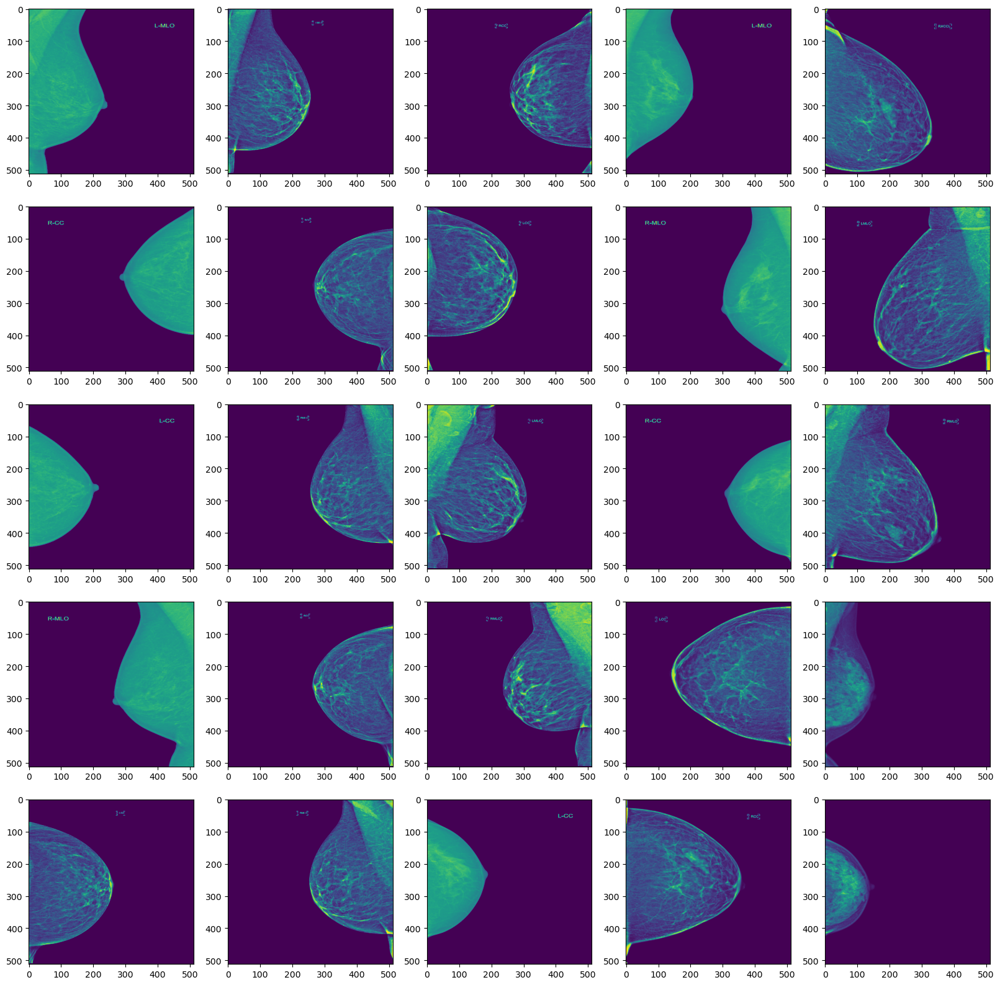

In [11]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

def kmeans_set_zero(img, dsize=(320,512), num_clusters=4):
    # flatten the image
    img_1d = img.reshape(-1,1)
     
    # apply kmeans
    kmeans = KMeans(n_clusters=num_clusters, random_state=0).fit(img_1d)
    cluster_ids_x = kmeans.labels_
    cluster_centers = kmeans.cluster_centers_

    smallest_sum = np.inf
    smallest_id = 0
    for cluster_id in range(num_clusters):
        cluster_sum = img_1d[cluster_ids_x == cluster_id].sum() / (100000)
        if cluster_sum < smallest_sum:
            smallest_sum = cluster_sum
            smallest_id = cluster_id

    img_1d[cluster_ids_x == smallest_id] = 0    
    kmeans_img = img_1d.reshape(dsize)
    return kmeans_img

def extraxtor_from_roi_box(d, frame, dsize=(512, 320), num_clusters=4):

    h, w = frame.shape
    org_dsize = (h, w)

    frame = kmeans_set_zero(frame, dsize=org_dsize, num_clusters=num_clusters)
    frame_org = copy.copy(frame)

    thres1 = np.min(frame) + 68
    np.place(frame, frame < thres1, 0)

    thres2 = frame_org.sum() / (h * w)
    vertical_not_zero = [True if frame[:, idx].sum() > thres2 else False for idx in range(w)]
    horizontal_not_zero = [True if frame[idx, :].sum() > thres2 else False for idx in range(h)]

    crop = frame_org[horizontal_not_zero, :]
    crop = crop[:, vertical_not_zero]

    crop = cv2.resize(crop, dsize=dsize, interpolation=cv2.INTER_LINEAR)

    return crop

dsize = (320, 512)
org_images = []
images = []
num = 5

for idx in tqdm.tqdm(range(len(df))):
    d = df.iloc[idx]
    img_file = d.img_name
    frame = cv2.imread(img_file, cv2.IMREAD_GRAYSCALE)
    org_frame = frame.copy()
    crop = extraxtor_from_roi_box(d, frame, dsize=dsize)
    org_images.append(org_frame)
    images.append(crop)

    new_img_name = os.path.join('image/', f"{d.patient_id}_{d.image_id}.png")
    im = Image.fromarray(crop)
    im.save(new_img_name)

fig, axes = plt.subplots(num, num, figsize=(20, 20))
for idx, image in enumerate(org_images):
    i = idx % num
    j = idx // num
    axes[i, j].imshow(image)

plt.subplots_adjust(wspace=0, hspace=.2)
plt.title("Original Images")
plt.show()

fig, axes = plt.subplots(num, num, figsize=(20, 20))
for idx, image in enumerate(images):
    i = idx % num
    j = idx // num
    axes[i, j].imshow(image)

plt.subplots_adjust(wspace=0, hspace=.2)
plt.title("Cropped Images")
plt.show()

del frame, crop, images, image
gc.collect()
